In [1]:
import datetime
from IPython.core.display import display, HTML
import math
import os
import pandas as pd
import random

import mlos.global_values as global_values
from mlos.Optimizers.BayesianOptimizerFactory import BayesianOptimizerFactory
from mlos.Optimizers.BayesianOptimizerConfigStore import bayesian_optimizer_config_store
from mlos.Optimizers.OptimizationProblem import OptimizationProblem, Objective
from mlos.Spaces import ContinuousDimension, Point, SimpleHypergrid
from mlos.Tracer import Tracer

display(HTML("<style>.container { width:100% !important; }</style>"))

global_values.declare_singletons()
global_values.tracer = Tracer(actor_id="MetaOptimizer", thread_id=0)

optimizer_results_dir = r"E:\Mlos\OptimizerOptimization"

# Let's stand up the Optimizer Microservice
#
optimizer_factory = BayesianOptimizerFactory()

In [2]:
os.getpid()

24668

In [3]:
# Let's make a meta optimizer.
#
meta_optimizer_config = bayesian_optimizer_config_store.default # get_config_by_name("default_with_glow_worm")
meta_optimizer_config.homogeneous_random_forest_regression_model_config.n_estimators = 50
meta_optimizer_config.homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.n_new_samples_before_refit = 5
meta_optimizer_config.experiment_designer_config.fraction_random_suggestions = 0.5
meta_optimizer_config.experiment_designer_config.random_search_optimizer_config.num_samples_per_iteration = 10000

num_inner_optimizer_iterations = 200
meta_optimizer_objective_name = f"optimum_value_after_{num_inner_optimizer_iterations}_iterations"

meta_optimizer = optimizer_factory.create_local_optimizer(
    optimizer_config=meta_optimizer_config,
    optimization_problem=OptimizationProblem(
        parameter_space=bayesian_optimizer_config_store.parameter_space,
        objective_space=SimpleHypergrid(
            name="predictions",
            dimensions=[
                ContinuousDimension(name=meta_optimizer_objective_name, min=-math.inf, max=math.inf)
            ]
        ),
        objectives=[Objective(name=meta_optimizer_objective_name, minimize=True)]
    )
)

10/01/2020 17:04:54 -   BayesianOptimizerFactory -    INFO - [BayesianOptimizerFactory.py:  40 -    create_local_optimizer() ] Creating a bayesian optimizer with config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 50,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 1,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 1,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.splitter": "best",
  "homogeneous_random_forest_regression_mod

In [4]:
from mlos.OptimizerEvaluationTools.ObjectiveFunctionFactory import ObjectiveFunctionFactory
from mlos.OptimizerEvaluationTools.ObjectiveFunctionConfigStore import objective_function_config_store
objective_function_config = objective_function_config_store.get_config_by_name('5_mutually_exclusive_polynomials')

objective_function_config.nested_polynomial_objective_config.polynomial_objective_config.input_domain_min = -20
objective_function_config.nested_polynomial_objective_config.polynomial_objective_config.input_domain_width = 40

objective_function = ObjectiveFunctionFactory.create_objective_function(objective_function_config)

In [5]:
print(objective_function.parameter_space)

  Name: domain
  Dimensions:
    polynomial_id: {0, 1, 2, ...}

  IF polynomial_id IN {1} THEN (
    Name: domain_1
    Dimensions:
      x_0: [-20.00, 20.00]
      x_1: [-20.00, 20.00]
  )

  IF polynomial_id IN {0} THEN (
    Name: domain_0
    Dimensions:
      x_0: [-20.00, 20.00]
      x_1: [-20.00, 20.00]
  )

  IF polynomial_id IN {3} THEN (
    Name: domain_3
    Dimensions:
      x_0: [-20.00, 20.00]
      x_1: [-20.00, 20.00]
  )

  IF polynomial_id IN {2} THEN (
    Name: domain_2
    Dimensions:
      x_0: [-20.00, 20.00]
      x_1: [-20.00, 20.00]
  )

  IF polynomial_id IN {4} THEN (
    Name: domain_4
    Dimensions:
      x_0: [-20.00, 20.00]
      x_1: [-20.00, 20.00]
  )


In [6]:
from mlos.Logger import create_logger
from mlos.Optimizers.RegressionModels.RegressionModelFitState import RegressionModelFitState

# Let us set up the lists to track optima over time.
#
best_observation_num_observations = []
best_observation_configs = []
best_observations = []

predicted_value_num_observations = []
best_predicted_value_configs = []
best_predicted_values = []

regression_model_fit_state = RegressionModelFitState()

In [7]:
logger = create_logger("Optimizing.")
num_completed_outer_loop_iterations = 0

In [8]:
def save_observations_to_file(optimizer, target_dir):
    configs, values = optimizer.get_all_observations()    
    merged_observations = pd.concat([configs, values], axis=1)
    with open(os.path.join(target_dir, f"{datetime.datetime.now().strftime('%Y_%m_%d_%H_%M_%S')}combined.csv"), "w") as out_file:
        merged_observations.to_csv(out_file, line_terminator="\n")

In [9]:
import concurrent.futures
from mlos.Optimizers.OptimumDefinition import OptimumDefinition
from mlos.Optimizers.RegressionModels.GoodnessOfFitMetrics import GoodnessOfFitMetrics, DataSetType
from mlos.OptimizerEvaluationTools.ParallelOptimization import run_optimization



num_desired_runs = 20000
num_completed_runs = 0
max_concurrent_jobs = 30 # To keep them all saturated.
max_workers = 12

with concurrent.futures.ProcessPoolExecutor(max_workers=max_workers) as executor:
    outstanding_futures = set()
    while num_completed_runs < num_desired_runs:
        logger.info(f"Completed: {num_completed_runs}, Desired: {num_desired_runs}, Outstanding: {len(outstanding_futures)}")

        # Let's keep submitting new jobs to the pool until we have the desired number of executions.
        #
        num_remaining_jobs_to_schedule = num_desired_runs - num_completed_runs - len(outstanding_futures)
        num_jobs_to_schedule_now = min(num_remaining_jobs_to_schedule, max_concurrent_jobs - len(outstanding_futures))
        if num_jobs_to_schedule_now > 0:
            for _ in range(num_jobs_to_schedule_now):
                logger.info(f"Completed: {num_completed_runs}, Desired: {num_desired_runs}, Outstanding: {len(outstanding_futures)}")
                logger.info(f"Getting suggestion from meta optimizer.")
                inner_optimizer_config = meta_optimizer.suggest()
                
                logger.info(f"Completed: {num_completed_runs}, Desired: {num_desired_runs}, Outstanding: {len(outstanding_futures)}")
                logger.info(f"Inner optimizer config: {inner_optimizer_config.to_json(indent=2)}")
                future = executor.submit(
                    run_optimization,
                    inner_optimizer_config.to_json(),
                    objective_function_config.to_json(),
                    num_iterations=num_inner_optimizer_iterations
                )
                outstanding_futures.add(future)

        # Now let's wait for any future to complete. 
        #
        logger.info("Waiting for futures to complete.")
        logger.info(f"Completed: {num_completed_runs}, Desired: {num_desired_runs}, Outstanding: {len(outstanding_futures)}")
        done_futures, outstanding_futures = concurrent.futures.wait(outstanding_futures, return_when=concurrent.futures.FIRST_COMPLETED)
        logger.info(f"{len(done_futures)} future(s) completed.")
        logger.info(f"Completed: {num_completed_runs}, Desired: {num_desired_runs}, Outstanding: {len(outstanding_futures)}")
        
        for future in done_futures:
            inner_optimizer_config_json, best_observation_value_json = future.result()
            inner_optimizer_config = Point.from_json(inner_optimizer_config_json)
            best_observation_value = Point.from_json(best_observation_value_json)
            logger.info(f"Completed: {num_completed_runs}, Desired: {num_desired_runs}, Outstanding: {len(outstanding_futures)}")
            logger.info(f"Registering {best_observation_value_json} with meta optimizer.")
            # TODO: Batch them.
            meta_optimizer.register(
                feature_values_pandas_frame=inner_optimizer_config.to_dataframe(),
                target_values_pandas_frame=Point(**{meta_optimizer_objective_name:best_observation_value.y}).to_dataframe()
            )
            logger.info(f"Completed: {num_completed_runs}, Desired: {num_desired_runs}, Outstanding: {len(outstanding_futures)}")
            logger.info(f"Registered observation with meta optimizer.")
            num_completed_runs += 1
            num_completed_outer_loop_iterations += 1
            
        ################################################################################################################################
        #
        #
        # TODO: Make these methods on a Convergence State.
        #
        #
        if meta_optimizer.trained:
            gof_metrics = meta_optimizer.compute_surrogate_model_goodness_of_fit()
            regression_model_fit_state.set_gof_metrics(data_set_type=DataSetType.TRAIN, gof_metrics=gof_metrics)

        best_observation_num_observations.append(num_completed_outer_loop_iterations)

        try:
            best_observation_config, best_observation = meta_optimizer.optimum(OptimumDefinition.BEST_OBSERVATION)    
            best_observation_configs.append(best_observation_config)
            best_observations.append(best_observation)

        
            best_predicted_value_config, best_predicted_value = meta_optimizer.optimum(OptimumDefinition.PREDICTED_VALUE_FOR_OBSERVED_CONFIG)
            best_predicted_value_configs.append(best_predicted_value_config)
            best_predicted_values.append(best_predicted_value)
            predicted_value_num_observations.append(num_completed_outer_loop_iterations)
        except:
            pass
        
        
        save_observations_to_file(optimizer=meta_optimizer, target_dir=optimizer_results_dir)

save_observations_to_file(optimizer=meta_optimizer, target_dir=optimizer_results_dir)

10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 0
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 0
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 0
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_sa

10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 2
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 2
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 64,
  "homogeneous_random_forest_regression_model_con

10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 5
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 5
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_model_co

10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 8
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 8
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 84,
  "homogeneous_random_forest_regression_model_con

10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 11
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 11
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 113,
  "homogeneous_random_forest_regression_model_

10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 13
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 13
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 101,
  "homogeneous_random_forest_regression_model_

10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 16
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 16
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 16,
  "homogeneous_random_forest_regression_model_c

10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 19
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 19
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 21,
  "homogeneous_random_forest_regression_model_c

10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 22
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 22
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_model_c

10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 25
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 25
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 96,
  "homogeneous_random_forest_regression_model_c

10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 28
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 28
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_model_c

10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 30
10/01/2020 17:05:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:05:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 29
10/01/2020 17:05:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 0, Desired: 20000, Outstanding: 29
10/01/2020 17:05:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6232.07

10/01/2020 17:05:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:05:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2, Desired: 20000, Outstanding: 30
10/01/2020 17:05:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:05:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2, Desired: 20000, Outstanding: 29
10/01/2020 17:05:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2, Desired: 20000, Outstanding: 29
10/01/2020 17:05:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8064.25

10/01/2020 17:05:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:05:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4, Desired: 20000, Outstanding: 30
10/01/2020 17:06:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:06:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4, Desired: 20000, Outstanding: 29
10/01/2020 17:06:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4, Desired: 20000, Outstanding: 29
10/01/2020 17:06:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10663.5

10/01/2020 17:06:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:06:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 6, Desired: 20000, Outstanding: 30
10/01/2020 17:06:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:06:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 6, Desired: 20000, Outstanding: 29
10/01/2020 17:06:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 6, Desired: 20000, Outstanding: 29
10/01/2020 17:06:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9576.84

10/01/2020 17:06:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:06:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 8, Desired: 20000, Outstanding: 30
10/01/2020 17:06:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:06:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 8, Desired: 20000, Outstanding: 29
10/01/2020 17:06:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 8, Desired: 20000, Outstanding: 29
10/01/2020 17:06:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -11531.6

10/01/2020 17:07:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:07:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 10, Desired: 20000, Outstanding: 30
10/01/2020 17:07:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:07:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 10, Desired: 20000, Outstanding: 29
10/01/2020 17:07:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 10, Desired: 20000, Outstanding: 29
10/01/2020 17:07:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8430

10/01/2020 17:07:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:07:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 12, Desired: 20000, Outstanding: 30
10/01/2020 17:08:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:08:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 12, Desired: 20000, Outstanding: 29
10/01/2020 17:08:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 12, Desired: 20000, Outstanding: 29
10/01/2020 17:08:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9295

10/01/2020 17:08:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:08:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 14, Desired: 20000, Outstanding: 30
10/01/2020 17:09:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:09:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 14, Desired: 20000, Outstanding: 29
10/01/2020 17:09:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 14, Desired: 20000, Outstanding: 29
10/01/2020 17:09:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -1009

10/01/2020 17:09:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:09:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 16, Desired: 20000, Outstanding: 30
10/01/2020 17:09:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:09:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 16, Desired: 20000, Outstanding: 29
10/01/2020 17:09:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 16, Desired: 20000, Outstanding: 29
10/01/2020 17:09:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7556

10/01/2020 17:10:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:10:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 18, Desired: 20000, Outstanding: 30
10/01/2020 17:10:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:10:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 18, Desired: 20000, Outstanding: 29
10/01/2020 17:10:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 18, Desired: 20000, Outstanding: 29
10/01/2020 17:10:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6937

10/01/2020 17:10:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:10:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 20, Desired: 20000, Outstanding: 30
10/01/2020 17:10:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:10:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 20, Desired: 20000, Outstanding: 29
10/01/2020 17:10:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 20, Desired: 20000, Outstanding: 29
10/01/2020 17:10:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7986

10/01/2020 17:10:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:10:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 22, Desired: 20000, Outstanding: 30
10/01/2020 17:10:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:10:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 22, Desired: 20000, Outstanding: 29
10/01/2020 17:10:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 22, Desired: 20000, Outstanding: 29
10/01/2020 17:10:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6711

10/01/2020 17:11:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:11:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 24, Desired: 20000, Outstanding: 30
10/01/2020 17:11:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:11:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 24, Desired: 20000, Outstanding: 29
10/01/2020 17:11:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 24, Desired: 20000, Outstanding: 29
10/01/2020 17:11:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8194

10/01/2020 17:11:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:11:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 26, Desired: 20000, Outstanding: 30
10/01/2020 17:11:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:11:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 26, Desired: 20000, Outstanding: 29
10/01/2020 17:11:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 26, Desired: 20000, Outstanding: 29
10/01/2020 17:11:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8083

10/01/2020 17:12:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:12:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 28, Desired: 20000, Outstanding: 30
10/01/2020 17:12:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:12:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 28, Desired: 20000, Outstanding: 29
10/01/2020 17:12:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 28, Desired: 20000, Outstanding: 29
10/01/2020 17:12:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -1176

10/01/2020 17:12:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:12:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 30, Desired: 20000, Outstanding: 30
10/01/2020 17:12:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 17:12:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 30, Desired: 20000, Outstanding: 27
10/01/2020 17:12:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 30, Desired: 20000, Outstanding: 27
10/01/2020 17:12:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7405

10/01/2020 17:12:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 33, Desired: 20000, Outstanding: 29
10/01/2020 17:12:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:13:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 33, Desired: 20000, Outstanding: 29
10/01/2020 17:13:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_model_

10/01/2020 17:14:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:14:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 34, Desired: 20000, Outstanding: 30
10/01/2020 17:14:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:14:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 34, Desired: 20000, Outstanding: 29
10/01/2020 17:14:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 34, Desired: 20000, Outstanding: 29
10/01/2020 17:14:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9606

10/01/2020 17:15:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:15:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 36, Desired: 20000, Outstanding: 30
10/01/2020 17:15:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:15:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 36, Desired: 20000, Outstanding: 29
10/01/2020 17:15:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 36, Desired: 20000, Outstanding: 29
10/01/2020 17:15:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9166

10/01/2020 17:15:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:15:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 38, Desired: 20000, Outstanding: 30
10/01/2020 17:15:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:15:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 38, Desired: 20000, Outstanding: 29
10/01/2020 17:15:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 38, Desired: 20000, Outstanding: 29
10/01/2020 17:15:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7510

10/01/2020 17:16:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:16:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 40, Desired: 20000, Outstanding: 30
10/01/2020 17:16:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:16:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 40, Desired: 20000, Outstanding: 29
10/01/2020 17:16:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 40, Desired: 20000, Outstanding: 29
10/01/2020 17:16:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8940

10/01/2020 17:16:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:16:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 42, Desired: 20000, Outstanding: 30
10/01/2020 17:16:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:16:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 42, Desired: 20000, Outstanding: 29
10/01/2020 17:16:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 42, Desired: 20000, Outstanding: 29
10/01/2020 17:16:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7147

10/01/2020 17:18:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:18:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 44, Desired: 20000, Outstanding: 30
10/01/2020 17:18:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:18:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 44, Desired: 20000, Outstanding: 29
10/01/2020 17:18:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 44, Desired: 20000, Outstanding: 29
10/01/2020 17:18:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7142

10/01/2020 17:18:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:18:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 46, Desired: 20000, Outstanding: 30
10/01/2020 17:19:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:19:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 46, Desired: 20000, Outstanding: 29
10/01/2020 17:19:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 46, Desired: 20000, Outstanding: 29
10/01/2020 17:19:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7850

10/01/2020 17:19:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:19:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 48, Desired: 20000, Outstanding: 30
10/01/2020 17:20:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:20:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 48, Desired: 20000, Outstanding: 29
10/01/2020 17:20:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 48, Desired: 20000, Outstanding: 29
10/01/2020 17:20:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8229

10/01/2020 17:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 50, Desired: 20000, Outstanding: 30
10/01/2020 17:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 50, Desired: 20000, Outstanding: 29
10/01/2020 17:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 50, Desired: 20000, Outstanding: 29
10/01/2020 17:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -1009

10/01/2020 17:21:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:21:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 52, Desired: 20000, Outstanding: 30
10/01/2020 17:21:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:21:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 52, Desired: 20000, Outstanding: 29
10/01/2020 17:21:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 52, Desired: 20000, Outstanding: 29
10/01/2020 17:21:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6513

10/01/2020 17:23:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:23:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 54, Desired: 20000, Outstanding: 30
10/01/2020 17:23:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 17:23:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 54, Desired: 20000, Outstanding: 28
10/01/2020 17:23:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 54, Desired: 20000, Outstanding: 28
10/01/2020 17:23:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8493

10/01/2020 17:23:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:23:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 56, Desired: 20000, Outstanding: 30
10/01/2020 17:23:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/01/2020 17:23:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 56, Desired: 20000, Outstanding: 25
10/01/2020 17:23:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 56, Desired: 20000, Outstanding: 25
10/01/2020 17:23:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9460

10/01/2020 17:24:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 61, Desired: 20000, Outstanding: 26
10/01/2020 17:24:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:24:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 61, Desired: 20000, Outstanding: 26
10/01/2020 17:24:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 31,
  "homogeneous_random_forest_regression_model_config.n_estimators": 83,
  "homogeneous_random_forest_regression_model

10/01/2020 17:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 61, Desired: 20000, Outstanding: 28
10/01/2020 17:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 61, Desired: 20000, Outstanding: 28
10/01/2020 17:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 17,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_model

10/01/2020 17:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 61, Desired: 20000, Outstanding: 28
10/01/2020 17:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8042.9760797324425} with meta optimizer.
10/01/2020 17:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 61, Desired: 20000, Outstanding: 28
10/01/2020 17:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 17:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 62, Desired: 20000, Outstanding: 28
10/01/2020 17:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -      

10/01/2020 17:25:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:25:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 63, Desired: 20000, Outstanding: 30
10/01/2020 17:25:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:25:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 63, Desired: 20000, Outstanding: 29
10/01/2020 17:25:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 63, Desired: 20000, Outstanding: 29
10/01/2020 17:25:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9840

10/01/2020 17:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 65, Desired: 20000, Outstanding: 30
10/01/2020 17:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 17:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 65, Desired: 20000, Outstanding: 27
10/01/2020 17:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 65, Desired: 20000, Outstanding: 27
10/01/2020 17:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8008

10/01/2020 17:26:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 68, Desired: 20000, Outstanding: 29
10/01/2020 17:26:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:26:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 68, Desired: 20000, Outstanding: 29
10/01/2020 17:26:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 97,
  "homogeneous_random_forest_regression_model_

10/01/2020 17:26:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:26:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 69, Desired: 20000, Outstanding: 30
10/01/2020 17:26:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 17:26:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 69, Desired: 20000, Outstanding: 28
10/01/2020 17:26:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 69, Desired: 20000, Outstanding: 28
10/01/2020 17:26:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8723

10/01/2020 17:27:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:27:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 71, Desired: 20000, Outstanding: 30
10/01/2020 17:27:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:27:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 71, Desired: 20000, Outstanding: 29
10/01/2020 17:27:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 71, Desired: 20000, Outstanding: 29
10/01/2020 17:27:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7815

10/01/2020 17:27:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:27:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 73, Desired: 20000, Outstanding: 30
10/01/2020 17:27:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:27:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 73, Desired: 20000, Outstanding: 29
10/01/2020 17:27:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 73, Desired: 20000, Outstanding: 29
10/01/2020 17:27:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8380

10/01/2020 17:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 75, Desired: 20000, Outstanding: 30
10/01/2020 17:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 17:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 75, Desired: 20000, Outstanding: 28
10/01/2020 17:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 75, Desired: 20000, Outstanding: 28
10/01/2020 17:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -1121

10/01/2020 17:28:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:28:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 77, Desired: 20000, Outstanding: 30
10/01/2020 17:28:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 17:28:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 77, Desired: 20000, Outstanding: 28
10/01/2020 17:28:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 77, Desired: 20000, Outstanding: 28
10/01/2020 17:28:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8247

10/01/2020 17:28:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:28:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 79, Desired: 20000, Outstanding: 30
10/01/2020 17:28:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:28:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 79, Desired: 20000, Outstanding: 29
10/01/2020 17:28:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 79, Desired: 20000, Outstanding: 29
10/01/2020 17:28:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9119

10/01/2020 17:29:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 82, Desired: 20000, Outstanding: 29
10/01/2020 17:29:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:29:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 82, Desired: 20000, Outstanding: 29
10/01/2020 17:29:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 112,
  "homogeneous_random_forest_regression_mode

10/01/2020 17:30:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 67,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.019887013821772603,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8299636162945542,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/01/2020 17:30:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:30:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 87, Desired: 20000, Outstanding: 27
10/01/2020 17:30:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2107017964493325,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.06109766584337217,
  "homoge

10/01/2020 17:30:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:30:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 87, Desired: 20000, Outstanding: 30
10/01/2020 17:30:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/01/2020 17:30:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 87, Desired: 20000, Outstanding: 24
10/01/2020 17:30:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 87, Desired: 20000, Outstanding: 24
10/01/2020 17:30:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6646

10/01/2020 17:31:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 93, Desired: 20000, Outstanding: 25
10/01/2020 17:31:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:31:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 93, Desired: 20000, Outstanding: 25
10/01/2020 17:31:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 6,
  "homogeneous_random_forest_regression_model_

10/01/2020 17:31:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 93, Desired: 20000, Outstanding: 27
10/01/2020 17:31:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:31:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 93, Desired: 20000, Outstanding: 27
10/01/2020 17:31:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_model

10/01/2020 17:31:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:31:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 93, Desired: 20000, Outstanding: 30
10/01/2020 17:31:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 17:31:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 93, Desired: 20000, Outstanding: 26
10/01/2020 17:31:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 93, Desired: 20000, Outstanding: 26
10/01/2020 17:31:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7374

10/01/2020 17:31:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 97, Desired: 20000, Outstanding: 27
10/01/2020 17:31:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6575157528505171,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7322279281530232,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,


10/01/2020 17:32:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:32:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 97, Desired: 20000, Outstanding: 30
10/01/2020 17:32:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 17:32:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 97, Desired: 20000, Outstanding: 26
10/01/2020 17:32:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 97, Desired: 20000, Outstanding: 26
10/01/2020 17:32:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8584

10/01/2020 17:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 101, Desired: 20000, Outstanding: 28
10/01/2020 17:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 101, Desired: 20000, Outstanding: 28
10/01/2020 17:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_mod

10/01/2020 17:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6984.067381944624} with meta optimizer.
10/01/2020 17:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 102, Desired: 20000, Outstanding: 24
10/01/2020 17:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 17:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 103, Desired: 20000, Outstanding: 24
10/01/2020 17:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8889.832080718317} with meta optimizer.
10/01/2020 17:32:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>

10/01/2020 17:33:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 107, Desired: 20000, Outstanding: 26
10/01/2020 17:33:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:33:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 107, Desired: 20000, Outstanding: 26
10/01/2020 17:33:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_mo

10/01/2020 17:34:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.21707272983711423,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7333229734416411,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 17:34:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 109, Desired: 20000, Outstanding: 21
10/01/2020 17:34:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8628.556015764603} with meta optimizer.
10/01/2020 17:34:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 109, Desired: 20000, Outstanding: 21
10/01/2020 17:34:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 17:34:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 110, Desired: 20000, Outstanding: 21
10/01/2020 17:34:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -    

10/01/2020 17:35:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 116, Desired: 20000, Outstanding: 22
10/01/2020 17:35:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:35:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 116, Desired: 20000, Outstanding: 22
10/01/2020 17:35:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 62,
  "homogeneous_random_forest_regression_mod

10/01/2020 17:35:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4042202689634252,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7607252421177303,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/01/2020 17:35:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 116, Desired: 20000, Outstanding: 27
10/01/2020 17:35:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:35:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 116, Desired: 20000, Outstanding: 27
10/01/2020 17:35:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_mod

10/01/2020 17:35:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:35:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 116, Desired: 20000, Outstanding: 30
10/01/2020 17:35:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 17:35:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 116, Desired: 20000, Outstanding: 26
10/01/2020 17:35:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 116, Desired: 20000, Outstanding: 26
10/01/2020 17:35:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6

10/01/2020 17:36:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 120, Desired: 20000, Outstanding: 28
10/01/2020 17:36:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:36:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 120, Desired: 20000, Outstanding: 28
10/01/2020 17:36:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_mod

10/01/2020 17:36:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6806.502030255024} with meta optimizer.
10/01/2020 17:36:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 121, Desired: 20000, Outstanding: 25
10/01/2020 17:36:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 17:36:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 122, Desired: 20000, Outstanding: 25
10/01/2020 17:36:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6283.18262062424} with meta optimizer.
10/01/2020 17:36:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:

10/01/2020 17:37:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 125, Desired: 20000, Outstanding: 27
10/01/2020 17:37:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:37:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 125, Desired: 20000, Outstanding: 27
10/01/2020 17:37:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 101,
  "homogeneous_random_forest_regression_mo

10/01/2020 17:38:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 77,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7492477512811458,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.19204087485964783,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 17:38:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:38:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 126, Desired: 20000, Outstanding: 30
10/01/2020 17:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 126, Desired: 20000, Outstanding: 29
10/01/2020 17:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 126, Desired: 20000, Outstanding: 29
10/01/2020 17:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -5

10/01/2020 17:38:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:38:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 128, Desired: 20000, Outstanding: 30
10/01/2020 17:38:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:38:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 128, Desired: 20000, Outstanding: 29
10/01/2020 17:38:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 128, Desired: 20000, Outstanding: 29
10/01/2020 17:38:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 17:39:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:39:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 130, Desired: 20000, Outstanding: 30
10/01/2020 17:39:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:39:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 130, Desired: 20000, Outstanding: 29
10/01/2020 17:39:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 130, Desired: 20000, Outstanding: 29
10/01/2020 17:39:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 17:40:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:40:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 132, Desired: 20000, Outstanding: 30
10/01/2020 17:40:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:40:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 132, Desired: 20000, Outstanding: 29
10/01/2020 17:40:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 132, Desired: 20000, Outstanding: 29
10/01/2020 17:40:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 17:40:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:40:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 135, Desired: 20000, Outstanding: 28
10/01/2020 17:40:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 84,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.775214066585659,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.47730606533240505,
  "homog

10/01/2020 17:41:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:41:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 136, Desired: 20000, Outstanding: 29
10/01/2020 17:41:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 90,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9186755442207525,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.48938533897563863,
  "homo

10/01/2020 17:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 137, Desired: 20000, Outstanding: 30
10/01/2020 17:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 137, Desired: 20000, Outstanding: 29
10/01/2020 17:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 137, Desired: 20000, Outstanding: 29
10/01/2020 17:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9152.514179554102} with meta optimizer.
10/01/2020 17:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module

10/01/2020 17:42:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8873639840850028,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7230301826981295,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/01/2020 17:43:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:43:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 141, Desired: 20000, Outstanding: 30
10/01/2020 17:43:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 17:43:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 141, Desired: 20000, Outstanding: 26
10/01/2020 17:43:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 141, Desired: 20000, Outstanding: 26
10/01/2020 17:43:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 17:44:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 145, Desired: 20000, Outstanding: 28
10/01/2020 17:44:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:44:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 145, Desired: 20000, Outstanding: 28
10/01/2020 17:44:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 32,
  "homogeneous_random_forest_regression_mod

10/01/2020 17:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7584.657776479688} with meta optimizer.
10/01/2020 17:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 146, Desired: 20000, Outstanding: 25
10/01/2020 17:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 17:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 147, Desired: 20000, Outstanding: 25
10/01/2020 17:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8486.653135842864} with meta optimizer.
10/01/2020 17:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>

10/01/2020 17:44:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 150, Desired: 20000, Outstanding: 27
10/01/2020 17:44:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:44:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 150, Desired: 20000, Outstanding: 27
10/01/2020 17:44:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 53,
  "homogeneous_random_forest_regression_mod

10/01/2020 17:44:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:44:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 150, Desired: 20000, Outstanding: 30
10/01/2020 17:44:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:44:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 150, Desired: 20000, Outstanding: 29
10/01/2020 17:44:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 150, Desired: 20000, Outstanding: 29
10/01/2020 17:44:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 17:45:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 153, Desired: 20000, Outstanding: 29
10/01/2020 17:45:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:45:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 153, Desired: 20000, Outstanding: 29
10/01/2020 17:45:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 73,
  "homogeneous_random_forest_regression_mod

10/01/2020 17:46:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 155, Desired: 20000, Outstanding: 29
10/01/2020 17:46:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:46:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 155, Desired: 20000, Outstanding: 29
10/01/2020 17:46:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_mod

10/01/2020 17:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 156, Desired: 20000, Outstanding: 30
10/01/2020 17:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 156, Desired: 20000, Outstanding: 29
10/01/2020 17:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 156, Desired: 20000, Outstanding: 29
10/01/2020 17:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 17:47:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:47:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 158, Desired: 20000, Outstanding: 30
10/01/2020 17:47:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 17:47:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 158, Desired: 20000, Outstanding: 27
10/01/2020 17:47:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 158, Desired: 20000, Outstanding: 27
10/01/2020 17:47:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 17:48:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 161, Desired: 20000, Outstanding: 29
10/01/2020 17:48:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:48:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 161, Desired: 20000, Outstanding: 29
10/01/2020 17:48:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 84,
  "homogeneous_random_forest_regression_mod

10/01/2020 17:49:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 163, Desired: 20000, Outstanding: 29
10/01/2020 17:49:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:49:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 163, Desired: 20000, Outstanding: 29
10/01/2020 17:49:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 109,
  "homogeneous_random_forest_regression_mo

10/01/2020 17:49:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 165, Desired: 20000, Outstanding: 29
10/01/2020 17:49:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:50:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 165, Desired: 20000, Outstanding: 29
10/01/2020 17:50:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_mo

10/01/2020 17:50:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:50:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 166, Desired: 20000, Outstanding: 30
10/01/2020 17:50:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 17:50:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 166, Desired: 20000, Outstanding: 27
10/01/2020 17:50:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 166, Desired: 20000, Outstanding: 27
10/01/2020 17:50:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6

10/01/2020 17:51:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 169, Desired: 20000, Outstanding: 29
10/01/2020 17:51:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:51:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 169, Desired: 20000, Outstanding: 29
10/01/2020 17:51:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 100,
  "homogeneous_random_forest_regression_mo

10/01/2020 17:52:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 173, Desired: 20000, Outstanding: 27
10/01/2020 17:52:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:52:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 173, Desired: 20000, Outstanding: 27
10/01/2020 17:52:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 39,
  "homogeneous_random_forest_regression_mod

10/01/2020 17:53:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:53:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 173, Desired: 20000, Outstanding: 30
10/01/2020 17:53:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 17:53:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 173, Desired: 20000, Outstanding: 27
10/01/2020 17:53:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 173, Desired: 20000, Outstanding: 27
10/01/2020 17:53:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 17:53:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 176, Desired: 20000, Outstanding: 29
10/01/2020 17:53:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:53:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 176, Desired: 20000, Outstanding: 29
10/01/2020 17:53:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 103,
  "homogeneous_random_forest_regression_mo

10/01/2020 17:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 178, Desired: 20000, Outstanding: 29
10/01/2020 17:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:54:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 178, Desired: 20000, Outstanding: 29
10/01/2020 17:54:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 93,
  "homogeneous_random_forest_regression_mod

10/01/2020 17:55:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 180, Desired: 20000, Outstanding: 29
10/01/2020 17:55:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:55:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 180, Desired: 20000, Outstanding: 29
10/01/2020 17:55:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_mod

10/01/2020 17:55:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 182, Desired: 20000, Outstanding: 29
10/01/2020 17:55:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 17:55:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 182, Desired: 20000, Outstanding: 29
10/01/2020 17:55:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 101,
  "homogeneous_random_forest_regression_mo

10/01/2020 17:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 183, Desired: 20000, Outstanding: 30
10/01/2020 17:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 183, Desired: 20000, Outstanding: 29
10/01/2020 17:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 183, Desired: 20000, Outstanding: 29
10/01/2020 17:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 17:56:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:56:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 185, Desired: 20000, Outstanding: 30
10/01/2020 17:56:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:56:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 185, Desired: 20000, Outstanding: 29
10/01/2020 17:56:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 185, Desired: 20000, Outstanding: 29
10/01/2020 17:56:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9

10/01/2020 17:57:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:57:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 187, Desired: 20000, Outstanding: 30
10/01/2020 17:57:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:57:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 187, Desired: 20000, Outstanding: 29
10/01/2020 17:57:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 187, Desired: 20000, Outstanding: 29
10/01/2020 17:57:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 17:58:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:58:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 189, Desired: 20000, Outstanding: 30
10/01/2020 17:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 189, Desired: 20000, Outstanding: 29
10/01/2020 17:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 189, Desired: 20000, Outstanding: 29
10/01/2020 17:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -5

10/01/2020 17:59:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 17:59:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 191, Desired: 20000, Outstanding: 30
10/01/2020 17:59:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 17:59:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 191, Desired: 20000, Outstanding: 29
10/01/2020 17:59:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 191, Desired: 20000, Outstanding: 29
10/01/2020 17:59:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 18:00:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 194, Desired: 20000, Outstanding: 29
10/01/2020 18:00:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:00:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 194, Desired: 20000, Outstanding: 29
10/01/2020 18:00:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 72,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:01:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 196, Desired: 20000, Outstanding: 29
10/01/2020 18:01:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:01:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 196, Desired: 20000, Outstanding: 29
10/01/2020 18:01:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 120,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:01:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 200, Desired: 20000, Outstanding: 27
10/01/2020 18:01:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:01:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 200, Desired: 20000, Outstanding: 27
10/01/2020 18:01:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 68,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:02:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:02:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 200, Desired: 20000, Outstanding: 30
10/01/2020 18:02:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 18:02:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 200, Desired: 20000, Outstanding: 28
10/01/2020 18:02:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 200, Desired: 20000, Outstanding: 28
10/01/2020 18:02:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6

10/01/2020 18:02:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:02:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 202, Desired: 20000, Outstanding: 30
10/01/2020 18:02:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 18:02:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 202, Desired: 20000, Outstanding: 26
10/01/2020 18:02:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 202, Desired: 20000, Outstanding: 26
10/01/2020 18:02:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 18:02:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 206, Desired: 20000, Outstanding: 28
10/01/2020 18:02:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:03:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 206, Desired: 20000, Outstanding: 28
10/01/2020 18:03:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 8,
  "homogeneous_random_forest_regression_mode

10/01/2020 18:03:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7251.936744512936} with meta optimizer.
10/01/2020 18:03:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 207, Desired: 20000, Outstanding: 25
10/01/2020 18:03:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:03:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 208, Desired: 20000, Outstanding: 25
10/01/2020 18:03:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6174.182035024816} with meta optimizer.
10/01/2020 18:03:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>

10/01/2020 18:04:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 211, Desired: 20000, Outstanding: 27
10/01/2020 18:04:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:04:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 211, Desired: 20000, Outstanding: 27
10/01/2020 18:04:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 62,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:05:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:05:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 211, Desired: 20000, Outstanding: 30
10/01/2020 18:05:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 18:05:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 211, Desired: 20000, Outstanding: 27
10/01/2020 18:05:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 211, Desired: 20000, Outstanding: 27
10/01/2020 18:05:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 18:05:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 214, Desired: 20000, Outstanding: 29
10/01/2020 18:05:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:05:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 214, Desired: 20000, Outstanding: 29
10/01/2020 18:05:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 72,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:06:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 216, Desired: 20000, Outstanding: 29
10/01/2020 18:06:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:06:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 216, Desired: 20000, Outstanding: 29
10/01/2020 18:06:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:06:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 219, Desired: 20000, Outstanding: 28
10/01/2020 18:06:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:06:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 219, Desired: 20000, Outstanding: 28
10/01/2020 18:06:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mode

10/01/2020 18:07:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7248.517384531213} with meta optimizer.
10/01/2020 18:07:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 220, Desired: 20000, Outstanding: 27
10/01/2020 18:07:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:07:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 221, Desired: 20000, Outstanding: 27
10/01/2020 18:07:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8851.673529257474} with meta optimizer.
10/01/2020 18:07:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>

10/01/2020 18:07:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 222, Desired: 20000, Outstanding: 29
10/01/2020 18:07:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:07:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 222, Desired: 20000, Outstanding: 29
10/01/2020 18:07:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:08:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:08:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 223, Desired: 20000, Outstanding: 30
10/01/2020 18:08:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 18:08:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 223, Desired: 20000, Outstanding: 29
10/01/2020 18:08:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 223, Desired: 20000, Outstanding: 29
10/01/2020 18:08:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 18:10:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:10:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 225, Desired: 20000, Outstanding: 30
10/01/2020 18:10:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 18:10:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 225, Desired: 20000, Outstanding: 29
10/01/2020 18:10:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 225, Desired: 20000, Outstanding: 29
10/01/2020 18:10:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 18:11:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:11:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 227, Desired: 20000, Outstanding: 30
10/01/2020 18:11:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 18:11:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 227, Desired: 20000, Outstanding: 29
10/01/2020 18:11:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 227, Desired: 20000, Outstanding: 29
10/01/2020 18:11:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 18:12:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:12:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 229, Desired: 20000, Outstanding: 30
10/01/2020 18:12:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 18:12:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 229, Desired: 20000, Outstanding: 29
10/01/2020 18:12:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 229, Desired: 20000, Outstanding: 29
10/01/2020 18:12:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 18:13:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:13:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 231, Desired: 20000, Outstanding: 30
10/01/2020 18:13:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 18:13:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 231, Desired: 20000, Outstanding: 27
10/01/2020 18:13:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 231, Desired: 20000, Outstanding: 27
10/01/2020 18:13:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9

10/01/2020 18:13:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 234, Desired: 20000, Outstanding: 29
10/01/2020 18:13:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:13:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 234, Desired: 20000, Outstanding: 29
10/01/2020 18:13:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:14:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:14:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 235, Desired: 20000, Outstanding: 30
10/01/2020 18:14:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 18:14:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 235, Desired: 20000, Outstanding: 26
10/01/2020 18:14:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 235, Desired: 20000, Outstanding: 26
10/01/2020 18:14:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -1

10/01/2020 18:14:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:14:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 239, Desired: 20000, Outstanding: 27
10/01/2020 18:14:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 100,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.263752578383999,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9596473545399684,
  "homog

10/01/2020 18:15:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:15:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 239, Desired: 20000, Outstanding: 30
10/01/2020 18:15:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/01/2020 18:15:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 239, Desired: 20000, Outstanding: 25
10/01/2020 18:15:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 239, Desired: 20000, Outstanding: 25
10/01/2020 18:15:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 18:16:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8646484962562009,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.27505616500487184,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 18:16:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 244, Desired: 20000, Outstanding: 29
10/01/2020 18:16:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:16:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 244, Desired: 20000, Outstanding: 29
10/01/2020 18:16:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:16:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:16:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 250, Desired: 20000, Outstanding: 24
10/01/2020 18:16:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 250, Desired: 20000, Outstanding: 24
10/01/2020 18:16:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:16:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 250, Desired: 20000, Outstanding: 24
10/01/2020 18:16:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <modu

10/01/2020 18:17:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 250, Desired: 20000, Outstanding: 26
10/01/2020 18:17:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5696069532993047,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7339258929272648,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,

10/01/2020 18:17:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 250, Desired: 20000, Outstanding: 29
10/01/2020 18:17:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:17:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 250, Desired: 20000, Outstanding: 29
10/01/2020 18:17:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 71,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:17:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 254, Desired: 20000, Outstanding: 22
10/01/2020 18:17:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:17:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 255, Desired: 20000, Outstanding: 22
10/01/2020 18:17:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6916.012283362271} with meta optimizer.
10/01/2020 18:17:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 255, Desired: 20000, Outstanding: 22
10/01/2020 18:17:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 18:18:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 258, Desired: 20000, Outstanding: 24
10/01/2020 18:18:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:18:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 258, Desired: 20000, Outstanding: 24
10/01/2020 18:18:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:18:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 258, Desired: 20000, Outstanding: 27
10/01/2020 18:18:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:18:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 258, Desired: 20000, Outstanding: 27
10/01/2020 18:18:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 113,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:18:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 81,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.05524451506912165,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.015490208209395395,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tr

10/01/2020 18:18:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 264, Desired: 20000, Outstanding: 20
10/01/2020 18:18:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:18:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 265, Desired: 20000, Outstanding: 20
10/01/2020 18:18:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9194.844460188078} with meta optimizer.
10/01/2020 18:18:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 265, Desired: 20000, Outstanding: 20
10/01/2020 18:18:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 18:19:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 268, Desired: 20000, Outstanding: 22
10/01/2020 18:19:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:19:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 268, Desired: 20000, Outstanding: 22
10/01/2020 18:19:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:19:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 29,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.11248557460358366,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9030619217460332,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 18:20:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 268, Desired: 20000, Outstanding: 27
10/01/2020 18:20:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:20:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 268, Desired: 20000, Outstanding: 27
10/01/2020 18:20:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:20:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 268, Desired: 20000, Outstanding: 29
10/01/2020 18:20:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:20:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 268, Desired: 20000, Outstanding: 29
10/01/2020 18:20:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 69,
  "homogeneous_random_forest_regression_model_config.n_estimators": 15,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:20:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 272, Desired: 20000, Outstanding: 17
10/01/2020 18:20:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:20:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 273, Desired: 20000, Outstanding: 17
10/01/2020 18:20:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9023.445437122216} with meta optimizer.
10/01/2020 18:20:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 273, Desired: 20000, Outstanding: 17
10/01/2020 18:20:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 18:20:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 281, Desired: 20000, Outstanding: 18
10/01/2020 18:20:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:20:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 281, Desired: 20000, Outstanding: 18
10/01/2020 18:20:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:20:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 281, Desired: 20000, Outstanding: 21
10/01/2020 18:20:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:20:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 281, Desired: 20000, Outstanding: 21
10/01/2020 18:20:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:21:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6870068046205525,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9168161326989768,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 18:21:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:21:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 281, Desired: 20000, Outstanding: 25
10/01/2020 18:21:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 107,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5457533769461813,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.33016978200363,
  "homoge

10/01/2020 18:22:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 281, Desired: 20000, Outstanding: 27
10/01/2020 18:22:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:22:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 281, Desired: 20000, Outstanding: 27
10/01/2020 18:22:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:22:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 281, Desired: 20000, Outstanding: 29
10/01/2020 18:22:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:22:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 281, Desired: 20000, Outstanding: 29
10/01/2020 18:22:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:22:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 285, Desired: 20000, Outstanding: 20
10/01/2020 18:22:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:22:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 286, Desired: 20000, Outstanding: 20
10/01/2020 18:22:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -11466.966922875525} with meta optimizer.
10/01/2020 18:22:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 286, Desired: 20000, Outstanding: 20
10/01/2020 18:22:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -   

10/01/2020 18:22:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 291, Desired: 20000, Outstanding: 22
10/01/2020 18:22:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:23:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 291, Desired: 20000, Outstanding: 22
10/01/2020 18:23:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 82,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:23:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 291, Desired: 20000, Outstanding: 24
10/01/2020 18:23:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:23:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 291, Desired: 20000, Outstanding: 24
10/01/2020 18:23:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_mode

10/01/2020 18:23:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 291, Desired: 20000, Outstanding: 26
10/01/2020 18:23:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:23:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 291, Desired: 20000, Outstanding: 26
10/01/2020 18:23:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 51,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:24:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 82,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2799107434523068,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.007250701817940075,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/01/2020 18:24:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 293, Desired: 20000, Outstanding: 23
10/01/2020 18:24:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8796.568170119914} with meta optimizer.
10/01/2020 18:24:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 293, Desired: 20000, Outstanding: 23
10/01/2020 18:24:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:24:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 294, Desired: 20000, Outstanding: 23
10/01/2020 18:24:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -    

10/01/2020 18:24:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:24:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 298, Desired: 20000, Outstanding: 24
10/01/2020 18:24:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9344961077189311,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7282658274684921,
  "homog

10/01/2020 18:24:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 298, Desired: 20000, Outstanding: 27
10/01/2020 18:24:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:24:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 298, Desired: 20000, Outstanding: 27
10/01/2020 18:24:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 113,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:24:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8385986977313373,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7167391865106857,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/01/2020 18:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 301, Desired: 20000, Outstanding: 28
10/01/2020 18:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:25:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 301, Desired: 20000, Outstanding: 28
10/01/2020 18:25:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 5,
  "homogeneous_random_forest_regression_mode

10/01/2020 18:25:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 301, Desired: 20000, Outstanding: 24
10/01/2020 18:25:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8443.675610940443} with meta optimizer.
10/01/2020 18:25:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 301, Desired: 20000, Outstanding: 24
10/01/2020 18:25:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:25:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 302, Desired: 20000, Outstanding: 24
10/01/2020 18:25:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -    

10/01/2020 18:26:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 307, Desired: 20000, Outstanding: 25
10/01/2020 18:26:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:26:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 307, Desired: 20000, Outstanding: 25
10/01/2020 18:26:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 8,
  "homogeneous_random_forest_regression_mode

10/01/2020 18:26:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 307, Desired: 20000, Outstanding: 28
10/01/2020 18:26:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:26:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 307, Desired: 20000, Outstanding: 28
10/01/2020 18:26:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:26:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 307, Desired: 20000, Outstanding: 28
10/01/2020 18:26:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7226.514903976213} with meta optimizer.
10/01/2020 18:26:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 307, Desired: 20000, Outstanding: 28
10/01/2020 18:26:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:26:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 308, Desired: 20000, Outstanding: 28
10/01/2020 18:26:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -    

10/01/2020 18:26:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:26:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 309, Desired: 20000, Outstanding: 30
10/01/2020 18:26:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 18:26:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 309, Desired: 20000, Outstanding: 29
10/01/2020 18:26:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 309, Desired: 20000, Outstanding: 29
10/01/2020 18:26:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 18:27:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:27:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 311, Desired: 20000, Outstanding: 30
10/01/2020 18:27:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 18:27:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 311, Desired: 20000, Outstanding: 27
10/01/2020 18:27:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 311, Desired: 20000, Outstanding: 27
10/01/2020 18:27:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 18:28:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 314, Desired: 20000, Outstanding: 29
10/01/2020 18:28:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:28:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 314, Desired: 20000, Outstanding: 29
10/01/2020 18:28:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 39,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:28:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 316, Desired: 20000, Outstanding: 29
10/01/2020 18:28:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:28:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 316, Desired: 20000, Outstanding: 29
10/01/2020 18:28:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:29:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.08915118496155627,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.11436023872436529,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/01/2020 18:29:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:29:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 321, Desired: 20000, Outstanding: 27
10/01/2020 18:29:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6726461091131946,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.12723868845512043,
  "homo

10/01/2020 18:29:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:29:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 321, Desired: 20000, Outstanding: 30
10/01/2020 18:29:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 18:29:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 321, Desired: 20000, Outstanding: 27
10/01/2020 18:29:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 321, Desired: 20000, Outstanding: 27
10/01/2020 18:29:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 18:30:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 324, Desired: 20000, Outstanding: 29
10/01/2020 18:30:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:30:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 324, Desired: 20000, Outstanding: 29
10/01/2020 18:30:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 109,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:30:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 328, Desired: 20000, Outstanding: 25
10/01/2020 18:30:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:30:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 329, Desired: 20000, Outstanding: 25
10/01/2020 18:30:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 329, Desired: 20000, Outstanding: 25
10/01/2020 18:30:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:30:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <modu

10/01/2020 18:31:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 329, Desired: 20000, Outstanding: 27
10/01/2020 18:31:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:31:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 329, Desired: 20000, Outstanding: 27
10/01/2020 18:31:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:31:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 329, Desired: 20000, Outstanding: 29
10/01/2020 18:31:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:32:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 329, Desired: 20000, Outstanding: 29
10/01/2020 18:32:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:32:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 333, Desired: 20000, Outstanding: 26
10/01/2020 18:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 120,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.21262942818630315,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7475733461261274,
  "hom

10/01/2020 18:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 333, Desired: 20000, Outstanding: 28
10/01/2020 18:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 333, Desired: 20000, Outstanding: 28
10/01/2020 18:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_mode

10/01/2020 18:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 333, Desired: 20000, Outstanding: 29
10/01/2020 18:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6706.274177998491} with meta optimizer.
10/01/2020 18:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 333, Desired: 20000, Outstanding: 29
10/01/2020 18:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:32:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 334, Desired: 20000, Outstanding: 29
10/01/2020 18:32:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -    

10/01/2020 18:32:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 336, Desired: 20000, Outstanding: 29
10/01/2020 18:32:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:32:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 336, Desired: 20000, Outstanding: 29
10/01/2020 18:32:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:33:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 338, Desired: 20000, Outstanding: 29
10/01/2020 18:33:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:33:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 338, Desired: 20000, Outstanding: 29
10/01/2020 18:33:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 114,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:33:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 341, Desired: 20000, Outstanding: 28
10/01/2020 18:33:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:33:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 341, Desired: 20000, Outstanding: 28
10/01/2020 18:33:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 7,
  "homogeneous_random_forest_regression_mode

10/01/2020 18:33:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 341, Desired: 20000, Outstanding: 29
10/01/2020 18:33:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7297.442168582757} with meta optimizer.
10/01/2020 18:33:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 341, Desired: 20000, Outstanding: 29
10/01/2020 18:33:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:33:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 342, Desired: 20000, Outstanding: 29
10/01/2020 18:33:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -    

10/01/2020 18:34:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:34:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 343, Desired: 20000, Outstanding: 30
10/01/2020 18:34:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 18:34:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 343, Desired: 20000, Outstanding: 29
10/01/2020 18:34:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 343, Desired: 20000, Outstanding: 29
10/01/2020 18:34:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9

10/01/2020 18:34:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:34:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 345, Desired: 20000, Outstanding: 30
10/01/2020 18:34:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 18:34:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 345, Desired: 20000, Outstanding: 27
10/01/2020 18:34:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 345, Desired: 20000, Outstanding: 27
10/01/2020 18:34:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 18:35:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 348, Desired: 20000, Outstanding: 29
10/01/2020 18:35:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:35:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 348, Desired: 20000, Outstanding: 29
10/01/2020 18:35:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 112,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:35:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:35:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 349, Desired: 20000, Outstanding: 30
10/01/2020 18:35:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/01/2020 18:35:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 349, Desired: 20000, Outstanding: 25
10/01/2020 18:35:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 349, Desired: 20000, Outstanding: 25
10/01/2020 18:35:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 354, Desired: 20000, Outstanding: 26
10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 354, Desired: 20000, Outstanding: 26
10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 354, Desired: 20000, Outstanding: 28
10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 354, Desired: 20000, Outstanding: 28
10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 120,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 354, Desired: 20000, Outstanding: 26
10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8796.12949788576} with meta optimizer.
10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 354, Desired: 20000, Outstanding: 26
10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 355, Desired: 20000, Outstanding: 26
10/01/2020 18:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -     

10/01/2020 18:37:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 358, Desired: 20000, Outstanding: 28
10/01/2020 18:37:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:37:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 358, Desired: 20000, Outstanding: 28
10/01/2020 18:37:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 41,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:37:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8818.864855716369} with meta optimizer.
10/01/2020 18:37:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 359, Desired: 20000, Outstanding: 28
10/01/2020 18:37:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:37:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 360, Desired: 20000, Outstanding: 28
10/01/2020 18:37:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 360, Desired: 20000, Outstanding: 28
10/01/2020 18:37:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -    

10/01/2020 18:37:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:37:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 360, Desired: 20000, Outstanding: 30
10/01/2020 18:37:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/01/2020 18:37:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 360, Desired: 20000, Outstanding: 25
10/01/2020 18:37:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 360, Desired: 20000, Outstanding: 25
10/01/2020 18:37:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 18:38:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 365, Desired: 20000, Outstanding: 26
10/01/2020 18:38:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:38:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 365, Desired: 20000, Outstanding: 26
10/01/2020 18:38:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:38:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 71,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.18269765994806808,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9662525283067396,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/01/2020 18:39:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:39:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 366, Desired: 20000, Outstanding: 27
10/01/2020 18:39:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7272.472252481778} with meta optimizer.
10/01/2020 18:39:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 366, Desired: 20000, Outstanding: 27
10/01/2020 18:39:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:39:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -        

10/01/2020 18:39:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 368, Desired: 20000, Outstanding: 29
10/01/2020 18:39:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:39:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 368, Desired: 20000, Outstanding: 29
10/01/2020 18:39:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:39:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:39:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 372, Desired: 20000, Outstanding: 26
10/01/2020 18:39:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.22036816839538653,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9588460077136534,
  "homo

10/01/2020 18:40:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 372, Desired: 20000, Outstanding: 28
10/01/2020 18:40:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:40:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 372, Desired: 20000, Outstanding: 28
10/01/2020 18:40:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 73,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:40:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8366.194035124796} with meta optimizer.
10/01/2020 18:40:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 373, Desired: 20000, Outstanding: 27
10/01/2020 18:40:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:40:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 374, Desired: 20000, Outstanding: 27
10/01/2020 18:40:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7212.0121113731475} with meta optimizer.
10/01/2020 18:40:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/01/2020 18:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 375, Desired: 20000, Outstanding: 29
10/01/2020 18:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:41:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 375, Desired: 20000, Outstanding: 29
10/01/2020 18:41:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 90,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 378, Desired: 20000, Outstanding: 28
10/01/2020 18:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 378, Desired: 20000, Outstanding: 28
10/01/2020 18:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 378, Desired: 20000, Outstanding: 28
10/01/2020 18:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8526.610786889902} with meta optimizer.
10/01/2020 18:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 378, Desired: 20000, Outstanding: 28
10/01/2020 18:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 379, Desired: 20000, Outstanding: 28
10/01/2020 18:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -    

10/01/2020 18:42:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:42:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 380, Desired: 20000, Outstanding: 30
10/01/2020 18:42:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/01/2020 18:42:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 380, Desired: 20000, Outstanding: 24
10/01/2020 18:42:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 380, Desired: 20000, Outstanding: 24
10/01/2020 18:42:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9

10/01/2020 18:43:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 386, Desired: 20000, Outstanding: 25
10/01/2020 18:43:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:43:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 386, Desired: 20000, Outstanding: 25
10/01/2020 18:43:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:43:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 386, Desired: 20000, Outstanding: 27
10/01/2020 18:43:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:44:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 386, Desired: 20000, Outstanding: 27
10/01/2020 18:44:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 84,
  "homogeneous_random_forest_regression_mode

10/01/2020 18:44:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 386, Desired: 20000, Outstanding: 29
10/01/2020 18:44:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:45:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 386, Desired: 20000, Outstanding: 29
10/01/2020 18:45:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:45:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 390, Desired: 20000, Outstanding: 13
10/01/2020 18:45:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:45:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 391, Desired: 20000, Outstanding: 13
10/01/2020 18:45:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9702.341222816673} with meta optimizer.
10/01/2020 18:45:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 391, Desired: 20000, Outstanding: 13
10/01/2020 18:45:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 18:45:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 402, Desired: 20000, Outstanding: 13
10/01/2020 18:45:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8297.211105471137} with meta optimizer.
10/01/2020 18:45:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 402, Desired: 20000, Outstanding: 13
10/01/2020 18:45:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:45:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 13
10/01/2020 18:45:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -    

10/01/2020 18:45:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 15
10/01/2020 18:45:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:45:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 15
10/01/2020 18:45:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:46:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5924342454682023,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.12626187531140443,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/01/2020 18:46:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:46:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 19
10/01/2020 18:46:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.613906387048572,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3934223773055593,
  "homoge

10/01/2020 18:46:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 21
10/01/2020 18:46:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:46:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 21
10/01/2020 18:46:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 12,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:46:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 23
10/01/2020 18:46:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:46:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 23
10/01/2020 18:46:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:46:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 26
10/01/2020 18:46:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:47:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 26
10/01/2020 18:47:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 56,
  "homogeneous_random_forest_regression_mode

10/01/2020 18:47:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 28
10/01/2020 18:47:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:47:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 28
10/01/2020 18:47:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 82,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:47:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 18:47:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 30
10/01/2020 18:47:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 17 future(s) completed.
10/01/2020 18:47:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 13
10/01/2020 18:47:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 403, Desired: 20000, Outstanding: 13
10/01/2020 18:47:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -

10/01/2020 18:48:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 413, Desired: 20000, Outstanding: 13
10/01/2020 18:48:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:48:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 414, Desired: 20000, Outstanding: 13
10/01/2020 18:48:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7098.572430731869} with meta optimizer.
10/01/2020 18:48:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 414, Desired: 20000, Outstanding: 13
10/01/2020 18:48:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 18:48:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 420, Desired: 20000, Outstanding: 14
10/01/2020 18:48:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:48:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 420, Desired: 20000, Outstanding: 14
10/01/2020 18:48:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:49:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.072427948744331,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.1020189611800355,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/01/2020 18:49:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 420, Desired: 20000, Outstanding: 19
10/01/2020 18:49:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:49:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 420, Desired: 20000, Outstanding: 19
10/01/2020 18:49:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 69,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:49:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.26341385024821184,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7302921020899431,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/01/2020 18:49:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 420, Desired: 20000, Outstanding: 24
10/01/2020 18:49:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:49:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 420, Desired: 20000, Outstanding: 24
10/01/2020 18:49:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 66,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:49:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 420, Desired: 20000, Outstanding: 27
10/01/2020 18:49:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:49:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 420, Desired: 20000, Outstanding: 27
10/01/2020 18:49:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:50:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 112,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.0762950471253433,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6537647121957665,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 18:50:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7265.250999355344} with meta optimizer.
10/01/2020 18:50:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 425, Desired: 20000, Outstanding: 16
10/01/2020 18:50:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:50:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 426, Desired: 20000, Outstanding: 16
10/01/2020 18:50:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6212.873421390534} with meta optimizer.
10/01/2020 18:50:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>

10/01/2020 18:50:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 434, Desired: 20000, Outstanding: 17
10/01/2020 18:50:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:50:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 434, Desired: 20000, Outstanding: 17
10/01/2020 18:50:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:51:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 434, Desired: 20000, Outstanding: 20
10/01/2020 18:51:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:51:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 434, Desired: 20000, Outstanding: 20
10/01/2020 18:51:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 77,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:51:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 434, Desired: 20000, Outstanding: 22
10/01/2020 18:51:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:51:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 434, Desired: 20000, Outstanding: 22
10/01/2020 18:51:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:51:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 434, Desired: 20000, Outstanding: 24
10/01/2020 18:51:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:51:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 434, Desired: 20000, Outstanding: 24
10/01/2020 18:51:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_mode

10/01/2020 18:52:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7217397422480977,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2811919905705397,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 18:52:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 434, Desired: 20000, Outstanding: 29
10/01/2020 18:52:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:52:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 434, Desired: 20000, Outstanding: 29
10/01/2020 18:52:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 24,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:52:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 438, Desired: 20000, Outstanding: 13
10/01/2020 18:52:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:52:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 439, Desired: 20000, Outstanding: 13
10/01/2020 18:52:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6500.097115227608} with meta optimizer.
10/01/2020 18:52:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 439, Desired: 20000, Outstanding: 13
10/01/2020 18:52:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 18:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 450, Desired: 20000, Outstanding: 13
10/01/2020 18:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6622.198050503371} with meta optimizer.
10/01/2020 18:53:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 450, Desired: 20000, Outstanding: 13
10/01/2020 18:53:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:53:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 13
10/01/2020 18:53:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -    

10/01/2020 18:53:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 15
10/01/2020 18:53:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:53:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 15
10/01/2020 18:53:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:53:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 17
10/01/2020 18:53:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:53:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 17
10/01/2020 18:53:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:53:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 19
10/01/2020 18:53:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:53:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 19
10/01/2020 18:53:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:54:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 21
10/01/2020 18:54:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:54:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 21
10/01/2020 18:54:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 100,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:54:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 55,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2038350426382497,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.05125451443969431,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 18:54:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 26
10/01/2020 18:54:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:54:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 26
10/01/2020 18:54:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:54:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 28
10/01/2020 18:54:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:55:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 28
10/01/2020 18:55:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 104,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:55:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 18
10/01/2020 18:55:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7313.9491296124825} with meta optimizer.
10/01/2020 18:55:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 451, Desired: 20000, Outstanding: 18
10/01/2020 18:55:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:55:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 452, Desired: 20000, Outstanding: 18
10/01/2020 18:55:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -   

10/01/2020 18:55:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 462, Desired: 20000, Outstanding: 18
10/01/2020 18:55:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:55:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 463, Desired: 20000, Outstanding: 18
10/01/2020 18:55:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 463, Desired: 20000, Outstanding: 18
10/01/2020 18:55:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:55:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <modu

10/01/2020 18:56:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 463, Desired: 20000, Outstanding: 20
10/01/2020 18:56:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 463, Desired: 20000, Outstanding: 20
10/01/2020 18:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:56:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 463, Desired: 20000, Outstanding: 23
10/01/2020 18:56:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:56:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 463, Desired: 20000, Outstanding: 23
10/01/2020 18:56:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 41,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:57:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 463, Desired: 20000, Outstanding: 26
10/01/2020 18:57:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:57:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 463, Desired: 20000, Outstanding: 26
10/01/2020 18:57:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 8,
  "homogeneous_random_forest_regression_model

10/01/2020 18:57:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 463, Desired: 20000, Outstanding: 28
10/01/2020 18:57:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:58:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 463, Desired: 20000, Outstanding: 28
10/01/2020 18:58:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_mod

10/01/2020 18:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 463, Desired: 20000, Outstanding: 8
10/01/2020 18:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8311.488180258113} with meta optimizer.
10/01/2020 18:58:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 463, Desired: 20000, Outstanding: 8
10/01/2020 18:58:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:58:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 464, Desired: 20000, Outstanding: 8
10/01/2020 18:58:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -       

10/01/2020 18:58:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 474, Desired: 20000, Outstanding: 8
10/01/2020 18:58:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 18:58:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 475, Desired: 20000, Outstanding: 8
10/01/2020 18:58:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9119.804904939912} with meta optimizer.
10/01/2020 18:58:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 475, Desired: 20000, Outstanding: 8
10/01/2020 18:58:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -       

10/01/2020 18:58:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2144276939755002,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.39510584854550757,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 18:59:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:59:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 10
10/01/2020 18:59:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 62,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8810519373360935,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.18035391009380697,
  "homog

10/01/2020 18:59:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 12
10/01/2020 18:59:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 18:59:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 12
10/01/2020 18:59:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_mo

10/01/2020 18:59:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 14
10/01/2020 18:59:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:00:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 14
10/01/2020 19:00:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:00:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 16
10/01/2020 19:00:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:00:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 16
10/01/2020 19:00:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 54,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:00:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.1788700628080031,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.12316958010042556,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/01/2020 19:00:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:01:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 20
10/01/2020 19:01:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.30331757956688987,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.17467454920225878,
  "ho

10/01/2020 19:01:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 22
10/01/2020 19:01:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:01:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 22
10/01/2020 19:01:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 12,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:01:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 24
10/01/2020 19:01:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:01:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 24
10/01/2020 19:01:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 96,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:02:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 27
10/01/2020 19:02:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:02:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 485, Desired: 20000, Outstanding: 27
10/01/2020 19:02:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:02:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 120,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8763774130561516,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7269513259916652,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 19:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7866.836053096307} with meta optimizer.
10/01/2020 19:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 490, Desired: 20000, Outstanding: 10
10/01/2020 19:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 491, Desired: 20000, Outstanding: 10
10/01/2020 19:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9322.115535835914} with meta optimizer.
10/01/2020 19:02:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>

10/01/2020 19:02:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:02:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 502, Desired: 20000, Outstanding: 10
10/01/2020 19:02:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7959.612255927163} with meta optimizer.
10/01/2020 19:02:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 502, Desired: 20000, Outstanding: 10
10/01/2020 19:02:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:02:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -        

10/01/2020 19:02:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 12
10/01/2020 19:02:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:02:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 12
10/01/2020 19:02:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:02:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 14
10/01/2020 19:02:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:03:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 14
10/01/2020 19:03:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 70,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:03:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 17
10/01/2020 19:03:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:03:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 17
10/01/2020 19:03:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 33,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:03:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 20
10/01/2020 19:03:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:04:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 20
10/01/2020 19:04:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 65,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:04:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 22
10/01/2020 19:04:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 22
10/01/2020 19:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 42,
  "homogeneous_random_forest_regression_model_config.n_estimators": 88,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:04:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.15969981014857582,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4165107631994035,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 19:04:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:04:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 26
10/01/2020 19:04:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.19868089486804053,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6502101057807179,
  "homo

10/01/2020 19:05:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 28
10/01/2020 19:05:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:05:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 28
10/01/2020 19:05:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:05:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:05:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 30
10/01/2020 19:05:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 17 future(s) completed.
10/01/2020 19:05:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 13
10/01/2020 19:05:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 505, Desired: 20000, Outstanding: 13
10/01/2020 19:05:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -

10/01/2020 19:05:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 515, Desired: 20000, Outstanding: 13
10/01/2020 19:05:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:05:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 516, Desired: 20000, Outstanding: 13
10/01/2020 19:05:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7637.295719521666} with meta optimizer.
10/01/2020 19:05:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 516, Desired: 20000, Outstanding: 13
10/01/2020 19:05:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 19:05:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 522, Desired: 20000, Outstanding: 14
10/01/2020 19:05:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:06:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 522, Desired: 20000, Outstanding: 14
10/01/2020 19:06:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 83,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:06:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 81,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.1859831739207728,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7637461996489383,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/01/2020 19:06:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 522, Desired: 20000, Outstanding: 19
10/01/2020 19:06:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 522, Desired: 20000, Outstanding: 19
10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 100,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 522, Desired: 20000, Outstanding: 22
10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 522, Desired: 20000, Outstanding: 22
10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 522, Desired: 20000, Outstanding: 24
10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 522, Desired: 20000, Outstanding: 24
10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 101,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 522, Desired: 20000, Outstanding: 27
10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 522, Desired: 20000, Outstanding: 27
10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 54,
  "homogeneous_random_forest_regression_model_config.n_estimators": 97,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7961435838756835,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.46263329043064993,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 19:06:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9630.572689288736} with meta optimizer.
10/01/2020 19:06:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 527, Desired: 20000, Outstanding: 20
10/01/2020 19:06:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:06:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 528, Desired: 20000, Outstanding: 20
10/01/2020 19:06:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6992.684377018932} with meta optimizer.
10/01/2020 19:06:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>

10/01/2020 19:07:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 532, Desired: 20000, Outstanding: 21
10/01/2020 19:07:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.710618531431305,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9492573001451021,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,


10/01/2020 19:07:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 532, Desired: 20000, Outstanding: 24
10/01/2020 19:07:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:07:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 532, Desired: 20000, Outstanding: 24
10/01/2020 19:07:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_mode

10/01/2020 19:07:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 532, Desired: 20000, Outstanding: 27
10/01/2020 19:07:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:08:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 532, Desired: 20000, Outstanding: 27
10/01/2020 19:08:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:08:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:08:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 532, Desired: 20000, Outstanding: 30
10/01/2020 19:08:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 10 future(s) completed.
10/01/2020 19:08:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 532, Desired: 20000, Outstanding: 20
10/01/2020 19:08:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 532, Desired: 20000, Outstanding: 20
10/01/2020 19:08:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -

10/01/2020 19:08:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:08:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 542, Desired: 20000, Outstanding: 20
10/01/2020 19:08:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 57,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8130090006268877,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.475235891493212,
  "homoge

10/01/2020 19:09:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 542, Desired: 20000, Outstanding: 23
10/01/2020 19:09:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:09:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 542, Desired: 20000, Outstanding: 23
10/01/2020 19:09:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:09:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 542, Desired: 20000, Outstanding: 25
10/01/2020 19:09:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:09:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 542, Desired: 20000, Outstanding: 25
10/01/2020 19:09:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 83,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 542, Desired: 20000, Outstanding: 28
10/01/2020 19:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 542, Desired: 20000, Outstanding: 28
10/01/2020 19:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 17,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:10:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 542, Desired: 20000, Outstanding: 27
10/01/2020 19:10:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6711.838489594917} with meta optimizer.
10/01/2020 19:10:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 542, Desired: 20000, Outstanding: 27
10/01/2020 19:10:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:10:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 543, Desired: 20000, Outstanding: 27
10/01/2020 19:10:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -    

10/01/2020 19:10:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 545, Desired: 20000, Outstanding: 29
10/01/2020 19:10:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:11:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 545, Desired: 20000, Outstanding: 29
10/01/2020 19:11:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 26,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:11:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 548, Desired: 20000, Outstanding: 28
10/01/2020 19:11:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:11:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 548, Desired: 20000, Outstanding: 28
10/01/2020 19:11:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:11:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 548, Desired: 20000, Outstanding: 29
10/01/2020 19:11:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8781.699102967104} with meta optimizer.
10/01/2020 19:11:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 548, Desired: 20000, Outstanding: 29
10/01/2020 19:11:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:12:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 549, Desired: 20000, Outstanding: 29
10/01/2020 19:12:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -    

10/01/2020 19:12:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:12:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 550, Desired: 20000, Outstanding: 30
10/01/2020 19:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 19:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 550, Desired: 20000, Outstanding: 29
10/01/2020 19:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 550, Desired: 20000, Outstanding: 29
10/01/2020 19:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9

10/01/2020 19:13:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:13:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 552, Desired: 20000, Outstanding: 30
10/01/2020 19:13:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 19:13:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 552, Desired: 20000, Outstanding: 27
10/01/2020 19:13:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 552, Desired: 20000, Outstanding: 27
10/01/2020 19:13:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6

10/01/2020 19:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 555, Desired: 20000, Outstanding: 29
10/01/2020 19:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 555, Desired: 20000, Outstanding: 29
10/01/2020 19:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 39,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:14:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:14:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 556, Desired: 20000, Outstanding: 30
10/01/2020 19:14:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 19:14:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 556, Desired: 20000, Outstanding: 29
10/01/2020 19:14:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 556, Desired: 20000, Outstanding: 29
10/01/2020 19:14:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 19:15:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:15:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 559, Desired: 20000, Outstanding: 28
10/01/2020 19:15:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7390437078398752,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6172209669707681,
  "homo

10/01/2020 19:15:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6956.202996163953} with meta optimizer.
10/01/2020 19:15:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 559, Desired: 20000, Outstanding: 29
10/01/2020 19:15:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:15:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 560, Desired: 20000, Outstanding: 29
10/01/2020 19:15:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 560, Desired: 20000, Outstanding: 29
10/01/2020 19:15:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -    

10/01/2020 19:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 561, Desired: 20000, Outstanding: 30
10/01/2020 19:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 19:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 561, Desired: 20000, Outstanding: 28
10/01/2020 19:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 561, Desired: 20000, Outstanding: 28
10/01/2020 19:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 19:16:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:16:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 563, Desired: 20000, Outstanding: 30
10/01/2020 19:16:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 19:16:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 563, Desired: 20000, Outstanding: 27
10/01/2020 19:16:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 563, Desired: 20000, Outstanding: 27
10/01/2020 19:16:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -1

10/01/2020 19:16:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 566, Desired: 20000, Outstanding: 29
10/01/2020 19:16:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:16:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 566, Desired: 20000, Outstanding: 29
10/01/2020 19:16:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 81,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:17:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:17:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 567, Desired: 20000, Outstanding: 30
10/01/2020 19:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 19:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 567, Desired: 20000, Outstanding: 29
10/01/2020 19:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 567, Desired: 20000, Outstanding: 29
10/01/2020 19:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 19:18:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:18:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 569, Desired: 20000, Outstanding: 30
10/01/2020 19:18:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 19:18:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 569, Desired: 20000, Outstanding: 29
10/01/2020 19:18:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 569, Desired: 20000, Outstanding: 29
10/01/2020 19:18:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 19:18:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:18:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 571, Desired: 20000, Outstanding: 30
10/01/2020 19:18:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 19:18:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 571, Desired: 20000, Outstanding: 29
10/01/2020 19:18:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 571, Desired: 20000, Outstanding: 29
10/01/2020 19:18:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -1

10/01/2020 19:19:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:19:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 573, Desired: 20000, Outstanding: 30
10/01/2020 19:19:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 19:19:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 573, Desired: 20000, Outstanding: 26
10/01/2020 19:19:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 573, Desired: 20000, Outstanding: 26
10/01/2020 19:19:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -1

10/01/2020 19:19:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:19:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 577, Desired: 20000, Outstanding: 27
10/01/2020 19:19:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2290020003759421,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5866102148993838,
  "homog

10/01/2020 19:20:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 577, Desired: 20000, Outstanding: 29
10/01/2020 19:20:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:20:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 577, Desired: 20000, Outstanding: 29
10/01/2020 19:20:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 116,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:20:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 580, Desired: 20000, Outstanding: 28
10/01/2020 19:20:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:20:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 580, Desired: 20000, Outstanding: 28
10/01/2020 19:20:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 12,
  "homogeneous_random_forest_regression_model_config.n_estimators": 47,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:21:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:21:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 580, Desired: 20000, Outstanding: 30
10/01/2020 19:21:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/01/2020 19:21:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 580, Desired: 20000, Outstanding: 24
10/01/2020 19:21:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 580, Desired: 20000, Outstanding: 24
10/01/2020 19:21:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 19:21:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 586, Desired: 20000, Outstanding: 25
10/01/2020 19:21:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:21:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 586, Desired: 20000, Outstanding: 25
10/01/2020 19:21:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:21:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 586, Desired: 20000, Outstanding: 28
10/01/2020 19:21:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:21:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 586, Desired: 20000, Outstanding: 28
10/01/2020 19:21:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 32,
  "homogeneous_random_forest_regression_model_config.n_estimators": 117,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:22:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:22:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 586, Desired: 20000, Outstanding: 30
10/01/2020 19:22:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 19:22:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 586, Desired: 20000, Outstanding: 28
10/01/2020 19:22:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 586, Desired: 20000, Outstanding: 28
10/01/2020 19:22:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 19:22:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:22:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 588, Desired: 20000, Outstanding: 30
10/01/2020 19:22:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 19:22:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 588, Desired: 20000, Outstanding: 28
10/01/2020 19:22:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 588, Desired: 20000, Outstanding: 28
10/01/2020 19:22:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9

10/01/2020 19:23:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:23:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 590, Desired: 20000, Outstanding: 30
10/01/2020 19:23:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/01/2020 19:23:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 590, Desired: 20000, Outstanding: 24
10/01/2020 19:23:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 590, Desired: 20000, Outstanding: 24
10/01/2020 19:23:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 19:23:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 596, Desired: 20000, Outstanding: 25
10/01/2020 19:23:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:23:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 596, Desired: 20000, Outstanding: 25
10/01/2020 19:23:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 114,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:24:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.18157983566335112,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.49492533772180514,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.de

10/01/2020 19:24:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:24:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 596, Desired: 20000, Outstanding: 29
10/01/2020 19:24:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5145381500120204,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9269914061502712,
  "homog

10/01/2020 19:24:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 17,
  "homogeneous_random_forest_regression_model_config.n_estimators": 62,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7886373456193072,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7478765456277235,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/01/2020 19:24:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 600, Desired: 20000, Outstanding: 29
10/01/2020 19:24:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:24:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 600, Desired: 20000, Outstanding: 29
10/01/2020 19:24:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 17,
  "homogeneous_random_forest_regression_model_config.n_estimators": 68,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:25:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:25:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 604, Desired: 20000, Outstanding: 26
10/01/2020 19:25:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.1850111816586959,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7017910378658639,
  "homog

10/01/2020 19:25:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 604, Desired: 20000, Outstanding: 29
10/01/2020 19:25:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:25:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 604, Desired: 20000, Outstanding: 29
10/01/2020 19:25:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 120,
  "homogeneous_random_forest_regression_m

10/01/2020 19:26:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 607, Desired: 20000, Outstanding: 28
10/01/2020 19:26:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:26:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 607, Desired: 20000, Outstanding: 28
10/01/2020 19:26:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 113,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:26:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:26:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 607, Desired: 20000, Outstanding: 30
10/01/2020 19:26:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 19:26:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 607, Desired: 20000, Outstanding: 27
10/01/2020 19:26:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 607, Desired: 20000, Outstanding: 27
10/01/2020 19:26:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6

10/01/2020 19:27:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 610, Desired: 20000, Outstanding: 29
10/01/2020 19:27:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:27:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 610, Desired: 20000, Outstanding: 29
10/01/2020 19:27:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 52,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:28:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 614, Desired: 20000, Outstanding: 26
10/01/2020 19:28:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.17263672413055708,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7735702544586088,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1

10/01/2020 19:28:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 614, Desired: 20000, Outstanding: 28
10/01/2020 19:28:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 614, Desired: 20000, Outstanding: 28
10/01/2020 19:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:29:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:29:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 614, Desired: 20000, Outstanding: 30
10/01/2020 19:29:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/01/2020 19:29:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 614, Desired: 20000, Outstanding: 23
10/01/2020 19:29:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 614, Desired: 20000, Outstanding: 23
10/01/2020 19:29:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 19:29:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 621, Desired: 20000, Outstanding: 24
10/01/2020 19:29:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:29:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 621, Desired: 20000, Outstanding: 24
10/01/2020 19:29:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:29:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 621, Desired: 20000, Outstanding: 26
10/01/2020 19:29:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:29:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 621, Desired: 20000, Outstanding: 26
10/01/2020 19:29:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 12,
  "homogeneous_random_forest_regression_model_config.n_estimators": 68,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:29:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 621, Desired: 20000, Outstanding: 29
10/01/2020 19:29:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:29:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 621, Desired: 20000, Outstanding: 29
10/01/2020 19:29:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:30:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 625, Desired: 20000, Outstanding: 24
10/01/2020 19:30:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:30:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 626, Desired: 20000, Outstanding: 24
10/01/2020 19:30:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6953.847018336114} with meta optimizer.
10/01/2020 19:30:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 626, Desired: 20000, Outstanding: 24
10/01/2020 19:30:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 19:30:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 627, Desired: 20000, Outstanding: 26
10/01/2020 19:30:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:30:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 627, Desired: 20000, Outstanding: 26
10/01/2020 19:30:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 70,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:31:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 627, Desired: 20000, Outstanding: 28
10/01/2020 19:31:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:31:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 627, Desired: 20000, Outstanding: 28
10/01/2020 19:31:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 67,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:31:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 627, Desired: 20000, Outstanding: 24
10/01/2020 19:31:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7151.782780409193} with meta optimizer.
10/01/2020 19:31:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 627, Desired: 20000, Outstanding: 24
10/01/2020 19:31:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:31:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 628, Desired: 20000, Outstanding: 24
10/01/2020 19:31:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -    

10/01/2020 19:31:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 633, Desired: 20000, Outstanding: 25
10/01/2020 19:31:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9289717243289882,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4071831431366465,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,

10/01/2020 19:32:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 633, Desired: 20000, Outstanding: 27
10/01/2020 19:32:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:32:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 633, Desired: 20000, Outstanding: 27
10/01/2020 19:32:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 54,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:32:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:32:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 633, Desired: 20000, Outstanding: 30
10/01/2020 19:32:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/01/2020 19:32:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 633, Desired: 20000, Outstanding: 25
10/01/2020 19:32:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 633, Desired: 20000, Outstanding: 25
10/01/2020 19:32:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 19:33:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 638, Desired: 20000, Outstanding: 26
10/01/2020 19:33:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:33:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 638, Desired: 20000, Outstanding: 26
10/01/2020 19:33:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 50,
  "homogeneous_random_forest_regression_mode

10/01/2020 19:33:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 638, Desired: 20000, Outstanding: 29
10/01/2020 19:33:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:34:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 638, Desired: 20000, Outstanding: 29
10/01/2020 19:34:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:34:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 642, Desired: 20000, Outstanding: 24
10/01/2020 19:34:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:34:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 643, Desired: 20000, Outstanding: 24
10/01/2020 19:34:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7915.315371360956} with meta optimizer.
10/01/2020 19:34:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 643, Desired: 20000, Outstanding: 24
10/01/2020 19:34:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 19:34:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 644, Desired: 20000, Outstanding: 26
10/01/2020 19:34:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 91,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4823840288068323,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7122859711119747,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,

10/01/2020 19:34:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 644, Desired: 20000, Outstanding: 29
10/01/2020 19:34:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:34:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 644, Desired: 20000, Outstanding: 29
10/01/2020 19:34:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 29,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:34:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:34:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 648, Desired: 20000, Outstanding: 26
10/01/2020 19:34:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 26,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.04819913523335706,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2417669002617977,
  "homo

10/01/2020 19:35:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 648, Desired: 20000, Outstanding: 29
10/01/2020 19:35:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:35:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 648, Desired: 20000, Outstanding: 29
10/01/2020 19:35:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_mode

10/01/2020 19:35:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 651, Desired: 20000, Outstanding: 28
10/01/2020 19:35:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:35:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 651, Desired: 20000, Outstanding: 28
10/01/2020 19:35:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 94,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:35:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 651, Desired: 20000, Outstanding: 29
10/01/2020 19:35:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7540.664004824556} with meta optimizer.
10/01/2020 19:35:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 651, Desired: 20000, Outstanding: 29
10/01/2020 19:35:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:35:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 652, Desired: 20000, Outstanding: 29
10/01/2020 19:35:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -    

10/01/2020 19:36:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 654, Desired: 20000, Outstanding: 29
10/01/2020 19:36:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:36:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 654, Desired: 20000, Outstanding: 29
10/01/2020 19:36:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 116,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:37:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:37:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 655, Desired: 20000, Outstanding: 30
10/01/2020 19:37:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 19:37:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 655, Desired: 20000, Outstanding: 28
10/01/2020 19:37:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 655, Desired: 20000, Outstanding: 28
10/01/2020 19:37:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6

10/01/2020 19:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 657, Desired: 20000, Outstanding: 30
10/01/2020 19:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 19:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 657, Desired: 20000, Outstanding: 27
10/01/2020 19:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 657, Desired: 20000, Outstanding: 27
10/01/2020 19:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -1

10/01/2020 19:37:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 660, Desired: 20000, Outstanding: 29
10/01/2020 19:37:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:38:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 660, Desired: 20000, Outstanding: 29
10/01/2020 19:38:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:38:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 663, Desired: 20000, Outstanding: 28
10/01/2020 19:38:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:38:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 663, Desired: 20000, Outstanding: 28
10/01/2020 19:38:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 62,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:38:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 663, Desired: 20000, Outstanding: 29
10/01/2020 19:38:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7650.691664918641} with meta optimizer.
10/01/2020 19:38:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 663, Desired: 20000, Outstanding: 29
10/01/2020 19:38:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:38:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 664, Desired: 20000, Outstanding: 29
10/01/2020 19:38:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -    

10/01/2020 19:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 667, Desired: 20000, Outstanding: 27
10/01/2020 19:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 93,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.22921869643154025,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.008114311329255885,
  "ho

10/01/2020 19:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 667, Desired: 20000, Outstanding: 30
10/01/2020 19:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 19:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 667, Desired: 20000, Outstanding: 29
10/01/2020 19:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 667, Desired: 20000, Outstanding: 29
10/01/2020 19:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 19:40:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:40:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 669, Desired: 20000, Outstanding: 30
10/01/2020 19:40:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 19:40:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 669, Desired: 20000, Outstanding: 29
10/01/2020 19:40:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 669, Desired: 20000, Outstanding: 29
10/01/2020 19:40:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -1

10/01/2020 19:41:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 673, Desired: 20000, Outstanding: 27
10/01/2020 19:41:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.25035430159045824,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5691293967402119,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1

10/01/2020 19:41:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 673, Desired: 20000, Outstanding: 29
10/01/2020 19:41:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:41:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 673, Desired: 20000, Outstanding: 29
10/01/2020 19:41:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 675, Desired: 20000, Outstanding: 29
10/01/2020 19:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:42:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 675, Desired: 20000, Outstanding: 29
10/01/2020 19:42:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 31,
  "homogeneous_random_forest_regression_model_config.n_estimators": 103,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:42:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 678, Desired: 20000, Outstanding: 28
10/01/2020 19:42:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:43:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 678, Desired: 20000, Outstanding: 28
10/01/2020 19:43:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:43:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 678, Desired: 20000, Outstanding: 29
10/01/2020 19:43:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10745.242411198089} with meta optimizer.
10/01/2020 19:43:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 678, Desired: 20000, Outstanding: 29
10/01/2020 19:43:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:43:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 679, Desired: 20000, Outstanding: 29
10/01/2020 19:43:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -   

10/01/2020 19:44:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:44:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 680, Desired: 20000, Outstanding: 30
10/01/2020 19:44:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 19:44:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 680, Desired: 20000, Outstanding: 27
10/01/2020 19:44:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 680, Desired: 20000, Outstanding: 27
10/01/2020 19:44:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9

10/01/2020 19:44:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 683, Desired: 20000, Outstanding: 29
10/01/2020 19:44:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:44:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 683, Desired: 20000, Outstanding: 29
10/01/2020 19:44:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 684, Desired: 20000, Outstanding: 30
10/01/2020 19:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 19:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 684, Desired: 20000, Outstanding: 26
10/01/2020 19:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 684, Desired: 20000, Outstanding: 26
10/01/2020 19:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 19:46:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 688, Desired: 20000, Outstanding: 27
10/01/2020 19:46:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.23750315893714413,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8965956630961373,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,

10/01/2020 19:46:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 688, Desired: 20000, Outstanding: 29
10/01/2020 19:46:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:47:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 688, Desired: 20000, Outstanding: 29
10/01/2020 19:47:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_mode

10/01/2020 19:47:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 691, Desired: 20000, Outstanding: 28
10/01/2020 19:47:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:47:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 691, Desired: 20000, Outstanding: 28
10/01/2020 19:47:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_mode

10/01/2020 19:47:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:47:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 691, Desired: 20000, Outstanding: 30
10/01/2020 19:47:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 19:47:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 691, Desired: 20000, Outstanding: 27
10/01/2020 19:47:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 691, Desired: 20000, Outstanding: 27
10/01/2020 19:47:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 19:48:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 694, Desired: 20000, Outstanding: 29
10/01/2020 19:48:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:48:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 694, Desired: 20000, Outstanding: 29
10/01/2020 19:48:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 94,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:48:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 697, Desired: 20000, Outstanding: 28
10/01/2020 19:48:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:48:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 697, Desired: 20000, Outstanding: 28
10/01/2020 19:48:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 697, Desired: 20000, Outstanding: 30
10/01/2020 19:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/01/2020 19:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 697, Desired: 20000, Outstanding: 25
10/01/2020 19:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 697, Desired: 20000, Outstanding: 25
10/01/2020 19:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -5

10/01/2020 19:49:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.49728015056274655,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7734534230681451,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 19:49:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 702, Desired: 20000, Outstanding: 29
10/01/2020 19:49:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:49:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 702, Desired: 20000, Outstanding: 29
10/01/2020 19:49:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:49:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:49:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 703, Desired: 20000, Outstanding: 30
10/01/2020 19:49:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 19:49:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 703, Desired: 20000, Outstanding: 28
10/01/2020 19:49:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 703, Desired: 20000, Outstanding: 28
10/01/2020 19:49:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 19:50:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:50:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 705, Desired: 20000, Outstanding: 30
10/01/2020 19:50:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 19:50:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 705, Desired: 20000, Outstanding: 29
10/01/2020 19:50:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 705, Desired: 20000, Outstanding: 29
10/01/2020 19:50:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6

10/01/2020 19:51:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:51:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 707, Desired: 20000, Outstanding: 30
10/01/2020 19:51:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 19:51:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 707, Desired: 20000, Outstanding: 28
10/01/2020 19:51:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 707, Desired: 20000, Outstanding: 28
10/01/2020 19:51:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 19:51:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:51:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 709, Desired: 20000, Outstanding: 30
10/01/2020 19:51:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 19:51:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 709, Desired: 20000, Outstanding: 29
10/01/2020 19:51:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 709, Desired: 20000, Outstanding: 29
10/01/2020 19:51:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9

10/01/2020 19:52:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:52:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 711, Desired: 20000, Outstanding: 30
10/01/2020 19:52:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 19:52:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 711, Desired: 20000, Outstanding: 27
10/01/2020 19:52:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 711, Desired: 20000, Outstanding: 27
10/01/2020 19:52:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 19:52:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 714, Desired: 20000, Outstanding: 29
10/01/2020 19:52:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:52:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 714, Desired: 20000, Outstanding: 29
10/01/2020 19:52:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 86,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:53:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 716, Desired: 20000, Outstanding: 29
10/01/2020 19:53:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:53:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 716, Desired: 20000, Outstanding: 29
10/01/2020 19:53:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 62,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:54:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 718, Desired: 20000, Outstanding: 29
10/01/2020 19:54:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:54:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 718, Desired: 20000, Outstanding: 29
10/01/2020 19:54:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 76,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:54:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 722, Desired: 20000, Outstanding: 26
10/01/2020 19:54:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9151410495064977,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6824642193759631,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,

10/01/2020 19:54:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 722, Desired: 20000, Outstanding: 29
10/01/2020 19:54:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:54:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 722, Desired: 20000, Outstanding: 29
10/01/2020 19:54:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:55:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 726, Desired: 20000, Outstanding: 27
10/01/2020 19:55:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:55:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 726, Desired: 20000, Outstanding: 27
10/01/2020 19:55:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_mode

10/01/2020 19:55:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 726, Desired: 20000, Outstanding: 29
10/01/2020 19:55:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:55:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 726, Desired: 20000, Outstanding: 29
10/01/2020 19:55:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 96,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 729, Desired: 20000, Outstanding: 28
10/01/2020 19:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 729, Desired: 20000, Outstanding: 28
10/01/2020 19:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 113,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 729, Desired: 20000, Outstanding: 26
10/01/2020 19:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9026.870332747723} with meta optimizer.
10/01/2020 19:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 729, Desired: 20000, Outstanding: 26
10/01/2020 19:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 730, Desired: 20000, Outstanding: 26
10/01/2020 19:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -    

10/01/2020 19:56:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 733, Desired: 20000, Outstanding: 28
10/01/2020 19:56:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:57:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 733, Desired: 20000, Outstanding: 28
10/01/2020 19:57:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_mo

10/01/2020 19:57:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:57:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 733, Desired: 20000, Outstanding: 30
10/01/2020 19:57:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 19:57:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 733, Desired: 20000, Outstanding: 27
10/01/2020 19:57:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 733, Desired: 20000, Outstanding: 27
10/01/2020 19:57:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -1

10/01/2020 19:57:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 736, Desired: 20000, Outstanding: 29
10/01/2020 19:57:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:57:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 736, Desired: 20000, Outstanding: 29
10/01/2020 19:57:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:57:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:57:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 737, Desired: 20000, Outstanding: 30
10/01/2020 19:57:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 19:57:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 737, Desired: 20000, Outstanding: 29
10/01/2020 19:57:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 737, Desired: 20000, Outstanding: 29
10/01/2020 19:57:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 19:57:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:57:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 740, Desired: 20000, Outstanding: 28
10/01/2020 19:57:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 68,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6678055506053864,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.009842094219775777,
  "hom

10/01/2020 19:58:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6718.346983061622} with meta optimizer.
10/01/2020 19:58:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 740, Desired: 20000, Outstanding: 28
10/01/2020 19:58:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 19:58:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 741, Desired: 20000, Outstanding: 28
10/01/2020 19:58:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10179.285130754057} with meta optimizer.
10/01/2020 19:58:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/01/2020 19:58:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 19:58:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 742, Desired: 20000, Outstanding: 30
10/01/2020 19:58:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 19:58:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 742, Desired: 20000, Outstanding: 26
10/01/2020 19:58:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 742, Desired: 20000, Outstanding: 26
10/01/2020 19:58:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 19:59:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:59:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 746, Desired: 20000, Outstanding: 27
10/01/2020 19:59:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 73,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2993565705249004,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.886122950800113,
  "homoge

10/01/2020 19:59:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 746, Desired: 20000, Outstanding: 29
10/01/2020 19:59:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 19:59:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 746, Desired: 20000, Outstanding: 29
10/01/2020 19:59:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_mod

10/01/2020 19:59:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 750, Desired: 20000, Outstanding: 25
10/01/2020 19:59:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:00:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 751, Desired: 20000, Outstanding: 25
10/01/2020 20:00:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 751, Desired: 20000, Outstanding: 25
10/01/2020 20:00:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:00:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <modu

10/01/2020 20:00:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 751, Desired: 20000, Outstanding: 27
10/01/2020 20:00:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:00:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 751, Desired: 20000, Outstanding: 27
10/01/2020 20:00:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_mo

10/01/2020 20:00:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 751, Desired: 20000, Outstanding: 29
10/01/2020 20:00:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:00:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 751, Desired: 20000, Outstanding: 29
10/01/2020 20:00:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_mo

10/01/2020 20:01:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 755, Desired: 20000, Outstanding: 27
10/01/2020 20:01:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:01:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 755, Desired: 20000, Outstanding: 27
10/01/2020 20:01:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:01:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 755, Desired: 20000, Outstanding: 29
10/01/2020 20:01:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:02:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 755, Desired: 20000, Outstanding: 29
10/01/2020 20:02:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:02:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:02:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 760, Desired: 20000, Outstanding: 23
10/01/2020 20:02:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7204.644776655252} with meta optimizer.
10/01/2020 20:02:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 760, Desired: 20000, Outstanding: 23
10/01/2020 20:02:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:02:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -        

10/01/2020 20:02:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 762, Desired: 20000, Outstanding: 25
10/01/2020 20:02:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:02:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 762, Desired: 20000, Outstanding: 25
10/01/2020 20:02:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 83,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:02:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 762, Desired: 20000, Outstanding: 27
10/01/2020 20:02:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:03:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 762, Desired: 20000, Outstanding: 27
10/01/2020 20:03:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 12,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:03:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 762, Desired: 20000, Outstanding: 29
10/01/2020 20:03:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:03:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 762, Desired: 20000, Outstanding: 29
10/01/2020 20:03:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_model

10/01/2020 20:03:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:03:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 768, Desired: 20000, Outstanding: 23
10/01/2020 20:03:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9114.082619870762} with meta optimizer.
10/01/2020 20:03:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 768, Desired: 20000, Outstanding: 23
10/01/2020 20:03:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:03:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -        

10/01/2020 20:04:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 104,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.14234846572449578,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.664424847226907,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/01/2020 20:04:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 769, Desired: 20000, Outstanding: 28
10/01/2020 20:04:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:04:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 769, Desired: 20000, Outstanding: 28
10/01/2020 20:04:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 18,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 20:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 769, Desired: 20000, Outstanding: 30
10/01/2020 20:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/01/2020 20:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 769, Desired: 20000, Outstanding: 25
10/01/2020 20:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 769, Desired: 20000, Outstanding: 25
10/01/2020 20:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 20:04:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 774, Desired: 20000, Outstanding: 26
10/01/2020 20:04:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:04:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 774, Desired: 20000, Outstanding: 26
10/01/2020 20:04:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 57,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:05:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 774, Desired: 20000, Outstanding: 28
10/01/2020 20:05:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:05:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 774, Desired: 20000, Outstanding: 28
10/01/2020 20:05:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:05:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 20:05:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 774, Desired: 20000, Outstanding: 30
10/01/2020 20:05:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 9 future(s) completed.
10/01/2020 20:05:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 774, Desired: 20000, Outstanding: 21
10/01/2020 20:05:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 774, Desired: 20000, Outstanding: 21
10/01/2020 20:05:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 20:06:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 783, Desired: 20000, Outstanding: 22
10/01/2020 20:06:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:06:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 783, Desired: 20000, Outstanding: 22
10/01/2020 20:06:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 7,
  "homogeneous_random_forest_regression_mode

10/01/2020 20:06:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 783, Desired: 20000, Outstanding: 24
10/01/2020 20:06:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:06:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 783, Desired: 20000, Outstanding: 24
10/01/2020 20:06:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:06:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 112,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6910298117864794,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.07808540530638108,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/01/2020 20:06:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:06:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 783, Desired: 20000, Outstanding: 28
10/01/2020 20:06:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 42,
  "homogeneous_random_forest_regression_model_config.n_estimators": 65,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.514810096578855,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.12568174525664844,
  "homog

10/01/2020 20:06:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8733.213825946461} with meta optimizer.
10/01/2020 20:06:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 783, Desired: 20000, Outstanding: 27
10/01/2020 20:06:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:06:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 784, Desired: 20000, Outstanding: 27
10/01/2020 20:06:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7417.373775657151} with meta optimizer.
10/01/2020 20:06:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>

10/01/2020 20:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 786, Desired: 20000, Outstanding: 29
10/01/2020 20:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 786, Desired: 20000, Outstanding: 29
10/01/2020 20:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 86,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:07:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 20:07:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 787, Desired: 20000, Outstanding: 30
10/01/2020 20:07:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 20:07:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 787, Desired: 20000, Outstanding: 29
10/01/2020 20:07:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 787, Desired: 20000, Outstanding: 29
10/01/2020 20:07:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 20:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 20:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 789, Desired: 20000, Outstanding: 30
10/01/2020 20:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 20:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 789, Desired: 20000, Outstanding: 28
10/01/2020 20:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 789, Desired: 20000, Outstanding: 28
10/01/2020 20:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6

10/01/2020 20:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 20:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 791, Desired: 20000, Outstanding: 30
10/01/2020 20:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 20:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 791, Desired: 20000, Outstanding: 28
10/01/2020 20:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 791, Desired: 20000, Outstanding: 28
10/01/2020 20:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8

10/01/2020 20:09:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 20:09:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 793, Desired: 20000, Outstanding: 30
10/01/2020 20:09:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 20:09:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 793, Desired: 20000, Outstanding: 27
10/01/2020 20:09:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 793, Desired: 20000, Outstanding: 27
10/01/2020 20:09:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7

10/01/2020 20:09:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 796, Desired: 20000, Outstanding: 29
10/01/2020 20:09:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:10:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 796, Desired: 20000, Outstanding: 29
10/01/2020 20:10:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:10:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 800, Desired: 20000, Outstanding: 25
10/01/2020 20:10:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:10:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 801, Desired: 20000, Outstanding: 25
10/01/2020 20:10:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 801, Desired: 20000, Outstanding: 25
10/01/2020 20:10:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:10:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <modu

10/01/2020 20:10:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 801, Desired: 20000, Outstanding: 27
10/01/2020 20:10:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:10:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 801, Desired: 20000, Outstanding: 27
10/01/2020 20:10:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 23,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:11:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 801, Desired: 20000, Outstanding: 29
10/01/2020 20:11:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:11:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 801, Desired: 20000, Outstanding: 29
10/01/2020 20:11:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:11:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 805, Desired: 20000, Outstanding: 20
10/01/2020 20:11:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:11:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 806, Desired: 20000, Outstanding: 20
10/01/2020 20:11:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8404.51312531018} with meta optimizer.
10/01/2020 20:11:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 806, Desired: 20000, Outstanding: 20
10/01/2020 20:11:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -     

10/01/2020 20:11:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 811, Desired: 20000, Outstanding: 21
10/01/2020 20:11:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:12:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 811, Desired: 20000, Outstanding: 21
10/01/2020 20:12:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_mo

10/01/2020 20:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 811, Desired: 20000, Outstanding: 23
10/01/2020 20:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 811, Desired: 20000, Outstanding: 23
10/01/2020 20:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 6,
  "homogeneous_random_forest_regression_mode

10/01/2020 20:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 811, Desired: 20000, Outstanding: 25
10/01/2020 20:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 811, Desired: 20000, Outstanding: 25
10/01/2020 20:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 84,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:13:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 811, Desired: 20000, Outstanding: 28
10/01/2020 20:13:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:13:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 811, Desired: 20000, Outstanding: 28
10/01/2020 20:13:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_mo

10/01/2020 20:13:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 20:13:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 811, Desired: 20000, Outstanding: 30
10/01/2020 20:13:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 12 future(s) completed.
10/01/2020 20:13:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 811, Desired: 20000, Outstanding: 18
10/01/2020 20:13:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 811, Desired: 20000, Outstanding: 18
10/01/2020 20:13:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -

10/01/2020 20:13:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 821, Desired: 20000, Outstanding: 18
10/01/2020 20:13:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:13:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 822, Desired: 20000, Outstanding: 18
10/01/2020 20:13:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7106.186398860752} with meta optimizer.
10/01/2020 20:13:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 822, Desired: 20000, Outstanding: 18
10/01/2020 20:13:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 20:13:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 823, Desired: 20000, Outstanding: 20
10/01/2020 20:13:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:13:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 823, Desired: 20000, Outstanding: 20
10/01/2020 20:13:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:13:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 17,
  "homogeneous_random_forest_regression_model_config.n_estimators": 89,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.18089834942883753,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3380363743850212,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 20:14:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 823, Desired: 20000, Outstanding: 25
10/01/2020 20:14:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:14:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 823, Desired: 20000, Outstanding: 25
10/01/2020 20:14:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mode

10/01/2020 20:14:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 823, Desired: 20000, Outstanding: 27
10/01/2020 20:14:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:14:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 823, Desired: 20000, Outstanding: 27
10/01/2020 20:14:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:14:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 32,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.17086231016609965,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.14862159422157484,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/01/2020 20:14:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8015.640757450709} with meta optimizer.
10/01/2020 20:14:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 828, Desired: 20000, Outstanding: 16
10/01/2020 20:14:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:14:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 829, Desired: 20000, Outstanding: 16
10/01/2020 20:14:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7151.014815686706} with meta optimizer.
10/01/2020 20:14:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>

10/01/2020 20:15:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 837, Desired: 20000, Outstanding: 17
10/01/2020 20:15:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:15:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 837, Desired: 20000, Outstanding: 17
10/01/2020 20:15:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:15:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.048525223443747656,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3772452333910997,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tr

10/01/2020 20:16:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 837, Desired: 20000, Outstanding: 22
10/01/2020 20:16:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:16:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 837, Desired: 20000, Outstanding: 22
10/01/2020 20:16:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 50,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:17:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 837, Desired: 20000, Outstanding: 25
10/01/2020 20:17:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:17:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 837, Desired: 20000, Outstanding: 25
10/01/2020 20:17:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_mo

10/01/2020 20:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 837, Desired: 20000, Outstanding: 28
10/01/2020 20:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:17:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 837, Desired: 20000, Outstanding: 28
10/01/2020 20:17:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 81,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:17:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9000.43269963158} with meta optimizer.
10/01/2020 20:17:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 838, Desired: 20000, Outstanding: 15
10/01/2020 20:17:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:17:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 839, Desired: 20000, Outstanding: 15
10/01/2020 20:17:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6763.452688621765} with meta optimizer.
10/01/2020 20:17:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:

10/01/2020 20:17:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:17:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 850, Desired: 20000, Outstanding: 15
10/01/2020 20:17:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7353.009637391508} with meta optimizer.
10/01/2020 20:17:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 850, Desired: 20000, Outstanding: 15
10/01/2020 20:17:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:17:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -        

10/01/2020 20:18:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 852, Desired: 20000, Outstanding: 17
10/01/2020 20:18:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:19:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 852, Desired: 20000, Outstanding: 17
10/01/2020 20:19:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 108,
  "homogeneous_random_forest_regression_mo

10/01/2020 20:19:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 852, Desired: 20000, Outstanding: 19
10/01/2020 20:19:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:19:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 852, Desired: 20000, Outstanding: 19
10/01/2020 20:19:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:19:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.19260229281723873,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5238760861724894,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 20:20:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:20:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 852, Desired: 20000, Outstanding: 23
10/01/2020 20:20:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 76,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.20632237283856258,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9011493350455528,
  "homo

10/01/2020 20:20:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 852, Desired: 20000, Outstanding: 26
10/01/2020 20:20:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:20:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 852, Desired: 20000, Outstanding: 26
10/01/2020 20:20:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_mode

10/01/2020 20:20:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 852, Desired: 20000, Outstanding: 29
10/01/2020 20:20:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:20:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 852, Desired: 20000, Outstanding: 29
10/01/2020 20:20:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 42,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:20:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 856, Desired: 20000, Outstanding: 12
10/01/2020 20:20:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:20:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 857, Desired: 20000, Outstanding: 12
10/01/2020 20:20:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7196.431988365581} with meta optimizer.
10/01/2020 20:20:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 857, Desired: 20000, Outstanding: 12
10/01/2020 20:20:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 20:20:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 868, Desired: 20000, Outstanding: 12
10/01/2020 20:20:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -11231.42283446767} with meta optimizer.
10/01/2020 20:20:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 868, Desired: 20000, Outstanding: 12
10/01/2020 20:20:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:20:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 869, Desired: 20000, Outstanding: 12
10/01/2020 20:20:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -    

10/01/2020 20:21:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 870, Desired: 20000, Outstanding: 14
10/01/2020 20:21:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:21:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 870, Desired: 20000, Outstanding: 14
10/01/2020 20:21:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 20,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:21:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 870, Desired: 20000, Outstanding: 16
10/01/2020 20:21:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:21:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 870, Desired: 20000, Outstanding: 16
10/01/2020 20:21:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:22:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 47,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.28607328648474484,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5080752664488737,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 20:22:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 870, Desired: 20000, Outstanding: 21
10/01/2020 20:22:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:22:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 870, Desired: 20000, Outstanding: 21
10/01/2020 20:22:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_m

10/01/2020 20:22:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.25940116828420334,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.05367897420559653,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/01/2020 20:22:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:23:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 870, Desired: 20000, Outstanding: 25
10/01/2020 20:23:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.13376832235373826,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.13608319172222516,
  "hom

10/01/2020 20:23:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 870, Desired: 20000, Outstanding: 28
10/01/2020 20:23:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:23:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 870, Desired: 20000, Outstanding: 28
10/01/2020 20:23:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:23:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 870, Desired: 20000, Outstanding: 10
10/01/2020 20:23:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7263.180308120635} with meta optimizer.
10/01/2020 20:23:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 870, Desired: 20000, Outstanding: 10
10/01/2020 20:23:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:23:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 871, Desired: 20000, Outstanding: 10
10/01/2020 20:23:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -    

10/01/2020 20:23:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 881, Desired: 20000, Outstanding: 10
10/01/2020 20:23:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:23:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 882, Desired: 20000, Outstanding: 10
10/01/2020 20:23:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8327.235548547618} with meta optimizer.
10/01/2020 20:23:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 882, Desired: 20000, Outstanding: 10
10/01/2020 20:23:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 20:23:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 890, Desired: 20000, Outstanding: 11
10/01/2020 20:23:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:23:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 890, Desired: 20000, Outstanding: 11
10/01/2020 20:23:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:24:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 890, Desired: 20000, Outstanding: 14
10/01/2020 20:24:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:24:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 890, Desired: 20000, Outstanding: 14
10/01/2020 20:24:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_mo

10/01/2020 20:24:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 6,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2731520104177595,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3962697806365536,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/01/2020 20:24:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 890, Desired: 20000, Outstanding: 19
10/01/2020 20:24:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:24:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 890, Desired: 20000, Outstanding: 19
10/01/2020 20:24:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 29,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:24:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 24,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5435568415374913,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.23966007099403808,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 20:24:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:24:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 890, Desired: 20000, Outstanding: 23
10/01/2020 20:24:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.16202730245361108,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.43024640779619205,
  "hom

10/01/2020 20:25:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 890, Desired: 20000, Outstanding: 26
10/01/2020 20:25:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:25:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 890, Desired: 20000, Outstanding: 26
10/01/2020 20:25:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:25:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.780988914265382,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.916013118443613,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_reg

10/01/2020 20:25:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:25:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 891, Desired: 20000, Outstanding: 20
10/01/2020 20:25:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7385.662951062227} with meta optimizer.
10/01/2020 20:25:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 891, Desired: 20000, Outstanding: 20
10/01/2020 20:25:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:25:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -        

10/01/2020 20:26:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 900, Desired: 20000, Outstanding: 21
10/01/2020 20:26:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:26:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 900, Desired: 20000, Outstanding: 21
10/01/2020 20:26:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 12,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:26:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 900, Desired: 20000, Outstanding: 24
10/01/2020 20:26:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:26:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 900, Desired: 20000, Outstanding: 24
10/01/2020 20:26:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:27:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 900, Desired: 20000, Outstanding: 27
10/01/2020 20:27:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:27:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 900, Desired: 20000, Outstanding: 27
10/01/2020 20:27:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_mo

10/01/2020 20:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 900, Desired: 20000, Outstanding: 29
10/01/2020 20:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 900, Desired: 20000, Outstanding: 29
10/01/2020 20:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 8,
  "homogeneous_random_forest_regression_mode

10/01/2020 20:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 120,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4495362609949827,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8929974494984448,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 20:28:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 905, Desired: 20000, Outstanding: 28
10/01/2020 20:28:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:28:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 905, Desired: 20000, Outstanding: 28
10/01/2020 20:28:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mode

10/01/2020 20:29:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 20:29:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 905, Desired: 20000, Outstanding: 30
10/01/2020 20:29:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/01/2020 20:29:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 905, Desired: 20000, Outstanding: 23
10/01/2020 20:29:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 905, Desired: 20000, Outstanding: 23
10/01/2020 20:29:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -5

10/01/2020 20:29:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 912, Desired: 20000, Outstanding: 24
10/01/2020 20:29:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:29:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 912, Desired: 20000, Outstanding: 24
10/01/2020 20:29:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:30:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 912, Desired: 20000, Outstanding: 27
10/01/2020 20:30:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:30:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 912, Desired: 20000, Outstanding: 27
10/01/2020 20:30:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:30:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 912, Desired: 20000, Outstanding: 29
10/01/2020 20:30:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:30:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 912, Desired: 20000, Outstanding: 29
10/01/2020 20:30:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:30:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 916, Desired: 20000, Outstanding: 22
10/01/2020 20:30:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:30:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 917, Desired: 20000, Outstanding: 22
10/01/2020 20:30:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9090.741544490213} with meta optimizer.
10/01/2020 20:30:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 917, Desired: 20000, Outstanding: 22
10/01/2020 20:30:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 20:31:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 920, Desired: 20000, Outstanding: 24
10/01/2020 20:31:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:31:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 920, Desired: 20000, Outstanding: 24
10/01/2020 20:31:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:31:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 920, Desired: 20000, Outstanding: 26
10/01/2020 20:31:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:32:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 920, Desired: 20000, Outstanding: 26
10/01/2020 20:32:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_mode

10/01/2020 20:32:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 920, Desired: 20000, Outstanding: 29
10/01/2020 20:32:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:32:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 920, Desired: 20000, Outstanding: 29
10/01/2020 20:32:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 98,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 924, Desired: 20000, Outstanding: 22
10/01/2020 20:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 925, Desired: 20000, Outstanding: 22
10/01/2020 20:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7322.891014970092} with meta optimizer.
10/01/2020 20:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 925, Desired: 20000, Outstanding: 22
10/01/2020 20:32:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 20:33:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 928, Desired: 20000, Outstanding: 24
10/01/2020 20:33:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:33:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 928, Desired: 20000, Outstanding: 24
10/01/2020 20:33:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 20,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:34:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 26,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.18533750405729066,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.02632532280399158,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/01/2020 20:34:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:34:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 928, Desired: 20000, Outstanding: 28
10/01/2020 20:34:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8876298902270419,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4560787095922446,
  "homog

10/01/2020 20:34:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8269.912653398744} with meta optimizer.
10/01/2020 20:34:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 928, Desired: 20000, Outstanding: 17
10/01/2020 20:34:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:34:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 929, Desired: 20000, Outstanding: 17
10/01/2020 20:34:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7460.503937348223} with meta optimizer.
10/01/2020 20:34:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>

10/01/2020 20:34:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:34:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 940, Desired: 20000, Outstanding: 17
10/01/2020 20:34:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8739.279558074717} with meta optimizer.
10/01/2020 20:34:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 940, Desired: 20000, Outstanding: 17
10/01/2020 20:34:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:35:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -        

10/01/2020 20:35:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7010171482442906,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.33525984292390176,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 20:35:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 941, Desired: 20000, Outstanding: 22
10/01/2020 20:35:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:36:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 941, Desired: 20000, Outstanding: 22
10/01/2020 20:36:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 118,
  "homogeneous_random_forest_regression_m

10/01/2020 20:36:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.23308138408798373,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6900282240103588,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/01/2020 20:36:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:37:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 941, Desired: 20000, Outstanding: 26
10/01/2020 20:37:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9142806179896796,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7762046273339595,
  "homog

10/01/2020 20:37:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 941, Desired: 20000, Outstanding: 28
10/01/2020 20:37:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:37:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 941, Desired: 20000, Outstanding: 28
10/01/2020 20:37:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 20:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 941, Desired: 20000, Outstanding: 30
10/01/2020 20:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 20 future(s) completed.
10/01/2020 20:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 941, Desired: 20000, Outstanding: 10
10/01/2020 20:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 941, Desired: 20000, Outstanding: 10
10/01/2020 20:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -

10/01/2020 20:37:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 951, Desired: 20000, Outstanding: 10
10/01/2020 20:37:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:37:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 952, Desired: 20000, Outstanding: 10
10/01/2020 20:37:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6506.549458509861} with meta optimizer.
10/01/2020 20:38:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 952, Desired: 20000, Outstanding: 10
10/01/2020 20:38:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 20:38:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 961, Desired: 20000, Outstanding: 11
10/01/2020 20:38:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:38:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 961, Desired: 20000, Outstanding: 11
10/01/2020 20:38:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 12,
  "homogeneous_random_forest_regression_model_config.n_estimators": 21,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:38:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 961, Desired: 20000, Outstanding: 14
10/01/2020 20:38:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:38:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 961, Desired: 20000, Outstanding: 14
10/01/2020 20:38:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 53,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:39:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 961, Desired: 20000, Outstanding: 17
10/01/2020 20:39:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:39:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 961, Desired: 20000, Outstanding: 17
10/01/2020 20:39:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 104,
  "homogeneous_random_forest_regression_mo

10/01/2020 20:39:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7669270481470531,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.741522664192446,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decisi

10/01/2020 20:39:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:39:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 961, Desired: 20000, Outstanding: 21
10/01/2020 20:39:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9754398378491578,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.17940068518455166,
  "homo

10/01/2020 20:39:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 961, Desired: 20000, Outstanding: 23
10/01/2020 20:39:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:39:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 961, Desired: 20000, Outstanding: 23
10/01/2020 20:39:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 53,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:39:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.42724511825805767,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.589247477452292,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/01/2020 20:39:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:39:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 961, Desired: 20000, Outstanding: 27
10/01/2020 20:39:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 6,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.13930713923293103,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5554140290677664,
  "homoge

10/01/2020 20:40:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 20:40:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 961, Desired: 20000, Outstanding: 30
10/01/2020 20:40:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 10 future(s) completed.
10/01/2020 20:40:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 961, Desired: 20000, Outstanding: 20
10/01/2020 20:40:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 961, Desired: 20000, Outstanding: 20
10/01/2020 20:40:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -

10/01/2020 20:40:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:40:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 971, Desired: 20000, Outstanding: 20
10/01/2020 20:40:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2230353407622111,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8338446180435821,
  "homog

10/01/2020 20:41:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 971, Desired: 20000, Outstanding: 22
10/01/2020 20:41:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:41:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 971, Desired: 20000, Outstanding: 22
10/01/2020 20:41:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_mode

10/01/2020 20:41:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 971, Desired: 20000, Outstanding: 24
10/01/2020 20:41:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:42:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 971, Desired: 20000, Outstanding: 24
10/01/2020 20:42:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 83,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:42:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 971, Desired: 20000, Outstanding: 27
10/01/2020 20:42:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:42:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 971, Desired: 20000, Outstanding: 27
10/01/2020 20:42:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 23,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:42:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.17797419504455858,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8919269850778228,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/01/2020 20:42:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 977, Desired: 20000, Outstanding: 18
10/01/2020 20:42:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:42:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 978, Desired: 20000, Outstanding: 18
10/01/2020 20:42:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6424.946989850487} with meta optimizer.
10/01/2020 20:42:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 978, Desired: 20000, Outstanding: 18
10/01/2020 20:42:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 20:42:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 983, Desired: 20000, Outstanding: 19
10/01/2020 20:42:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:42:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 983, Desired: 20000, Outstanding: 19
10/01/2020 20:42:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 26,
  "homogeneous_random_forest_regression_mode

10/01/2020 20:42:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 18,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.19963821220027356,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.593063882235775,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/01/2020 20:43:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 983, Desired: 20000, Outstanding: 24
10/01/2020 20:43:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:43:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 983, Desired: 20000, Outstanding: 24
10/01/2020 20:43:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 74,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:43:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 983, Desired: 20000, Outstanding: 26
10/01/2020 20:43:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:43:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 983, Desired: 20000, Outstanding: 26
10/01/2020 20:43:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_mo

10/01/2020 20:44:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 983, Desired: 20000, Outstanding: 28
10/01/2020 20:44:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:44:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 983, Desired: 20000, Outstanding: 28
10/01/2020 20:44:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 39,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:44:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 983, Desired: 20000, Outstanding: 17
10/01/2020 20:44:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7237.850584690627} with meta optimizer.
10/01/2020 20:44:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 983, Desired: 20000, Outstanding: 17
10/01/2020 20:44:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:44:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 984, Desired: 20000, Outstanding: 17
10/01/2020 20:44:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -    

10/01/2020 20:44:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 994, Desired: 20000, Outstanding: 17
10/01/2020 20:44:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:44:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 995, Desired: 20000, Outstanding: 17
10/01/2020 20:44:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9571.182458373096} with meta optimizer.
10/01/2020 20:44:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 995, Desired: 20000, Outstanding: 17
10/01/2020 20:44:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -    

10/01/2020 20:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 996, Desired: 20000, Outstanding: 19
10/01/2020 20:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 996, Desired: 20000, Outstanding: 19
10/01/2020 20:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_mo

10/01/2020 20:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 90,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8035435178657961,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.24889908535900462,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 20:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 996, Desired: 20000, Outstanding: 24
10/01/2020 20:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 996, Desired: 20000, Outstanding: 24
10/01/2020 20:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 98,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9415961322043026,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4284290437217677,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/01/2020 20:45:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 996, Desired: 20000, Outstanding: 29
10/01/2020 20:45:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:45:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 996, Desired: 20000, Outstanding: 29
10/01/2020 20:45:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_mod

10/01/2020 20:45:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1000, Desired: 20000, Outstanding: 23
10/01/2020 20:45:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:45:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1001, Desired: 20000, Outstanding: 23
10/01/2020 20:45:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6719.859413123384} with meta optimizer.
10/01/2020 20:45:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1001, Desired: 20000, Outstanding: 23
10/01/2020 20:45:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 20:45:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1003, Desired: 20000, Outstanding: 25
10/01/2020 20:45:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:45:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1003, Desired: 20000, Outstanding: 25
10/01/2020 20:45:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_m

10/01/2020 20:45:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1003, Desired: 20000, Outstanding: 27
10/01/2020 20:45:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:46:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1003, Desired: 20000, Outstanding: 27
10/01/2020 20:46:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_m

10/01/2020 20:46:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7103737479618081,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.33988086850114174,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 20:46:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8809.473435626358} with meta optimizer.
10/01/2020 20:46:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1008, Desired: 20000, Outstanding: 24
10/01/2020 20:46:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:46:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1009, Desired: 20000, Outstanding: 24
10/01/2020 20:46:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1009, Desired: 20000, Outstanding: 24
10/01/2020 20:46:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/01/2020 20:47:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1009, Desired: 20000, Outstanding: 26
10/01/2020 20:47:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:47:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1009, Desired: 20000, Outstanding: 26
10/01/2020 20:47:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_

10/01/2020 20:47:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1009, Desired: 20000, Outstanding: 28
10/01/2020 20:47:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:48:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1009, Desired: 20000, Outstanding: 28
10/01/2020 20:48:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_m

10/01/2020 20:48:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 20:48:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1009, Desired: 20000, Outstanding: 30
10/01/2020 20:48:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 10 future(s) completed.
10/01/2020 20:48:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1009, Desired: 20000, Outstanding: 20
10/01/2020 20:48:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1009, Desired: 20000, Outstanding: 20
10/01/2020 20:48:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/01/2020 20:48:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:48:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1019, Desired: 20000, Outstanding: 20
10/01/2020 20:48:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 96,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9571752806365806,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.41343828585389053,
  "homo

10/01/2020 20:48:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1019, Desired: 20000, Outstanding: 23
10/01/2020 20:48:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:49:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1019, Desired: 20000, Outstanding: 23
10/01/2020 20:49:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 97,
  "homogeneous_random_forest_regression_mo

10/01/2020 20:49:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1019, Desired: 20000, Outstanding: 25
10/01/2020 20:49:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:49:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1019, Desired: 20000, Outstanding: 25
10/01/2020 20:49:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 52,
  "homogeneous_random_forest_regression_m

10/01/2020 20:49:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1019, Desired: 20000, Outstanding: 27
10/01/2020 20:49:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:49:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1019, Desired: 20000, Outstanding: 27
10/01/2020 20:49:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_m

10/01/2020 20:50:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1019, Desired: 20000, Outstanding: 29
10/01/2020 20:50:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:50:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1019, Desired: 20000, Outstanding: 29
10/01/2020 20:50:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/01/2020 20:50:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:50:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1025, Desired: 20000, Outstanding: 20
10/01/2020 20:50:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8664.201687534143} with meta optimizer.
10/01/2020 20:50:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1025, Desired: 20000, Outstanding: 20
10/01/2020 20:50:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:50:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/01/2020 20:50:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1029, Desired: 20000, Outstanding: 22
10/01/2020 20:50:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:51:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1029, Desired: 20000, Outstanding: 22
10/01/2020 20:51:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 66,
  "homogeneous_random_forest_regression_m

10/01/2020 20:51:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2992985044703105,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.11456723715252237,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/01/2020 20:51:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1029, Desired: 20000, Outstanding: 27
10/01/2020 20:51:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:52:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1029, Desired: 20000, Outstanding: 27
10/01/2020 20:52:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_m

10/01/2020 20:52:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1029, Desired: 20000, Outstanding: 29
10/01/2020 20:52:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:52:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1029, Desired: 20000, Outstanding: 29
10/01/2020 20:52:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 8,
  "homogeneous_random_forest_regression_mo

10/01/2020 20:52:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1033, Desired: 20000, Outstanding: 22
10/01/2020 20:52:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:52:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1034, Desired: 20000, Outstanding: 22
10/01/2020 20:52:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7518.228885330986} with meta optimizer.
10/01/2020 20:52:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1034, Desired: 20000, Outstanding: 22
10/01/2020 20:52:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 20:53:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1037, Desired: 20000, Outstanding: 24
10/01/2020 20:53:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:53:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1037, Desired: 20000, Outstanding: 24
10/01/2020 20:53:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_

10/01/2020 20:53:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1037, Desired: 20000, Outstanding: 26
10/01/2020 20:53:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:53:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1037, Desired: 20000, Outstanding: 26
10/01/2020 20:53:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_m

10/01/2020 20:53:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.23012013150327426,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6217988043536272,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 20:54:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1037, Desired: 20000, Outstanding: 30
10/01/2020 20:54:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 11 future(s) completed.
10/01/2020 20:54:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1037, Desired: 20000, Outstanding: 19
10/01/2020 20:54:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1037, Desired: 20000, Outstanding: 19
10/01/2020 20:54:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8344.246643904247} with meta optimizer.
10/01/2020 20:54:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <mo

10/01/2020 20:54:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:54:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1048, Desired: 20000, Outstanding: 19
10/01/2020 20:54:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1048, Desired: 20000, Outstanding: 19
10/01/2020 20:54:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:54:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1048, Desired: 20000, Outstanding: 19
10/01/2020 20:54:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/01/2020 20:54:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:55:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1048, Desired: 20000, Outstanding: 21
10/01/2020 20:55:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 104,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4941164519004623,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9715173090552417,
  "hom

10/01/2020 20:55:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1048, Desired: 20000, Outstanding: 23
10/01/2020 20:55:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:55:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1048, Desired: 20000, Outstanding: 23
10/01/2020 20:55:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 12,
  "homogeneous_random_forest_regression_m

10/01/2020 20:55:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1048, Desired: 20000, Outstanding: 25
10/01/2020 20:55:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:55:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1048, Desired: 20000, Outstanding: 25
10/01/2020 20:55:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 83,
  "homogeneous_random_forest_regression_m

10/01/2020 20:55:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1048, Desired: 20000, Outstanding: 27
10/01/2020 20:55:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:55:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1048, Desired: 20000, Outstanding: 27
10/01/2020 20:55:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 94,
  "homogeneous_random_forest_regression_m

10/01/2020 20:55:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 47,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4133200503033416,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.014026143099247879,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/01/2020 20:55:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1054, Desired: 20000, Outstanding: 19
10/01/2020 20:55:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:55:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1055, Desired: 20000, Outstanding: 19
10/01/2020 20:55:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10930.746070508856} with meta optimizer.
10/01/2020 20:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1055, Desired: 20000, Outstanding: 19
10/01/2020 20:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -

10/01/2020 20:56:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1059, Desired: 20000, Outstanding: 21
10/01/2020 20:56:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:56:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1059, Desired: 20000, Outstanding: 21
10/01/2020 20:56:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_m

10/01/2020 20:56:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1059, Desired: 20000, Outstanding: 23
10/01/2020 20:56:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:56:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1059, Desired: 20000, Outstanding: 23
10/01/2020 20:56:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_

10/01/2020 20:57:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1059, Desired: 20000, Outstanding: 25
10/01/2020 20:57:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:57:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1059, Desired: 20000, Outstanding: 25
10/01/2020 20:57:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 26,
  "homogeneous_random_forest_regression_m

10/01/2020 20:57:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 64,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9862654037512648,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.05754967015071488,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/01/2020 20:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 20:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1059, Desired: 20000, Outstanding: 30
10/01/2020 20:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 17 future(s) completed.
10/01/2020 20:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1059, Desired: 20000, Outstanding: 13
10/01/2020 20:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1059, Desired: 20000, Outstanding: 13
10/01/2020 20:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/01/2020 20:58:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1069, Desired: 20000, Outstanding: 13
10/01/2020 20:58:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 20:58:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1070, Desired: 20000, Outstanding: 13
10/01/2020 20:58:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8107.553902357065} with meta optimizer.
10/01/2020 20:58:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1070, Desired: 20000, Outstanding: 13
10/01/2020 20:58:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 20:58:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1076, Desired: 20000, Outstanding: 14
10/01/2020 20:58:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:58:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1076, Desired: 20000, Outstanding: 14
10/01/2020 20:58:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 31,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_m

10/01/2020 20:59:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1076, Desired: 20000, Outstanding: 16
10/01/2020 20:59:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:59:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1076, Desired: 20000, Outstanding: 16
10/01/2020 20:59:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_m

10/01/2020 20:59:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1076, Desired: 20000, Outstanding: 18
10/01/2020 20:59:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 20:59:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1076, Desired: 20000, Outstanding: 18
10/01/2020 20:59:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_

10/01/2020 20:59:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1076, Desired: 20000, Outstanding: 20
10/01/2020 20:59:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:00:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1076, Desired: 20000, Outstanding: 20
10/01/2020 21:00:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 104,
  "homogeneous_random_forest_regression_

10/01/2020 21:00:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 32,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.16475812057101646,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9142962976776264,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 21:00:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:00:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1076, Desired: 20000, Outstanding: 24
10/01/2020 21:00:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 102,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8647866113888479,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.950384363868498,
  "homo

10/01/2020 21:00:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1076, Desired: 20000, Outstanding: 27
10/01/2020 21:00:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:01:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1076, Desired: 20000, Outstanding: 27
10/01/2020 21:01:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 47,
  "homogeneous_random_forest_regression_m

10/01/2020 21:01:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1076, Desired: 20000, Outstanding: 29
10/01/2020 21:01:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:01:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1076, Desired: 20000, Outstanding: 29
10/01/2020 21:01:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 72,
  "homogeneous_random_forest_regression_m

10/01/2020 21:01:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:01:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1082, Desired: 20000, Outstanding: 16
10/01/2020 21:01:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6517.037247545714} with meta optimizer.
10/01/2020 21:01:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1082, Desired: 20000, Outstanding: 16
10/01/2020 21:01:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:01:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/01/2020 21:01:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 17
10/01/2020 21:01:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 17
10/01/2020 21:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 41,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_m

10/01/2020 21:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 19
10/01/2020 21:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 19
10/01/2020 21:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_m

10/01/2020 21:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 21
10/01/2020 21:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:02:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 21
10/01/2020 21:02:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 10,
  "homogeneous_random_forest_regression_m

10/01/2020 21:02:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 23
10/01/2020 21:02:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:02:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 23
10/01/2020 21:02:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 117,
  "homogeneous_random_forest_regression_

10/01/2020 21:03:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 25
10/01/2020 21:03:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:03:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 25
10/01/2020 21:03:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/01/2020 21:03:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 27
10/01/2020 21:03:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:03:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 27
10/01/2020 21:03:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 71,
  "homogeneous_random_forest_regression_m

10/01/2020 21:04:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 29
10/01/2020 21:04:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:04:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1090, Desired: 20000, Outstanding: 29
10/01/2020 21:04:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 55,
  "homogeneous_random_forest_regression_mo

10/01/2020 21:04:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1094, Desired: 20000, Outstanding: 10
10/01/2020 21:04:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:04:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1095, Desired: 20000, Outstanding: 10
10/01/2020 21:04:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6855.763386649109} with meta optimizer.
10/01/2020 21:04:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1095, Desired: 20000, Outstanding: 10
10/01/2020 21:04:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 21:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1106, Desired: 20000, Outstanding: 10
10/01/2020 21:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8420.159261712599} with meta optimizer.
10/01/2020 21:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1106, Desired: 20000, Outstanding: 10
10/01/2020 21:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1107, Desired: 20000, Outstanding: 10
10/01/2020 21:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/01/2020 21:04:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 12
10/01/2020 21:04:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:05:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 12
10/01/2020 21:05:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 65,
  "homogeneous_random_forest_regression_mo

10/01/2020 21:05:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 14
10/01/2020 21:05:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 14
10/01/2020 21:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 67,
  "homogeneous_random_forest_regression_m

10/01/2020 21:05:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 16
10/01/2020 21:05:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:05:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 16
10/01/2020 21:05:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_m

10/01/2020 21:06:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 17,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.20253331816568176,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3096970051165753,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 21:06:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:06:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 20
10/01/2020 21:06:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 89,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4592990113131117,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6910184012952938,
  "homo

10/01/2020 21:06:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 22
10/01/2020 21:06:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:07:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 22
10/01/2020 21:07:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 42,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_m

10/01/2020 21:07:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 93,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3992350115098503,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3463732047826219,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/01/2020 21:07:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 26
10/01/2020 21:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 10,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8653618751845154,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9586473066012747,
  "hom

10/01/2020 21:07:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 28
10/01/2020 21:07:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:07:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 28
10/01/2020 21:07:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_m

10/01/2020 21:08:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:08:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 30
10/01/2020 21:08:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 19 future(s) completed.
10/01/2020 21:08:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 11
10/01/2020 21:08:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1110, Desired: 20000, Outstanding: 11
10/01/2020 21:08:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/01/2020 21:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1120, Desired: 20000, Outstanding: 11
10/01/2020 21:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1121, Desired: 20000, Outstanding: 11
10/01/2020 21:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7598.997306414918} with meta optimizer.
10/01/2020 21:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1121, Desired: 20000, Outstanding: 11
10/01/2020 21:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 21:08:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 12
10/01/2020 21:08:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:08:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 12
10/01/2020 21:08:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_mo

10/01/2020 21:08:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 12,
  "homogeneous_random_forest_regression_model_config.n_estimators": 76,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.21457711366320154,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.09807121972614719,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/01/2020 21:09:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:09:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 16
10/01/2020 21:09:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 88,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7911625664217748,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6861140031631433,
  "homo

10/01/2020 21:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 19
10/01/2020 21:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 19
10/01/2020 21:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 88,
  "homogeneous_random_forest_regression_m

10/01/2020 21:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 21
10/01/2020 21:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 21
10/01/2020 21:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_m

10/01/2020 21:09:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 23
10/01/2020 21:09:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:09:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 23
10/01/2020 21:09:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 23,
  "homogeneous_random_forest_regression_m

10/01/2020 21:10:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 25
10/01/2020 21:10:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:10:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 25
10/01/2020 21:10:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_m

10/01/2020 21:10:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 96,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7291420421110296,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9430392275796711,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/01/2020 21:10:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:10:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 30
10/01/2020 21:10:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 11 future(s) completed.
10/01/2020 21:10:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 19
10/01/2020 21:10:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1129, Desired: 20000, Outstanding: 19
10/01/2020 21:10:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/01/2020 21:11:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1139, Desired: 20000, Outstanding: 19
10/01/2020 21:11:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:11:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1140, Desired: 20000, Outstanding: 19
10/01/2020 21:11:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1140, Desired: 20000, Outstanding: 19
10/01/2020 21:11:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:11:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/01/2020 21:11:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1140, Desired: 20000, Outstanding: 22
10/01/2020 21:11:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:11:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1140, Desired: 20000, Outstanding: 22
10/01/2020 21:11:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_m

10/01/2020 21:11:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 17,
  "homogeneous_random_forest_regression_model_config.n_estimators": 118,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3748387855653489,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3047470922376363,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 21:11:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:12:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1140, Desired: 20000, Outstanding: 26
10/01/2020 21:12:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7718671797226578,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8572064170514663,
  "homog

10/01/2020 21:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1140, Desired: 20000, Outstanding: 28
10/01/2020 21:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1140, Desired: 20000, Outstanding: 28
10/01/2020 21:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_m

10/01/2020 21:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1140, Desired: 20000, Outstanding: 30
10/01/2020 21:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 9 future(s) completed.
10/01/2020 21:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1140, Desired: 20000, Outstanding: 21
10/01/2020 21:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1140, Desired: 20000, Outstanding: 21
10/01/2020 21:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:12:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1149, Desired: 20000, Outstanding: 22
10/01/2020 21:12:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:13:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1149, Desired: 20000, Outstanding: 22
10/01/2020 21:13:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mo

10/01/2020 21:13:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 74,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8941759054636709,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5245373041321295,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/01/2020 21:13:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1149, Desired: 20000, Outstanding: 27
10/01/2020 21:13:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:13:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1149, Desired: 20000, Outstanding: 27
10/01/2020 21:13:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 113,
  "homogeneous_random_forest_regression_

10/01/2020 21:13:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1149, Desired: 20000, Outstanding: 29
10/01/2020 21:13:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:14:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1149, Desired: 20000, Outstanding: 29
10/01/2020 21:14:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_m

10/01/2020 21:14:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1153, Desired: 20000, Outstanding: 22
10/01/2020 21:14:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:14:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1154, Desired: 20000, Outstanding: 22
10/01/2020 21:14:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8532.442117524673} with meta optimizer.
10/01/2020 21:14:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1154, Desired: 20000, Outstanding: 22
10/01/2020 21:14:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 21:14:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1157, Desired: 20000, Outstanding: 24
10/01/2020 21:14:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:14:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1157, Desired: 20000, Outstanding: 24
10/01/2020 21:14:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 69,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_m

10/01/2020 21:15:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1157, Desired: 20000, Outstanding: 26
10/01/2020 21:15:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:15:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1157, Desired: 20000, Outstanding: 26
10/01/2020 21:15:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/01/2020 21:15:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 65,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3562962923837786,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.19859083203860028,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 21:15:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1157, Desired: 20000, Outstanding: 30
10/01/2020 21:15:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 9 future(s) completed.
10/01/2020 21:15:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1157, Desired: 20000, Outstanding: 21
10/01/2020 21:15:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1157, Desired: 20000, Outstanding: 21
10/01/2020 21:15:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8023.910562599944} with meta optimizer.
10/01/2020 21:15:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <mod

10/01/2020 21:16:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1166, Desired: 20000, Outstanding: 22
10/01/2020 21:16:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:16:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1166, Desired: 20000, Outstanding: 22
10/01/2020 21:16:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_

10/01/2020 21:16:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1166, Desired: 20000, Outstanding: 24
10/01/2020 21:16:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:16:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1166, Desired: 20000, Outstanding: 24
10/01/2020 21:16:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 23,
  "homogeneous_random_forest_regression_m

10/01/2020 21:17:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1166, Desired: 20000, Outstanding: 26
10/01/2020 21:17:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:17:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1166, Desired: 20000, Outstanding: 26
10/01/2020 21:17:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 32,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_m

10/01/2020 21:17:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1166, Desired: 20000, Outstanding: 28
10/01/2020 21:17:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:18:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1166, Desired: 20000, Outstanding: 28
10/01/2020 21:18:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 91,
  "homogeneous_random_forest_regression_mo

10/01/2020 21:18:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1166, Desired: 20000, Outstanding: 13
10/01/2020 21:18:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10857.917183880167} with meta optimizer.
10/01/2020 21:18:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1166, Desired: 20000, Outstanding: 13
10/01/2020 21:18:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:18:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1167, Desired: 20000, Outstanding: 13
10/01/2020 21:18:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -

10/01/2020 21:18:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1177, Desired: 20000, Outstanding: 13
10/01/2020 21:18:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:18:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1178, Desired: 20000, Outstanding: 13
10/01/2020 21:18:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7009.770863715522} with meta optimizer.
10/01/2020 21:18:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1178, Desired: 20000, Outstanding: 13
10/01/2020 21:18:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 21:18:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 14
10/01/2020 21:18:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:18:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 14
10/01/2020 21:18:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 67,
  "homogeneous_random_forest_regression_m

10/01/2020 21:18:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 101,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5063180956825829,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7169163565590272,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 21:18:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:18:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 18
10/01/2020 21:18:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8183664565071441,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9176653245365417,
  "homo

10/01/2020 21:18:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 20
10/01/2020 21:18:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:19:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 20
10/01/2020 21:19:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/01/2020 21:19:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 23
10/01/2020 21:19:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:19:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 23
10/01/2020 21:19:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 52,
  "homogeneous_random_forest_regression_m

10/01/2020 21:19:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 25
10/01/2020 21:19:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:19:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 25
10/01/2020 21:19:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_m

10/01/2020 21:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 28
10/01/2020 21:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 28
10/01/2020 21:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 20,
  "homogeneous_random_forest_regression_m

10/01/2020 21:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 30
10/01/2020 21:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 16 future(s) completed.
10/01/2020 21:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 14
10/01/2020 21:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1183, Desired: 20000, Outstanding: 14
10/01/2020 21:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/01/2020 21:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1193, Desired: 20000, Outstanding: 14
10/01/2020 21:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1194, Desired: 20000, Outstanding: 14
10/01/2020 21:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7691.152456487671} with meta optimizer.
10/01/2020 21:20:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1194, Desired: 20000, Outstanding: 14
10/01/2020 21:20:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 21:21:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1199, Desired: 20000, Outstanding: 16
10/01/2020 21:21:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:21:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1199, Desired: 20000, Outstanding: 16
10/01/2020 21:21:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/01/2020 21:21:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1199, Desired: 20000, Outstanding: 19
10/01/2020 21:21:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:22:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1199, Desired: 20000, Outstanding: 19
10/01/2020 21:22:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/01/2020 21:22:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 117,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.22028453200209708,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8939402358971995,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/01/2020 21:22:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1199, Desired: 20000, Outstanding: 24
10/01/2020 21:22:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:22:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1199, Desired: 20000, Outstanding: 24
10/01/2020 21:22:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_m

10/01/2020 21:22:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 82,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.38641106962299054,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5191633898644312,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 21:23:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:23:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1199, Desired: 20000, Outstanding: 28
10/01/2020 21:23:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 75,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8494989605946213,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.09556122383998633,
  "hom

10/01/2020 21:23:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1200, Desired: 20000, Outstanding: 15
10/01/2020 21:23:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:23:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1201, Desired: 20000, Outstanding: 15
10/01/2020 21:23:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7194.174369753652} with meta optimizer.
10/01/2020 21:23:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1201, Desired: 20000, Outstanding: 15
10/01/2020 21:23:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 21:23:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1212, Desired: 20000, Outstanding: 15
10/01/2020 21:23:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7013.1509686482} with meta optimizer.
10/01/2020 21:23:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1212, Desired: 20000, Outstanding: 15
10/01/2020 21:23:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:23:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1213, Desired: 20000, Outstanding: 15
10/01/2020 21:23:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -   

10/01/2020 21:24:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1214, Desired: 20000, Outstanding: 17
10/01/2020 21:24:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:24:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1214, Desired: 20000, Outstanding: 17
10/01/2020 21:24:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/01/2020 21:24:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1214, Desired: 20000, Outstanding: 20
10/01/2020 21:24:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:24:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1214, Desired: 20000, Outstanding: 20
10/01/2020 21:24:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_m

10/01/2020 21:24:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1214, Desired: 20000, Outstanding: 22
10/01/2020 21:24:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:24:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1214, Desired: 20000, Outstanding: 22
10/01/2020 21:24:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 116,
  "homogeneous_random_forest_regression_

10/01/2020 21:24:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1214, Desired: 20000, Outstanding: 25
10/01/2020 21:24:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:24:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1214, Desired: 20000, Outstanding: 25
10/01/2020 21:24:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 57,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_mo

10/01/2020 21:24:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1214, Desired: 20000, Outstanding: 27
10/01/2020 21:24:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:25:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1214, Desired: 20000, Outstanding: 27
10/01/2020 21:25:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_m

10/01/2020 21:25:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1214, Desired: 20000, Outstanding: 29
10/01/2020 21:25:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:25:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1214, Desired: 20000, Outstanding: 29
10/01/2020 21:25:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_mo

10/01/2020 21:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1218, Desired: 20000, Outstanding: 16
10/01/2020 21:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1219, Desired: 20000, Outstanding: 16
10/01/2020 21:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9318.055452203473} with meta optimizer.
10/01/2020 21:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1219, Desired: 20000, Outstanding: 16
10/01/2020 21:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 21:25:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1228, Desired: 20000, Outstanding: 17
10/01/2020 21:25:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:25:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1228, Desired: 20000, Outstanding: 17
10/01/2020 21:25:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mo

10/01/2020 21:25:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3703691247524351,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3504790670075346,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/01/2020 21:26:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1228, Desired: 20000, Outstanding: 22
10/01/2020 21:26:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:26:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1228, Desired: 20000, Outstanding: 22
10/01/2020 21:26:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 68,
  "homogeneous_random_forest_regression_m

10/01/2020 21:26:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 56,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.15337551154258255,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9234114576336218,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 21:26:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:27:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1228, Desired: 20000, Outstanding: 26
10/01/2020 21:27:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 108,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9580629459660891,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.624462807653203,
  "homo

10/01/2020 21:27:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1228, Desired: 20000, Outstanding: 29
10/01/2020 21:27:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:27:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1228, Desired: 20000, Outstanding: 29
10/01/2020 21:27:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_mo

10/01/2020 21:27:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1232, Desired: 20000, Outstanding: 19
10/01/2020 21:27:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:27:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1233, Desired: 20000, Outstanding: 19
10/01/2020 21:27:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7553.9985218965885} with meta optimizer.
10/01/2020 21:27:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1233, Desired: 20000, Outstanding: 19
10/01/2020 21:27:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -

10/01/2020 21:27:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1239, Desired: 20000, Outstanding: 20
10/01/2020 21:27:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:28:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1239, Desired: 20000, Outstanding: 20
10/01/2020 21:28:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 31,
  "homogeneous_random_forest_regression_model_config.n_estimators": 117,
  "homogeneous_random_forest_regression_

10/01/2020 21:28:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 96,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.28666229607719085,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.1677009111881368,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/01/2020 21:28:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1239, Desired: 20000, Outstanding: 25
10/01/2020 21:28:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:28:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1239, Desired: 20000, Outstanding: 25
10/01/2020 21:28:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_

10/01/2020 21:29:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1239, Desired: 20000, Outstanding: 28
10/01/2020 21:29:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:29:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1239, Desired: 20000, Outstanding: 28
10/01/2020 21:29:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 89,
  "homogeneous_random_forest_regression_m

10/01/2020 21:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9231.13277936301} with meta optimizer.
10/01/2020 21:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1240, Desired: 20000, Outstanding: 27
10/01/2020 21:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1241, Desired: 20000, Outstanding: 27
10/01/2020 21:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8137.43351179689} with meta optimizer.
10/01/2020 21:29:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>

10/01/2020 21:30:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1242, Desired: 20000, Outstanding: 29
10/01/2020 21:30:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:30:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1242, Desired: 20000, Outstanding: 29
10/01/2020 21:30:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 15,
  "homogeneous_random_forest_regression_mo

10/01/2020 21:30:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7737855502657752,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8695003398292194,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 21:30:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1247, Desired: 20000, Outstanding: 28
10/01/2020 21:30:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:31:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1247, Desired: 20000, Outstanding: 28
10/01/2020 21:31:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_m

10/01/2020 21:31:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1247, Desired: 20000, Outstanding: 27
10/01/2020 21:31:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9282.634544474893} with meta optimizer.
10/01/2020 21:31:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1247, Desired: 20000, Outstanding: 27
10/01/2020 21:31:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:31:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1248, Desired: 20000, Outstanding: 27
10/01/2020 21:31:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/01/2020 21:31:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1250, Desired: 20000, Outstanding: 29
10/01/2020 21:31:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:31:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1250, Desired: 20000, Outstanding: 29
10/01/2020 21:31:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_m

10/01/2020 21:32:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:32:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1254, Desired: 20000, Outstanding: 26
10/01/2020 21:32:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5345643350069336,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7164273402307094,
  "hom

10/01/2020 21:32:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1254, Desired: 20000, Outstanding: 29
10/01/2020 21:32:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:32:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1254, Desired: 20000, Outstanding: 29
10/01/2020 21:32:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 109,
  "homogeneous_random_forest_regression_

10/01/2020 21:33:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:33:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1255, Desired: 20000, Outstanding: 30
10/01/2020 21:33:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 21:33:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1255, Desired: 20000, Outstanding: 29
10/01/2020 21:33:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1255, Desired: 20000, Outstanding: 29
10/01/2020 21:33:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:34:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:34:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1257, Desired: 20000, Outstanding: 30
10/01/2020 21:34:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 21:34:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1257, Desired: 20000, Outstanding: 29
10/01/2020 21:34:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1257, Desired: 20000, Outstanding: 29
10/01/2020 21:34:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:34:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:34:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1259, Desired: 20000, Outstanding: 30
10/01/2020 21:34:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 21:34:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1259, Desired: 20000, Outstanding: 29
10/01/2020 21:34:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1259, Desired: 20000, Outstanding: 29
10/01/2020 21:34:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:35:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:35:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1261, Desired: 20000, Outstanding: 30
10/01/2020 21:35:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 21:35:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1261, Desired: 20000, Outstanding: 26
10/01/2020 21:35:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1261, Desired: 20000, Outstanding: 26
10/01/2020 21:35:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:36:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:36:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1265, Desired: 20000, Outstanding: 27
10/01/2020 21:36:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.585762605901684,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.16563558254228505,
  "homog

10/01/2020 21:37:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1265, Desired: 20000, Outstanding: 29
10/01/2020 21:37:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:37:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1265, Desired: 20000, Outstanding: 29
10/01/2020 21:37:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_m

10/01/2020 21:37:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:37:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1269, Desired: 20000, Outstanding: 26
10/01/2020 21:37:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 103,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.1085074823154093,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3565540997110018,
  "hom

10/01/2020 21:37:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1269, Desired: 20000, Outstanding: 28
10/01/2020 21:37:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:37:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1269, Desired: 20000, Outstanding: 28
10/01/2020 21:37:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 55,
  "homogeneous_random_forest_regression_m

10/01/2020 21:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1269, Desired: 20000, Outstanding: 27
10/01/2020 21:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -5819.052024643929} with meta optimizer.
10/01/2020 21:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1269, Desired: 20000, Outstanding: 27
10/01/2020 21:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1270, Desired: 20000, Outstanding: 27
10/01/2020 21:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/01/2020 21:38:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1272, Desired: 20000, Outstanding: 29
10/01/2020 21:38:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:38:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1272, Desired: 20000, Outstanding: 29
10/01/2020 21:38:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/01/2020 21:38:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:38:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1278, Desired: 20000, Outstanding: 23
10/01/2020 21:38:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7324.02547136873} with meta optimizer.
10/01/2020 21:38:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1278, Desired: 20000, Outstanding: 23
10/01/2020 21:38:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:39:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -       

10/01/2020 21:39:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1279, Desired: 20000, Outstanding: 25
10/01/2020 21:39:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:39:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1279, Desired: 20000, Outstanding: 25
10/01/2020 21:39:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_m

10/01/2020 21:39:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1279, Desired: 20000, Outstanding: 27
10/01/2020 21:39:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:40:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1279, Desired: 20000, Outstanding: 27
10/01/2020 21:40:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/01/2020 21:40:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.31030118569638365,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9504013147401071,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/01/2020 21:40:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1285, Desired: 20000, Outstanding: 17
10/01/2020 21:40:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:40:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1286, Desired: 20000, Outstanding: 17
10/01/2020 21:40:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8473.358927075995} with meta optimizer.
10/01/2020 21:40:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1286, Desired: 20000, Outstanding: 17
10/01/2020 21:40:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 21:40:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1292, Desired: 20000, Outstanding: 18
10/01/2020 21:40:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:41:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1292, Desired: 20000, Outstanding: 18
10/01/2020 21:41:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 53,
  "homogeneous_random_forest_regression_m

10/01/2020 21:41:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1292, Desired: 20000, Outstanding: 20
10/01/2020 21:41:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:41:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1292, Desired: 20000, Outstanding: 20
10/01/2020 21:41:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_m

10/01/2020 21:41:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1292, Desired: 20000, Outstanding: 23
10/01/2020 21:41:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:41:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1292, Desired: 20000, Outstanding: 23
10/01/2020 21:41:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 50,
  "homogeneous_random_forest_regression_m

10/01/2020 21:41:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1292, Desired: 20000, Outstanding: 26
10/01/2020 21:41:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:41:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1292, Desired: 20000, Outstanding: 26
10/01/2020 21:41:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_

10/01/2020 21:41:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1292, Desired: 20000, Outstanding: 28
10/01/2020 21:41:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:41:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1292, Desired: 20000, Outstanding: 28
10/01/2020 21:41:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_

10/01/2020 21:41:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1292, Desired: 20000, Outstanding: 23
10/01/2020 21:41:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6650.925883567934} with meta optimizer.
10/01/2020 21:42:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1292, Desired: 20000, Outstanding: 23
10/01/2020 21:42:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:42:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1293, Desired: 20000, Outstanding: 23
10/01/2020 21:42:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/01/2020 21:42:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1299, Desired: 20000, Outstanding: 24
10/01/2020 21:42:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:42:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1299, Desired: 20000, Outstanding: 24
10/01/2020 21:42:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/01/2020 21:43:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1299, Desired: 20000, Outstanding: 27
10/01/2020 21:43:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:43:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1299, Desired: 20000, Outstanding: 27
10/01/2020 21:43:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/01/2020 21:43:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1299, Desired: 20000, Outstanding: 29
10/01/2020 21:43:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:43:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1299, Desired: 20000, Outstanding: 29
10/01/2020 21:43:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 74,
  "homogeneous_random_forest_regression_mo

10/01/2020 21:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1303, Desired: 20000, Outstanding: 22
10/01/2020 21:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1304, Desired: 20000, Outstanding: 22
10/01/2020 21:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7208.950515799443} with meta optimizer.
10/01/2020 21:43:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1304, Desired: 20000, Outstanding: 22
10/01/2020 21:43:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 21:44:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1307, Desired: 20000, Outstanding: 24
10/01/2020 21:44:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:44:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1307, Desired: 20000, Outstanding: 24
10/01/2020 21:44:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_

10/01/2020 21:44:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1307, Desired: 20000, Outstanding: 27
10/01/2020 21:44:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:44:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1307, Desired: 20000, Outstanding: 27
10/01/2020 21:44:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/01/2020 21:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1307, Desired: 20000, Outstanding: 30
10/01/2020 21:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/01/2020 21:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1307, Desired: 20000, Outstanding: 23
10/01/2020 21:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1307, Desired: 20000, Outstanding: 23
10/01/2020 21:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:44:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1314, Desired: 20000, Outstanding: 24
10/01/2020 21:44:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:45:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1314, Desired: 20000, Outstanding: 24
10/01/2020 21:45:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/01/2020 21:45:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 70,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.11181545056133901,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5495903665085783,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 21:45:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:46:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1314, Desired: 20000, Outstanding: 28
10/01/2020 21:46:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.16004673117275303,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.12699745901352166,
  "h

10/01/2020 21:46:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8700.533490917418} with meta optimizer.
10/01/2020 21:46:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1314, Desired: 20000, Outstanding: 24
10/01/2020 21:46:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:46:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1315, Desired: 20000, Outstanding: 24
10/01/2020 21:46:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8986.87685739213} with meta optimizer.
10/01/2020 21:46:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/01/2020 21:46:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1320, Desired: 20000, Outstanding: 25
10/01/2020 21:46:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:47:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1320, Desired: 20000, Outstanding: 25
10/01/2020 21:47:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_m

10/01/2020 21:47:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1320, Desired: 20000, Outstanding: 27
10/01/2020 21:47:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:47:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1320, Desired: 20000, Outstanding: 27
10/01/2020 21:47:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_m

10/01/2020 21:47:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 97,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3985524654173913,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2535322135698169,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/01/2020 21:47:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1326, Desired: 20000, Outstanding: 23
10/01/2020 21:47:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:47:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1327, Desired: 20000, Outstanding: 23
10/01/2020 21:47:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1327, Desired: 20000, Outstanding: 23
10/01/2020 21:47:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:48:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/01/2020 21:48:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1327, Desired: 20000, Outstanding: 25
10/01/2020 21:48:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:48:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1327, Desired: 20000, Outstanding: 25
10/01/2020 21:48:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 32,
  "homogeneous_random_forest_regression_m

10/01/2020 21:48:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.13722593455825505,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7865233435879847,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 21:48:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:48:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1327, Desired: 20000, Outstanding: 30
10/01/2020 21:48:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/01/2020 21:48:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1327, Desired: 20000, Outstanding: 24
10/01/2020 21:48:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1327, Desired: 20000, Outstanding: 24
10/01/2020 21:48:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1333, Desired: 20000, Outstanding: 25
10/01/2020 21:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1333, Desired: 20000, Outstanding: 25
10/01/2020 21:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 76,
  "homogeneous_random_forest_regression_m

10/01/2020 21:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 26,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7138233528702845,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.03894642764156475,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 21:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1333, Desired: 20000, Outstanding: 30
10/01/2020 21:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/01/2020 21:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1333, Desired: 20000, Outstanding: 25
10/01/2020 21:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1333, Desired: 20000, Outstanding: 25
10/01/2020 21:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:49:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1338, Desired: 20000, Outstanding: 26
10/01/2020 21:49:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:49:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1338, Desired: 20000, Outstanding: 26
10/01/2020 21:49:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 76,
  "homogeneous_random_forest_regression_mo

10/01/2020 21:50:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1338, Desired: 20000, Outstanding: 29
10/01/2020 21:50:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:50:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1338, Desired: 20000, Outstanding: 29
10/01/2020 21:50:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/01/2020 21:50:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 18,
  "homogeneous_random_forest_regression_model_config.n_estimators": 74,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.07060053078598982,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.21335580147853306,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/01/2020 21:51:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1343, Desired: 20000, Outstanding: 28
10/01/2020 21:51:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:51:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1343, Desired: 20000, Outstanding: 28
10/01/2020 21:51:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 74,
  "homogeneous_random_forest_regression_m

10/01/2020 21:51:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1343, Desired: 20000, Outstanding: 28
10/01/2020 21:51:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6795.27819650397} with meta optimizer.
10/01/2020 21:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1343, Desired: 20000, Outstanding: 28
10/01/2020 21:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1344, Desired: 20000, Outstanding: 28
10/01/2020 21:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -  

10/01/2020 21:51:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:51:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1345, Desired: 20000, Outstanding: 30
10/01/2020 21:51:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 21:51:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1345, Desired: 20000, Outstanding: 28
10/01/2020 21:51:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1345, Desired: 20000, Outstanding: 28
10/01/2020 21:51:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:52:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:52:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1347, Desired: 20000, Outstanding: 30
10/01/2020 21:52:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 21:52:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1347, Desired: 20000, Outstanding: 27
10/01/2020 21:52:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1347, Desired: 20000, Outstanding: 27
10/01/2020 21:52:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:53:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1350, Desired: 20000, Outstanding: 29
10/01/2020 21:53:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:53:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1350, Desired: 20000, Outstanding: 29
10/01/2020 21:53:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 20,
  "homogeneous_random_forest_regression_m

10/01/2020 21:54:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1353, Desired: 20000, Outstanding: 28
10/01/2020 21:54:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:54:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1353, Desired: 20000, Outstanding: 28
10/01/2020 21:54:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 88,
  "homogeneous_random_forest_regression_m

10/01/2020 21:54:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7660.284275805565} with meta optimizer.
10/01/2020 21:54:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1354, Desired: 20000, Outstanding: 28
10/01/2020 21:54:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 21:54:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1355, Desired: 20000, Outstanding: 28
10/01/2020 21:54:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1355, Desired: 20000, Outstanding: 28
10/01/2020 21:54:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/01/2020 21:54:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:54:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1355, Desired: 20000, Outstanding: 30
10/01/2020 21:54:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 21:54:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1355, Desired: 20000, Outstanding: 26
10/01/2020 21:54:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1355, Desired: 20000, Outstanding: 26
10/01/2020 21:54:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:55:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:55:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1359, Desired: 20000, Outstanding: 27
10/01/2020 21:55:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 81,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8102544362444511,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6138141684000122,
  "homo

10/01/2020 21:55:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1359, Desired: 20000, Outstanding: 29
10/01/2020 21:55:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:55:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1359, Desired: 20000, Outstanding: 29
10/01/2020 21:55:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 89,
  "homogeneous_random_forest_regression_m

10/01/2020 21:56:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:56:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1360, Desired: 20000, Outstanding: 30
10/01/2020 21:56:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 21:56:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1360, Desired: 20000, Outstanding: 28
10/01/2020 21:56:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1360, Desired: 20000, Outstanding: 28
10/01/2020 21:56:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:57:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:57:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1362, Desired: 20000, Outstanding: 30
10/01/2020 21:57:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 21:57:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1362, Desired: 20000, Outstanding: 29
10/01/2020 21:57:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1362, Desired: 20000, Outstanding: 29
10/01/2020 21:57:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:57:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:57:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1365, Desired: 20000, Outstanding: 28
10/01/2020 21:57:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5554728486828066,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7507171067087158,
  "homo

10/01/2020 21:58:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:58:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1365, Desired: 20000, Outstanding: 30
10/01/2020 21:58:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 21:58:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1365, Desired: 20000, Outstanding: 28
10/01/2020 21:58:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1365, Desired: 20000, Outstanding: 28
10/01/2020 21:58:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:58:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:58:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1367, Desired: 20000, Outstanding: 30
10/01/2020 21:58:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/01/2020 21:58:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1367, Desired: 20000, Outstanding: 24
10/01/2020 21:58:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1367, Desired: 20000, Outstanding: 24
10/01/2020 21:58:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:59:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1373, Desired: 20000, Outstanding: 25
10/01/2020 21:59:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:59:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1373, Desired: 20000, Outstanding: 25
10/01/2020 21:59:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 17,
  "homogeneous_random_forest_regression_mo

10/01/2020 21:59:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1373, Desired: 20000, Outstanding: 28
10/01/2020 21:59:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 21:59:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1373, Desired: 20000, Outstanding: 28
10/01/2020 21:59:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_m

10/01/2020 21:59:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:59:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1373, Desired: 20000, Outstanding: 30
10/01/2020 21:59:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 21:59:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1373, Desired: 20000, Outstanding: 28
10/01/2020 21:59:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1373, Desired: 20000, Outstanding: 28
10/01/2020 21:59:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 21:59:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 21:59:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1375, Desired: 20000, Outstanding: 30
10/01/2020 21:59:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 21:59:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1375, Desired: 20000, Outstanding: 27
10/01/2020 21:59:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1375, Desired: 20000, Outstanding: 27
10/01/2020 21:59:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:00:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1378, Desired: 20000, Outstanding: 29
10/01/2020 22:00:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:01:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1378, Desired: 20000, Outstanding: 29
10/01/2020 22:01:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 109,
  "homogeneous_random_forest_regression_

10/01/2020 22:01:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1382, Desired: 20000, Outstanding: 25
10/01/2020 22:01:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1383, Desired: 20000, Outstanding: 25
10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1383, Desired: 20000, Outstanding: 25
10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1383, Desired: 20000, Outstanding: 27
10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1383, Desired: 20000, Outstanding: 27
10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 5,
  "homogeneous_random_forest_regression_mo

10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1383, Desired: 20000, Outstanding: 30
10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1383, Desired: 20000, Outstanding: 28
10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1383, Desired: 20000, Outstanding: 28
10/01/2020 22:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:01:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:01:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1385, Desired: 20000, Outstanding: 30
10/01/2020 22:01:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 22:01:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1385, Desired: 20000, Outstanding: 28
10/01/2020 22:01:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1385, Desired: 20000, Outstanding: 28
10/01/2020 22:01:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:02:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:02:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1387, Desired: 20000, Outstanding: 30
10/01/2020 22:02:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/01/2020 22:02:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1387, Desired: 20000, Outstanding: 24
10/01/2020 22:02:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1387, Desired: 20000, Outstanding: 24
10/01/2020 22:02:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:02:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1393, Desired: 20000, Outstanding: 25
10/01/2020 22:02:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:03:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1393, Desired: 20000, Outstanding: 25
10/01/2020 22:03:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_m

10/01/2020 22:03:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.22976867932043699,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9274099325615709,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/01/2020 22:03:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:03:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1393, Desired: 20000, Outstanding: 30
10/01/2020 22:03:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 9 future(s) completed.
10/01/2020 22:03:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1393, Desired: 20000, Outstanding: 21
10/01/2020 22:03:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1393, Desired: 20000, Outstanding: 21
10/01/2020 22:03:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:04:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1402, Desired: 20000, Outstanding: 22
10/01/2020 22:04:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:04:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1402, Desired: 20000, Outstanding: 22
10/01/2020 22:04:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/01/2020 22:04:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1402, Desired: 20000, Outstanding: 25
10/01/2020 22:04:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:05:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1402, Desired: 20000, Outstanding: 25
10/01/2020 22:05:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_

10/01/2020 22:05:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1402, Desired: 20000, Outstanding: 28
10/01/2020 22:05:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:05:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1402, Desired: 20000, Outstanding: 28
10/01/2020 22:05:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_m

10/01/2020 22:05:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1402, Desired: 20000, Outstanding: 18
10/01/2020 22:05:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8585.300935271545} with meta optimizer.
10/01/2020 22:05:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1402, Desired: 20000, Outstanding: 18
10/01/2020 22:05:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:05:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1403, Desired: 20000, Outstanding: 18
10/01/2020 22:05:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/01/2020 22:05:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1413, Desired: 20000, Outstanding: 18
10/01/2020 22:05:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:06:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1414, Desired: 20000, Outstanding: 18
10/01/2020 22:06:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1414, Desired: 20000, Outstanding: 18
10/01/2020 22:06:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:06:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/01/2020 22:06:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1414, Desired: 20000, Outstanding: 20
10/01/2020 22:06:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:06:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1414, Desired: 20000, Outstanding: 20
10/01/2020 22:06:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 6,
  "homogeneous_random_forest_regression_mo

10/01/2020 22:07:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1414, Desired: 20000, Outstanding: 22
10/01/2020 22:07:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:07:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1414, Desired: 20000, Outstanding: 22
10/01/2020 22:07:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_m

10/01/2020 22:07:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1414, Desired: 20000, Outstanding: 25
10/01/2020 22:07:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:07:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1414, Desired: 20000, Outstanding: 25
10/01/2020 22:07:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/01/2020 22:07:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1414, Desired: 20000, Outstanding: 28
10/01/2020 22:07:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:07:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1414, Desired: 20000, Outstanding: 28
10/01/2020 22:07:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 6,
  "homogeneous_random_forest_regression_mo

10/01/2020 22:08:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:08:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1414, Desired: 20000, Outstanding: 30
10/01/2020 22:08:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 13 future(s) completed.
10/01/2020 22:08:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1414, Desired: 20000, Outstanding: 17
10/01/2020 22:08:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1414, Desired: 20000, Outstanding: 17
10/01/2020 22:08:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/01/2020 22:08:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1424, Desired: 20000, Outstanding: 17
10/01/2020 22:08:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:08:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1425, Desired: 20000, Outstanding: 17
10/01/2020 22:08:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8912.466945719856} with meta optimizer.
10/01/2020 22:08:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1425, Desired: 20000, Outstanding: 17
10/01/2020 22:08:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 22:08:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1427, Desired: 20000, Outstanding: 19
10/01/2020 22:08:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:08:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1427, Desired: 20000, Outstanding: 19
10/01/2020 22:08:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/01/2020 22:09:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1427, Desired: 20000, Outstanding: 22
10/01/2020 22:09:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:09:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1427, Desired: 20000, Outstanding: 22
10/01/2020 22:09:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_m

10/01/2020 22:09:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1427, Desired: 20000, Outstanding: 24
10/01/2020 22:09:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:10:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1427, Desired: 20000, Outstanding: 24
10/01/2020 22:10:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 100,
  "homogeneous_random_forest_regression_m

10/01/2020 22:10:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1427, Desired: 20000, Outstanding: 26
10/01/2020 22:10:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:10:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1427, Desired: 20000, Outstanding: 26
10/01/2020 22:10:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/01/2020 22:10:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1427, Desired: 20000, Outstanding: 29
10/01/2020 22:10:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:10:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1427, Desired: 20000, Outstanding: 29
10/01/2020 22:10:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 118,
  "homogeneous_random_forest_regression_

10/01/2020 22:11:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1431, Desired: 20000, Outstanding: 18
10/01/2020 22:11:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:11:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1432, Desired: 20000, Outstanding: 18
10/01/2020 22:11:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7886.376771980977} with meta optimizer.
10/01/2020 22:11:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1432, Desired: 20000, Outstanding: 18
10/01/2020 22:11:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 22:11:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1439, Desired: 20000, Outstanding: 19
10/01/2020 22:11:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:11:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1439, Desired: 20000, Outstanding: 19
10/01/2020 22:11:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 82,
  "homogeneous_random_forest_regression_mo

10/01/2020 22:11:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1439, Desired: 20000, Outstanding: 22
10/01/2020 22:11:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:11:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1439, Desired: 20000, Outstanding: 22
10/01/2020 22:11:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 97,
  "homogeneous_random_forest_regression_m

10/01/2020 22:12:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1439, Desired: 20000, Outstanding: 25
10/01/2020 22:12:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:12:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1439, Desired: 20000, Outstanding: 25
10/01/2020 22:12:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 16,
  "homogeneous_random_forest_regression_m

10/01/2020 22:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1439, Desired: 20000, Outstanding: 28
10/01/2020 22:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:12:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1439, Desired: 20000, Outstanding: 28
10/01/2020 22:12:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_

10/01/2020 22:12:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6999.320579298258} with meta optimizer.
10/01/2020 22:12:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1440, Desired: 20000, Outstanding: 19
10/01/2020 22:12:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:12:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1441, Desired: 20000, Outstanding: 19
10/01/2020 22:12:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6865.216967463338} with meta optimizer.
10/01/2020 22:12:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/01/2020 22:13:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1450, Desired: 20000, Outstanding: 20
10/01/2020 22:13:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:13:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1450, Desired: 20000, Outstanding: 20
10/01/2020 22:13:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/01/2020 22:13:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6147321288363898,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4873351894451935,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/01/2020 22:13:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1450, Desired: 20000, Outstanding: 25
10/01/2020 22:13:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:14:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1450, Desired: 20000, Outstanding: 25
10/01/2020 22:14:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 69,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_

10/01/2020 22:14:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1450, Desired: 20000, Outstanding: 28
10/01/2020 22:14:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:14:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1450, Desired: 20000, Outstanding: 28
10/01/2020 22:14:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 33,
  "homogeneous_random_forest_regression_m

10/01/2020 22:14:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9860.8330866335} with meta optimizer.
10/01/2020 22:14:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1451, Desired: 20000, Outstanding: 22
10/01/2020 22:14:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:14:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1452, Desired: 20000, Outstanding: 22
10/01/2020 22:14:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10070.072403534039} with meta optimizer.
10/01/2020 22:14:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/01/2020 22:14:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1458, Desired: 20000, Outstanding: 23
10/01/2020 22:14:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:15:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1458, Desired: 20000, Outstanding: 23
10/01/2020 22:15:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/01/2020 22:15:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 29,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9856127556401734,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.790801798587437,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/01/2020 22:15:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:15:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1458, Desired: 20000, Outstanding: 27
10/01/2020 22:15:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 55,
  "homogeneous_random_forest_regression_model_config.n_estimators": 102,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.009021580815180008,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.20462975679928452,
  "

10/01/2020 22:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1458, Desired: 20000, Outstanding: 30
10/01/2020 22:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 8 future(s) completed.
10/01/2020 22:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1458, Desired: 20000, Outstanding: 22
10/01/2020 22:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1458, Desired: 20000, Outstanding: 22
10/01/2020 22:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1466, Desired: 20000, Outstanding: 23
10/01/2020 22:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:16:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1466, Desired: 20000, Outstanding: 23
10/01/2020 22:16:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_

10/01/2020 22:17:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 21,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.686661920586324,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.17854439407744227,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/01/2020 22:17:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:17:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1466, Desired: 20000, Outstanding: 27
10/01/2020 22:17:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 7,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.16131256736389255,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.30622034796235253,
  "homo

10/01/2020 22:17:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:17:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1466, Desired: 20000, Outstanding: 30
10/01/2020 22:17:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/01/2020 22:17:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1466, Desired: 20000, Outstanding: 25
10/01/2020 22:17:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1466, Desired: 20000, Outstanding: 25
10/01/2020 22:17:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:17:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7847144889289913,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9554119763456294,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 22:17:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1471, Desired: 20000, Outstanding: 29
10/01/2020 22:17:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:18:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1471, Desired: 20000, Outstanding: 29
10/01/2020 22:18:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/01/2020 22:19:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7086844336985344,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8195210394267025,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 22:19:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1476, Desired: 20000, Outstanding: 28
10/01/2020 22:19:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:19:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1476, Desired: 20000, Outstanding: 28
10/01/2020 22:19:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/01/2020 22:19:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6851.675383906193} with meta optimizer.
10/01/2020 22:19:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1477, Desired: 20000, Outstanding: 27
10/01/2020 22:19:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:19:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1478, Desired: 20000, Outstanding: 27
10/01/2020 22:19:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7906.025545888991} with meta optimizer.
10/01/2020 22:19:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/01/2020 22:20:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1479, Desired: 20000, Outstanding: 29
10/01/2020 22:20:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:20:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1479, Desired: 20000, Outstanding: 29
10/01/2020 22:20:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 86,
  "homogeneous_random_forest_regression_m

10/01/2020 22:20:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1482, Desired: 20000, Outstanding: 28
10/01/2020 22:20:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:20:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1482, Desired: 20000, Outstanding: 28
10/01/2020 22:20:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_m

10/01/2020 22:21:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1482, Desired: 20000, Outstanding: 26
10/01/2020 22:21:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7622.615270620866} with meta optimizer.
10/01/2020 22:21:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1482, Desired: 20000, Outstanding: 26
10/01/2020 22:21:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:21:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1483, Desired: 20000, Outstanding: 26
10/01/2020 22:21:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/01/2020 22:21:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1486, Desired: 20000, Outstanding: 28
10/01/2020 22:21:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:22:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1486, Desired: 20000, Outstanding: 28
10/01/2020 22:22:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_

10/01/2020 22:22:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -5935.008025473087} with meta optimizer.
10/01/2020 22:22:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1487, Desired: 20000, Outstanding: 26
10/01/2020 22:22:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:22:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1488, Desired: 20000, Outstanding: 26
10/01/2020 22:22:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7077.414598342246} with meta optimizer.
10/01/2020 22:22:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/01/2020 22:22:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1490, Desired: 20000, Outstanding: 28
10/01/2020 22:22:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:22:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1490, Desired: 20000, Outstanding: 28
10/01/2020 22:22:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 5,
  "homogeneous_random_forest_regression_mo

10/01/2020 22:22:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8714.668595283341} with meta optimizer.
10/01/2020 22:22:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1491, Desired: 20000, Outstanding: 28
10/01/2020 22:22:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:23:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1492, Desired: 20000, Outstanding: 28
10/01/2020 22:23:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1492, Desired: 20000, Outstanding: 28
10/01/2020 22:23:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/01/2020 22:23:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6820.051078629581} with meta optimizer.
10/01/2020 22:23:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1492, Desired: 20000, Outstanding: 27
10/01/2020 22:23:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:23:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1493, Desired: 20000, Outstanding: 27
10/01/2020 22:23:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8089.456435059974} with meta optimizer.
10/01/2020 22:23:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/01/2020 22:23:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1495, Desired: 20000, Outstanding: 29
10/01/2020 22:23:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:24:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1495, Desired: 20000, Outstanding: 29
10/01/2020 22:24:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 120,
  "homogeneous_random_forest_regression_

10/01/2020 22:24:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1497, Desired: 20000, Outstanding: 29
10/01/2020 22:24:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:24:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1497, Desired: 20000, Outstanding: 29
10/01/2020 22:24:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_m

10/01/2020 22:25:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:25:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1501, Desired: 20000, Outstanding: 26
10/01/2020 22:25:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 66,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7473360039687983,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7404268075234519,
  "homo

10/01/2020 22:25:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1501, Desired: 20000, Outstanding: 29
10/01/2020 22:25:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1501, Desired: 20000, Outstanding: 29
10/01/2020 22:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/01/2020 22:26:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1504, Desired: 20000, Outstanding: 28
10/01/2020 22:26:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:26:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1504, Desired: 20000, Outstanding: 28
10/01/2020 22:26:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 32,
  "homogeneous_random_forest_regression_model_config.n_estimators": 84,
  "homogeneous_random_forest_regression_m

10/01/2020 22:26:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8605.934201629303} with meta optimizer.
10/01/2020 22:26:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1505, Desired: 20000, Outstanding: 26
10/01/2020 22:26:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:26:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1506, Desired: 20000, Outstanding: 26
10/01/2020 22:26:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8680.619651046007} with meta optimizer.
10/01/2020 22:26:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/01/2020 22:27:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1508, Desired: 20000, Outstanding: 28
10/01/2020 22:27:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:27:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1508, Desired: 20000, Outstanding: 28
10/01/2020 22:27:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/01/2020 22:27:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1508, Desired: 20000, Outstanding: 27
10/01/2020 22:27:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8198.696287157436} with meta optimizer.
10/01/2020 22:27:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1508, Desired: 20000, Outstanding: 27
10/01/2020 22:27:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:27:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1509, Desired: 20000, Outstanding: 27
10/01/2020 22:27:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/01/2020 22:28:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1511, Desired: 20000, Outstanding: 29
10/01/2020 22:28:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:28:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1511, Desired: 20000, Outstanding: 29
10/01/2020 22:28:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 114,
  "homogeneous_random_forest_regression_

10/01/2020 22:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1513, Desired: 20000, Outstanding: 29
10/01/2020 22:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1513, Desired: 20000, Outstanding: 29
10/01/2020 22:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression

10/01/2020 22:28:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1515, Desired: 20000, Outstanding: 29
10/01/2020 22:28:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:28:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1515, Desired: 20000, Outstanding: 29
10/01/2020 22:28:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 86,
  "homogeneous_random_forest_regression_m

10/01/2020 22:29:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:29:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1516, Desired: 20000, Outstanding: 30
10/01/2020 22:29:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 22:29:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1516, Desired: 20000, Outstanding: 29
10/01/2020 22:29:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1516, Desired: 20000, Outstanding: 29
10/01/2020 22:29:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:30:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1519, Desired: 20000, Outstanding: 29
10/01/2020 22:30:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:30:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1519, Desired: 20000, Outstanding: 29
10/01/2020 22:30:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 7,
  "homogeneous_random_forest_regression_mo

10/01/2020 22:30:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1521, Desired: 20000, Outstanding: 29
10/01/2020 22:30:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:30:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1521, Desired: 20000, Outstanding: 29
10/01/2020 22:30:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_m

10/01/2020 22:30:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:30:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1522, Desired: 20000, Outstanding: 30
10/01/2020 22:30:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 22:30:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1522, Desired: 20000, Outstanding: 29
10/01/2020 22:30:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1522, Desired: 20000, Outstanding: 29
10/01/2020 22:30:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:31:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:31:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1524, Desired: 20000, Outstanding: 30
10/01/2020 22:31:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 22:31:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1524, Desired: 20000, Outstanding: 29
10/01/2020 22:31:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1524, Desired: 20000, Outstanding: 29
10/01/2020 22:31:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:32:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:32:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1526, Desired: 20000, Outstanding: 30
10/01/2020 22:32:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 22:32:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1526, Desired: 20000, Outstanding: 29
10/01/2020 22:32:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1526, Desired: 20000, Outstanding: 29
10/01/2020 22:32:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:33:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1529, Desired: 20000, Outstanding: 29
10/01/2020 22:33:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:33:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1529, Desired: 20000, Outstanding: 29
10/01/2020 22:33:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 5,
  "homogeneous_random_forest_regression_mo

10/01/2020 22:33:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1531, Desired: 20000, Outstanding: 29
10/01/2020 22:33:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:33:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1531, Desired: 20000, Outstanding: 29
10/01/2020 22:33:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/01/2020 22:34:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:34:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1532, Desired: 20000, Outstanding: 30
10/01/2020 22:34:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 22:34:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1532, Desired: 20000, Outstanding: 29
10/01/2020 22:34:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1532, Desired: 20000, Outstanding: 29
10/01/2020 22:34:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:35:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:35:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1534, Desired: 20000, Outstanding: 30
10/01/2020 22:35:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 22:35:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1534, Desired: 20000, Outstanding: 29
10/01/2020 22:35:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1534, Desired: 20000, Outstanding: 29
10/01/2020 22:35:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:35:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1539, Desired: 20000, Outstanding: 26
10/01/2020 22:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1539, Desired: 20000, Outstanding: 26
10/01/2020 22:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1539, Desired: 20000, Outstanding: 26
10/01/2020 22:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/01/2020 22:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1539, Desired: 20000, Outstanding: 28
10/01/2020 22:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9565880757183188,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.37885059696154233,
  "hom

10/01/2020 22:36:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8856.934900643702} with meta optimizer.
10/01/2020 22:36:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1539, Desired: 20000, Outstanding: 28
10/01/2020 22:36:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:36:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1540, Desired: 20000, Outstanding: 28
10/01/2020 22:36:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7086.384249683171} with meta optimizer.
10/01/2020 22:36:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/01/2020 22:36:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:36:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1541, Desired: 20000, Outstanding: 30
10/01/2020 22:36:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 22:36:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1541, Desired: 20000, Outstanding: 29
10/01/2020 22:36:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1541, Desired: 20000, Outstanding: 29
10/01/2020 22:36:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:38:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:38:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1543, Desired: 20000, Outstanding: 30
10/01/2020 22:38:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 22:38:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1543, Desired: 20000, Outstanding: 29
10/01/2020 22:38:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1543, Desired: 20000, Outstanding: 29
10/01/2020 22:38:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:38:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1546, Desired: 20000, Outstanding: 27
10/01/2020 22:38:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:38:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1547, Desired: 20000, Outstanding: 27
10/01/2020 22:38:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1547, Desired: 20000, Outstanding: 27
10/01/2020 22:38:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:38:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/01/2020 22:38:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1547, Desired: 20000, Outstanding: 29
10/01/2020 22:38:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:39:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1547, Desired: 20000, Outstanding: 29
10/01/2020 22:39:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 114,
  "homogeneous_random_forest_regression_

10/01/2020 22:39:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1549, Desired: 20000, Outstanding: 29
10/01/2020 22:39:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:39:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1549, Desired: 20000, Outstanding: 29
10/01/2020 22:39:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/01/2020 22:40:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:40:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1550, Desired: 20000, Outstanding: 30
10/01/2020 22:40:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 22:40:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1550, Desired: 20000, Outstanding: 29
10/01/2020 22:40:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1550, Desired: 20000, Outstanding: 29
10/01/2020 22:40:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:40:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1553, Desired: 20000, Outstanding: 29
10/01/2020 22:40:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:41:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1553, Desired: 20000, Outstanding: 29
10/01/2020 22:41:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_

10/01/2020 22:41:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1555, Desired: 20000, Outstanding: 29
10/01/2020 22:41:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:41:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1555, Desired: 20000, Outstanding: 29
10/01/2020 22:41:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_m

10/01/2020 22:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1557, Desired: 20000, Outstanding: 29
10/01/2020 22:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1557, Desired: 20000, Outstanding: 29
10/01/2020 22:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 107,
  "homogeneous_random_forest_regression_

10/01/2020 22:42:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:42:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1558, Desired: 20000, Outstanding: 30
10/01/2020 22:42:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 22:42:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1558, Desired: 20000, Outstanding: 27
10/01/2020 22:42:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1558, Desired: 20000, Outstanding: 27
10/01/2020 22:42:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:42:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1561, Desired: 20000, Outstanding: 29
10/01/2020 22:42:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:43:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1561, Desired: 20000, Outstanding: 29
10/01/2020 22:43:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/01/2020 22:43:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1564, Desired: 20000, Outstanding: 28
10/01/2020 22:43:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:44:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1564, Desired: 20000, Outstanding: 28
10/01/2020 22:44:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/01/2020 22:44:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1564, Desired: 20000, Outstanding: 27
10/01/2020 22:44:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8221.557106389024} with meta optimizer.
10/01/2020 22:44:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1564, Desired: 20000, Outstanding: 27
10/01/2020 22:44:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:44:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1565, Desired: 20000, Outstanding: 27
10/01/2020 22:44:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/01/2020 22:44:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1567, Desired: 20000, Outstanding: 29
10/01/2020 22:44:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:45:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1567, Desired: 20000, Outstanding: 29
10/01/2020 22:45:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/01/2020 22:45:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1569, Desired: 20000, Outstanding: 29
10/01/2020 22:45:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:46:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1569, Desired: 20000, Outstanding: 29
10/01/2020 22:46:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/01/2020 22:46:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1572, Desired: 20000, Outstanding: 28
10/01/2020 22:46:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:46:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1572, Desired: 20000, Outstanding: 28
10/01/2020 22:46:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/01/2020 22:46:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7713.413881422732} with meta optimizer.
10/01/2020 22:46:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1573, Desired: 20000, Outstanding: 25
10/01/2020 22:46:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:46:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1574, Desired: 20000, Outstanding: 25
10/01/2020 22:46:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -5502.540347916994} with meta optimizer.
10/01/2020 22:46:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/01/2020 22:47:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1577, Desired: 20000, Outstanding: 27
10/01/2020 22:47:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:47:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1577, Desired: 20000, Outstanding: 27
10/01/2020 22:47:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_

10/01/2020 22:48:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8808607569256492,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7132653784577037,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 22:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1579, Desired: 20000, Outstanding: 29
10/01/2020 22:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:48:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1579, Desired: 20000, Outstanding: 29
10/01/2020 22:48:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_

10/01/2020 22:49:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1582, Desired: 20000, Outstanding: 28
10/01/2020 22:49:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:49:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1582, Desired: 20000, Outstanding: 28
10/01/2020 22:49:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_m

10/01/2020 22:49:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1583, Desired: 20000, Outstanding: 29
10/01/2020 22:49:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:49:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1583, Desired: 20000, Outstanding: 29
10/01/2020 22:49:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/01/2020 22:50:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1585, Desired: 20000, Outstanding: 29
10/01/2020 22:50:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:50:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1585, Desired: 20000, Outstanding: 29
10/01/2020 22:50:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 55,
  "homogeneous_random_forest_regression_model_config.n_estimators": 72,
  "homogeneous_random_forest_regression_m

10/01/2020 22:51:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:51:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1586, Desired: 20000, Outstanding: 30
10/01/2020 22:51:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 22:51:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1586, Desired: 20000, Outstanding: 27
10/01/2020 22:51:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1586, Desired: 20000, Outstanding: 27
10/01/2020 22:51:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:51:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1589, Desired: 20000, Outstanding: 29
10/01/2020 22:51:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:51:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1589, Desired: 20000, Outstanding: 29
10/01/2020 22:51:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression

10/01/2020 22:52:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1591, Desired: 20000, Outstanding: 29
10/01/2020 22:52:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:52:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1591, Desired: 20000, Outstanding: 29
10/01/2020 22:52:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/01/2020 22:53:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1594, Desired: 20000, Outstanding: 28
10/01/2020 22:53:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:53:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1594, Desired: 20000, Outstanding: 28
10/01/2020 22:53:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_m

10/01/2020 22:53:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1594, Desired: 20000, Outstanding: 29
10/01/2020 22:53:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7769.878458804953} with meta optimizer.
10/01/2020 22:53:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1594, Desired: 20000, Outstanding: 29
10/01/2020 22:53:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:53:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1595, Desired: 20000, Outstanding: 29
10/01/2020 22:53:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/01/2020 22:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1597, Desired: 20000, Outstanding: 29
10/01/2020 22:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1597, Desired: 20000, Outstanding: 29
10/01/2020 22:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_

10/01/2020 22:54:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:54:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1598, Desired: 20000, Outstanding: 30
10/01/2020 22:54:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 22:54:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1598, Desired: 20000, Outstanding: 29
10/01/2020 22:54:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1598, Desired: 20000, Outstanding: 29
10/01/2020 22:54:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:55:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1602, Desired: 20000, Outstanding: 27
10/01/2020 22:55:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 103,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.25444397263828233,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.0189308593291585,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap":

10/01/2020 22:55:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:55:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1602, Desired: 20000, Outstanding: 30
10/01/2020 22:55:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 22:55:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1602, Desired: 20000, Outstanding: 28
10/01/2020 22:55:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1602, Desired: 20000, Outstanding: 28
10/01/2020 22:55:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:56:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:56:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1604, Desired: 20000, Outstanding: 30
10/01/2020 22:56:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 22:56:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1604, Desired: 20000, Outstanding: 27
10/01/2020 22:56:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1604, Desired: 20000, Outstanding: 27
10/01/2020 22:56:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:57:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1607, Desired: 20000, Outstanding: 29
10/01/2020 22:57:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:57:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1607, Desired: 20000, Outstanding: 29
10/01/2020 22:57:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 86,
  "homogeneous_random_forest_regression_m

10/01/2020 22:57:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1609, Desired: 20000, Outstanding: 29
10/01/2020 22:57:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:57:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1609, Desired: 20000, Outstanding: 29
10/01/2020 22:57:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 20,
  "homogeneous_random_forest_regression_m

10/01/2020 22:58:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1612, Desired: 20000, Outstanding: 28
10/01/2020 22:58:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 22:58:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1612, Desired: 20000, Outstanding: 28
10/01/2020 22:58:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/01/2020 22:58:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1612, Desired: 20000, Outstanding: 28
10/01/2020 22:58:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10641.249738856815} with meta optimizer.
10/01/2020 22:58:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1612, Desired: 20000, Outstanding: 28
10/01/2020 22:58:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 22:58:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1613, Desired: 20000, Outstanding: 28
10/01/2020 22:58:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -

10/01/2020 22:59:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:59:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1614, Desired: 20000, Outstanding: 30
10/01/2020 22:59:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 22:59:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1614, Desired: 20000, Outstanding: 29
10/01/2020 22:59:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1614, Desired: 20000, Outstanding: 29
10/01/2020 22:59:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 22:59:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 22:59:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1616, Desired: 20000, Outstanding: 30
10/01/2020 22:59:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 22:59:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1616, Desired: 20000, Outstanding: 28
10/01/2020 22:59:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1616, Desired: 20000, Outstanding: 28
10/01/2020 22:59:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:00:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:00:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1618, Desired: 20000, Outstanding: 30
10/01/2020 23:00:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:00:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1618, Desired: 20000, Outstanding: 29
10/01/2020 23:00:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1618, Desired: 20000, Outstanding: 29
10/01/2020 23:00:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:01:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:01:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1620, Desired: 20000, Outstanding: 30
10/01/2020 23:01:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:01:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1620, Desired: 20000, Outstanding: 29
10/01/2020 23:01:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1620, Desired: 20000, Outstanding: 29
10/01/2020 23:01:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1622, Desired: 20000, Outstanding: 30
10/01/2020 23:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 23:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1622, Desired: 20000, Outstanding: 27
10/01/2020 23:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1622, Desired: 20000, Outstanding: 27
10/01/2020 23:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:03:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1625, Desired: 20000, Outstanding: 29
10/01/2020 23:03:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:03:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1625, Desired: 20000, Outstanding: 29
10/01/2020 23:03:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mo

10/01/2020 23:03:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:03:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1629, Desired: 20000, Outstanding: 26
10/01/2020 23:03:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.48297791787032784,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.35900477249762597,
  "h

10/01/2020 23:04:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1629, Desired: 20000, Outstanding: 29
10/01/2020 23:04:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:04:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1629, Desired: 20000, Outstanding: 29
10/01/2020 23:04:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_m

10/01/2020 23:04:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1633, Desired: 20000, Outstanding: 22
10/01/2020 23:04:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:04:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1634, Desired: 20000, Outstanding: 22
10/01/2020 23:04:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7797.913259352639} with meta optimizer.
10/01/2020 23:04:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1634, Desired: 20000, Outstanding: 22
10/01/2020 23:04:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 23:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1637, Desired: 20000, Outstanding: 24
10/01/2020 23:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:05:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1637, Desired: 20000, Outstanding: 24
10/01/2020 23:05:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/01/2020 23:05:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 18,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8028544056063488,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.07183703735511382,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/01/2020 23:05:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1637, Desired: 20000, Outstanding: 29
10/01/2020 23:05:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:05:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1637, Desired: 20000, Outstanding: 29
10/01/2020 23:05:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 77,
  "homogeneous_random_forest_regression_m

10/01/2020 23:06:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:06:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1641, Desired: 20000, Outstanding: 26
10/01/2020 23:06:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 117,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2688206759448529,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7488926050776031,
  "hom

10/01/2020 23:06:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1641, Desired: 20000, Outstanding: 29
10/01/2020 23:06:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:07:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1641, Desired: 20000, Outstanding: 29
10/01/2020 23:07:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_

10/01/2020 23:07:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1644, Desired: 20000, Outstanding: 28
10/01/2020 23:07:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:07:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1644, Desired: 20000, Outstanding: 28
10/01/2020 23:07:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 72,
  "homogeneous_random_forest_regression_m

10/01/2020 23:07:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1644, Desired: 20000, Outstanding: 27
10/01/2020 23:07:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7874.941685615446} with meta optimizer.
10/01/2020 23:07:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1644, Desired: 20000, Outstanding: 27
10/01/2020 23:07:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:07:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1645, Desired: 20000, Outstanding: 27
10/01/2020 23:07:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/01/2020 23:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1647, Desired: 20000, Outstanding: 29
10/01/2020 23:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:09:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1647, Desired: 20000, Outstanding: 29
10/01/2020 23:09:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/01/2020 23:09:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1650, Desired: 20000, Outstanding: 28
10/01/2020 23:09:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:09:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1650, Desired: 20000, Outstanding: 28
10/01/2020 23:09:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_

10/01/2020 23:09:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:09:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1650, Desired: 20000, Outstanding: 30
10/01/2020 23:09:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:09:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1650, Desired: 20000, Outstanding: 29
10/01/2020 23:09:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1650, Desired: 20000, Outstanding: 29
10/01/2020 23:09:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:10:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:10:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1652, Desired: 20000, Outstanding: 30
10/01/2020 23:10:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 23:10:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1652, Desired: 20000, Outstanding: 28
10/01/2020 23:10:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1652, Desired: 20000, Outstanding: 28
10/01/2020 23:10:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:11:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:11:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1654, Desired: 20000, Outstanding: 30
10/01/2020 23:11:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:11:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1654, Desired: 20000, Outstanding: 29
10/01/2020 23:11:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1654, Desired: 20000, Outstanding: 29
10/01/2020 23:11:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:11:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1657, Desired: 20000, Outstanding: 26
10/01/2020 23:11:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:11:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1658, Desired: 20000, Outstanding: 26
10/01/2020 23:11:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7927.172430057668} with meta optimizer.
10/01/2020 23:11:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1658, Desired: 20000, Outstanding: 26
10/01/2020 23:11:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/01/2020 23:12:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:12:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1659, Desired: 20000, Outstanding: 28
10/01/2020 23:12:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6032243743294053,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4253784097697162,
  "homo

10/01/2020 23:12:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6455.6295635154065} with meta optimizer.
10/01/2020 23:13:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1659, Desired: 20000, Outstanding: 24
10/01/2020 23:13:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:13:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1660, Desired: 20000, Outstanding: 24
10/01/2020 23:13:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7400.099503891507} with meta optimizer.
10/01/2020 23:13:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af

10/01/2020 23:13:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.07006169974696796,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.16589358473374816,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tr

10/01/2020 23:13:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1665, Desired: 20000, Outstanding: 28
10/01/2020 23:13:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:13:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1665, Desired: 20000, Outstanding: 28
10/01/2020 23:13:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 81,
  "homogeneous_random_forest_regression_m

10/01/2020 23:14:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1665, Desired: 20000, Outstanding: 28
10/01/2020 23:14:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8376.019723674768} with meta optimizer.
10/01/2020 23:14:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1665, Desired: 20000, Outstanding: 28
10/01/2020 23:14:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:14:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1666, Desired: 20000, Outstanding: 28
10/01/2020 23:14:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/01/2020 23:14:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:14:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1667, Desired: 20000, Outstanding: 30
10/01/2020 23:14:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 23:14:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1667, Desired: 20000, Outstanding: 28
10/01/2020 23:14:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1667, Desired: 20000, Outstanding: 28
10/01/2020 23:14:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:15:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:15:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1669, Desired: 20000, Outstanding: 30
10/01/2020 23:15:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:15:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1669, Desired: 20000, Outstanding: 29
10/01/2020 23:15:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1669, Desired: 20000, Outstanding: 29
10/01/2020 23:15:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:16:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:16:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1671, Desired: 20000, Outstanding: 30
10/01/2020 23:16:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:16:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1671, Desired: 20000, Outstanding: 29
10/01/2020 23:16:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1671, Desired: 20000, Outstanding: 29
10/01/2020 23:16:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:16:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:16:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1673, Desired: 20000, Outstanding: 30
10/01/2020 23:16:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:16:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1673, Desired: 20000, Outstanding: 29
10/01/2020 23:16:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1673, Desired: 20000, Outstanding: 29
10/01/2020 23:16:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:17:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:17:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1675, Desired: 20000, Outstanding: 30
10/01/2020 23:17:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 23:17:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1675, Desired: 20000, Outstanding: 27
10/01/2020 23:17:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1675, Desired: 20000, Outstanding: 27
10/01/2020 23:17:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:18:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1678, Desired: 20000, Outstanding: 29
10/01/2020 23:18:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:18:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1678, Desired: 20000, Outstanding: 29
10/01/2020 23:18:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/01/2020 23:19:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5264899003258422,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6309932780363395,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 23:19:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1683, Desired: 20000, Outstanding: 28
10/01/2020 23:19:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:19:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1683, Desired: 20000, Outstanding: 28
10/01/2020 23:19:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_m

10/01/2020 23:19:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1683, Desired: 20000, Outstanding: 22
10/01/2020 23:19:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8635.860378663665} with meta optimizer.
10/01/2020 23:19:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1683, Desired: 20000, Outstanding: 22
10/01/2020 23:19:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:19:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1684, Desired: 20000, Outstanding: 22
10/01/2020 23:19:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/01/2020 23:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1691, Desired: 20000, Outstanding: 23
10/01/2020 23:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1691, Desired: 20000, Outstanding: 23
10/01/2020 23:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 65,
  "homogeneous_random_forest_regression_m

10/01/2020 23:20:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1691, Desired: 20000, Outstanding: 26
10/01/2020 23:20:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:20:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1691, Desired: 20000, Outstanding: 26
10/01/2020 23:20:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/01/2020 23:21:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1691, Desired: 20000, Outstanding: 29
10/01/2020 23:21:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:21:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1691, Desired: 20000, Outstanding: 29
10/01/2020 23:21:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 52,
  "homogeneous_random_forest_regression_m

10/01/2020 23:21:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1695, Desired: 20000, Outstanding: 21
10/01/2020 23:21:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:21:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1696, Desired: 20000, Outstanding: 21
10/01/2020 23:21:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10214.937216243863} with meta optimizer.
10/01/2020 23:21:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1696, Desired: 20000, Outstanding: 21
10/01/2020 23:21:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -

10/01/2020 23:22:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1700, Desired: 20000, Outstanding: 23
10/01/2020 23:22:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:22:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1700, Desired: 20000, Outstanding: 23
10/01/2020 23:22:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/01/2020 23:22:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1700, Desired: 20000, Outstanding: 26
10/01/2020 23:22:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:22:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1700, Desired: 20000, Outstanding: 26
10/01/2020 23:22:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_m

10/01/2020 23:22:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 70,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.41214536926451495,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.02026152462740982,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/01/2020 23:22:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1702, Desired: 20000, Outstanding: 24
10/01/2020 23:22:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6909.588385070891} with meta optimizer.
10/01/2020 23:22:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1702, Desired: 20000, Outstanding: 24
10/01/2020 23:22:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:22:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1703, Desired: 20000, Outstanding: 24
10/01/2020 23:22:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/01/2020 23:23:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1706, Desired: 20000, Outstanding: 26
10/01/2020 23:23:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:23:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1706, Desired: 20000, Outstanding: 26
10/01/2020 23:23:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/01/2020 23:24:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1706, Desired: 20000, Outstanding: 29
10/01/2020 23:24:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:24:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1706, Desired: 20000, Outstanding: 29
10/01/2020 23:24:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_

10/01/2020 23:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1712, Desired: 20000, Outstanding: 24
10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1712, Desired: 20000, Outstanding: 24
10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1712, Desired: 20000, Outstanding: 24
10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1712, Desired: 20000, Outstanding: 27
10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1712, Desired: 20000, Outstanding: 27
10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_m

10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1712, Desired: 20000, Outstanding: 30
10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1712, Desired: 20000, Outstanding: 29
10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1712, Desired: 20000, Outstanding: 29
10/01/2020 23:24:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1714, Desired: 20000, Outstanding: 30
10/01/2020 23:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1714, Desired: 20000, Outstanding: 29
10/01/2020 23:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1714, Desired: 20000, Outstanding: 29
10/01/2020 23:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1716, Desired: 20000, Outstanding: 30
10/01/2020 23:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1716, Desired: 20000, Outstanding: 29
10/01/2020 23:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1716, Desired: 20000, Outstanding: 29
10/01/2020 23:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1720, Desired: 20000, Outstanding: 27
10/01/2020 23:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9514192481861958,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9613801724126018,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/01/2020 23:27:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:27:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1720, Desired: 20000, Outstanding: 30
10/01/2020 23:27:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 23:27:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1720, Desired: 20000, Outstanding: 26
10/01/2020 23:27:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1720, Desired: 20000, Outstanding: 26
10/01/2020 23:27:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:27:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1724, Desired: 20000, Outstanding: 28
10/01/2020 23:27:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:27:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1724, Desired: 20000, Outstanding: 28
10/01/2020 23:27:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 101,
  "homogeneous_random_forest_regression_m

10/01/2020 23:28:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8324.345438202323} with meta optimizer.
10/01/2020 23:28:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1725, Desired: 20000, Outstanding: 26
10/01/2020 23:28:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:28:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1726, Desired: 20000, Outstanding: 26
10/01/2020 23:28:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7009.993017029478} with meta optimizer.
10/01/2020 23:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/01/2020 23:28:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1728, Desired: 20000, Outstanding: 28
10/01/2020 23:28:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:28:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1728, Desired: 20000, Outstanding: 28
10/01/2020 23:28:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_mo

10/01/2020 23:29:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:29:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1728, Desired: 20000, Outstanding: 30
10/01/2020 23:29:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 8 future(s) completed.
10/01/2020 23:29:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1728, Desired: 20000, Outstanding: 22
10/01/2020 23:29:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1728, Desired: 20000, Outstanding: 22
10/01/2020 23:29:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1736, Desired: 20000, Outstanding: 23
10/01/2020 23:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1736, Desired: 20000, Outstanding: 23
10/01/2020 23:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_

10/01/2020 23:29:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1736, Desired: 20000, Outstanding: 26
10/01/2020 23:29:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:29:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1736, Desired: 20000, Outstanding: 26
10/01/2020 23:29:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_m

10/01/2020 23:30:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1736, Desired: 20000, Outstanding: 29
10/01/2020 23:30:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:30:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1736, Desired: 20000, Outstanding: 29
10/01/2020 23:30:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 97,
  "homogeneous_random_forest_regression_m

10/01/2020 23:30:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1739, Desired: 20000, Outstanding: 28
10/01/2020 23:30:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:30:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1739, Desired: 20000, Outstanding: 28
10/01/2020 23:30:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 54,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_m

10/01/2020 23:30:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1739, Desired: 20000, Outstanding: 27
10/01/2020 23:30:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9528.6995120695} with meta optimizer.
10/01/2020 23:30:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1739, Desired: 20000, Outstanding: 27
10/01/2020 23:30:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:30:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1740, Desired: 20000, Outstanding: 27
10/01/2020 23:30:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -   

10/01/2020 23:31:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1742, Desired: 20000, Outstanding: 29
10/01/2020 23:31:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:31:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1742, Desired: 20000, Outstanding: 29
10/01/2020 23:31:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 33,
  "homogeneous_random_forest_regression_m

10/01/2020 23:31:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:31:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1743, Desired: 20000, Outstanding: 30
10/01/2020 23:31:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 23:31:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1743, Desired: 20000, Outstanding: 28
10/01/2020 23:31:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1743, Desired: 20000, Outstanding: 28
10/01/2020 23:31:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:32:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:32:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1745, Desired: 20000, Outstanding: 30
10/01/2020 23:32:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/01/2020 23:32:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1745, Desired: 20000, Outstanding: 25
10/01/2020 23:32:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1745, Desired: 20000, Outstanding: 25
10/01/2020 23:32:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:33:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5522104986515677,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7216727426344686,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 23:33:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1750, Desired: 20000, Outstanding: 29
10/01/2020 23:33:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:33:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1750, Desired: 20000, Outstanding: 29
10/01/2020 23:33:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 103,
  "homogeneous_random_forest_regression_

10/01/2020 23:33:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:33:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1754, Desired: 20000, Outstanding: 26
10/01/2020 23:33:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.18968512553365413,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7490257658383918,
  "ho

10/01/2020 23:34:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1754, Desired: 20000, Outstanding: 29
10/01/2020 23:34:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:34:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1754, Desired: 20000, Outstanding: 29
10/01/2020 23:34:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 67,
  "homogeneous_random_forest_regression_m

10/01/2020 23:34:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:34:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1755, Desired: 20000, Outstanding: 30
10/01/2020 23:34:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:34:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1755, Desired: 20000, Outstanding: 29
10/01/2020 23:34:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1755, Desired: 20000, Outstanding: 29
10/01/2020 23:34:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:36:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1758, Desired: 20000, Outstanding: 29
10/01/2020 23:36:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:36:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1758, Desired: 20000, Outstanding: 29
10/01/2020 23:36:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_

10/01/2020 23:36:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1761, Desired: 20000, Outstanding: 28
10/01/2020 23:36:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:36:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1761, Desired: 20000, Outstanding: 28
10/01/2020 23:36:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/01/2020 23:36:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9699.226580858089} with meta optimizer.
10/01/2020 23:36:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1762, Desired: 20000, Outstanding: 28
10/01/2020 23:36:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:37:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1763, Desired: 20000, Outstanding: 28
10/01/2020 23:37:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1763, Desired: 20000, Outstanding: 28
10/01/2020 23:37:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/01/2020 23:37:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:37:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1763, Desired: 20000, Outstanding: 30
10/01/2020 23:37:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:37:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1763, Desired: 20000, Outstanding: 29
10/01/2020 23:37:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1763, Desired: 20000, Outstanding: 29
10/01/2020 23:37:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:38:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:38:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1765, Desired: 20000, Outstanding: 30
10/01/2020 23:38:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 23:38:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1765, Desired: 20000, Outstanding: 26
10/01/2020 23:38:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1765, Desired: 20000, Outstanding: 26
10/01/2020 23:38:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:38:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1769, Desired: 20000, Outstanding: 28
10/01/2020 23:38:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:39:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1769, Desired: 20000, Outstanding: 28
10/01/2020 23:39:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 15,
  "homogeneous_random_forest_regression_m

10/01/2020 23:39:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8052.538906144687} with meta optimizer.
10/01/2020 23:39:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1770, Desired: 20000, Outstanding: 23
10/01/2020 23:39:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:39:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1771, Desired: 20000, Outstanding: 23
10/01/2020 23:39:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7737.393867081668} with meta optimizer.
10/01/2020 23:39:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/01/2020 23:39:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1776, Desired: 20000, Outstanding: 24
10/01/2020 23:39:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:39:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1776, Desired: 20000, Outstanding: 24
10/01/2020 23:39:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_m

10/01/2020 23:40:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1776, Desired: 20000, Outstanding: 27
10/01/2020 23:40:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:40:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1776, Desired: 20000, Outstanding: 27
10/01/2020 23:40:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_mo

10/01/2020 23:40:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1776, Desired: 20000, Outstanding: 29
10/01/2020 23:40:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:40:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1776, Desired: 20000, Outstanding: 29
10/01/2020 23:40:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_

10/01/2020 23:40:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:40:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1777, Desired: 20000, Outstanding: 30
10/01/2020 23:41:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:41:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1777, Desired: 20000, Outstanding: 29
10/01/2020 23:41:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1777, Desired: 20000, Outstanding: 29
10/01/2020 23:41:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:41:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:41:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1779, Desired: 20000, Outstanding: 30
10/01/2020 23:41:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:41:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1779, Desired: 20000, Outstanding: 29
10/01/2020 23:41:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1779, Desired: 20000, Outstanding: 29
10/01/2020 23:41:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:42:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:42:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1781, Desired: 20000, Outstanding: 30
10/01/2020 23:42:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:42:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1781, Desired: 20000, Outstanding: 29
10/01/2020 23:42:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1781, Desired: 20000, Outstanding: 29
10/01/2020 23:42:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:43:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:43:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1783, Desired: 20000, Outstanding: 30
10/01/2020 23:43:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 23:43:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1783, Desired: 20000, Outstanding: 28
10/01/2020 23:43:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1783, Desired: 20000, Outstanding: 28
10/01/2020 23:43:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:44:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:44:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1785, Desired: 20000, Outstanding: 30
10/01/2020 23:44:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:44:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1785, Desired: 20000, Outstanding: 29
10/01/2020 23:44:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1785, Desired: 20000, Outstanding: 29
10/01/2020 23:44:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:44:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:44:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1787, Desired: 20000, Outstanding: 30
10/01/2020 23:44:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:44:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1787, Desired: 20000, Outstanding: 29
10/01/2020 23:44:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1787, Desired: 20000, Outstanding: 29
10/01/2020 23:44:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:45:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:45:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1790, Desired: 20000, Outstanding: 28
10/01/2020 23:45:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7659825329351342,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2928115490490666,
  "homo

10/01/2020 23:45:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7976.442728228798} with meta optimizer.
10/01/2020 23:45:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1790, Desired: 20000, Outstanding: 28
10/01/2020 23:45:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:45:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1791, Desired: 20000, Outstanding: 28
10/01/2020 23:45:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8255.985224540807} with meta optimizer.
10/01/2020 23:45:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/01/2020 23:45:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:45:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1792, Desired: 20000, Outstanding: 30
10/01/2020 23:45:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:45:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1792, Desired: 20000, Outstanding: 29
10/01/2020 23:45:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1792, Desired: 20000, Outstanding: 29
10/01/2020 23:45:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:46:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1795, Desired: 20000, Outstanding: 29
10/01/2020 23:46:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:46:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1795, Desired: 20000, Outstanding: 29
10/01/2020 23:46:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_m

10/01/2020 23:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1797, Desired: 20000, Outstanding: 29
10/01/2020 23:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1797, Desired: 20000, Outstanding: 29
10/01/2020 23:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_

10/01/2020 23:47:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1799, Desired: 20000, Outstanding: 29
10/01/2020 23:47:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:47:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1799, Desired: 20000, Outstanding: 29
10/01/2020 23:47:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_m

10/01/2020 23:48:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1802, Desired: 20000, Outstanding: 28
10/01/2020 23:48:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1802, Desired: 20000, Outstanding: 28
10/01/2020 23:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_

10/01/2020 23:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1802, Desired: 20000, Outstanding: 27
10/01/2020 23:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9718.691151291323} with meta optimizer.
10/01/2020 23:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1802, Desired: 20000, Outstanding: 27
10/01/2020 23:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1803, Desired: 20000, Outstanding: 27
10/01/2020 23:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/01/2020 23:49:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1805, Desired: 20000, Outstanding: 29
10/01/2020 23:49:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:49:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1805, Desired: 20000, Outstanding: 29
10/01/2020 23:49:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 20,
  "homogeneous_random_forest_regression_mo

10/01/2020 23:49:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:49:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1806, Desired: 20000, Outstanding: 30
10/01/2020 23:49:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 23:49:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1806, Desired: 20000, Outstanding: 28
10/01/2020 23:49:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1806, Desired: 20000, Outstanding: 28
10/01/2020 23:49:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:50:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:50:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1808, Desired: 20000, Outstanding: 30
10/01/2020 23:50:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 23:50:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1808, Desired: 20000, Outstanding: 28
10/01/2020 23:50:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1808, Desired: 20000, Outstanding: 28
10/01/2020 23:50:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:50:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:50:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1810, Desired: 20000, Outstanding: 30
10/01/2020 23:50:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/01/2020 23:50:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1810, Desired: 20000, Outstanding: 28
10/01/2020 23:50:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1810, Desired: 20000, Outstanding: 28
10/01/2020 23:50:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:51:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:51:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1812, Desired: 20000, Outstanding: 30
10/01/2020 23:51:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/01/2020 23:51:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1812, Desired: 20000, Outstanding: 24
10/01/2020 23:51:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1812, Desired: 20000, Outstanding: 24
10/01/2020 23:51:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:52:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1818, Desired: 20000, Outstanding: 25
10/01/2020 23:52:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:52:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1818, Desired: 20000, Outstanding: 25
10/01/2020 23:52:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 64,
  "homogeneous_random_forest_regression_m

10/01/2020 23:52:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 114,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2744203819658041,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6552858615654226,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/01/2020 23:52:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:52:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1818, Desired: 20000, Outstanding: 30
10/01/2020 23:52:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 23:52:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1818, Desired: 20000, Outstanding: 27
10/01/2020 23:52:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1818, Desired: 20000, Outstanding: 27
10/01/2020 23:52:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:53:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1821, Desired: 20000, Outstanding: 29
10/01/2020 23:53:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:53:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1821, Desired: 20000, Outstanding: 29
10/01/2020 23:53:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_m

10/01/2020 23:53:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1827, Desired: 20000, Outstanding: 24
10/01/2020 23:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1827, Desired: 20000, Outstanding: 24
10/01/2020 23:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1827, Desired: 20000, Outstanding: 24
10/01/2020 23:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/01/2020 23:54:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1827, Desired: 20000, Outstanding: 27
10/01/2020 23:54:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:54:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1827, Desired: 20000, Outstanding: 27
10/01/2020 23:54:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_m

10/01/2020 23:55:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:55:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1827, Desired: 20000, Outstanding: 30
10/01/2020 23:55:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/01/2020 23:55:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1827, Desired: 20000, Outstanding: 26
10/01/2020 23:55:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1827, Desired: 20000, Outstanding: 26
10/01/2020 23:55:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:55:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1831, Desired: 20000, Outstanding: 28
10/01/2020 23:55:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:55:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1831, Desired: 20000, Outstanding: 28
10/01/2020 23:55:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_m

10/01/2020 23:56:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1832, Desired: 20000, Outstanding: 29
10/01/2020 23:56:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:56:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1832, Desired: 20000, Outstanding: 29
10/01/2020 23:56:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 67,
  "homogeneous_random_forest_regression_m

10/01/2020 23:56:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1835, Desired: 20000, Outstanding: 28
10/01/2020 23:56:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:56:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1835, Desired: 20000, Outstanding: 28
10/01/2020 23:56:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_

10/01/2020 23:57:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6899.5153545693365} with meta optimizer.
10/01/2020 23:57:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1836, Desired: 20000, Outstanding: 25
10/01/2020 23:57:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/01/2020 23:57:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1837, Desired: 20000, Outstanding: 25
10/01/2020 23:57:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6142.308502250682} with meta optimizer.
10/01/2020 23:57:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af

10/01/2020 23:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1840, Desired: 20000, Outstanding: 27
10/01/2020 23:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/01/2020 23:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1840, Desired: 20000, Outstanding: 27
10/01/2020 23:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_m

10/01/2020 23:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1840, Desired: 20000, Outstanding: 30
10/01/2020 23:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1840, Desired: 20000, Outstanding: 29
10/01/2020 23:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1840, Desired: 20000, Outstanding: 29
10/01/2020 23:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:58:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:58:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1842, Desired: 20000, Outstanding: 30
10/01/2020 23:58:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/01/2020 23:58:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1842, Desired: 20000, Outstanding: 29
10/01/2020 23:58:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1842, Desired: 20000, Outstanding: 29
10/01/2020 23:58:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:59:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/01/2020 23:59:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1844, Desired: 20000, Outstanding: 30
10/01/2020 23:59:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/01/2020 23:59:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1844, Desired: 20000, Outstanding: 27
10/01/2020 23:59:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1844, Desired: 20000, Outstanding: 27
10/01/2020 23:59:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/01/2020 23:59:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1847, Desired: 20000, Outstanding: 29
10/01/2020 23:59:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:00:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1847, Desired: 20000, Outstanding: 29
10/02/2020 00:00:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 120,
  "homogeneous_random_forest_regression_

10/02/2020 00:00:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1850, Desired: 20000, Outstanding: 28
10/02/2020 00:00:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:00:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1850, Desired: 20000, Outstanding: 28
10/02/2020 00:00:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_m

10/02/2020 00:00:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10576.529253662511} with meta optimizer.
10/02/2020 00:00:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1851, Desired: 20000, Outstanding: 28
10/02/2020 00:00:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:00:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1852, Desired: 20000, Outstanding: 28
10/02/2020 00:00:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1852, Desired: 20000, Outstanding: 28
10/02/2020 00:00:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -

10/02/2020 00:01:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -11301.248132936145} with meta optimizer.
10/02/2020 00:01:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1852, Desired: 20000, Outstanding: 29
10/02/2020 00:01:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:01:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1853, Desired: 20000, Outstanding: 29
10/02/2020 00:01:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1853, Desired: 20000, Outstanding: 29
10/02/2020 00:01:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -

10/02/2020 00:02:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1855, Desired: 20000, Outstanding: 29
10/02/2020 00:02:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:02:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1855, Desired: 20000, Outstanding: 29
10/02/2020 00:02:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_m

10/02/2020 00:02:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1858, Desired: 20000, Outstanding: 28
10/02/2020 00:02:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:02:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1858, Desired: 20000, Outstanding: 28
10/02/2020 00:02:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 103,
  "homogeneous_random_forest_regression_

10/02/2020 00:03:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1858, Desired: 20000, Outstanding: 29
10/02/2020 00:03:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7925.137389267754} with meta optimizer.
10/02/2020 00:03:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1858, Desired: 20000, Outstanding: 29
10/02/2020 00:03:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:03:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1859, Desired: 20000, Outstanding: 29
10/02/2020 00:03:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 00:03:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:03:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1860, Desired: 20000, Outstanding: 30
10/02/2020 00:03:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 00:03:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1860, Desired: 20000, Outstanding: 29
10/02/2020 00:03:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1860, Desired: 20000, Outstanding: 29
10/02/2020 00:03:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:03:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1863, Desired: 20000, Outstanding: 27
10/02/2020 00:03:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:04:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1864, Desired: 20000, Outstanding: 27
10/02/2020 00:04:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1864, Desired: 20000, Outstanding: 27
10/02/2020 00:04:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:04:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 00:04:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1864, Desired: 20000, Outstanding: 29
10/02/2020 00:04:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:04:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1864, Desired: 20000, Outstanding: 29
10/02/2020 00:04:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 118,
  "homogeneous_random_forest_regression_

10/02/2020 00:05:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1868, Desired: 20000, Outstanding: 27
10/02/2020 00:05:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:05:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1868, Desired: 20000, Outstanding: 27
10/02/2020 00:05:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/02/2020 00:06:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:06:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1868, Desired: 20000, Outstanding: 30
10/02/2020 00:06:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 00:06:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1868, Desired: 20000, Outstanding: 25
10/02/2020 00:06:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1868, Desired: 20000, Outstanding: 25
10/02/2020 00:06:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:07:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.26720578552863183,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8141678994391598,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 00:07:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1873, Desired: 20000, Outstanding: 29
10/02/2020 00:07:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:07:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1873, Desired: 20000, Outstanding: 29
10/02/2020 00:07:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_m

10/02/2020 00:07:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:07:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1877, Desired: 20000, Outstanding: 26
10/02/2020 00:07:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 53,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.06591163044661896,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.22535230143399232,
  "ho

10/02/2020 00:08:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1877, Desired: 20000, Outstanding: 29
10/02/2020 00:08:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1877, Desired: 20000, Outstanding: 29
10/02/2020 00:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/02/2020 00:08:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1880, Desired: 20000, Outstanding: 28
10/02/2020 00:08:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:08:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1880, Desired: 20000, Outstanding: 28
10/02/2020 00:08:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 94,
  "homogeneous_random_forest_regression_m

10/02/2020 00:08:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1880, Desired: 20000, Outstanding: 28
10/02/2020 00:08:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -5918.667728016773} with meta optimizer.
10/02/2020 00:08:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1880, Desired: 20000, Outstanding: 28
10/02/2020 00:08:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:08:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1881, Desired: 20000, Outstanding: 28
10/02/2020 00:08:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 00:09:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:09:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1882, Desired: 20000, Outstanding: 30
10/02/2020 00:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 00:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1882, Desired: 20000, Outstanding: 29
10/02/2020 00:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1882, Desired: 20000, Outstanding: 29
10/02/2020 00:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:10:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:10:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1885, Desired: 20000, Outstanding: 28
10/02/2020 00:10:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6875444401168926,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8388539501003349,
  "hom

10/02/2020 00:10:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7791.679960195562} with meta optimizer.
10/02/2020 00:10:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1885, Desired: 20000, Outstanding: 29
10/02/2020 00:10:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:10:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1886, Desired: 20000, Outstanding: 29
10/02/2020 00:10:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1886, Desired: 20000, Outstanding: 29
10/02/2020 00:10:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 00:11:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1888, Desired: 20000, Outstanding: 29
10/02/2020 00:11:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:11:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1888, Desired: 20000, Outstanding: 29
10/02/2020 00:11:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_

10/02/2020 00:12:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1891, Desired: 20000, Outstanding: 28
10/02/2020 00:12:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1891, Desired: 20000, Outstanding: 28
10/02/2020 00:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/02/2020 00:12:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7530.314513148258} with meta optimizer.
10/02/2020 00:12:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1892, Desired: 20000, Outstanding: 26
10/02/2020 00:12:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:12:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1893, Desired: 20000, Outstanding: 26
10/02/2020 00:12:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7008.048735979627} with meta optimizer.
10/02/2020 00:12:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 00:13:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1895, Desired: 20000, Outstanding: 28
10/02/2020 00:13:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1895, Desired: 20000, Outstanding: 28
10/02/2020 00:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 00:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1895, Desired: 20000, Outstanding: 25
10/02/2020 00:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6837.978355156412} with meta optimizer.
10/02/2020 00:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1895, Desired: 20000, Outstanding: 25
10/02/2020 00:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1896, Desired: 20000, Outstanding: 25
10/02/2020 00:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 00:14:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1900, Desired: 20000, Outstanding: 27
10/02/2020 00:14:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:14:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1900, Desired: 20000, Outstanding: 27
10/02/2020 00:14:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/02/2020 00:15:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:15:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1900, Desired: 20000, Outstanding: 30
10/02/2020 00:15:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 9 future(s) completed.
10/02/2020 00:15:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1900, Desired: 20000, Outstanding: 21
10/02/2020 00:15:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1900, Desired: 20000, Outstanding: 21
10/02/2020 00:15:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:15:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1909, Desired: 20000, Outstanding: 22
10/02/2020 00:15:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:15:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1909, Desired: 20000, Outstanding: 22
10/02/2020 00:15:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 00:15:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1909, Desired: 20000, Outstanding: 24
10/02/2020 00:15:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:15:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1909, Desired: 20000, Outstanding: 24
10/02/2020 00:15:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_

10/02/2020 00:16:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.024858645934610513,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7631084020584236,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 00:16:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1909, Desired: 20000, Outstanding: 29
10/02/2020 00:16:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:16:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1909, Desired: 20000, Outstanding: 29
10/02/2020 00:16:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_m

10/02/2020 00:16:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:16:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1915, Desired: 20000, Outstanding: 24
10/02/2020 00:16:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1915, Desired: 20000, Outstanding: 24
10/02/2020 00:16:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:16:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1915, Desired: 20000, Outstanding: 24
10/02/2020 00:16:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 00:16:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:16:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1915, Desired: 20000, Outstanding: 26
10/02/2020 00:16:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 68,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5071196279279264,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.10108689433394391,
  "hom

10/02/2020 00:17:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1915, Desired: 20000, Outstanding: 29
10/02/2020 00:17:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1915, Desired: 20000, Outstanding: 29
10/02/2020 00:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 114,
  "homogeneous_random_forest_regression

10/02/2020 00:17:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1919, Desired: 20000, Outstanding: 27
10/02/2020 00:17:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:18:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1919, Desired: 20000, Outstanding: 27
10/02/2020 00:18:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 00:18:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:18:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1919, Desired: 20000, Outstanding: 30
10/02/2020 00:18:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 00:18:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1919, Desired: 20000, Outstanding: 27
10/02/2020 00:18:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1919, Desired: 20000, Outstanding: 27
10/02/2020 00:18:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:19:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1922, Desired: 20000, Outstanding: 29
10/02/2020 00:19:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:19:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1922, Desired: 20000, Outstanding: 29
10/02/2020 00:19:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/02/2020 00:19:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:19:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1926, Desired: 20000, Outstanding: 26
10/02/2020 00:19:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3365162487329302,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7487447589848308,
  "hom

10/02/2020 00:19:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1926, Desired: 20000, Outstanding: 29
10/02/2020 00:19:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:19:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1926, Desired: 20000, Outstanding: 29
10/02/2020 00:19:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_m

10/02/2020 00:20:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:20:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1927, Desired: 20000, Outstanding: 30
10/02/2020 00:20:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 00:20:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1927, Desired: 20000, Outstanding: 27
10/02/2020 00:20:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1927, Desired: 20000, Outstanding: 27
10/02/2020 00:20:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:21:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1930, Desired: 20000, Outstanding: 29
10/02/2020 00:21:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:21:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1930, Desired: 20000, Outstanding: 29
10/02/2020 00:21:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_

10/02/2020 00:21:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:21:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1936, Desired: 20000, Outstanding: 22
10/02/2020 00:21:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8105.3789372637} with meta optimizer.
10/02/2020 00:21:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1936, Desired: 20000, Outstanding: 22
10/02/2020 00:21:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:21:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -        

10/02/2020 00:22:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1938, Desired: 20000, Outstanding: 24
10/02/2020 00:22:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:22:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1938, Desired: 20000, Outstanding: 24
10/02/2020 00:22:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 00:22:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1938, Desired: 20000, Outstanding: 27
10/02/2020 00:22:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:22:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1938, Desired: 20000, Outstanding: 27
10/02/2020 00:22:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_m

10/02/2020 00:23:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:23:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1938, Desired: 20000, Outstanding: 30
10/02/2020 00:23:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 00:23:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1938, Desired: 20000, Outstanding: 25
10/02/2020 00:23:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1938, Desired: 20000, Outstanding: 25
10/02/2020 00:23:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:23:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1943, Desired: 20000, Outstanding: 26
10/02/2020 00:23:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:23:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1943, Desired: 20000, Outstanding: 26
10/02/2020 00:23:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 99,
  "homogeneous_random_forest_regression_m

10/02/2020 00:23:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.47392199995607875,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.18737632381801583,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 00:23:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:23:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1944, Desired: 20000, Outstanding: 25
10/02/2020 00:23:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8016.464977514299} with meta optimizer.
10/02/2020 00:24:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1944, Desired: 20000, Outstanding: 25
10/02/2020 00:24:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:24:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 00:24:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1948, Desired: 20000, Outstanding: 27
10/02/2020 00:24:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:24:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1948, Desired: 20000, Outstanding: 27
10/02/2020 00:24:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 108,
  "homogeneous_random_forest_regression_

10/02/2020 00:25:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.34137017561846295,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7093463542506607,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 00:25:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1952, Desired: 20000, Outstanding: 27
10/02/2020 00:25:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:25:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1952, Desired: 20000, Outstanding: 27
10/02/2020 00:25:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_

10/02/2020 00:26:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.22381443125208078,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.22146877404118548,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 00:26:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1957, Desired: 20000, Outstanding: 25
10/02/2020 00:26:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:26:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1957, Desired: 20000, Outstanding: 25
10/02/2020 00:26:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_m

10/02/2020 00:26:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1957, Desired: 20000, Outstanding: 27
10/02/2020 00:26:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:26:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1957, Desired: 20000, Outstanding: 27
10/02/2020 00:26:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 107,
  "homogeneous_random_forest_regression_

10/02/2020 00:27:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6256680538862764,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8973041215625736,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 00:27:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1959, Desired: 20000, Outstanding: 29
10/02/2020 00:27:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:27:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1959, Desired: 20000, Outstanding: 29
10/02/2020 00:27:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 00:28:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 1965, Desired: 20000, Outstanding: 24
10/02/2020 00:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1965, Desired: 20000, Outstanding: 24
10/02/2020 00:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1965, Desired: 20000, Outstanding: 24
10/02/2020 00:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 00:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1965, Desired: 20000, Outstanding: 27
10/02/2020 00:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:28:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1965, Desired: 20000, Outstanding: 27
10/02/2020 00:28:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 71,
  "homogeneous_random_forest_regression_m

10/02/2020 00:28:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:28:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1965, Desired: 20000, Outstanding: 30
10/02/2020 00:28:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 00:28:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1965, Desired: 20000, Outstanding: 28
10/02/2020 00:28:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1965, Desired: 20000, Outstanding: 28
10/02/2020 00:28:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:29:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:29:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1967, Desired: 20000, Outstanding: 30
10/02/2020 00:29:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 00:29:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1967, Desired: 20000, Outstanding: 29
10/02/2020 00:29:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1967, Desired: 20000, Outstanding: 29
10/02/2020 00:29:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:29:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1970, Desired: 20000, Outstanding: 29
10/02/2020 00:29:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:29:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1970, Desired: 20000, Outstanding: 29
10/02/2020 00:29:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 32,
  "homogeneous_random_forest_regression_model_config.n_estimators": 114,
  "homogeneous_random_forest_regression_

10/02/2020 00:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1971, Desired: 20000, Outstanding: 30
10/02/2020 00:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 00:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1971, Desired: 20000, Outstanding: 29
10/02/2020 00:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1971, Desired: 20000, Outstanding: 29
10/02/2020 00:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:30:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1974, Desired: 20000, Outstanding: 29
10/02/2020 00:30:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:30:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1974, Desired: 20000, Outstanding: 29
10/02/2020 00:30:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_m

10/02/2020 00:31:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1977, Desired: 20000, Outstanding: 28
10/02/2020 00:31:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:31:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1977, Desired: 20000, Outstanding: 28
10/02/2020 00:31:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 100,
  "homogeneous_random_forest_regression_

10/02/2020 00:31:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9823.919666038444} with meta optimizer.
10/02/2020 00:31:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1978, Desired: 20000, Outstanding: 25
10/02/2020 00:31:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:31:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1979, Desired: 20000, Outstanding: 25
10/02/2020 00:31:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9861.043280951808} with meta optimizer.
10/02/2020 00:31:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 00:32:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1982, Desired: 20000, Outstanding: 27
10/02/2020 00:32:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:32:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1982, Desired: 20000, Outstanding: 27
10/02/2020 00:32:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/02/2020 00:32:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4885908341915931,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.19508846551132653,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/02/2020 00:32:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1985, Desired: 20000, Outstanding: 28
10/02/2020 00:32:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:32:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1985, Desired: 20000, Outstanding: 28
10/02/2020 00:32:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_m

10/02/2020 00:33:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1986, Desired: 20000, Outstanding: 29
10/02/2020 00:33:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:33:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1986, Desired: 20000, Outstanding: 29
10/02/2020 00:33:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 00:33:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1989, Desired: 20000, Outstanding: 28
10/02/2020 00:33:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:34:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1989, Desired: 20000, Outstanding: 28
10/02/2020 00:34:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/02/2020 00:34:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1989, Desired: 20000, Outstanding: 26
10/02/2020 00:34:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8180.476333757275} with meta optimizer.
10/02/2020 00:34:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1989, Desired: 20000, Outstanding: 26
10/02/2020 00:34:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:34:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1990, Desired: 20000, Outstanding: 26
10/02/2020 00:34:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 00:34:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1993, Desired: 20000, Outstanding: 28
10/02/2020 00:34:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:34:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1993, Desired: 20000, Outstanding: 28
10/02/2020 00:34:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/02/2020 00:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 1993, Desired: 20000, Outstanding: 30
10/02/2020 00:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 00:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 1993, Desired: 20000, Outstanding: 26
10/02/2020 00:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1993, Desired: 20000, Outstanding: 26
10/02/2020 00:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:35:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 1997, Desired: 20000, Outstanding: 28
10/02/2020 00:35:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:35:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 1997, Desired: 20000, Outstanding: 28
10/02/2020 00:35:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 109,
  "homogeneous_random_forest_regression_

10/02/2020 00:36:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8967.024547769764} with meta optimizer.
10/02/2020 00:36:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 1998, Desired: 20000, Outstanding: 26
10/02/2020 00:36:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:36:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 1999, Desired: 20000, Outstanding: 26
10/02/2020 00:36:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6589.243579779948} with meta optimizer.
10/02/2020 00:36:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 00:36:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2001, Desired: 20000, Outstanding: 28
10/02/2020 00:36:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:37:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2001, Desired: 20000, Outstanding: 28
10/02/2020 00:37:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 00:37:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8503.751790645654} with meta optimizer.
10/02/2020 00:37:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2002, Desired: 20000, Outstanding: 24
10/02/2020 00:37:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:37:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2003, Desired: 20000, Outstanding: 24
10/02/2020 00:37:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6575.1165071272235} with meta optimizer.
10/02/2020 00:37:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af

10/02/2020 00:38:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2007, Desired: 20000, Outstanding: 26
10/02/2020 00:38:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:38:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2007, Desired: 20000, Outstanding: 26
10/02/2020 00:38:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/02/2020 00:39:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2007, Desired: 20000, Outstanding: 29
10/02/2020 00:39:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2007, Desired: 20000, Outstanding: 29
10/02/2020 00:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 00:39:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:39:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2013, Desired: 20000, Outstanding: 20
10/02/2020 00:39:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7206.227740165463} with meta optimizer.
10/02/2020 00:39:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2013, Desired: 20000, Outstanding: 20
10/02/2020 00:39:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:39:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 00:39:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2017, Desired: 20000, Outstanding: 22
10/02/2020 00:39:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:40:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2017, Desired: 20000, Outstanding: 22
10/02/2020 00:40:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 69,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 00:40:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.798450074789364,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9026759502436192,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/02/2020 00:40:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2017, Desired: 20000, Outstanding: 27
10/02/2020 00:40:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:41:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2017, Desired: 20000, Outstanding: 27
10/02/2020 00:41:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/02/2020 00:41:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:41:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2017, Desired: 20000, Outstanding: 30
10/02/2020 00:41:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 00:41:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2017, Desired: 20000, Outstanding: 25
10/02/2020 00:41:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2017, Desired: 20000, Outstanding: 25
10/02/2020 00:41:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:42:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3471657031136829,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.18527549041105706,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/02/2020 00:42:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2022, Desired: 20000, Outstanding: 29
10/02/2020 00:42:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:42:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2022, Desired: 20000, Outstanding: 29
10/02/2020 00:42:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/02/2020 00:43:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2024, Desired: 20000, Outstanding: 29
10/02/2020 00:43:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:43:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2024, Desired: 20000, Outstanding: 29
10/02/2020 00:43:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_m

10/02/2020 00:43:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:43:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2025, Desired: 20000, Outstanding: 30
10/02/2020 00:43:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 00:43:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2025, Desired: 20000, Outstanding: 29
10/02/2020 00:43:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2025, Desired: 20000, Outstanding: 29
10/02/2020 00:43:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:44:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:44:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2028, Desired: 20000, Outstanding: 28
10/02/2020 00:44:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.035369305092849856,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8457196164531524,
  "h

10/02/2020 00:44:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7307.103058470885} with meta optimizer.
10/02/2020 00:44:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2028, Desired: 20000, Outstanding: 27
10/02/2020 00:44:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:44:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2029, Desired: 20000, Outstanding: 27
10/02/2020 00:44:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6605.5594559049205} with meta optimizer.
10/02/2020 00:44:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af

10/02/2020 00:45:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2031, Desired: 20000, Outstanding: 29
10/02/2020 00:45:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:45:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2031, Desired: 20000, Outstanding: 29
10/02/2020 00:45:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_m

10/02/2020 00:45:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:45:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2032, Desired: 20000, Outstanding: 30
10/02/2020 00:45:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 00:45:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2032, Desired: 20000, Outstanding: 27
10/02/2020 00:45:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2032, Desired: 20000, Outstanding: 27
10/02/2020 00:45:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:46:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2035, Desired: 20000, Outstanding: 29
10/02/2020 00:46:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:46:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2035, Desired: 20000, Outstanding: 29
10/02/2020 00:46:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 12,
  "homogeneous_random_forest_regression_model_config.n_estimators": 94,
  "homogeneous_random_forest_regression_m

10/02/2020 00:46:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2037, Desired: 20000, Outstanding: 29
10/02/2020 00:46:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:47:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2037, Desired: 20000, Outstanding: 29
10/02/2020 00:47:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_

10/02/2020 00:47:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2040, Desired: 20000, Outstanding: 28
10/02/2020 00:47:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:47:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2040, Desired: 20000, Outstanding: 28
10/02/2020 00:47:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_m

10/02/2020 00:47:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2040, Desired: 20000, Outstanding: 29
10/02/2020 00:47:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8731.322490933377} with meta optimizer.
10/02/2020 00:47:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2040, Desired: 20000, Outstanding: 29
10/02/2020 00:47:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:48:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2041, Desired: 20000, Outstanding: 29
10/02/2020 00:48:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 00:48:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:48:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2042, Desired: 20000, Outstanding: 30
10/02/2020 00:48:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 00:48:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2042, Desired: 20000, Outstanding: 28
10/02/2020 00:48:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2042, Desired: 20000, Outstanding: 28
10/02/2020 00:48:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:49:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:49:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2044, Desired: 20000, Outstanding: 30
10/02/2020 00:49:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 00:49:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2044, Desired: 20000, Outstanding: 29
10/02/2020 00:49:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2044, Desired: 20000, Outstanding: 29
10/02/2020 00:49:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:50:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2047, Desired: 20000, Outstanding: 29
10/02/2020 00:50:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:51:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2047, Desired: 20000, Outstanding: 29
10/02/2020 00:51:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/02/2020 00:51:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:51:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2048, Desired: 20000, Outstanding: 30
10/02/2020 00:51:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 00:51:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2048, Desired: 20000, Outstanding: 26
10/02/2020 00:51:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2048, Desired: 20000, Outstanding: 26
10/02/2020 00:51:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:52:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2052, Desired: 20000, Outstanding: 28
10/02/2020 00:52:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:52:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2052, Desired: 20000, Outstanding: 28
10/02/2020 00:52:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 00:53:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2052, Desired: 20000, Outstanding: 28
10/02/2020 00:53:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10683.56200170398} with meta optimizer.
10/02/2020 00:53:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2052, Desired: 20000, Outstanding: 28
10/02/2020 00:53:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 00:53:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2053, Desired: 20000, Outstanding: 28
10/02/2020 00:53:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 00:53:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:53:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2054, Desired: 20000, Outstanding: 30
10/02/2020 00:53:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 00:53:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2054, Desired: 20000, Outstanding: 27
10/02/2020 00:53:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2054, Desired: 20000, Outstanding: 27
10/02/2020 00:53:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:54:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2057, Desired: 20000, Outstanding: 29
10/02/2020 00:54:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:54:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2057, Desired: 20000, Outstanding: 29
10/02/2020 00:54:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 88,
  "homogeneous_random_forest_regression_m

10/02/2020 00:54:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2059, Desired: 20000, Outstanding: 29
10/02/2020 00:54:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:55:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2059, Desired: 20000, Outstanding: 29
10/02/2020 00:55:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_

10/02/2020 00:55:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:55:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2060, Desired: 20000, Outstanding: 30
10/02/2020 00:55:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 00:55:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2060, Desired: 20000, Outstanding: 29
10/02/2020 00:55:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2060, Desired: 20000, Outstanding: 29
10/02/2020 00:55:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:56:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2063, Desired: 20000, Outstanding: 29
10/02/2020 00:56:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 00:56:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2063, Desired: 20000, Outstanding: 29
10/02/2020 00:56:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_m

10/02/2020 00:56:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:56:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2064, Desired: 20000, Outstanding: 30
10/02/2020 00:57:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 00:57:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2064, Desired: 20000, Outstanding: 29
10/02/2020 00:57:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2064, Desired: 20000, Outstanding: 29
10/02/2020 00:57:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:58:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2068, Desired: 20000, Outstanding: 27
10/02/2020 00:58:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 114,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3628701584232532,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.942943563507417,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0

10/02/2020 00:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2068, Desired: 20000, Outstanding: 30
10/02/2020 00:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 00:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2068, Desired: 20000, Outstanding: 29
10/02/2020 00:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2068, Desired: 20000, Outstanding: 29
10/02/2020 00:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 00:59:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 00:59:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2070, Desired: 20000, Outstanding: 30
10/02/2020 00:59:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 00:59:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2070, Desired: 20000, Outstanding: 29
10/02/2020 00:59:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2070, Desired: 20000, Outstanding: 29
10/02/2020 00:59:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:00:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2073, Desired: 20000, Outstanding: 29
10/02/2020 01:00:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:00:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2073, Desired: 20000, Outstanding: 29
10/02/2020 01:00:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_m

10/02/2020 01:00:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2075, Desired: 20000, Outstanding: 29
10/02/2020 01:00:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:01:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2075, Desired: 20000, Outstanding: 29
10/02/2020 01:01:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/02/2020 01:01:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:01:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2081, Desired: 20000, Outstanding: 24
10/02/2020 01:01:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2081, Desired: 20000, Outstanding: 24
10/02/2020 01:01:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:01:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2081, Desired: 20000, Outstanding: 24
10/02/2020 01:01:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 01:02:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2081, Desired: 20000, Outstanding: 27
10/02/2020 01:02:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:02:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2081, Desired: 20000, Outstanding: 27
10/02/2020 01:02:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_

10/02/2020 01:03:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:03:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2081, Desired: 20000, Outstanding: 30
10/02/2020 01:03:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 01:03:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2081, Desired: 20000, Outstanding: 25
10/02/2020 01:03:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2081, Desired: 20000, Outstanding: 25
10/02/2020 01:03:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:04:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2086, Desired: 20000, Outstanding: 26
10/02/2020 01:04:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4039252972113968,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9931604886340343,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,

10/02/2020 01:04:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2086, Desired: 20000, Outstanding: 28
10/02/2020 01:04:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:04:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2086, Desired: 20000, Outstanding: 28
10/02/2020 01:04:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_m

10/02/2020 01:04:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9875.289887905918} with meta optimizer.
10/02/2020 01:04:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2087, Desired: 20000, Outstanding: 26
10/02/2020 01:04:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:04:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2088, Desired: 20000, Outstanding: 26
10/02/2020 01:04:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7409.156267501918} with meta optimizer.
10/02/2020 01:04:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 01:04:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2090, Desired: 20000, Outstanding: 28
10/02/2020 01:04:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:05:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2090, Desired: 20000, Outstanding: 28
10/02/2020 01:05:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 01:05:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7949.00562442468} with meta optimizer.
10/02/2020 01:05:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2091, Desired: 20000, Outstanding: 26
10/02/2020 01:05:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:05:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2092, Desired: 20000, Outstanding: 26
10/02/2020 01:05:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6210.121574478171} with meta optimizer.
10/02/2020 01:05:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/02/2020 01:06:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2094, Desired: 20000, Outstanding: 28
10/02/2020 01:06:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:06:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2094, Desired: 20000, Outstanding: 28
10/02/2020 01:06:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/02/2020 01:06:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7509.283317425225} with meta optimizer.
10/02/2020 01:06:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2095, Desired: 20000, Outstanding: 28
10/02/2020 01:06:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:06:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2096, Desired: 20000, Outstanding: 28
10/02/2020 01:06:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2096, Desired: 20000, Outstanding: 28
10/02/2020 01:06:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 01:06:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9295.985380983182} with meta optimizer.
10/02/2020 01:06:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2096, Desired: 20000, Outstanding: 27
10/02/2020 01:06:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:06:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2097, Desired: 20000, Outstanding: 27
10/02/2020 01:06:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6794.620302181638} with meta optimizer.
10/02/2020 01:06:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 01:07:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2099, Desired: 20000, Outstanding: 29
10/02/2020 01:07:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:07:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2099, Desired: 20000, Outstanding: 29
10/02/2020 01:07:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 73,
  "homogeneous_random_forest_regression_m

10/02/2020 01:08:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:08:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2100, Desired: 20000, Outstanding: 30
10/02/2020 01:08:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 01:08:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2100, Desired: 20000, Outstanding: 26
10/02/2020 01:08:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2100, Desired: 20000, Outstanding: 26
10/02/2020 01:08:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:08:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:08:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2104, Desired: 20000, Outstanding: 27
10/02/2020 01:08:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 72,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.46698160037214365,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3492449999286751,
  "hom

10/02/2020 01:08:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:08:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2104, Desired: 20000, Outstanding: 30
10/02/2020 01:08:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 01:08:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2104, Desired: 20000, Outstanding: 27
10/02/2020 01:08:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2104, Desired: 20000, Outstanding: 27
10/02/2020 01:08:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:09:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2107, Desired: 20000, Outstanding: 29
10/02/2020 01:09:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:09:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2107, Desired: 20000, Outstanding: 29
10/02/2020 01:09:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/02/2020 01:09:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:09:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2113, Desired: 20000, Outstanding: 23
10/02/2020 01:09:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9286.34291914329} with meta optimizer.
10/02/2020 01:09:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2113, Desired: 20000, Outstanding: 23
10/02/2020 01:09:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:10:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -       

10/02/2020 01:10:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2114, Desired: 20000, Outstanding: 25
10/02/2020 01:10:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:10:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2114, Desired: 20000, Outstanding: 25
10/02/2020 01:10:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_m

10/02/2020 01:10:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 54,
  "homogeneous_random_forest_regression_model_config.n_estimators": 116,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5808933523197412,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8881821974209771,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 01:11:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:11:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2114, Desired: 20000, Outstanding: 30
10/02/2020 01:11:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 01:11:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2114, Desired: 20000, Outstanding: 27
10/02/2020 01:11:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2114, Desired: 20000, Outstanding: 27
10/02/2020 01:11:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:11:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2117, Desired: 20000, Outstanding: 29
10/02/2020 01:11:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:11:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2117, Desired: 20000, Outstanding: 29
10/02/2020 01:11:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_m

10/02/2020 01:12:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:12:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2118, Desired: 20000, Outstanding: 30
10/02/2020 01:12:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 01:12:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2118, Desired: 20000, Outstanding: 27
10/02/2020 01:12:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2118, Desired: 20000, Outstanding: 27
10/02/2020 01:12:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:13:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2121, Desired: 20000, Outstanding: 29
10/02/2020 01:13:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:13:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2121, Desired: 20000, Outstanding: 29
10/02/2020 01:13:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_m

10/02/2020 01:14:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2123, Desired: 20000, Outstanding: 29
10/02/2020 01:14:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:14:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2123, Desired: 20000, Outstanding: 29
10/02/2020 01:14:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 89,
  "homogeneous_random_forest_regression_m

10/02/2020 01:14:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:14:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2124, Desired: 20000, Outstanding: 30
10/02/2020 01:14:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 01:14:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2124, Desired: 20000, Outstanding: 29
10/02/2020 01:14:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2124, Desired: 20000, Outstanding: 29
10/02/2020 01:14:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:15:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2128, Desired: 20000, Outstanding: 27
10/02/2020 01:15:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8615595738584583,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4695935780445971,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/02/2020 01:16:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:16:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2128, Desired: 20000, Outstanding: 30
10/02/2020 01:16:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 01:16:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2128, Desired: 20000, Outstanding: 27
10/02/2020 01:16:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2128, Desired: 20000, Outstanding: 27
10/02/2020 01:16:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:16:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2131, Desired: 20000, Outstanding: 29
10/02/2020 01:16:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:16:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2131, Desired: 20000, Outstanding: 29
10/02/2020 01:16:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/02/2020 01:17:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2133, Desired: 20000, Outstanding: 29
10/02/2020 01:17:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:17:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2133, Desired: 20000, Outstanding: 29
10/02/2020 01:17:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 62,
  "homogeneous_random_forest_regression_m

10/02/2020 01:18:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2136, Desired: 20000, Outstanding: 28
10/02/2020 01:18:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:18:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2136, Desired: 20000, Outstanding: 28
10/02/2020 01:18:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_m

10/02/2020 01:18:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2136, Desired: 20000, Outstanding: 28
10/02/2020 01:18:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9667.385182293518} with meta optimizer.
10/02/2020 01:18:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2136, Desired: 20000, Outstanding: 28
10/02/2020 01:18:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:18:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2137, Desired: 20000, Outstanding: 28
10/02/2020 01:18:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 01:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2138, Desired: 20000, Outstanding: 30
10/02/2020 01:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 01:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2138, Desired: 20000, Outstanding: 27
10/02/2020 01:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2138, Desired: 20000, Outstanding: 27
10/02/2020 01:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:20:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2141, Desired: 20000, Outstanding: 29
10/02/2020 01:20:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:20:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2141, Desired: 20000, Outstanding: 29
10/02/2020 01:20:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_m

10/02/2020 01:20:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2145, Desired: 20000, Outstanding: 27
10/02/2020 01:20:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:21:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2145, Desired: 20000, Outstanding: 27
10/02/2020 01:21:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 01:21:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:21:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2145, Desired: 20000, Outstanding: 30
10/02/2020 01:21:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 01:21:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2145, Desired: 20000, Outstanding: 26
10/02/2020 01:21:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2145, Desired: 20000, Outstanding: 26
10/02/2020 01:21:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:22:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2149, Desired: 20000, Outstanding: 28
10/02/2020 01:22:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:22:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2149, Desired: 20000, Outstanding: 28
10/02/2020 01:22:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/02/2020 01:22:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2149, Desired: 20000, Outstanding: 24
10/02/2020 01:22:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7585.062809902152} with meta optimizer.
10/02/2020 01:22:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2149, Desired: 20000, Outstanding: 24
10/02/2020 01:22:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:22:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2150, Desired: 20000, Outstanding: 24
10/02/2020 01:22:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 01:23:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2155, Desired: 20000, Outstanding: 25
10/02/2020 01:23:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.43627636754647137,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7675961345202351,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap":

10/02/2020 01:23:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2155, Desired: 20000, Outstanding: 28
10/02/2020 01:23:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:23:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2155, Desired: 20000, Outstanding: 28
10/02/2020 01:23:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_m

10/02/2020 01:23:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2155, Desired: 20000, Outstanding: 27
10/02/2020 01:23:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8284.11298973835} with meta optimizer.
10/02/2020 01:23:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2155, Desired: 20000, Outstanding: 27
10/02/2020 01:23:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:23:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2156, Desired: 20000, Outstanding: 27
10/02/2020 01:23:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -  

10/02/2020 01:24:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2158, Desired: 20000, Outstanding: 29
10/02/2020 01:24:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:24:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2158, Desired: 20000, Outstanding: 29
10/02/2020 01:24:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 01:24:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:24:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2159, Desired: 20000, Outstanding: 30
10/02/2020 01:24:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 01:24:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2159, Desired: 20000, Outstanding: 29
10/02/2020 01:24:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2159, Desired: 20000, Outstanding: 29
10/02/2020 01:24:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:26:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2162, Desired: 20000, Outstanding: 29
10/02/2020 01:26:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:26:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2162, Desired: 20000, Outstanding: 29
10/02/2020 01:26:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 41,
  "homogeneous_random_forest_regression_model_config.n_estimators": 89,
  "homogeneous_random_forest_regression_m

10/02/2020 01:26:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:26:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2163, Desired: 20000, Outstanding: 30
10/02/2020 01:26:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 01:26:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2163, Desired: 20000, Outstanding: 28
10/02/2020 01:26:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2163, Desired: 20000, Outstanding: 28
10/02/2020 01:26:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:26:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:26:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2165, Desired: 20000, Outstanding: 30
10/02/2020 01:26:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 01:26:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2165, Desired: 20000, Outstanding: 28
10/02/2020 01:26:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2165, Desired: 20000, Outstanding: 28
10/02/2020 01:26:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:27:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:27:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2167, Desired: 20000, Outstanding: 30
10/02/2020 01:27:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 01:27:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2167, Desired: 20000, Outstanding: 29
10/02/2020 01:27:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2167, Desired: 20000, Outstanding: 29
10/02/2020 01:27:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:28:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:28:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2169, Desired: 20000, Outstanding: 30
10/02/2020 01:28:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 01:28:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2169, Desired: 20000, Outstanding: 25
10/02/2020 01:28:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2169, Desired: 20000, Outstanding: 25
10/02/2020 01:28:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:29:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.20436182548341808,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6354641187875906,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/02/2020 01:29:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2174, Desired: 20000, Outstanding: 29
10/02/2020 01:29:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:29:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2174, Desired: 20000, Outstanding: 29
10/02/2020 01:29:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/02/2020 01:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2180, Desired: 20000, Outstanding: 19
10/02/2020 01:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6892.809559987395} with meta optimizer.
10/02/2020 01:29:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2180, Desired: 20000, Outstanding: 19
10/02/2020 01:29:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:29:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 01:30:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2185, Desired: 20000, Outstanding: 21
10/02/2020 01:30:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:30:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2185, Desired: 20000, Outstanding: 21
10/02/2020 01:30:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 82,
  "homogeneous_random_forest_regression_m

10/02/2020 01:31:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2185, Desired: 20000, Outstanding: 24
10/02/2020 01:31:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:31:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2185, Desired: 20000, Outstanding: 24
10/02/2020 01:31:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_

10/02/2020 01:31:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2185, Desired: 20000, Outstanding: 27
10/02/2020 01:31:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:31:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2185, Desired: 20000, Outstanding: 27
10/02/2020 01:31:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 69,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_

10/02/2020 01:32:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:32:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2185, Desired: 20000, Outstanding: 30
10/02/2020 01:32:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 8 future(s) completed.
10/02/2020 01:32:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2185, Desired: 20000, Outstanding: 22
10/02/2020 01:32:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2185, Desired: 20000, Outstanding: 22
10/02/2020 01:32:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:32:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2193, Desired: 20000, Outstanding: 23
10/02/2020 01:32:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:32:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2193, Desired: 20000, Outstanding: 23
10/02/2020 01:32:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_m

10/02/2020 01:32:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2193, Desired: 20000, Outstanding: 25
10/02/2020 01:32:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:33:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2193, Desired: 20000, Outstanding: 25
10/02/2020 01:33:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_

10/02/2020 01:33:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 108,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8722830173358421,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9606253293736848,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 01:33:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:33:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2193, Desired: 20000, Outstanding: 30
10/02/2020 01:33:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 01:33:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2193, Desired: 20000, Outstanding: 27
10/02/2020 01:33:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2193, Desired: 20000, Outstanding: 27
10/02/2020 01:33:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:34:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2196, Desired: 20000, Outstanding: 29
10/02/2020 01:34:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:34:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2196, Desired: 20000, Outstanding: 29
10/02/2020 01:34:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 01:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2198, Desired: 20000, Outstanding: 29
10/02/2020 01:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:35:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2198, Desired: 20000, Outstanding: 29
10/02/2020 01:35:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 01:36:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:36:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2199, Desired: 20000, Outstanding: 30
10/02/2020 01:36:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 01:36:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2199, Desired: 20000, Outstanding: 29
10/02/2020 01:36:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2199, Desired: 20000, Outstanding: 29
10/02/2020 01:36:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:37:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:37:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2201, Desired: 20000, Outstanding: 30
10/02/2020 01:37:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 01:37:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2201, Desired: 20000, Outstanding: 27
10/02/2020 01:37:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2201, Desired: 20000, Outstanding: 27
10/02/2020 01:37:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:37:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2204, Desired: 20000, Outstanding: 29
10/02/2020 01:37:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:37:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2204, Desired: 20000, Outstanding: 29
10/02/2020 01:37:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_mo

10/02/2020 01:38:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:38:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2205, Desired: 20000, Outstanding: 30
10/02/2020 01:38:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 01:38:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2205, Desired: 20000, Outstanding: 29
10/02/2020 01:38:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2205, Desired: 20000, Outstanding: 29
10/02/2020 01:38:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:38:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:38:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2207, Desired: 20000, Outstanding: 30
10/02/2020 01:38:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 01:38:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2207, Desired: 20000, Outstanding: 29
10/02/2020 01:38:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2207, Desired: 20000, Outstanding: 29
10/02/2020 01:38:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:39:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:39:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2209, Desired: 20000, Outstanding: 30
10/02/2020 01:39:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 01:39:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2209, Desired: 20000, Outstanding: 29
10/02/2020 01:39:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2209, Desired: 20000, Outstanding: 29
10/02/2020 01:39:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:40:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:40:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2212, Desired: 20000, Outstanding: 28
10/02/2020 01:40:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.007593468271743675,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.761364877094427,
  "hom

10/02/2020 01:40:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -11653.439624979852} with meta optimizer.
10/02/2020 01:40:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2212, Desired: 20000, Outstanding: 26
10/02/2020 01:40:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:40:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2213, Desired: 20000, Outstanding: 26
10/02/2020 01:40:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6316.546967678826} with meta optimizer.
10/02/2020 01:40:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af

10/02/2020 01:41:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2216, Desired: 20000, Outstanding: 28
10/02/2020 01:41:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:41:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2216, Desired: 20000, Outstanding: 28
10/02/2020 01:41:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 104,
  "homogeneous_random_forest_regression_

10/02/2020 01:41:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2216, Desired: 20000, Outstanding: 29
10/02/2020 01:41:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10236.77159779554} with meta optimizer.
10/02/2020 01:41:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2216, Desired: 20000, Outstanding: 29
10/02/2020 01:41:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:41:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2217, Desired: 20000, Outstanding: 29
10/02/2020 01:41:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 01:42:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:42:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2218, Desired: 20000, Outstanding: 30
10/02/2020 01:42:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 01:42:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2218, Desired: 20000, Outstanding: 29
10/02/2020 01:42:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2218, Desired: 20000, Outstanding: 29
10/02/2020 01:42:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:43:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:43:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2223, Desired: 20000, Outstanding: 26
10/02/2020 01:43:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2223, Desired: 20000, Outstanding: 26
10/02/2020 01:43:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:43:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2223, Desired: 20000, Outstanding: 26
10/02/2020 01:43:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 01:43:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:44:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2223, Desired: 20000, Outstanding: 28
10/02/2020 01:44:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6985924836999143,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2613927872075904,
  "hom

10/02/2020 01:44:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2224, Desired: 20000, Outstanding: 26
10/02/2020 01:44:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:44:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2225, Desired: 20000, Outstanding: 26
10/02/2020 01:44:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7952.163169538354} with meta optimizer.
10/02/2020 01:44:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2225, Desired: 20000, Outstanding: 26
10/02/2020 01:44:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 01:44:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2227, Desired: 20000, Outstanding: 28
10/02/2020 01:44:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:45:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2227, Desired: 20000, Outstanding: 28
10/02/2020 01:45:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_m

10/02/2020 01:45:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8238.087401459754} with meta optimizer.
10/02/2020 01:45:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2228, Desired: 20000, Outstanding: 20
10/02/2020 01:45:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:45:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2229, Desired: 20000, Outstanding: 20
10/02/2020 01:45:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8580.007628713527} with meta optimizer.
10/02/2020 01:45:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 01:45:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2237, Desired: 20000, Outstanding: 21
10/02/2020 01:45:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:45:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2237, Desired: 20000, Outstanding: 21
10/02/2020 01:45:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_m

10/02/2020 01:46:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2237, Desired: 20000, Outstanding: 24
10/02/2020 01:46:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:46:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2237, Desired: 20000, Outstanding: 24
10/02/2020 01:46:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 26,
  "homogeneous_random_forest_regression_m

10/02/2020 01:46:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7547385487291736,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.15261329373236387,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 01:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2237, Desired: 20000, Outstanding: 29
10/02/2020 01:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2237, Desired: 20000, Outstanding: 29
10/02/2020 01:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 86,
  "homogeneous_random_forest_regression_m

10/02/2020 01:46:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2241, Desired: 20000, Outstanding: 24
10/02/2020 01:46:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:46:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2242, Desired: 20000, Outstanding: 24
10/02/2020 01:46:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7540.391762805971} with meta optimizer.
10/02/2020 01:46:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2242, Desired: 20000, Outstanding: 24
10/02/2020 01:46:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 01:46:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2243, Desired: 20000, Outstanding: 26
10/02/2020 01:46:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 104,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9040950033845799,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.18289632337872874,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap":

10/02/2020 01:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2243, Desired: 20000, Outstanding: 29
10/02/2020 01:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2243, Desired: 20000, Outstanding: 29
10/02/2020 01:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_m

10/02/2020 01:47:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2246, Desired: 20000, Outstanding: 28
10/02/2020 01:47:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:48:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2246, Desired: 20000, Outstanding: 28
10/02/2020 01:48:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/02/2020 01:48:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8806.061166058556} with meta optimizer.
10/02/2020 01:48:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2247, Desired: 20000, Outstanding: 25
10/02/2020 01:48:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:48:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2248, Desired: 20000, Outstanding: 25
10/02/2020 01:48:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8540.01622040035} with meta optimizer.
10/02/2020 01:48:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/02/2020 01:49:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2251, Desired: 20000, Outstanding: 27
10/02/2020 01:49:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:49:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2251, Desired: 20000, Outstanding: 27
10/02/2020 01:49:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 6,
  "homogeneous_random_forest_regression_mo

10/02/2020 01:49:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.12207575917694613,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4921749939150232,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/02/2020 01:49:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2257, Desired: 20000, Outstanding: 23
10/02/2020 01:49:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:50:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2258, Desired: 20000, Outstanding: 23
10/02/2020 01:50:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2258, Desired: 20000, Outstanding: 23
10/02/2020 01:50:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:50:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 01:51:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2258, Desired: 20000, Outstanding: 26
10/02/2020 01:51:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:51:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2258, Desired: 20000, Outstanding: 26
10/02/2020 01:51:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_

10/02/2020 01:51:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2258, Desired: 20000, Outstanding: 29
10/02/2020 01:51:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:51:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2258, Desired: 20000, Outstanding: 29
10/02/2020 01:51:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_

10/02/2020 01:51:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:51:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2264, Desired: 20000, Outstanding: 22
10/02/2020 01:51:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8788.000286554965} with meta optimizer.
10/02/2020 01:51:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2264, Desired: 20000, Outstanding: 22
10/02/2020 01:51:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:51:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 01:51:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2266, Desired: 20000, Outstanding: 24
10/02/2020 01:51:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:51:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2266, Desired: 20000, Outstanding: 24
10/02/2020 01:51:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_m

10/02/2020 01:51:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7701495773121463,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8917788103564631,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 01:52:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2266, Desired: 20000, Outstanding: 29
10/02/2020 01:52:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:52:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2266, Desired: 20000, Outstanding: 29
10/02/2020 01:52:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 98,
  "homogeneous_random_forest_regression_m

10/02/2020 01:52:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:52:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2267, Desired: 20000, Outstanding: 30
10/02/2020 01:52:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 01:52:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2267, Desired: 20000, Outstanding: 29
10/02/2020 01:52:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2267, Desired: 20000, Outstanding: 29
10/02/2020 01:52:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:53:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:53:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2269, Desired: 20000, Outstanding: 30
10/02/2020 01:53:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 01:53:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2269, Desired: 20000, Outstanding: 27
10/02/2020 01:53:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2269, Desired: 20000, Outstanding: 27
10/02/2020 01:53:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:53:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2272, Desired: 20000, Outstanding: 29
10/02/2020 01:53:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:54:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2272, Desired: 20000, Outstanding: 29
10/02/2020 01:54:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 41,
  "homogeneous_random_forest_regression_m

10/02/2020 01:54:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2274, Desired: 20000, Outstanding: 29
10/02/2020 01:54:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:54:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2274, Desired: 20000, Outstanding: 29
10/02/2020 01:54:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 82,
  "homogeneous_random_forest_regression_m

10/02/2020 01:54:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2276, Desired: 20000, Outstanding: 29
10/02/2020 01:54:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:54:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2276, Desired: 20000, Outstanding: 29
10/02/2020 01:54:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 75,
  "homogeneous_random_forest_regression_m

10/02/2020 01:54:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:54:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2277, Desired: 20000, Outstanding: 30
10/02/2020 01:54:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 01:54:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2277, Desired: 20000, Outstanding: 29
10/02/2020 01:54:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2277, Desired: 20000, Outstanding: 29
10/02/2020 01:54:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:55:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2282, Desired: 20000, Outstanding: 26
10/02/2020 01:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2282, Desired: 20000, Outstanding: 26
10/02/2020 01:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2282, Desired: 20000, Outstanding: 26
10/02/2020 01:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 01:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2282, Desired: 20000, Outstanding: 28
10/02/2020 01:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2282, Desired: 20000, Outstanding: 28
10/02/2020 01:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_mo

10/02/2020 01:55:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7423.896430887041} with meta optimizer.
10/02/2020 01:55:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2283, Desired: 20000, Outstanding: 28
10/02/2020 01:55:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 01:56:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2284, Desired: 20000, Outstanding: 28
10/02/2020 01:56:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2284, Desired: 20000, Outstanding: 28
10/02/2020 01:56:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 01:56:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:56:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2284, Desired: 20000, Outstanding: 30
10/02/2020 01:56:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 01:56:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2284, Desired: 20000, Outstanding: 28
10/02/2020 01:56:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2284, Desired: 20000, Outstanding: 28
10/02/2020 01:56:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:56:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:56:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2286, Desired: 20000, Outstanding: 30
10/02/2020 01:56:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 01:56:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2286, Desired: 20000, Outstanding: 26
10/02/2020 01:56:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2286, Desired: 20000, Outstanding: 26
10/02/2020 01:56:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:57:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:57:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2290, Desired: 20000, Outstanding: 27
10/02/2020 01:57:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8395141290040364,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9281966664590422,
  "homo

10/02/2020 01:57:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:57:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2290, Desired: 20000, Outstanding: 30
10/02/2020 01:57:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 01:57:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2290, Desired: 20000, Outstanding: 28
10/02/2020 01:57:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2290, Desired: 20000, Outstanding: 28
10/02/2020 01:57:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:58:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 01:58:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2292, Desired: 20000, Outstanding: 30
10/02/2020 01:58:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 01:58:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2292, Desired: 20000, Outstanding: 25
10/02/2020 01:58:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2292, Desired: 20000, Outstanding: 25
10/02/2020 01:58:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 01:59:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2297, Desired: 20000, Outstanding: 26
10/02/2020 01:59:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 01:59:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2297, Desired: 20000, Outstanding: 26
10/02/2020 01:59:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_m

10/02/2020 01:59:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4742505977747181,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8759600581946584,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decisi

10/02/2020 01:59:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2297, Desired: 20000, Outstanding: 30
10/02/2020 01:59:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 01:59:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2297, Desired: 20000, Outstanding: 29
10/02/2020 01:59:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2297, Desired: 20000, Outstanding: 29
10/02/2020 01:59:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7437.900678282432} with meta optimizer.
10/02/2020 01:59:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <mod

10/02/2020 02:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 118,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3800152026178817,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.876471372111342,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 02:01:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:01:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2301, Desired: 20000, Outstanding: 30
10/02/2020 02:01:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 02:01:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2301, Desired: 20000, Outstanding: 26
10/02/2020 02:01:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2301, Desired: 20000, Outstanding: 26
10/02/2020 02:01:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:01:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:01:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2305, Desired: 20000, Outstanding: 27
10/02/2020 02:01:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.49266443586312036,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6498833617218573,
  "ho

10/02/2020 02:01:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:01:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2305, Desired: 20000, Outstanding: 30
10/02/2020 02:01:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 02:01:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2305, Desired: 20000, Outstanding: 25
10/02/2020 02:01:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2305, Desired: 20000, Outstanding: 25
10/02/2020 02:01:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:02:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 84,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.920418265661268,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9738521594050634,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 02:02:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2310, Desired: 20000, Outstanding: 29
10/02/2020 02:02:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:02:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2310, Desired: 20000, Outstanding: 29
10/02/2020 02:02:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 97,
  "homogeneous_random_forest_regression_m

10/02/2020 02:02:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:03:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2314, Desired: 20000, Outstanding: 26
10/02/2020 02:03:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 113,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9087121048118195,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9943146159805436,
  "hom

10/02/2020 02:03:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2314, Desired: 20000, Outstanding: 29
10/02/2020 02:03:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:03:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2314, Desired: 20000, Outstanding: 29
10/02/2020 02:03:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 103,
  "homogeneous_random_forest_regression_

10/02/2020 02:04:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2318, Desired: 20000, Outstanding: 27
10/02/2020 02:04:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:04:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2318, Desired: 20000, Outstanding: 27
10/02/2020 02:04:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 15,
  "homogeneous_random_forest_regression_m

10/02/2020 02:04:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4966126152107847,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6170504490286988,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 02:04:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2320, Desired: 20000, Outstanding: 29
10/02/2020 02:04:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:04:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2320, Desired: 20000, Outstanding: 29
10/02/2020 02:04:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 02:05:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2322, Desired: 20000, Outstanding: 29
10/02/2020 02:05:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:05:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2322, Desired: 20000, Outstanding: 29
10/02/2020 02:05:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 114,
  "homogeneous_random_forest_regression_

10/02/2020 02:05:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:05:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2323, Desired: 20000, Outstanding: 30
10/02/2020 02:05:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 02:05:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2323, Desired: 20000, Outstanding: 28
10/02/2020 02:05:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2323, Desired: 20000, Outstanding: 28
10/02/2020 02:05:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:06:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:06:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2325, Desired: 20000, Outstanding: 30
10/02/2020 02:06:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 02:06:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2325, Desired: 20000, Outstanding: 28
10/02/2020 02:06:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2325, Desired: 20000, Outstanding: 28
10/02/2020 02:06:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:07:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:07:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2327, Desired: 20000, Outstanding: 30
10/02/2020 02:07:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 02:07:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2327, Desired: 20000, Outstanding: 29
10/02/2020 02:07:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2327, Desired: 20000, Outstanding: 29
10/02/2020 02:07:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:07:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2330, Desired: 20000, Outstanding: 27
10/02/2020 02:07:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:08:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2331, Desired: 20000, Outstanding: 27
10/02/2020 02:08:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2331, Desired: 20000, Outstanding: 27
10/02/2020 02:08:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:08:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 02:08:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:08:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2331, Desired: 20000, Outstanding: 30
10/02/2020 02:08:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 02:08:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2331, Desired: 20000, Outstanding: 27
10/02/2020 02:08:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2331, Desired: 20000, Outstanding: 27
10/02/2020 02:08:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:09:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2334, Desired: 20000, Outstanding: 29
10/02/2020 02:09:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:09:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2334, Desired: 20000, Outstanding: 29
10/02/2020 02:09:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 62,
  "homogeneous_random_forest_regression_m

10/02/2020 02:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2337, Desired: 20000, Outstanding: 28
10/02/2020 02:09:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:09:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2337, Desired: 20000, Outstanding: 28
10/02/2020 02:09:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/02/2020 02:09:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2337, Desired: 20000, Outstanding: 28
10/02/2020 02:09:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6687.640848840386} with meta optimizer.
10/02/2020 02:09:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2337, Desired: 20000, Outstanding: 28
10/02/2020 02:09:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:09:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2338, Desired: 20000, Outstanding: 28
10/02/2020 02:09:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 02:10:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:10:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2339, Desired: 20000, Outstanding: 30
10/02/2020 02:10:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 02:10:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2339, Desired: 20000, Outstanding: 29
10/02/2020 02:10:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2339, Desired: 20000, Outstanding: 29
10/02/2020 02:10:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:11:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:11:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2342, Desired: 20000, Outstanding: 28
10/02/2020 02:11:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.27866446204680073,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3682305437926834,
  "hom

10/02/2020 02:12:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:12:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2343, Desired: 20000, Outstanding: 29
10/02/2020 02:12:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.0018107024988605058,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7300787506239296,
  "

10/02/2020 02:13:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2344, Desired: 20000, Outstanding: 30
10/02/2020 02:13:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 02:13:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2344, Desired: 20000, Outstanding: 24
10/02/2020 02:13:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2344, Desired: 20000, Outstanding: 24
10/02/2020 02:13:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8487.077544446536} with meta optimizer.
10/02/2020 02:13:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <mod

10/02/2020 02:13:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2350, Desired: 20000, Outstanding: 25
10/02/2020 02:13:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:13:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2350, Desired: 20000, Outstanding: 25
10/02/2020 02:13:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 15,
  "homogeneous_random_forest_regression_m

10/02/2020 02:14:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9079916012787957,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7958427191478396,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 02:14:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:14:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2350, Desired: 20000, Outstanding: 30
10/02/2020 02:14:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 02:14:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2350, Desired: 20000, Outstanding: 23
10/02/2020 02:14:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2350, Desired: 20000, Outstanding: 23
10/02/2020 02:14:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:15:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2357, Desired: 20000, Outstanding: 24
10/02/2020 02:15:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:15:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2357, Desired: 20000, Outstanding: 24
10/02/2020 02:15:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/02/2020 02:16:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2357, Desired: 20000, Outstanding: 27
10/02/2020 02:16:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:16:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2357, Desired: 20000, Outstanding: 27
10/02/2020 02:16:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mod

10/02/2020 02:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2357, Desired: 20000, Outstanding: 30
10/02/2020 02:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 02:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2357, Desired: 20000, Outstanding: 24
10/02/2020 02:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2357, Desired: 20000, Outstanding: 24
10/02/2020 02:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:16:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2363, Desired: 20000, Outstanding: 25
10/02/2020 02:16:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:17:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2363, Desired: 20000, Outstanding: 25
10/02/2020 02:17:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 02:17:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2363, Desired: 20000, Outstanding: 28
10/02/2020 02:17:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:17:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2363, Desired: 20000, Outstanding: 28
10/02/2020 02:17:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 02:17:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7884.169802512065} with meta optimizer.
10/02/2020 02:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2364, Desired: 20000, Outstanding: 27
10/02/2020 02:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2365, Desired: 20000, Outstanding: 27
10/02/2020 02:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9540.152947588067} with meta optimizer.
10/02/2020 02:17:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 02:18:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2366, Desired: 20000, Outstanding: 29
10/02/2020 02:18:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:18:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2366, Desired: 20000, Outstanding: 29
10/02/2020 02:18:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 02:18:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2370, Desired: 20000, Outstanding: 27
10/02/2020 02:18:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:18:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2370, Desired: 20000, Outstanding: 27
10/02/2020 02:18:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 120,
  "homogeneous_random_forest_regression_

10/02/2020 02:19:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2370, Desired: 20000, Outstanding: 29
10/02/2020 02:19:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:19:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2370, Desired: 20000, Outstanding: 29
10/02/2020 02:19:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_m

10/02/2020 02:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2373, Desired: 20000, Outstanding: 28
10/02/2020 02:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2373, Desired: 20000, Outstanding: 28
10/02/2020 02:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 53,
  "homogeneous_random_forest_regression_m

10/02/2020 02:20:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7461.141901879984} with meta optimizer.
10/02/2020 02:20:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2374, Desired: 20000, Outstanding: 28
10/02/2020 02:20:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:20:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2375, Desired: 20000, Outstanding: 28
10/02/2020 02:20:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2375, Desired: 20000, Outstanding: 28
10/02/2020 02:20:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 02:20:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7791.140441885743} with meta optimizer.
10/02/2020 02:20:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2375, Desired: 20000, Outstanding: 29
10/02/2020 02:20:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:20:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2376, Desired: 20000, Outstanding: 29
10/02/2020 02:20:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2376, Desired: 20000, Outstanding: 29
10/02/2020 02:20:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 02:21:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:21:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2377, Desired: 20000, Outstanding: 30
10/02/2020 02:21:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 02:21:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2377, Desired: 20000, Outstanding: 29
10/02/2020 02:21:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2377, Desired: 20000, Outstanding: 29
10/02/2020 02:21:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:22:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2380, Desired: 20000, Outstanding: 26
10/02/2020 02:22:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:22:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2381, Desired: 20000, Outstanding: 26
10/02/2020 02:22:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8820.302349599098} with meta optimizer.
10/02/2020 02:22:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2381, Desired: 20000, Outstanding: 26
10/02/2020 02:22:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 02:22:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2382, Desired: 20000, Outstanding: 28
10/02/2020 02:22:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:22:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2382, Desired: 20000, Outstanding: 28
10/02/2020 02:22:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_m

10/02/2020 02:22:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2382, Desired: 20000, Outstanding: 26
10/02/2020 02:22:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6429.327707265403} with meta optimizer.
10/02/2020 02:22:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2382, Desired: 20000, Outstanding: 26
10/02/2020 02:22:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:22:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2383, Desired: 20000, Outstanding: 26
10/02/2020 02:22:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 02:23:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2386, Desired: 20000, Outstanding: 28
10/02/2020 02:23:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:23:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2386, Desired: 20000, Outstanding: 28
10/02/2020 02:23:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 12,
  "homogeneous_random_forest_regression_m

10/02/2020 02:23:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:23:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2386, Desired: 20000, Outstanding: 30
10/02/2020 02:23:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 02:23:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2386, Desired: 20000, Outstanding: 29
10/02/2020 02:23:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2386, Desired: 20000, Outstanding: 29
10/02/2020 02:23:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:24:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:24:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2388, Desired: 20000, Outstanding: 30
10/02/2020 02:24:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 02:24:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2388, Desired: 20000, Outstanding: 29
10/02/2020 02:24:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2388, Desired: 20000, Outstanding: 29
10/02/2020 02:24:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:24:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:25:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2391, Desired: 20000, Outstanding: 28
10/02/2020 02:25:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 10,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5875141121010017,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9949980726791283,
  "homo

10/02/2020 02:25:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:25:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2391, Desired: 20000, Outstanding: 30
10/02/2020 02:25:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 02:25:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2391, Desired: 20000, Outstanding: 27
10/02/2020 02:25:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2391, Desired: 20000, Outstanding: 27
10/02/2020 02:25:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:26:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2394, Desired: 20000, Outstanding: 29
10/02/2020 02:26:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:26:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2394, Desired: 20000, Outstanding: 29
10/02/2020 02:26:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_m

10/02/2020 02:26:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2396, Desired: 20000, Outstanding: 29
10/02/2020 02:26:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:27:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2396, Desired: 20000, Outstanding: 29
10/02/2020 02:27:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_m

10/02/2020 02:27:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2402, Desired: 20000, Outstanding: 24
10/02/2020 02:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2402, Desired: 20000, Outstanding: 24
10/02/2020 02:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2402, Desired: 20000, Outstanding: 24
10/02/2020 02:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 02:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2402, Desired: 20000, Outstanding: 26
10/02/2020 02:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2402, Desired: 20000, Outstanding: 26
10/02/2020 02:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 76,
  "homogeneous_random_forest_regression_m

10/02/2020 02:27:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2402, Desired: 20000, Outstanding: 28
10/02/2020 02:27:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:27:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2402, Desired: 20000, Outstanding: 28
10/02/2020 02:27:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 96,
  "homogeneous_random_forest_regression_m

10/02/2020 02:27:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2402, Desired: 20000, Outstanding: 24
10/02/2020 02:27:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10646.65652338203} with meta optimizer.
10/02/2020 02:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2402, Desired: 20000, Outstanding: 24
10/02/2020 02:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2403, Desired: 20000, Outstanding: 24
10/02/2020 02:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 02:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2408, Desired: 20000, Outstanding: 25
10/02/2020 02:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2408, Desired: 20000, Outstanding: 25
10/02/2020 02:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_m

10/02/2020 02:28:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.46453461717179545,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.1428017708204583,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 02:28:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:28:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2408, Desired: 20000, Outstanding: 30
10/02/2020 02:28:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 02:28:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2408, Desired: 20000, Outstanding: 29
10/02/2020 02:28:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2408, Desired: 20000, Outstanding: 29
10/02/2020 02:28:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:29:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2411, Desired: 20000, Outstanding: 26
10/02/2020 02:29:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:29:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2412, Desired: 20000, Outstanding: 26
10/02/2020 02:29:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7079.505683213932} with meta optimizer.
10/02/2020 02:29:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2412, Desired: 20000, Outstanding: 26
10/02/2020 02:29:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 02:29:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2413, Desired: 20000, Outstanding: 28
10/02/2020 02:29:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:29:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2413, Desired: 20000, Outstanding: 28
10/02/2020 02:29:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 24,
  "homogeneous_random_forest_regression_m

10/02/2020 02:29:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2413, Desired: 20000, Outstanding: 28
10/02/2020 02:29:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -11403.460874687104} with meta optimizer.
10/02/2020 02:29:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2413, Desired: 20000, Outstanding: 28
10/02/2020 02:29:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:29:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2414, Desired: 20000, Outstanding: 28
10/02/2020 02:29:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -

10/02/2020 02:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2415, Desired: 20000, Outstanding: 30
10/02/2020 02:30:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 02:30:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2415, Desired: 20000, Outstanding: 29
10/02/2020 02:30:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2415, Desired: 20000, Outstanding: 29
10/02/2020 02:30:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:31:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:31:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2417, Desired: 20000, Outstanding: 30
10/02/2020 02:31:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 02:31:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2417, Desired: 20000, Outstanding: 29
10/02/2020 02:31:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2417, Desired: 20000, Outstanding: 29
10/02/2020 02:31:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:32:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2421, Desired: 20000, Outstanding: 27
10/02/2020 02:32:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 99,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4825807335992949,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.07085166177256241,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/02/2020 02:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2421, Desired: 20000, Outstanding: 30
10/02/2020 02:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 02:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2421, Desired: 20000, Outstanding: 28
10/02/2020 02:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2421, Desired: 20000, Outstanding: 28
10/02/2020 02:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:33:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:33:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2423, Desired: 20000, Outstanding: 30
10/02/2020 02:33:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 02:33:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2423, Desired: 20000, Outstanding: 26
10/02/2020 02:33:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2423, Desired: 20000, Outstanding: 26
10/02/2020 02:33:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:33:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2427, Desired: 20000, Outstanding: 28
10/02/2020 02:33:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:33:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2427, Desired: 20000, Outstanding: 28
10/02/2020 02:33:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/02/2020 02:33:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8133.419266520407} with meta optimizer.
10/02/2020 02:33:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2428, Desired: 20000, Outstanding: 27
10/02/2020 02:33:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:33:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2429, Desired: 20000, Outstanding: 27
10/02/2020 02:33:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8457.297843564345} with meta optimizer.
10/02/2020 02:33:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 02:34:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2430, Desired: 20000, Outstanding: 29
10/02/2020 02:34:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:34:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2430, Desired: 20000, Outstanding: 29
10/02/2020 02:34:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_m

10/02/2020 02:34:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2432, Desired: 20000, Outstanding: 29
10/02/2020 02:34:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:34:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2432, Desired: 20000, Outstanding: 29
10/02/2020 02:34:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_

10/02/2020 02:34:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:34:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2433, Desired: 20000, Outstanding: 30
10/02/2020 02:34:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 02:34:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2433, Desired: 20000, Outstanding: 29
10/02/2020 02:34:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2433, Desired: 20000, Outstanding: 29
10/02/2020 02:34:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:35:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:35:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2436, Desired: 20000, Outstanding: 28
10/02/2020 02:35:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4292993733801974,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9861838276340996,
  "homo

10/02/2020 02:36:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9146.158763162368} with meta optimizer.
10/02/2020 02:36:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2436, Desired: 20000, Outstanding: 28
10/02/2020 02:36:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:36:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2437, Desired: 20000, Outstanding: 28
10/02/2020 02:36:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9475.162187093654} with meta optimizer.
10/02/2020 02:36:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 02:36:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:36:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2438, Desired: 20000, Outstanding: 30
10/02/2020 02:36:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 02:36:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2438, Desired: 20000, Outstanding: 25
10/02/2020 02:36:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2438, Desired: 20000, Outstanding: 25
10/02/2020 02:36:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:37:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2443, Desired: 20000, Outstanding: 26
10/02/2020 02:37:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:37:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2443, Desired: 20000, Outstanding: 26
10/02/2020 02:37:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_m

10/02/2020 02:37:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.07068105281569825,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9567634607127963,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/02/2020 02:37:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:37:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2444, Desired: 20000, Outstanding: 28
10/02/2020 02:37:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6344.091529288644} with meta optimizer.
10/02/2020 02:37:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2444, Desired: 20000, Outstanding: 28
10/02/2020 02:37:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:37:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -      

10/02/2020 02:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2445, Desired: 20000, Outstanding: 30
10/02/2020 02:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 02:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2445, Desired: 20000, Outstanding: 29
10/02/2020 02:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2445, Desired: 20000, Outstanding: 29
10/02/2020 02:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:38:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2448, Desired: 20000, Outstanding: 24
10/02/2020 02:38:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:38:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2449, Desired: 20000, Outstanding: 24
10/02/2020 02:38:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7489.36356707242} with meta optimizer.
10/02/2020 02:38:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2449, Desired: 20000, Outstanding: 24
10/02/2020 02:38:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -  

10/02/2020 02:39:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2452, Desired: 20000, Outstanding: 26
10/02/2020 02:39:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:39:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2452, Desired: 20000, Outstanding: 26
10/02/2020 02:39:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_

10/02/2020 02:39:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2452, Desired: 20000, Outstanding: 28
10/02/2020 02:39:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:39:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2452, Desired: 20000, Outstanding: 28
10/02/2020 02:39:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_m

10/02/2020 02:39:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6838.089143647536} with meta optimizer.
10/02/2020 02:39:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2453, Desired: 20000, Outstanding: 26
10/02/2020 02:39:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:39:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2454, Desired: 20000, Outstanding: 26
10/02/2020 02:39:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7448.630732549223} with meta optimizer.
10/02/2020 02:39:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 02:40:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2456, Desired: 20000, Outstanding: 28
10/02/2020 02:40:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:40:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2456, Desired: 20000, Outstanding: 28
10/02/2020 02:40:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_m

10/02/2020 02:40:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2456, Desired: 20000, Outstanding: 25
10/02/2020 02:40:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9224.950585077997} with meta optimizer.
10/02/2020 02:40:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2456, Desired: 20000, Outstanding: 25
10/02/2020 02:40:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:40:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2457, Desired: 20000, Outstanding: 25
10/02/2020 02:40:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 02:41:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2461, Desired: 20000, Outstanding: 27
10/02/2020 02:41:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:41:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2461, Desired: 20000, Outstanding: 27
10/02/2020 02:41:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 102,
  "homogeneous_random_forest_regression

10/02/2020 02:41:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 113,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.14874821482905365,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.25798797123833306,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tr

10/02/2020 02:41:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2465, Desired: 20000, Outstanding: 27
10/02/2020 02:41:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:41:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2465, Desired: 20000, Outstanding: 27
10/02/2020 02:41:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 24,
  "homogeneous_random_forest_regression_m

10/02/2020 02:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2465, Desired: 20000, Outstanding: 30
10/02/2020 02:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 02:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2465, Desired: 20000, Outstanding: 28
10/02/2020 02:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2465, Desired: 20000, Outstanding: 28
10/02/2020 02:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:43:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:43:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2467, Desired: 20000, Outstanding: 30
10/02/2020 02:43:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 02:43:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2467, Desired: 20000, Outstanding: 26
10/02/2020 02:43:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2467, Desired: 20000, Outstanding: 26
10/02/2020 02:43:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:43:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:43:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2471, Desired: 20000, Outstanding: 27
10/02/2020 02:43:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3165720562937332,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3776024093735414,
  "homo

10/02/2020 02:44:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2471, Desired: 20000, Outstanding: 29
10/02/2020 02:44:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:44:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2471, Desired: 20000, Outstanding: 29
10/02/2020 02:44:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/02/2020 02:44:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:44:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2475, Desired: 20000, Outstanding: 26
10/02/2020 02:44:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 17,
  "homogeneous_random_forest_regression_model_config.n_estimators": 5,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7945815868680629,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9969213881879334,
  "homog

10/02/2020 02:44:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2475, Desired: 20000, Outstanding: 28
10/02/2020 02:44:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:44:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2475, Desired: 20000, Outstanding: 28
10/02/2020 02:44:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 70,
  "homogeneous_random_forest_regression_m

10/02/2020 02:44:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7019.746428793517} with meta optimizer.
10/02/2020 02:44:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2476, Desired: 20000, Outstanding: 27
10/02/2020 02:44:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:44:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2477, Desired: 20000, Outstanding: 27
10/02/2020 02:44:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9565.328182115678} with meta optimizer.
10/02/2020 02:44:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 02:45:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2478, Desired: 20000, Outstanding: 29
10/02/2020 02:45:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:45:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2478, Desired: 20000, Outstanding: 29
10/02/2020 02:45:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 90,
  "homogeneous_random_forest_regression_m

10/02/2020 02:46:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:46:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2479, Desired: 20000, Outstanding: 30
10/02/2020 02:46:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 02:46:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2479, Desired: 20000, Outstanding: 28
10/02/2020 02:46:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2479, Desired: 20000, Outstanding: 28
10/02/2020 02:46:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:46:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:46:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2481, Desired: 20000, Outstanding: 30
10/02/2020 02:46:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 02:46:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2481, Desired: 20000, Outstanding: 29
10/02/2020 02:46:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2481, Desired: 20000, Outstanding: 29
10/02/2020 02:46:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:47:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2484, Desired: 20000, Outstanding: 29
10/02/2020 02:47:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:48:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2484, Desired: 20000, Outstanding: 29
10/02/2020 02:48:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 57,
  "homogeneous_random_forest_regression_model_config.n_estimators": 102,
  "homogeneous_random_forest_regression_

10/02/2020 02:48:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2487, Desired: 20000, Outstanding: 28
10/02/2020 02:48:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:48:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2487, Desired: 20000, Outstanding: 28
10/02/2020 02:48:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mo

10/02/2020 02:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2487, Desired: 20000, Outstanding: 30
10/02/2020 02:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 02:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2487, Desired: 20000, Outstanding: 26
10/02/2020 02:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2487, Desired: 20000, Outstanding: 26
10/02/2020 02:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:49:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:49:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2491, Desired: 20000, Outstanding: 27
10/02/2020 02:49:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 67,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.810342259596058,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3658426064011264,
  "homog

10/02/2020 02:50:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:50:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2491, Desired: 20000, Outstanding: 30
10/02/2020 02:50:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 02:50:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2491, Desired: 20000, Outstanding: 23
10/02/2020 02:50:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2491, Desired: 20000, Outstanding: 23
10/02/2020 02:50:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:50:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2498, Desired: 20000, Outstanding: 24
10/02/2020 02:50:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:50:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2498, Desired: 20000, Outstanding: 24
10/02/2020 02:50:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_m

10/02/2020 02:50:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2498, Desired: 20000, Outstanding: 26
10/02/2020 02:50:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:51:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2498, Desired: 20000, Outstanding: 26
10/02/2020 02:51:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 17,
  "homogeneous_random_forest_regression_model_config.n_estimators": 53,
  "homogeneous_random_forest_regression_m

10/02/2020 02:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2498, Desired: 20000, Outstanding: 29
10/02/2020 02:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2498, Desired: 20000, Outstanding: 29
10/02/2020 02:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 108,
  "homogeneous_random_forest_regression_

10/02/2020 02:52:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2502, Desired: 20000, Outstanding: 27
10/02/2020 02:52:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:52:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2502, Desired: 20000, Outstanding: 27
10/02/2020 02:52:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 7,
  "homogeneous_random_forest_regression_mo

10/02/2020 02:52:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2502, Desired: 20000, Outstanding: 29
10/02/2020 02:52:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:52:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2502, Desired: 20000, Outstanding: 29
10/02/2020 02:52:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 68,
  "homogeneous_random_forest_regression_m

10/02/2020 02:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2506, Desired: 20000, Outstanding: 26
10/02/2020 02:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4801907078414711,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8524919474135025,
  "hom

10/02/2020 02:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2506, Desired: 20000, Outstanding: 28
10/02/2020 02:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2506, Desired: 20000, Outstanding: 28
10/02/2020 02:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_mo

10/02/2020 02:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8654.991869891015} with meta optimizer.
10/02/2020 02:53:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2507, Desired: 20000, Outstanding: 27
10/02/2020 02:53:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 02:53:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2508, Desired: 20000, Outstanding: 27
10/02/2020 02:53:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8468.336725280054} with meta optimizer.
10/02/2020 02:53:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 02:53:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2509, Desired: 20000, Outstanding: 29
10/02/2020 02:53:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:53:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2509, Desired: 20000, Outstanding: 29
10/02/2020 02:53:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_m

10/02/2020 02:54:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2511, Desired: 20000, Outstanding: 29
10/02/2020 02:54:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:54:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2511, Desired: 20000, Outstanding: 29
10/02/2020 02:54:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mo

10/02/2020 02:54:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2515, Desired: 20000, Outstanding: 27
10/02/2020 02:54:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:55:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2515, Desired: 20000, Outstanding: 27
10/02/2020 02:55:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/02/2020 02:55:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 112,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9864888131974848,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7430971495402212,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 02:56:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2518, Desired: 20000, Outstanding: 28
10/02/2020 02:56:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2518, Desired: 20000, Outstanding: 28
10/02/2020 02:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_m

10/02/2020 02:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2518, Desired: 20000, Outstanding: 30
10/02/2020 02:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 02:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2518, Desired: 20000, Outstanding: 28
10/02/2020 02:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2518, Desired: 20000, Outstanding: 28
10/02/2020 02:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:56:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:56:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2520, Desired: 20000, Outstanding: 30
10/02/2020 02:56:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 02:56:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2520, Desired: 20000, Outstanding: 28
10/02/2020 02:56:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2520, Desired: 20000, Outstanding: 28
10/02/2020 02:56:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:56:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:56:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2522, Desired: 20000, Outstanding: 30
10/02/2020 02:56:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 02:56:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2522, Desired: 20000, Outstanding: 28
10/02/2020 02:56:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2522, Desired: 20000, Outstanding: 28
10/02/2020 02:56:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:57:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:57:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2524, Desired: 20000, Outstanding: 30
10/02/2020 02:57:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 02:57:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2524, Desired: 20000, Outstanding: 28
10/02/2020 02:57:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2524, Desired: 20000, Outstanding: 28
10/02/2020 02:57:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:58:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 02:58:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2526, Desired: 20000, Outstanding: 30
10/02/2020 02:58:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 02:58:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2526, Desired: 20000, Outstanding: 29
10/02/2020 02:58:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2526, Desired: 20000, Outstanding: 29
10/02/2020 02:58:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 02:59:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2529, Desired: 20000, Outstanding: 29
10/02/2020 02:59:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:59:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2529, Desired: 20000, Outstanding: 29
10/02/2020 02:59:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_

10/02/2020 02:59:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2531, Desired: 20000, Outstanding: 29
10/02/2020 02:59:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 02:59:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2531, Desired: 20000, Outstanding: 29
10/02/2020 02:59:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 47,
  "homogeneous_random_forest_regression_m

10/02/2020 02:59:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2535, Desired: 20000, Outstanding: 27
10/02/2020 02:59:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:00:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2535, Desired: 20000, Outstanding: 27
10/02/2020 03:00:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_m

10/02/2020 03:00:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2535, Desired: 20000, Outstanding: 29
10/02/2020 03:00:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:00:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2535, Desired: 20000, Outstanding: 29
10/02/2020 03:00:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 41,
  "homogeneous_random_forest_regression_model_config.n_estimators": 75,
  "homogeneous_random_forest_regression_m

10/02/2020 03:01:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2538, Desired: 20000, Outstanding: 28
10/02/2020 03:01:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:01:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2538, Desired: 20000, Outstanding: 28
10/02/2020 03:01:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_m

10/02/2020 03:01:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2538, Desired: 20000, Outstanding: 28
10/02/2020 03:01:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7459.79620760108} with meta optimizer.
10/02/2020 03:01:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2538, Desired: 20000, Outstanding: 28
10/02/2020 03:01:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:01:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2539, Desired: 20000, Outstanding: 28
10/02/2020 03:01:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -  

10/02/2020 03:02:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:02:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2540, Desired: 20000, Outstanding: 30
10/02/2020 03:02:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 03:02:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2540, Desired: 20000, Outstanding: 25
10/02/2020 03:02:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2540, Desired: 20000, Outstanding: 25
10/02/2020 03:02:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:02:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2545, Desired: 20000, Outstanding: 26
10/02/2020 03:02:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:03:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2545, Desired: 20000, Outstanding: 26
10/02/2020 03:03:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 67,
  "homogeneous_random_forest_regression_m

10/02/2020 03:03:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6155168347107653,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9052996297681235,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 03:03:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:03:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2546, Desired: 20000, Outstanding: 24
10/02/2020 03:03:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9475.997037663288} with meta optimizer.
10/02/2020 03:03:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2546, Desired: 20000, Outstanding: 24
10/02/2020 03:03:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:03:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 03:04:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2551, Desired: 20000, Outstanding: 25
10/02/2020 03:04:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:04:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2551, Desired: 20000, Outstanding: 25
10/02/2020 03:04:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 84,
  "homogeneous_random_forest_regression_m

10/02/2020 03:04:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2551, Desired: 20000, Outstanding: 28
10/02/2020 03:04:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:04:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2551, Desired: 20000, Outstanding: 28
10/02/2020 03:04:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 82,
  "homogeneous_random_forest_regression_m

10/02/2020 03:05:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2551, Desired: 20000, Outstanding: 25
10/02/2020 03:05:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9050.251914796945} with meta optimizer.
10/02/2020 03:05:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2551, Desired: 20000, Outstanding: 25
10/02/2020 03:05:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:05:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2552, Desired: 20000, Outstanding: 25
10/02/2020 03:05:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 03:05:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:05:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2556, Desired: 20000, Outstanding: 26
10/02/2020 03:05:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 15,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.842379176842118,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9930667494623312,
  "homog

10/02/2020 03:06:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2556, Desired: 20000, Outstanding: 29
10/02/2020 03:06:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:06:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2556, Desired: 20000, Outstanding: 29
10/02/2020 03:06:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_m

10/02/2020 03:06:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:06:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2562, Desired: 20000, Outstanding: 22
10/02/2020 03:06:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10198.879457131774} with meta optimizer.
10/02/2020 03:06:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2562, Desired: 20000, Outstanding: 22
10/02/2020 03:06:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:06:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -     

10/02/2020 03:07:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2564, Desired: 20000, Outstanding: 24
10/02/2020 03:07:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:07:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2564, Desired: 20000, Outstanding: 24
10/02/2020 03:07:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_m

10/02/2020 03:07:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 15,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9869692098077082,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8023659169797304,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 03:07:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2564, Desired: 20000, Outstanding: 29
10/02/2020 03:07:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:07:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2564, Desired: 20000, Outstanding: 29
10/02/2020 03:07:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_

10/02/2020 03:07:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2568, Desired: 20000, Outstanding: 25
10/02/2020 03:07:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2569, Desired: 20000, Outstanding: 25
10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2569, Desired: 20000, Outstanding: 25
10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2569, Desired: 20000, Outstanding: 28
10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2569, Desired: 20000, Outstanding: 28
10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_

10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2569, Desired: 20000, Outstanding: 30
10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2569, Desired: 20000, Outstanding: 29
10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2569, Desired: 20000, Outstanding: 29
10/02/2020 03:07:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2572, Desired: 20000, Outstanding: 27
10/02/2020 03:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:08:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2573, Desired: 20000, Outstanding: 27
10/02/2020 03:08:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2573, Desired: 20000, Outstanding: 27
10/02/2020 03:08:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:08:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 03:08:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2573, Desired: 20000, Outstanding: 29
10/02/2020 03:08:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:08:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2573, Desired: 20000, Outstanding: 29
10/02/2020 03:08:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_mo

10/02/2020 03:08:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:08:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2574, Desired: 20000, Outstanding: 30
10/02/2020 03:08:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 03:08:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2574, Desired: 20000, Outstanding: 29
10/02/2020 03:08:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2574, Desired: 20000, Outstanding: 29
10/02/2020 03:08:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2576, Desired: 20000, Outstanding: 30
10/02/2020 03:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 03:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2576, Desired: 20000, Outstanding: 28
10/02/2020 03:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2576, Desired: 20000, Outstanding: 28
10/02/2020 03:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:10:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:10:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2578, Desired: 20000, Outstanding: 30
10/02/2020 03:10:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 03:10:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2578, Desired: 20000, Outstanding: 27
10/02/2020 03:10:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2578, Desired: 20000, Outstanding: 27
10/02/2020 03:10:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:11:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2581, Desired: 20000, Outstanding: 29
10/02/2020 03:11:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:11:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2581, Desired: 20000, Outstanding: 29
10/02/2020 03:11:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 65,
  "homogeneous_random_forest_regression_m

10/02/2020 03:11:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2583, Desired: 20000, Outstanding: 29
10/02/2020 03:11:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:11:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2583, Desired: 20000, Outstanding: 29
10/02/2020 03:11:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 114,
  "homogeneous_random_forest_regression_

10/02/2020 03:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2586, Desired: 20000, Outstanding: 28
10/02/2020 03:12:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:12:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2586, Desired: 20000, Outstanding: 28
10/02/2020 03:12:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mo

10/02/2020 03:12:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:12:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2586, Desired: 20000, Outstanding: 30
10/02/2020 03:12:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 03:12:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2586, Desired: 20000, Outstanding: 28
10/02/2020 03:12:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2586, Desired: 20000, Outstanding: 28
10/02/2020 03:12:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:12:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:12:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2588, Desired: 20000, Outstanding: 30
10/02/2020 03:13:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 03:13:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2588, Desired: 20000, Outstanding: 29
10/02/2020 03:13:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2588, Desired: 20000, Outstanding: 29
10/02/2020 03:13:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:14:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:14:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2590, Desired: 20000, Outstanding: 30
10/02/2020 03:14:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 03:14:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2590, Desired: 20000, Outstanding: 29
10/02/2020 03:14:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2590, Desired: 20000, Outstanding: 29
10/02/2020 03:14:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:14:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2593, Desired: 20000, Outstanding: 25
10/02/2020 03:14:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:14:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2594, Desired: 20000, Outstanding: 25
10/02/2020 03:14:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7065.611096216334} with meta optimizer.
10/02/2020 03:14:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2594, Desired: 20000, Outstanding: 25
10/02/2020 03:14:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 03:15:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2596, Desired: 20000, Outstanding: 27
10/02/2020 03:15:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:15:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2596, Desired: 20000, Outstanding: 27
10/02/2020 03:15:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mo

10/02/2020 03:15:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:15:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2596, Desired: 20000, Outstanding: 30
10/02/2020 03:15:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 03:15:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2596, Desired: 20000, Outstanding: 27
10/02/2020 03:15:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2596, Desired: 20000, Outstanding: 27
10/02/2020 03:15:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:16:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2599, Desired: 20000, Outstanding: 29
10/02/2020 03:16:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:16:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2599, Desired: 20000, Outstanding: 29
10/02/2020 03:16:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 120,
  "homogeneous_random_forest_regression_

10/02/2020 03:16:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2603, Desired: 20000, Outstanding: 27
10/02/2020 03:16:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:16:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2603, Desired: 20000, Outstanding: 27
10/02/2020 03:16:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_m

10/02/2020 03:17:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 17,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4202223920120266,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3017231792321101,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 03:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2607, Desired: 20000, Outstanding: 27
10/02/2020 03:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:17:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2607, Desired: 20000, Outstanding: 27
10/02/2020 03:17:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 15,
  "homogeneous_random_forest_regression_m

10/02/2020 03:18:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2607, Desired: 20000, Outstanding: 29
10/02/2020 03:18:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:18:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2607, Desired: 20000, Outstanding: 29
10/02/2020 03:18:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_mo

10/02/2020 03:18:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5369145025625482,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.030089406697509258,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 03:18:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2612, Desired: 20000, Outstanding: 28
10/02/2020 03:18:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:18:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2612, Desired: 20000, Outstanding: 28
10/02/2020 03:18:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 99,
  "homogeneous_random_forest_regression_mo

10/02/2020 03:19:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:19:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2612, Desired: 20000, Outstanding: 30
10/02/2020 03:19:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 03:19:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2612, Desired: 20000, Outstanding: 23
10/02/2020 03:19:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2612, Desired: 20000, Outstanding: 23
10/02/2020 03:19:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:19:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2619, Desired: 20000, Outstanding: 24
10/02/2020 03:19:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:19:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2619, Desired: 20000, Outstanding: 24
10/02/2020 03:19:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 102,
  "homogeneous_random_forest_regression_

10/02/2020 03:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2619, Desired: 20000, Outstanding: 26
10/02/2020 03:20:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:20:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2619, Desired: 20000, Outstanding: 26
10/02/2020 03:20:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_m

10/02/2020 03:20:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2619, Desired: 20000, Outstanding: 29
10/02/2020 03:20:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:20:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2619, Desired: 20000, Outstanding: 29
10/02/2020 03:20:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 17,
  "homogeneous_random_forest_regression_m

10/02/2020 03:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2625, Desired: 20000, Outstanding: 18
10/02/2020 03:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9185.80130272076} with meta optimizer.
10/02/2020 03:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2625, Desired: 20000, Outstanding: 18
10/02/2020 03:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -       

10/02/2020 03:21:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2631, Desired: 20000, Outstanding: 19
10/02/2020 03:21:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:21:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2631, Desired: 20000, Outstanding: 19
10/02/2020 03:21:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 109,
  "homogeneous_random_forest_regression_

10/02/2020 03:21:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2631, Desired: 20000, Outstanding: 22
10/02/2020 03:21:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:21:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2631, Desired: 20000, Outstanding: 22
10/02/2020 03:21:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 7,
  "homogeneous_random_forest_regression_mo

10/02/2020 03:21:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2631, Desired: 20000, Outstanding: 25
10/02/2020 03:21:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:22:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2631, Desired: 20000, Outstanding: 25
10/02/2020 03:22:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mo

10/02/2020 03:22:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2631, Desired: 20000, Outstanding: 27
10/02/2020 03:22:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:22:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2631, Desired: 20000, Outstanding: 27
10/02/2020 03:22:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_m

10/02/2020 03:23:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:23:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2631, Desired: 20000, Outstanding: 30
10/02/2020 03:23:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 16 future(s) completed.
10/02/2020 03:23:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2631, Desired: 20000, Outstanding: 14
10/02/2020 03:23:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2631, Desired: 20000, Outstanding: 14
10/02/2020 03:23:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 03:23:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2641, Desired: 20000, Outstanding: 14
10/02/2020 03:23:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:23:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2642, Desired: 20000, Outstanding: 14
10/02/2020 03:23:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7459.723175769317} with meta optimizer.
10/02/2020 03:23:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2642, Desired: 20000, Outstanding: 14
10/02/2020 03:23:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 03:24:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2647, Desired: 20000, Outstanding: 16
10/02/2020 03:24:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:24:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2647, Desired: 20000, Outstanding: 16
10/02/2020 03:24:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 86,
  "homogeneous_random_forest_regression_m

10/02/2020 03:24:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 104,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5505186243506176,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3234951726756099,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/02/2020 03:24:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:24:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2647, Desired: 20000, Outstanding: 20
10/02/2020 03:24:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 32,
  "homogeneous_random_forest_regression_model_config.n_estimators": 112,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7032978609443413,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.038364109273133495,
  "h

10/02/2020 03:24:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2647, Desired: 20000, Outstanding: 22
10/02/2020 03:24:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:24:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2647, Desired: 20000, Outstanding: 22
10/02/2020 03:24:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 117,
  "homogeneous_random_forest_regression_

10/02/2020 03:24:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2647, Desired: 20000, Outstanding: 24
10/02/2020 03:24:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:25:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2647, Desired: 20000, Outstanding: 24
10/02/2020 03:25:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 03:25:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2647, Desired: 20000, Outstanding: 26
10/02/2020 03:25:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:25:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2647, Desired: 20000, Outstanding: 26
10/02/2020 03:25:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_m

10/02/2020 03:25:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8533595706449608,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.34995378880171346,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 03:25:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2647, Desired: 20000, Outstanding: 30
10/02/2020 03:25:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 21 future(s) completed.
10/02/2020 03:25:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2647, Desired: 20000, Outstanding: 9
10/02/2020 03:25:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2647, Desired: 20000, Outstanding: 9
10/02/2020 03:25:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7049.226364326259} with meta optimizer.
10/02/2020 03:25:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <modu

10/02/2020 03:26:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:26:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2658, Desired: 20000, Outstanding: 9
10/02/2020 03:26:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7457.536978202012} with meta optimizer.
10/02/2020 03:26:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2658, Desired: 20000, Outstanding: 9
10/02/2020 03:26:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:26:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -        

10/02/2020 03:26:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 10
10/02/2020 03:26:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:26:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 10
10/02/2020 03:26:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 81,
  "homogeneous_random_forest_regression_m

10/02/2020 03:26:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 12
10/02/2020 03:26:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:26:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 12
10/02/2020 03:26:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/02/2020 03:26:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 15
10/02/2020 03:26:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:26:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 15
10/02/2020 03:26:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 12,
  "homogeneous_random_forest_regression_m

10/02/2020 03:27:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 17
10/02/2020 03:27:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:27:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 17
10/02/2020 03:27:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_m

10/02/2020 03:27:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 20
10/02/2020 03:27:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:27:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 20
10/02/2020 03:27:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 57,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_m

10/02/2020 03:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 23
10/02/2020 03:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 23
10/02/2020 03:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 8,
  "homogeneous_random_forest_regression_mod

10/02/2020 03:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 26
10/02/2020 03:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:29:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 26
10/02/2020 03:29:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_m

10/02/2020 03:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 28
10/02/2020 03:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 28
10/02/2020 03:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 108,
  "homogeneous_random_forest_regression_m

10/02/2020 03:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 11
10/02/2020 03:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7931.815639172546} with meta optimizer.
10/02/2020 03:29:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2668, Desired: 20000, Outstanding: 11
10/02/2020 03:29:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:29:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2669, Desired: 20000, Outstanding: 11
10/02/2020 03:29:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 03:29:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2679, Desired: 20000, Outstanding: 11
10/02/2020 03:29:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:29:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2680, Desired: 20000, Outstanding: 11
10/02/2020 03:29:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7552.385692302296} with meta optimizer.
10/02/2020 03:29:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2680, Desired: 20000, Outstanding: 11
10/02/2020 03:29:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 03:29:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2687, Desired: 20000, Outstanding: 12
10/02/2020 03:29:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:29:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2687, Desired: 20000, Outstanding: 12
10/02/2020 03:29:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_mo

10/02/2020 03:30:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.722550024504018,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4434257130562037,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 03:30:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2687, Desired: 20000, Outstanding: 17
10/02/2020 03:30:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:30:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2687, Desired: 20000, Outstanding: 17
10/02/2020 03:30:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_m

10/02/2020 03:31:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 67,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5511955652914512,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4301339576973352,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/02/2020 03:31:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:31:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2687, Desired: 20000, Outstanding: 21
10/02/2020 03:31:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.15130891098018584,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8548258468945261,
  "hom

10/02/2020 03:31:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2687, Desired: 20000, Outstanding: 24
10/02/2020 03:31:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:32:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2687, Desired: 20000, Outstanding: 24
10/02/2020 03:32:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_m

10/02/2020 03:32:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2687, Desired: 20000, Outstanding: 27
10/02/2020 03:32:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:32:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2687, Desired: 20000, Outstanding: 27
10/02/2020 03:32:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 64,
  "homogeneous_random_forest_regression_m

10/02/2020 03:32:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:32:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2687, Desired: 20000, Outstanding: 30
10/02/2020 03:32:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 18 future(s) completed.
10/02/2020 03:32:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2687, Desired: 20000, Outstanding: 12
10/02/2020 03:32:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2687, Desired: 20000, Outstanding: 12
10/02/2020 03:32:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 03:32:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2697, Desired: 20000, Outstanding: 12
10/02/2020 03:32:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:32:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2698, Desired: 20000, Outstanding: 12
10/02/2020 03:32:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9665.061194863865} with meta optimizer.
10/02/2020 03:32:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2698, Desired: 20000, Outstanding: 12
10/02/2020 03:32:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 03:33:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2705, Desired: 20000, Outstanding: 13
10/02/2020 03:33:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:33:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2705, Desired: 20000, Outstanding: 13
10/02/2020 03:33:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_mo

10/02/2020 03:33:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2705, Desired: 20000, Outstanding: 16
10/02/2020 03:33:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:34:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2705, Desired: 20000, Outstanding: 16
10/02/2020 03:34:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_m

10/02/2020 03:34:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7601904211945342,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2657265439152946,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 03:34:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2705, Desired: 20000, Outstanding: 21
10/02/2020 03:34:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:34:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2705, Desired: 20000, Outstanding: 21
10/02/2020 03:34:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_m

10/02/2020 03:34:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2705, Desired: 20000, Outstanding: 24
10/02/2020 03:34:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:35:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2705, Desired: 20000, Outstanding: 24
10/02/2020 03:35:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 55,
  "homogeneous_random_forest_regression_model_config.n_estimators": 41,
  "homogeneous_random_forest_regression_m

10/02/2020 03:35:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2705, Desired: 20000, Outstanding: 26
10/02/2020 03:35:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:35:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2705, Desired: 20000, Outstanding: 26
10/02/2020 03:35:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_m

10/02/2020 03:35:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3688244601226195,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.269074484498002,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 03:35:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2705, Desired: 20000, Outstanding: 30
10/02/2020 03:35:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 03:35:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2705, Desired: 20000, Outstanding: 23
10/02/2020 03:35:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2705, Desired: 20000, Outstanding: 23
10/02/2020 03:35:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7677.3197381932005} with meta optimizer.
10/02/2020 03:35:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <mo

10/02/2020 03:35:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2712, Desired: 20000, Outstanding: 24
10/02/2020 03:35:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:36:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2712, Desired: 20000, Outstanding: 24
10/02/2020 03:36:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 89,
  "homogeneous_random_forest_regression_

10/02/2020 03:36:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2712, Desired: 20000, Outstanding: 26
10/02/2020 03:36:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:36:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2712, Desired: 20000, Outstanding: 26
10/02/2020 03:36:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_m

10/02/2020 03:37:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2712, Desired: 20000, Outstanding: 29
10/02/2020 03:37:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:37:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2712, Desired: 20000, Outstanding: 29
10/02/2020 03:37:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 91,
  "homogeneous_random_forest_regression_m

10/02/2020 03:37:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2716, Desired: 20000, Outstanding: 23
10/02/2020 03:37:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:37:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2717, Desired: 20000, Outstanding: 23
10/02/2020 03:37:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10023.008973552565} with meta optimizer.
10/02/2020 03:37:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2717, Desired: 20000, Outstanding: 23
10/02/2020 03:37:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -

10/02/2020 03:37:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2719, Desired: 20000, Outstanding: 25
10/02/2020 03:37:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:37:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2719, Desired: 20000, Outstanding: 25
10/02/2020 03:37:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_m

10/02/2020 03:37:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 12,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.813538776617454,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9908683156715665,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 03:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2719, Desired: 20000, Outstanding: 30
10/02/2020 03:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 03:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2719, Desired: 20000, Outstanding: 26
10/02/2020 03:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2719, Desired: 20000, Outstanding: 26
10/02/2020 03:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:38:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2723, Desired: 20000, Outstanding: 28
10/02/2020 03:38:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:38:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2723, Desired: 20000, Outstanding: 28
10/02/2020 03:38:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 89,
  "homogeneous_random_forest_regression_m

10/02/2020 03:38:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2723, Desired: 20000, Outstanding: 29
10/02/2020 03:38:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7224.318494678475} with meta optimizer.
10/02/2020 03:38:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2723, Desired: 20000, Outstanding: 29
10/02/2020 03:38:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:38:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2724, Desired: 20000, Outstanding: 29
10/02/2020 03:38:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 03:39:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:39:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2725, Desired: 20000, Outstanding: 30
10/02/2020 03:39:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 03:39:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2725, Desired: 20000, Outstanding: 28
10/02/2020 03:39:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2725, Desired: 20000, Outstanding: 28
10/02/2020 03:39:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:40:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:40:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2727, Desired: 20000, Outstanding: 30
10/02/2020 03:40:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 03:40:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2727, Desired: 20000, Outstanding: 25
10/02/2020 03:40:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2727, Desired: 20000, Outstanding: 25
10/02/2020 03:40:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:40:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.25001322071876453,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9971145614400235,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 03:40:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2732, Desired: 20000, Outstanding: 29
10/02/2020 03:40:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:41:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2732, Desired: 20000, Outstanding: 29
10/02/2020 03:41:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_m

10/02/2020 03:41:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.617955696226761,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8204986094090366,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decisi

10/02/2020 03:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2737, Desired: 20000, Outstanding: 27
10/02/2020 03:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4619007013999774,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.26876730500881607,
  "homo

10/02/2020 03:42:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2737, Desired: 20000, Outstanding: 29
10/02/2020 03:42:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:42:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2737, Desired: 20000, Outstanding: 29
10/02/2020 03:42:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_m

10/02/2020 03:42:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2741, Desired: 20000, Outstanding: 27
10/02/2020 03:42:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:43:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2741, Desired: 20000, Outstanding: 27
10/02/2020 03:43:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 10,
  "homogeneous_random_forest_regression_m

10/02/2020 03:43:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3251937518290835,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.42103830652704,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_re

10/02/2020 03:44:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2742, Desired: 20000, Outstanding: 28
10/02/2020 03:44:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2742, Desired: 20000, Outstanding: 28
10/02/2020 03:44:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7567.1003854098735} with meta optimizer.
10/02/2020 03:44:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2742, Desired: 20000, Outstanding: 28
10/02/2020 03:44:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:44:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -

10/02/2020 03:44:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:44:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2744, Desired: 20000, Outstanding: 30
10/02/2020 03:44:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 03:44:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2744, Desired: 20000, Outstanding: 27
10/02/2020 03:44:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2744, Desired: 20000, Outstanding: 27
10/02/2020 03:44:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:45:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2747, Desired: 20000, Outstanding: 29
10/02/2020 03:45:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:45:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2747, Desired: 20000, Outstanding: 29
10/02/2020 03:45:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 42,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_m

10/02/2020 03:46:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2749, Desired: 20000, Outstanding: 29
10/02/2020 03:46:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:46:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2749, Desired: 20000, Outstanding: 29
10/02/2020 03:46:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 76,
  "homogeneous_random_forest_regression_m

10/02/2020 03:47:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2752, Desired: 20000, Outstanding: 28
10/02/2020 03:47:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:47:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2752, Desired: 20000, Outstanding: 28
10/02/2020 03:47:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_m

10/02/2020 03:47:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2752, Desired: 20000, Outstanding: 24
10/02/2020 03:47:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9119.529998929042} with meta optimizer.
10/02/2020 03:47:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2752, Desired: 20000, Outstanding: 24
10/02/2020 03:47:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:47:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2753, Desired: 20000, Outstanding: 24
10/02/2020 03:47:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 03:48:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2758, Desired: 20000, Outstanding: 25
10/02/2020 03:48:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:48:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2758, Desired: 20000, Outstanding: 25
10/02/2020 03:48:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_m

10/02/2020 03:48:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.26102874348586347,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9080103679866729,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/02/2020 03:48:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:48:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2758, Desired: 20000, Outstanding: 30
10/02/2020 03:48:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 03:48:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2758, Desired: 20000, Outstanding: 24
10/02/2020 03:48:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2758, Desired: 20000, Outstanding: 24
10/02/2020 03:48:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2764, Desired: 20000, Outstanding: 25
10/02/2020 03:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2764, Desired: 20000, Outstanding: 25
10/02/2020 03:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 77,
  "homogeneous_random_forest_regression_m

10/02/2020 03:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 98,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6729482796583768,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.677490319386799,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 03:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2764, Desired: 20000, Outstanding: 30
10/02/2020 03:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 03:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2764, Desired: 20000, Outstanding: 28
10/02/2020 03:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2764, Desired: 20000, Outstanding: 28
10/02/2020 03:49:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2766, Desired: 20000, Outstanding: 30
10/02/2020 03:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 03:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2766, Desired: 20000, Outstanding: 28
10/02/2020 03:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2766, Desired: 20000, Outstanding: 28
10/02/2020 03:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:49:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:49:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2768, Desired: 20000, Outstanding: 30
10/02/2020 03:49:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 03:49:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2768, Desired: 20000, Outstanding: 29
10/02/2020 03:49:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2768, Desired: 20000, Outstanding: 29
10/02/2020 03:49:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:50:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:50:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2770, Desired: 20000, Outstanding: 30
10/02/2020 03:50:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 03:50:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2770, Desired: 20000, Outstanding: 28
10/02/2020 03:50:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2770, Desired: 20000, Outstanding: 28
10/02/2020 03:50:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:50:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:50:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2772, Desired: 20000, Outstanding: 30
10/02/2020 03:50:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 03:50:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2772, Desired: 20000, Outstanding: 28
10/02/2020 03:50:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2772, Desired: 20000, Outstanding: 28
10/02/2020 03:50:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2774, Desired: 20000, Outstanding: 30
10/02/2020 03:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 03:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2774, Desired: 20000, Outstanding: 24
10/02/2020 03:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2774, Desired: 20000, Outstanding: 24
10/02/2020 03:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:52:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2780, Desired: 20000, Outstanding: 25
10/02/2020 03:52:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:52:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2780, Desired: 20000, Outstanding: 25
10/02/2020 03:52:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_m

10/02/2020 03:52:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2780, Desired: 20000, Outstanding: 28
10/02/2020 03:52:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:52:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2780, Desired: 20000, Outstanding: 28
10/02/2020 03:52:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mo

10/02/2020 03:53:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2780, Desired: 20000, Outstanding: 27
10/02/2020 03:53:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8134.488336912804} with meta optimizer.
10/02/2020 03:53:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2780, Desired: 20000, Outstanding: 27
10/02/2020 03:53:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:53:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2781, Desired: 20000, Outstanding: 27
10/02/2020 03:53:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 03:53:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2783, Desired: 20000, Outstanding: 29
10/02/2020 03:53:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:53:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2783, Desired: 20000, Outstanding: 29
10/02/2020 03:53:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 82,
  "homogeneous_random_forest_regression_m

10/02/2020 03:54:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 03:54:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2784, Desired: 20000, Outstanding: 30
10/02/2020 03:54:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 03:54:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2784, Desired: 20000, Outstanding: 27
10/02/2020 03:54:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2784, Desired: 20000, Outstanding: 27
10/02/2020 03:54:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 03:55:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2787, Desired: 20000, Outstanding: 29
10/02/2020 03:55:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:55:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2787, Desired: 20000, Outstanding: 29
10/02/2020 03:55:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 70,
  "homogeneous_random_forest_regression_mo

10/02/2020 03:55:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2790, Desired: 20000, Outstanding: 28
10/02/2020 03:55:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:55:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2790, Desired: 20000, Outstanding: 28
10/02/2020 03:55:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression

10/02/2020 03:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2791, Desired: 20000, Outstanding: 29
10/02/2020 03:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2791, Desired: 20000, Outstanding: 29
10/02/2020 03:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_m

10/02/2020 03:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2793, Desired: 20000, Outstanding: 29
10/02/2020 03:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:56:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2793, Desired: 20000, Outstanding: 29
10/02/2020 03:56:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_m

10/02/2020 03:57:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2795, Desired: 20000, Outstanding: 29
10/02/2020 03:57:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:57:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2795, Desired: 20000, Outstanding: 29
10/02/2020 03:57:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_m

10/02/2020 03:57:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2799, Desired: 20000, Outstanding: 24
10/02/2020 03:57:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:57:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2800, Desired: 20000, Outstanding: 24
10/02/2020 03:57:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -5885.93709530794} with meta optimizer.
10/02/2020 03:57:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2800, Desired: 20000, Outstanding: 24
10/02/2020 03:57:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -  

10/02/2020 03:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2801, Desired: 20000, Outstanding: 26
10/02/2020 03:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2801, Desired: 20000, Outstanding: 26
10/02/2020 03:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_m

10/02/2020 03:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2801, Desired: 20000, Outstanding: 28
10/02/2020 03:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2801, Desired: 20000, Outstanding: 28
10/02/2020 03:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_

10/02/2020 03:58:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7869.389596331195} with meta optimizer.
10/02/2020 03:58:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2802, Desired: 20000, Outstanding: 27
10/02/2020 03:58:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 03:58:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2803, Desired: 20000, Outstanding: 27
10/02/2020 03:58:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7815.151403419626} with meta optimizer.
10/02/2020 03:58:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 03:58:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2804, Desired: 20000, Outstanding: 29
10/02/2020 03:58:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:58:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2804, Desired: 20000, Outstanding: 29
10/02/2020 03:58:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 107,
  "homogeneous_random_forest_regression_

10/02/2020 03:59:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2806, Desired: 20000, Outstanding: 29
10/02/2020 03:59:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 03:59:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2806, Desired: 20000, Outstanding: 29
10/02/2020 03:59:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_mo

10/02/2020 03:59:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 10,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8648689271126268,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2476670714422513,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 03:59:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:00:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2811, Desired: 20000, Outstanding: 27
10/02/2020 04:00:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 107,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.204103924769641,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9372822810523161,
  "homog

10/02/2020 04:00:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:00:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2811, Desired: 20000, Outstanding: 30
10/02/2020 04:00:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 04:00:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2811, Desired: 20000, Outstanding: 26
10/02/2020 04:00:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2811, Desired: 20000, Outstanding: 26
10/02/2020 04:00:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:00:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:00:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2815, Desired: 20000, Outstanding: 27
10/02/2020 04:00:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9879048794964866,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.19737003924473717,
  "hom

10/02/2020 04:01:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:01:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2815, Desired: 20000, Outstanding: 30
10/02/2020 04:01:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 04:01:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2815, Desired: 20000, Outstanding: 26
10/02/2020 04:01:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2815, Desired: 20000, Outstanding: 26
10/02/2020 04:01:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:01:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2819, Desired: 20000, Outstanding: 28
10/02/2020 04:01:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:02:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2819, Desired: 20000, Outstanding: 28
10/02/2020 04:02:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 8,
  "homogeneous_random_forest_regression_mo

10/02/2020 04:02:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2819, Desired: 20000, Outstanding: 26
10/02/2020 04:02:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -5381.268767795975} with meta optimizer.
10/02/2020 04:02:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2819, Desired: 20000, Outstanding: 26
10/02/2020 04:02:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:02:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2820, Desired: 20000, Outstanding: 26
10/02/2020 04:02:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 04:03:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2823, Desired: 20000, Outstanding: 28
10/02/2020 04:03:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:03:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2823, Desired: 20000, Outstanding: 28
10/02/2020 04:03:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_mo

10/02/2020 04:03:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8104.122520878762} with meta optimizer.
10/02/2020 04:03:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2824, Desired: 20000, Outstanding: 24
10/02/2020 04:03:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:03:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2825, Desired: 20000, Outstanding: 24
10/02/2020 04:03:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6765.954870942235} with meta optimizer.
10/02/2020 04:03:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 04:03:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2829, Desired: 20000, Outstanding: 25
10/02/2020 04:03:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 84,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.30870576023493057,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.760259750069307,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0

10/02/2020 04:03:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2829, Desired: 20000, Outstanding: 28
10/02/2020 04:03:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:03:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2829, Desired: 20000, Outstanding: 28
10/02/2020 04:03:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 70,
  "homogeneous_random_forest_regression_m

10/02/2020 04:04:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2829, Desired: 20000, Outstanding: 28
10/02/2020 04:04:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10943.151128034538} with meta optimizer.
10/02/2020 04:04:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2829, Desired: 20000, Outstanding: 28
10/02/2020 04:04:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:04:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2830, Desired: 20000, Outstanding: 28
10/02/2020 04:04:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -

10/02/2020 04:04:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:04:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2831, Desired: 20000, Outstanding: 30
10/02/2020 04:04:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 04:04:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2831, Desired: 20000, Outstanding: 29
10/02/2020 04:04:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2831, Desired: 20000, Outstanding: 29
10/02/2020 04:04:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:05:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:05:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2833, Desired: 20000, Outstanding: 30
10/02/2020 04:05:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 04:05:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2833, Desired: 20000, Outstanding: 29
10/02/2020 04:05:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2833, Desired: 20000, Outstanding: 29
10/02/2020 04:05:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2836, Desired: 20000, Outstanding: 28
10/02/2020 04:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5345772533733137,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4412537108135959,
  "homo

10/02/2020 04:05:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9810.063418127247} with meta optimizer.
10/02/2020 04:05:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2836, Desired: 20000, Outstanding: 29
10/02/2020 04:05:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:06:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2837, Desired: 20000, Outstanding: 29
10/02/2020 04:06:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2837, Desired: 20000, Outstanding: 29
10/02/2020 04:06:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 04:06:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:06:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2838, Desired: 20000, Outstanding: 30
10/02/2020 04:06:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 04:06:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2838, Desired: 20000, Outstanding: 29
10/02/2020 04:06:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2838, Desired: 20000, Outstanding: 29
10/02/2020 04:06:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:07:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:07:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2840, Desired: 20000, Outstanding: 30
10/02/2020 04:07:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 04:07:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2840, Desired: 20000, Outstanding: 29
10/02/2020 04:07:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2840, Desired: 20000, Outstanding: 29
10/02/2020 04:07:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:08:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:08:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2843, Desired: 20000, Outstanding: 28
10/02/2020 04:08:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.08098480198243463,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.051364665144850274,
  "h

10/02/2020 04:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2844, Desired: 20000, Outstanding: 29
10/02/2020 04:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.06247838426379493,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.05814892381021852,
  "hom

10/02/2020 04:09:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:09:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2845, Desired: 20000, Outstanding: 30
10/02/2020 04:09:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 04:09:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2845, Desired: 20000, Outstanding: 29
10/02/2020 04:09:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2845, Desired: 20000, Outstanding: 29
10/02/2020 04:09:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:09:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:09:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2847, Desired: 20000, Outstanding: 30
10/02/2020 04:10:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 04:10:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2847, Desired: 20000, Outstanding: 29
10/02/2020 04:10:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2847, Desired: 20000, Outstanding: 29
10/02/2020 04:10:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:11:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:11:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2849, Desired: 20000, Outstanding: 30
10/02/2020 04:11:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 04:11:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2849, Desired: 20000, Outstanding: 29
10/02/2020 04:11:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2849, Desired: 20000, Outstanding: 29
10/02/2020 04:11:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:11:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2852, Desired: 20000, Outstanding: 29
10/02/2020 04:11:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:12:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2852, Desired: 20000, Outstanding: 29
10/02/2020 04:12:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_

10/02/2020 04:12:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2854, Desired: 20000, Outstanding: 29
10/02/2020 04:12:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:13:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2854, Desired: 20000, Outstanding: 29
10/02/2020 04:13:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_m

10/02/2020 04:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2857, Desired: 20000, Outstanding: 28
10/02/2020 04:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2857, Desired: 20000, Outstanding: 28
10/02/2020 04:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_m

10/02/2020 04:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2857, Desired: 20000, Outstanding: 30
10/02/2020 04:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 04:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2857, Desired: 20000, Outstanding: 28
10/02/2020 04:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2857, Desired: 20000, Outstanding: 28
10/02/2020 04:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:14:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:14:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2859, Desired: 20000, Outstanding: 30
10/02/2020 04:14:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 04:14:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2859, Desired: 20000, Outstanding: 26
10/02/2020 04:14:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2859, Desired: 20000, Outstanding: 26
10/02/2020 04:14:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:15:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2863, Desired: 20000, Outstanding: 28
10/02/2020 04:15:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:15:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2863, Desired: 20000, Outstanding: 28
10/02/2020 04:15:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_mo

10/02/2020 04:15:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2863, Desired: 20000, Outstanding: 25
10/02/2020 04:15:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6926.418287400787} with meta optimizer.
10/02/2020 04:15:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2863, Desired: 20000, Outstanding: 25
10/02/2020 04:15:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:15:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2864, Desired: 20000, Outstanding: 25
10/02/2020 04:15:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 04:16:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2868, Desired: 20000, Outstanding: 27
10/02/2020 04:16:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:16:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2868, Desired: 20000, Outstanding: 27
10/02/2020 04:16:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 69,
  "homogeneous_random_forest_regression_model_config.n_estimators": 116,
  "homogeneous_random_forest_regression_

10/02/2020 04:16:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.40924009680112705,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.43994521322053204,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/02/2020 04:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2871, Desired: 20000, Outstanding: 28
10/02/2020 04:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2871, Desired: 20000, Outstanding: 28
10/02/2020 04:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 32,
  "homogeneous_random_forest_regression_mo

10/02/2020 04:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2871, Desired: 20000, Outstanding: 29
10/02/2020 04:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7417.2117040229} with meta optimizer.
10/02/2020 04:17:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2871, Desired: 20000, Outstanding: 29
10/02/2020 04:17:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2872, Desired: 20000, Outstanding: 29
10/02/2020 04:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -   

10/02/2020 04:18:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2875, Desired: 20000, Outstanding: 28
10/02/2020 04:18:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:18:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2875, Desired: 20000, Outstanding: 28
10/02/2020 04:18:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 57,
  "homogeneous_random_forest_regression_model_config.n_estimators": 117,
  "homogeneous_random_forest_regression_

10/02/2020 04:18:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2875, Desired: 20000, Outstanding: 28
10/02/2020 04:18:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -4839.072519845655} with meta optimizer.
10/02/2020 04:18:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2875, Desired: 20000, Outstanding: 28
10/02/2020 04:18:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:18:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2876, Desired: 20000, Outstanding: 28
10/02/2020 04:18:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 04:18:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:18:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2877, Desired: 20000, Outstanding: 30
10/02/2020 04:18:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 04:18:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2877, Desired: 20000, Outstanding: 28
10/02/2020 04:18:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2877, Desired: 20000, Outstanding: 28
10/02/2020 04:18:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:19:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:19:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2879, Desired: 20000, Outstanding: 30
10/02/2020 04:19:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 04:19:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2879, Desired: 20000, Outstanding: 28
10/02/2020 04:19:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2879, Desired: 20000, Outstanding: 28
10/02/2020 04:19:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:19:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:19:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2881, Desired: 20000, Outstanding: 30
10/02/2020 04:19:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 04:19:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2881, Desired: 20000, Outstanding: 29
10/02/2020 04:19:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2881, Desired: 20000, Outstanding: 29
10/02/2020 04:19:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:20:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:20:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2884, Desired: 20000, Outstanding: 28
10/02/2020 04:20:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7506525737274978,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7450224384666498,
  "homo

10/02/2020 04:20:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6674.074296984273} with meta optimizer.
10/02/2020 04:20:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2884, Desired: 20000, Outstanding: 27
10/02/2020 04:20:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:20:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2885, Desired: 20000, Outstanding: 27
10/02/2020 04:20:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8244.717953119445} with meta optimizer.
10/02/2020 04:20:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 04:21:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2887, Desired: 20000, Outstanding: 29
10/02/2020 04:21:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:21:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2887, Desired: 20000, Outstanding: 29
10/02/2020 04:21:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 18,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_m

10/02/2020 04:22:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2889, Desired: 20000, Outstanding: 29
10/02/2020 04:22:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:22:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2889, Desired: 20000, Outstanding: 29
10/02/2020 04:22:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_m

10/02/2020 04:22:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:23:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2893, Desired: 20000, Outstanding: 26
10/02/2020 04:23:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 109,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8378023187439506,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9852448536517451,
  "hom

10/02/2020 04:23:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2893, Desired: 20000, Outstanding: 29
10/02/2020 04:23:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:23:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2893, Desired: 20000, Outstanding: 29
10/02/2020 04:23:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 83,
  "homogeneous_random_forest_regression_m

10/02/2020 04:24:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:24:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2894, Desired: 20000, Outstanding: 30
10/02/2020 04:24:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 04:24:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2894, Desired: 20000, Outstanding: 28
10/02/2020 04:24:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2894, Desired: 20000, Outstanding: 28
10/02/2020 04:24:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:25:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:25:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2896, Desired: 20000, Outstanding: 30
10/02/2020 04:25:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 04:25:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2896, Desired: 20000, Outstanding: 29
10/02/2020 04:25:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2896, Desired: 20000, Outstanding: 29
10/02/2020 04:25:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:26:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2899, Desired: 20000, Outstanding: 29
10/02/2020 04:26:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:26:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2899, Desired: 20000, Outstanding: 29
10/02/2020 04:26:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_

10/02/2020 04:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2900, Desired: 20000, Outstanding: 30
10/02/2020 04:27:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 04:27:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2900, Desired: 20000, Outstanding: 29
10/02/2020 04:27:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2900, Desired: 20000, Outstanding: 29
10/02/2020 04:27:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:28:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2903, Desired: 20000, Outstanding: 28
10/02/2020 04:28:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9852338666930248,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9815164459119463,
  "homo

10/02/2020 04:28:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8362.884436667333} with meta optimizer.
10/02/2020 04:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2903, Desired: 20000, Outstanding: 25
10/02/2020 04:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2904, Desired: 20000, Outstanding: 25
10/02/2020 04:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8451.331889535533} with meta optimizer.
10/02/2020 04:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 04:29:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2908, Desired: 20000, Outstanding: 27
10/02/2020 04:29:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:29:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2908, Desired: 20000, Outstanding: 27
10/02/2020 04:29:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 71,
  "homogeneous_random_forest_regression_m

10/02/2020 04:30:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 113,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.07966470584159147,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9694534804358845,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.de

10/02/2020 04:30:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2911, Desired: 20000, Outstanding: 28
10/02/2020 04:30:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:30:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2911, Desired: 20000, Outstanding: 28
10/02/2020 04:30:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_m

10/02/2020 04:30:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:30:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2911, Desired: 20000, Outstanding: 30
10/02/2020 04:30:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 04:30:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2911, Desired: 20000, Outstanding: 29
10/02/2020 04:30:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2911, Desired: 20000, Outstanding: 29
10/02/2020 04:30:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:30:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2914, Desired: 20000, Outstanding: 27
10/02/2020 04:30:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:31:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2915, Desired: 20000, Outstanding: 27
10/02/2020 04:31:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2915, Desired: 20000, Outstanding: 27
10/02/2020 04:31:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:31:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 04:31:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2915, Desired: 20000, Outstanding: 29
10/02/2020 04:31:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:31:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2915, Desired: 20000, Outstanding: 29
10/02/2020 04:31:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 26,
  "homogeneous_random_forest_regression_m

10/02/2020 04:32:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2918, Desired: 20000, Outstanding: 28
10/02/2020 04:32:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:32:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2918, Desired: 20000, Outstanding: 28
10/02/2020 04:32:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_mo

10/02/2020 04:32:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2918, Desired: 20000, Outstanding: 29
10/02/2020 04:32:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8642.874354909121} with meta optimizer.
10/02/2020 04:32:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2918, Desired: 20000, Outstanding: 29
10/02/2020 04:32:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2919, Desired: 20000, Outstanding: 29
10/02/2020 04:32:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 04:33:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:33:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2920, Desired: 20000, Outstanding: 30
10/02/2020 04:33:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 04:33:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2920, Desired: 20000, Outstanding: 29
10/02/2020 04:33:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2920, Desired: 20000, Outstanding: 29
10/02/2020 04:33:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:35:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:35:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2922, Desired: 20000, Outstanding: 30
10/02/2020 04:35:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 04:35:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2922, Desired: 20000, Outstanding: 29
10/02/2020 04:35:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2922, Desired: 20000, Outstanding: 29
10/02/2020 04:35:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:37:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:37:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2924, Desired: 20000, Outstanding: 30
10/02/2020 04:37:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 04:37:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2924, Desired: 20000, Outstanding: 28
10/02/2020 04:37:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2924, Desired: 20000, Outstanding: 28
10/02/2020 04:37:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2926, Desired: 20000, Outstanding: 30
10/02/2020 04:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 04:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2926, Desired: 20000, Outstanding: 27
10/02/2020 04:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2926, Desired: 20000, Outstanding: 27
10/02/2020 04:38:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:39:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2929, Desired: 20000, Outstanding: 29
10/02/2020 04:39:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:39:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2929, Desired: 20000, Outstanding: 29
10/02/2020 04:39:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_m

10/02/2020 04:39:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2933, Desired: 20000, Outstanding: 27
10/02/2020 04:39:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:39:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2933, Desired: 20000, Outstanding: 27
10/02/2020 04:39:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_m

10/02/2020 04:40:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 72,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5085290338810574,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5125981587208367,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/02/2020 04:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2937, Desired: 20000, Outstanding: 27
10/02/2020 04:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2937, Desired: 20000, Outstanding: 27
10/02/2020 04:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 104,
  "homogeneous_random_forest_regression_

10/02/2020 04:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2937, Desired: 20000, Outstanding: 30
10/02/2020 04:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 04:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2937, Desired: 20000, Outstanding: 27
10/02/2020 04:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2937, Desired: 20000, Outstanding: 27
10/02/2020 04:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:41:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2940, Desired: 20000, Outstanding: 29
10/02/2020 04:41:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:41:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2940, Desired: 20000, Outstanding: 29
10/02/2020 04:41:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_m

10/02/2020 04:42:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2943, Desired: 20000, Outstanding: 28
10/02/2020 04:42:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:42:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2943, Desired: 20000, Outstanding: 28
10/02/2020 04:42:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/02/2020 04:43:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8507.226864244916} with meta optimizer.
10/02/2020 04:43:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2944, Desired: 20000, Outstanding: 25
10/02/2020 04:43:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:43:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2945, Desired: 20000, Outstanding: 25
10/02/2020 04:43:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7352.9882397238325} with meta optimizer.
10/02/2020 04:43:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af

10/02/2020 04:43:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2948, Desired: 20000, Outstanding: 27
10/02/2020 04:43:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:43:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2948, Desired: 20000, Outstanding: 27
10/02/2020 04:43:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 55,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_m

10/02/2020 04:43:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2948, Desired: 20000, Outstanding: 29
10/02/2020 04:43:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:43:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2948, Desired: 20000, Outstanding: 29
10/02/2020 04:43:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_m

10/02/2020 04:44:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:44:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2952, Desired: 20000, Outstanding: 26
10/02/2020 04:44:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3895892617524398,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6316285485335809,
  "homog

10/02/2020 04:45:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2952, Desired: 20000, Outstanding: 29
10/02/2020 04:45:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:45:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2952, Desired: 20000, Outstanding: 29
10/02/2020 04:45:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 102,
  "homogeneous_random_forest_regression_

10/02/2020 04:45:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2955, Desired: 20000, Outstanding: 28
10/02/2020 04:45:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:46:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2955, Desired: 20000, Outstanding: 28
10/02/2020 04:46:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 50,
  "homogeneous_random_forest_regression_m

10/02/2020 04:46:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2955, Desired: 20000, Outstanding: 27
10/02/2020 04:46:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7795.63833029542} with meta optimizer.
10/02/2020 04:46:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2955, Desired: 20000, Outstanding: 27
10/02/2020 04:46:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:46:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2956, Desired: 20000, Outstanding: 27
10/02/2020 04:46:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -  

10/02/2020 04:46:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2958, Desired: 20000, Outstanding: 29
10/02/2020 04:46:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:47:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2958, Desired: 20000, Outstanding: 29
10/02/2020 04:47:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 108,
  "homogeneous_random_forest_regression_m

10/02/2020 04:47:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2961, Desired: 20000, Outstanding: 28
10/02/2020 04:47:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:47:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2961, Desired: 20000, Outstanding: 28
10/02/2020 04:47:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_mo

10/02/2020 04:47:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2961, Desired: 20000, Outstanding: 29
10/02/2020 04:47:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7255.674140709839} with meta optimizer.
10/02/2020 04:47:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2961, Desired: 20000, Outstanding: 29
10/02/2020 04:47:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:48:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2962, Desired: 20000, Outstanding: 29
10/02/2020 04:48:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 04:48:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2964, Desired: 20000, Outstanding: 29
10/02/2020 04:48:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:49:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2964, Desired: 20000, Outstanding: 29
10/02/2020 04:49:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_

10/02/2020 04:49:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:49:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2965, Desired: 20000, Outstanding: 30
10/02/2020 04:49:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 04:49:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2965, Desired: 20000, Outstanding: 28
10/02/2020 04:49:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2965, Desired: 20000, Outstanding: 28
10/02/2020 04:49:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:50:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:50:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2967, Desired: 20000, Outstanding: 30
10/02/2020 04:50:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 04:50:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2967, Desired: 20000, Outstanding: 28
10/02/2020 04:50:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2967, Desired: 20000, Outstanding: 28
10/02/2020 04:50:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:51:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:51:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2969, Desired: 20000, Outstanding: 30
10/02/2020 04:51:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 04:51:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2969, Desired: 20000, Outstanding: 28
10/02/2020 04:51:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2969, Desired: 20000, Outstanding: 28
10/02/2020 04:51:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:52:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:52:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2971, Desired: 20000, Outstanding: 30
10/02/2020 04:52:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 10 future(s) completed.
10/02/2020 04:52:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2971, Desired: 20000, Outstanding: 20
10/02/2020 04:52:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2971, Desired: 20000, Outstanding: 20
10/02/2020 04:52:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 04:52:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:52:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2981, Desired: 20000, Outstanding: 20
10/02/2020 04:52:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5119433269187067,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2102003695259359,
  "homo

10/02/2020 04:53:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2981, Desired: 20000, Outstanding: 23
10/02/2020 04:53:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:53:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2981, Desired: 20000, Outstanding: 23
10/02/2020 04:53:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 100,
  "homogeneous_random_forest_regression_

10/02/2020 04:53:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2981, Desired: 20000, Outstanding: 26
10/02/2020 04:53:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:53:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2981, Desired: 20000, Outstanding: 26
10/02/2020 04:53:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 26,
  "homogeneous_random_forest_regression_m

10/02/2020 04:54:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2981, Desired: 20000, Outstanding: 29
10/02/2020 04:54:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:54:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2981, Desired: 20000, Outstanding: 29
10/02/2020 04:54:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_mo

10/02/2020 04:54:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:54:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2987, Desired: 20000, Outstanding: 21
10/02/2020 04:54:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7351.233986983223} with meta optimizer.
10/02/2020 04:54:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 2987, Desired: 20000, Outstanding: 21
10/02/2020 04:54:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:54:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 04:55:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2990, Desired: 20000, Outstanding: 23
10/02/2020 04:55:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:55:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2990, Desired: 20000, Outstanding: 23
10/02/2020 04:55:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 57,
  "homogeneous_random_forest_regression_model_config.n_estimators": 103,
  "homogeneous_random_forest_regression_

10/02/2020 04:55:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2990, Desired: 20000, Outstanding: 25
10/02/2020 04:55:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:55:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2990, Desired: 20000, Outstanding: 25
10/02/2020 04:55:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_

10/02/2020 04:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7585236313872068,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.44564814306831224,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 04:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2990, Desired: 20000, Outstanding: 29
10/02/2020 04:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3254431598422951,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5512355245768169,
  "hom

10/02/2020 04:56:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:56:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 2995, Desired: 20000, Outstanding: 25
10/02/2020 04:56:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2995, Desired: 20000, Outstanding: 25
10/02/2020 04:56:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:56:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2995, Desired: 20000, Outstanding: 25
10/02/2020 04:56:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 04:57:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 2995, Desired: 20000, Outstanding: 28
10/02/2020 04:57:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:57:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 2995, Desired: 20000, Outstanding: 28
10/02/2020 04:57:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_m

10/02/2020 04:57:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 04:57:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 2995, Desired: 20000, Outstanding: 30
10/02/2020 04:57:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 04:57:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 2995, Desired: 20000, Outstanding: 25
10/02/2020 04:57:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 2995, Desired: 20000, Outstanding: 25
10/02/2020 04:57:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 04:58:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 42,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.30380692380872065,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6444019944541702,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 04:59:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3000, Desired: 20000, Outstanding: 29
10/02/2020 04:59:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:59:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3000, Desired: 20000, Outstanding: 29
10/02/2020 04:59:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_

10/02/2020 04:59:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3004, Desired: 20000, Outstanding: 25
10/02/2020 04:59:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 04:59:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3005, Desired: 20000, Outstanding: 25
10/02/2020 04:59:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3005, Desired: 20000, Outstanding: 25
10/02/2020 04:59:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 04:59:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 05:00:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3005, Desired: 20000, Outstanding: 27
10/02/2020 05:00:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:00:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3005, Desired: 20000, Outstanding: 27
10/02/2020 05:00:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 67,
  "homogeneous_random_forest_regression_m

10/02/2020 05:00:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:00:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3005, Desired: 20000, Outstanding: 30
10/02/2020 05:00:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 05:00:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3005, Desired: 20000, Outstanding: 26
10/02/2020 05:00:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3005, Desired: 20000, Outstanding: 26
10/02/2020 05:00:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:00:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:01:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3009, Desired: 20000, Outstanding: 27
10/02/2020 05:01:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6411686267060638,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9847938060563329,
  "homog

10/02/2020 05:01:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3009, Desired: 20000, Outstanding: 29
10/02/2020 05:01:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:01:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3009, Desired: 20000, Outstanding: 29
10/02/2020 05:01:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_m

10/02/2020 05:01:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3013, Desired: 20000, Outstanding: 23
10/02/2020 05:01:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:01:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3014, Desired: 20000, Outstanding: 23
10/02/2020 05:01:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6820.4170127961725} with meta optimizer.
10/02/2020 05:01:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3014, Desired: 20000, Outstanding: 23
10/02/2020 05:01:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -

10/02/2020 05:02:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3016, Desired: 20000, Outstanding: 25
10/02/2020 05:02:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:02:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3016, Desired: 20000, Outstanding: 25
10/02/2020 05:02:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_

10/02/2020 05:02:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 94,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6223102150452419,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8706460699840374,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 05:02:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:02:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3016, Desired: 20000, Outstanding: 30
10/02/2020 05:02:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 05:02:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3016, Desired: 20000, Outstanding: 25
10/02/2020 05:02:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3016, Desired: 20000, Outstanding: 25
10/02/2020 05:02:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:03:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 6,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9668308427338445,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.46556674685979915,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 05:03:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:03:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3021, Desired: 20000, Outstanding: 28
10/02/2020 05:03:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 102,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3016410785867045,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8305932812012644,
  "hom

10/02/2020 05:04:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7760.520212866947} with meta optimizer.
10/02/2020 05:04:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3021, Desired: 20000, Outstanding: 27
10/02/2020 05:04:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:04:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3022, Desired: 20000, Outstanding: 27
10/02/2020 05:04:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9188.588793451738} with meta optimizer.
10/02/2020 05:04:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 05:04:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3024, Desired: 20000, Outstanding: 29
10/02/2020 05:04:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:05:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3024, Desired: 20000, Outstanding: 29
10/02/2020 05:05:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_mo

10/02/2020 05:05:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3026, Desired: 20000, Outstanding: 29
10/02/2020 05:05:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:05:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3026, Desired: 20000, Outstanding: 29
10/02/2020 05:05:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 55,
  "homogeneous_random_forest_regression_m

10/02/2020 05:06:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:06:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3027, Desired: 20000, Outstanding: 30
10/02/2020 05:06:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 05:06:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3027, Desired: 20000, Outstanding: 26
10/02/2020 05:06:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3027, Desired: 20000, Outstanding: 26
10/02/2020 05:06:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:06:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3031, Desired: 20000, Outstanding: 27
10/02/2020 05:06:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 12,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.03871309095748243,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9843381014962066,
  "hom

10/02/2020 05:07:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:07:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3031, Desired: 20000, Outstanding: 30
10/02/2020 05:07:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 05:07:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3031, Desired: 20000, Outstanding: 29
10/02/2020 05:07:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3031, Desired: 20000, Outstanding: 29
10/02/2020 05:07:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:08:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:08:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3033, Desired: 20000, Outstanding: 30
10/02/2020 05:08:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 05:08:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3033, Desired: 20000, Outstanding: 29
10/02/2020 05:08:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3033, Desired: 20000, Outstanding: 29
10/02/2020 05:08:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:09:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:09:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3035, Desired: 20000, Outstanding: 30
10/02/2020 05:09:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 05:09:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3035, Desired: 20000, Outstanding: 29
10/02/2020 05:09:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3035, Desired: 20000, Outstanding: 29
10/02/2020 05:09:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:10:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:10:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3037, Desired: 20000, Outstanding: 30
10/02/2020 05:10:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 05:10:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3037, Desired: 20000, Outstanding: 29
10/02/2020 05:10:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3037, Desired: 20000, Outstanding: 29
10/02/2020 05:10:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3039, Desired: 20000, Outstanding: 30
10/02/2020 05:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 05:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3039, Desired: 20000, Outstanding: 27
10/02/2020 05:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3039, Desired: 20000, Outstanding: 27
10/02/2020 05:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:12:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3042, Desired: 20000, Outstanding: 29
10/02/2020 05:12:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:12:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3042, Desired: 20000, Outstanding: 29
10/02/2020 05:12:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_m

10/02/2020 05:13:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3045, Desired: 20000, Outstanding: 28
10/02/2020 05:13:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3045, Desired: 20000, Outstanding: 28
10/02/2020 05:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 21,
  "homogeneous_random_forest_regression_m

10/02/2020 05:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3045, Desired: 20000, Outstanding: 26
10/02/2020 05:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8358.583065168348} with meta optimizer.
10/02/2020 05:13:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3045, Desired: 20000, Outstanding: 26
10/02/2020 05:13:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:13:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3046, Desired: 20000, Outstanding: 26
10/02/2020 05:13:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 05:13:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3049, Desired: 20000, Outstanding: 28
10/02/2020 05:13:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:14:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3049, Desired: 20000, Outstanding: 28
10/02/2020 05:14:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/02/2020 05:14:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3049, Desired: 20000, Outstanding: 26
10/02/2020 05:14:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8361.419636756002} with meta optimizer.
10/02/2020 05:14:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3049, Desired: 20000, Outstanding: 26
10/02/2020 05:14:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:14:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3050, Desired: 20000, Outstanding: 26
10/02/2020 05:14:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 05:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3053, Desired: 20000, Outstanding: 28
10/02/2020 05:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3053, Desired: 20000, Outstanding: 28
10/02/2020 05:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_

10/02/2020 05:15:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3053, Desired: 20000, Outstanding: 27
10/02/2020 05:15:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7561.933411630621} with meta optimizer.
10/02/2020 05:15:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3053, Desired: 20000, Outstanding: 27
10/02/2020 05:15:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:15:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3054, Desired: 20000, Outstanding: 27
10/02/2020 05:15:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 05:16:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3056, Desired: 20000, Outstanding: 29
10/02/2020 05:16:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:16:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3056, Desired: 20000, Outstanding: 29
10/02/2020 05:16:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_m

10/02/2020 05:16:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:16:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3062, Desired: 20000, Outstanding: 24
10/02/2020 05:16:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3062, Desired: 20000, Outstanding: 24
10/02/2020 05:16:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:16:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3062, Desired: 20000, Outstanding: 24
10/02/2020 05:16:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 05:17:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3062, Desired: 20000, Outstanding: 27
10/02/2020 05:17:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:17:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3062, Desired: 20000, Outstanding: 27
10/02/2020 05:17:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_mo

10/02/2020 05:17:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 41,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8573930176236427,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.030308942377002546,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 05:18:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3065, Desired: 20000, Outstanding: 28
10/02/2020 05:18:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:18:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3065, Desired: 20000, Outstanding: 28
10/02/2020 05:18:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_m

10/02/2020 05:18:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3065, Desired: 20000, Outstanding: 29
10/02/2020 05:18:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7331.687403391956} with meta optimizer.
10/02/2020 05:18:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3065, Desired: 20000, Outstanding: 29
10/02/2020 05:18:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:18:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3066, Desired: 20000, Outstanding: 29
10/02/2020 05:18:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 05:18:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:18:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3067, Desired: 20000, Outstanding: 30
10/02/2020 05:18:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 05:18:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3067, Desired: 20000, Outstanding: 29
10/02/2020 05:18:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3067, Desired: 20000, Outstanding: 29
10/02/2020 05:18:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:19:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3070, Desired: 20000, Outstanding: 27
10/02/2020 05:19:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:19:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3071, Desired: 20000, Outstanding: 27
10/02/2020 05:19:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3071, Desired: 20000, Outstanding: 27
10/02/2020 05:19:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 05:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3071, Desired: 20000, Outstanding: 29
10/02/2020 05:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8166620079959617,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.20926926763301767,
  "hom

10/02/2020 05:20:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3074, Desired: 20000, Outstanding: 28
10/02/2020 05:20:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:21:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3074, Desired: 20000, Outstanding: 28
10/02/2020 05:21:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_m

10/02/2020 05:21:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3074, Desired: 20000, Outstanding: 25
10/02/2020 05:21:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9241.088058596935} with meta optimizer.
10/02/2020 05:21:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3074, Desired: 20000, Outstanding: 25
10/02/2020 05:21:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:21:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3075, Desired: 20000, Outstanding: 25
10/02/2020 05:21:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 05:21:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:22:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3079, Desired: 20000, Outstanding: 26
10/02/2020 05:22:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 64,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.37257364555663885,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5729198062154442,
  "hom

10/02/2020 05:22:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3079, Desired: 20000, Outstanding: 29
10/02/2020 05:22:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:22:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3079, Desired: 20000, Outstanding: 29
10/02/2020 05:22:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/02/2020 05:23:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3082, Desired: 20000, Outstanding: 28
10/02/2020 05:23:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:23:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3082, Desired: 20000, Outstanding: 28
10/02/2020 05:23:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_m

10/02/2020 05:23:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3082, Desired: 20000, Outstanding: 25
10/02/2020 05:23:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8805.607289482736} with meta optimizer.
10/02/2020 05:23:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3082, Desired: 20000, Outstanding: 25
10/02/2020 05:23:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:23:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3083, Desired: 20000, Outstanding: 25
10/02/2020 05:23:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 05:24:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3087, Desired: 20000, Outstanding: 27
10/02/2020 05:24:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:24:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3087, Desired: 20000, Outstanding: 27
10/02/2020 05:24:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 56,
  "homogeneous_random_forest_regression_m

10/02/2020 05:24:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3087, Desired: 20000, Outstanding: 29
10/02/2020 05:24:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:24:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3087, Desired: 20000, Outstanding: 29
10/02/2020 05:24:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 83,
  "homogeneous_random_forest_regression_m

10/02/2020 05:25:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 62,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3448146317240065,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6777327266171315,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/02/2020 05:26:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3092, Desired: 20000, Outstanding: 28
10/02/2020 05:26:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:26:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3092, Desired: 20000, Outstanding: 28
10/02/2020 05:26:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 31,
  "homogeneous_random_forest_regression_model_config.n_estimators": 39,
  "homogeneous_random_forest_regression_m

10/02/2020 05:26:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8254.76267121529} with meta optimizer.
10/02/2020 05:26:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3093, Desired: 20000, Outstanding: 25
10/02/2020 05:26:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:26:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3094, Desired: 20000, Outstanding: 25
10/02/2020 05:26:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7752.728342809506} with meta optimizer.
10/02/2020 05:26:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/02/2020 05:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3097, Desired: 20000, Outstanding: 27
10/02/2020 05:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:27:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3097, Desired: 20000, Outstanding: 27
10/02/2020 05:27:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/02/2020 05:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3097, Desired: 20000, Outstanding: 30
10/02/2020 05:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 05:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3097, Desired: 20000, Outstanding: 24
10/02/2020 05:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3097, Desired: 20000, Outstanding: 24
10/02/2020 05:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:28:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3103, Desired: 20000, Outstanding: 25
10/02/2020 05:28:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:29:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3103, Desired: 20000, Outstanding: 25
10/02/2020 05:29:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mo

10/02/2020 05:29:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3103, Desired: 20000, Outstanding: 28
10/02/2020 05:29:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:30:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3103, Desired: 20000, Outstanding: 28
10/02/2020 05:30:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_m

10/02/2020 05:30:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7390.262783089608} with meta optimizer.
10/02/2020 05:30:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3104, Desired: 20000, Outstanding: 22
10/02/2020 05:30:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:30:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3105, Desired: 20000, Outstanding: 22
10/02/2020 05:30:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8104.338298941333} with meta optimizer.
10/02/2020 05:30:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 05:30:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3111, Desired: 20000, Outstanding: 23
10/02/2020 05:30:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:30:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3111, Desired: 20000, Outstanding: 23
10/02/2020 05:30:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 55,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_m

10/02/2020 05:31:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3111, Desired: 20000, Outstanding: 26
10/02/2020 05:31:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:31:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3111, Desired: 20000, Outstanding: 26
10/02/2020 05:31:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 73,
  "homogeneous_random_forest_regression_m

10/02/2020 05:31:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3111, Desired: 20000, Outstanding: 29
10/02/2020 05:31:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:31:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3111, Desired: 20000, Outstanding: 29
10/02/2020 05:31:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 107,
  "homogeneous_random_forest_regression_

10/02/2020 05:31:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:32:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3117, Desired: 20000, Outstanding: 24
10/02/2020 05:32:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3117, Desired: 20000, Outstanding: 24
10/02/2020 05:32:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:32:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3117, Desired: 20000, Outstanding: 24
10/02/2020 05:32:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 05:32:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3117, Desired: 20000, Outstanding: 27
10/02/2020 05:32:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:32:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3117, Desired: 20000, Outstanding: 27
10/02/2020 05:32:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 55,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_

10/02/2020 05:33:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:33:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3117, Desired: 20000, Outstanding: 30
10/02/2020 05:33:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 05:33:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3117, Desired: 20000, Outstanding: 26
10/02/2020 05:33:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3117, Desired: 20000, Outstanding: 26
10/02/2020 05:33:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:33:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3121, Desired: 20000, Outstanding: 28
10/02/2020 05:33:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:33:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3121, Desired: 20000, Outstanding: 28
10/02/2020 05:33:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_mo

10/02/2020 05:34:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6601.4480117672565} with meta optimizer.
10/02/2020 05:34:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3122, Desired: 20000, Outstanding: 27
10/02/2020 05:34:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:34:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3123, Desired: 20000, Outstanding: 27
10/02/2020 05:34:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6681.939740513533} with meta optimizer.
10/02/2020 05:34:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af

10/02/2020 05:34:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3124, Desired: 20000, Outstanding: 29
10/02/2020 05:34:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:34:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3124, Desired: 20000, Outstanding: 29
10/02/2020 05:34:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/02/2020 05:35:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3127, Desired: 20000, Outstanding: 28
10/02/2020 05:35:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:35:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3127, Desired: 20000, Outstanding: 28
10/02/2020 05:35:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_m

10/02/2020 05:35:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3128, Desired: 20000, Outstanding: 29
10/02/2020 05:35:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:35:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3128, Desired: 20000, Outstanding: 29
10/02/2020 05:35:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 112,
  "homogeneous_random_forest_regression_m

10/02/2020 05:36:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:36:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3129, Desired: 20000, Outstanding: 30
10/02/2020 05:36:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 05:36:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3129, Desired: 20000, Outstanding: 27
10/02/2020 05:36:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3129, Desired: 20000, Outstanding: 27
10/02/2020 05:36:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:37:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3132, Desired: 20000, Outstanding: 29
10/02/2020 05:37:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:37:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3132, Desired: 20000, Outstanding: 29
10/02/2020 05:37:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_m

10/02/2020 05:38:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3134, Desired: 20000, Outstanding: 29
10/02/2020 05:38:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:38:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3134, Desired: 20000, Outstanding: 29
10/02/2020 05:38:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_m

10/02/2020 05:38:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3136, Desired: 20000, Outstanding: 29
10/02/2020 05:38:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:38:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3136, Desired: 20000, Outstanding: 29
10/02/2020 05:38:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 113,
  "homogeneous_random_forest_regression_

10/02/2020 05:39:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3138, Desired: 20000, Outstanding: 29
10/02/2020 05:39:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:39:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3138, Desired: 20000, Outstanding: 29
10/02/2020 05:39:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_m

10/02/2020 05:39:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:39:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3139, Desired: 20000, Outstanding: 30
10/02/2020 05:39:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 05:39:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3139, Desired: 20000, Outstanding: 29
10/02/2020 05:39:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3139, Desired: 20000, Outstanding: 29
10/02/2020 05:39:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:40:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3142, Desired: 20000, Outstanding: 27
10/02/2020 05:40:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:40:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3143, Desired: 20000, Outstanding: 27
10/02/2020 05:40:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3143, Desired: 20000, Outstanding: 27
10/02/2020 05:40:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:40:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 05:41:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:41:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3143, Desired: 20000, Outstanding: 29
10/02/2020 05:41:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 56,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.165928208879926,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.42191787755931465,
  "homo

10/02/2020 05:41:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3146, Desired: 20000, Outstanding: 28
10/02/2020 05:41:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:41:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3146, Desired: 20000, Outstanding: 28
10/02/2020 05:41:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_m

10/02/2020 05:41:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3146, Desired: 20000, Outstanding: 28
10/02/2020 05:41:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8846.116370153832} with meta optimizer.
10/02/2020 05:41:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3146, Desired: 20000, Outstanding: 28
10/02/2020 05:41:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:41:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3147, Desired: 20000, Outstanding: 28
10/02/2020 05:41:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 05:42:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:42:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3148, Desired: 20000, Outstanding: 30
10/02/2020 05:42:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 05:42:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3148, Desired: 20000, Outstanding: 27
10/02/2020 05:42:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3148, Desired: 20000, Outstanding: 27
10/02/2020 05:42:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:43:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3151, Desired: 20000, Outstanding: 29
10/02/2020 05:43:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:43:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3151, Desired: 20000, Outstanding: 29
10/02/2020 05:43:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_m

10/02/2020 05:43:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3154, Desired: 20000, Outstanding: 28
10/02/2020 05:43:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:43:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3154, Desired: 20000, Outstanding: 28
10/02/2020 05:43:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 15,
  "homogeneous_random_forest_regression_m

10/02/2020 05:43:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3154, Desired: 20000, Outstanding: 28
10/02/2020 05:43:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8004.273212824315} with meta optimizer.
10/02/2020 05:43:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3154, Desired: 20000, Outstanding: 28
10/02/2020 05:43:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:43:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3155, Desired: 20000, Outstanding: 28
10/02/2020 05:43:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 05:44:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:44:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3156, Desired: 20000, Outstanding: 30
10/02/2020 05:44:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 05:44:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3156, Desired: 20000, Outstanding: 28
10/02/2020 05:44:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3156, Desired: 20000, Outstanding: 28
10/02/2020 05:44:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:45:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:45:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3158, Desired: 20000, Outstanding: 30
10/02/2020 05:45:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 05:45:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3158, Desired: 20000, Outstanding: 27
10/02/2020 05:45:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3158, Desired: 20000, Outstanding: 27
10/02/2020 05:45:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:45:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3161, Desired: 20000, Outstanding: 29
10/02/2020 05:45:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:46:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3161, Desired: 20000, Outstanding: 29
10/02/2020 05:46:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 8,
  "homogeneous_random_forest_regression_m

10/02/2020 05:46:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:46:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3167, Desired: 20000, Outstanding: 24
10/02/2020 05:46:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3167, Desired: 20000, Outstanding: 24
10/02/2020 05:46:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:46:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3167, Desired: 20000, Outstanding: 24
10/02/2020 05:46:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 05:46:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3167, Desired: 20000, Outstanding: 26
10/02/2020 05:46:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:46:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3167, Desired: 20000, Outstanding: 26
10/02/2020 05:46:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_

10/02/2020 05:46:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3167, Desired: 20000, Outstanding: 28
10/02/2020 05:46:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:46:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3167, Desired: 20000, Outstanding: 28
10/02/2020 05:46:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 103,
  "homogeneous_random_forest_regression_

10/02/2020 05:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3167, Desired: 20000, Outstanding: 30
10/02/2020 05:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 05:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3167, Desired: 20000, Outstanding: 24
10/02/2020 05:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3167, Desired: 20000, Outstanding: 24
10/02/2020 05:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:47:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3173, Desired: 20000, Outstanding: 25
10/02/2020 05:47:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:47:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3173, Desired: 20000, Outstanding: 25
10/02/2020 05:47:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 90,
  "homogeneous_random_forest_regression_m

10/02/2020 05:47:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6494923401644725,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7312324261212626,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 05:47:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:47:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3173, Desired: 20000, Outstanding: 30
10/02/2020 05:47:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 05:47:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3173, Desired: 20000, Outstanding: 28
10/02/2020 05:47:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3173, Desired: 20000, Outstanding: 28
10/02/2020 05:47:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:48:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:48:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3175, Desired: 20000, Outstanding: 30
10/02/2020 05:48:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 05:48:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3175, Desired: 20000, Outstanding: 29
10/02/2020 05:48:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3175, Desired: 20000, Outstanding: 29
10/02/2020 05:48:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:48:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:48:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3180, Desired: 20000, Outstanding: 22
10/02/2020 05:48:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10612.9251351057} with meta optimizer.
10/02/2020 05:48:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3180, Desired: 20000, Outstanding: 22
10/02/2020 05:48:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:48:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -       

10/02/2020 05:49:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3184, Desired: 20000, Outstanding: 24
10/02/2020 05:49:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:49:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3184, Desired: 20000, Outstanding: 24
10/02/2020 05:49:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 7,
  "homogeneous_random_forest_regression_mo

10/02/2020 05:49:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3184, Desired: 20000, Outstanding: 26
10/02/2020 05:49:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:49:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3184, Desired: 20000, Outstanding: 26
10/02/2020 05:49:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 41,
  "homogeneous_random_forest_regression_m

10/02/2020 05:49:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3184, Desired: 20000, Outstanding: 29
10/02/2020 05:49:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:50:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3184, Desired: 20000, Outstanding: 29
10/02/2020 05:50:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_m

10/02/2020 05:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3190, Desired: 20000, Outstanding: 22
10/02/2020 05:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8157.108633533726} with meta optimizer.
10/02/2020 05:50:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3190, Desired: 20000, Outstanding: 22
10/02/2020 05:50:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:50:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 05:50:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3192, Desired: 20000, Outstanding: 24
10/02/2020 05:50:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:50:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3192, Desired: 20000, Outstanding: 24
10/02/2020 05:50:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_m

10/02/2020 05:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3192, Desired: 20000, Outstanding: 27
10/02/2020 05:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3192, Desired: 20000, Outstanding: 27
10/02/2020 05:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_

10/02/2020 05:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3192, Desired: 20000, Outstanding: 30
10/02/2020 05:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 9 future(s) completed.
10/02/2020 05:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3192, Desired: 20000, Outstanding: 21
10/02/2020 05:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3192, Desired: 20000, Outstanding: 21
10/02/2020 05:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:52:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3201, Desired: 20000, Outstanding: 22
10/02/2020 05:52:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:52:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3201, Desired: 20000, Outstanding: 22
10/02/2020 05:52:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_m

10/02/2020 05:52:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5455592865791065,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6231325249341501,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 05:52:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3201, Desired: 20000, Outstanding: 27
10/02/2020 05:52:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:52:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3201, Desired: 20000, Outstanding: 27
10/02/2020 05:52:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 17,
  "homogeneous_random_forest_regression_m

10/02/2020 05:52:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6473638998853419,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7001086504857934,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 05:52:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8707.241634513168} with meta optimizer.
10/02/2020 05:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3206, Desired: 20000, Outstanding: 23
10/02/2020 05:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 05:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3207, Desired: 20000, Outstanding: 23
10/02/2020 05:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8533.974128102082} with meta optimizer.
10/02/2020 05:52:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 05:53:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3208, Desired: 20000, Outstanding: 25
10/02/2020 05:53:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:53:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3208, Desired: 20000, Outstanding: 25
10/02/2020 05:53:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 32,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_

10/02/2020 05:53:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3208, Desired: 20000, Outstanding: 27
10/02/2020 05:53:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:53:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3208, Desired: 20000, Outstanding: 27
10/02/2020 05:53:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_m

10/02/2020 05:54:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:54:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3208, Desired: 20000, Outstanding: 30
10/02/2020 05:54:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 05:54:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3208, Desired: 20000, Outstanding: 26
10/02/2020 05:54:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3208, Desired: 20000, Outstanding: 26
10/02/2020 05:54:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:54:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:54:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3212, Desired: 20000, Outstanding: 27
10/02/2020 05:54:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 32,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8168195740720477,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4252039312547169,
  "homo

10/02/2020 05:54:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:54:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3212, Desired: 20000, Outstanding: 30
10/02/2020 05:54:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 05:54:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3212, Desired: 20000, Outstanding: 28
10/02/2020 05:54:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3212, Desired: 20000, Outstanding: 28
10/02/2020 05:54:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:55:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:55:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3214, Desired: 20000, Outstanding: 30
10/02/2020 05:55:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 05:55:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3214, Desired: 20000, Outstanding: 29
10/02/2020 05:55:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3214, Desired: 20000, Outstanding: 29
10/02/2020 05:55:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:56:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:56:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3216, Desired: 20000, Outstanding: 30
10/02/2020 05:56:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 05:56:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3216, Desired: 20000, Outstanding: 29
10/02/2020 05:56:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3216, Desired: 20000, Outstanding: 29
10/02/2020 05:56:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:58:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 05:58:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3218, Desired: 20000, Outstanding: 30
10/02/2020 05:58:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 05:58:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3218, Desired: 20000, Outstanding: 27
10/02/2020 05:58:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3218, Desired: 20000, Outstanding: 27
10/02/2020 05:58:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 05:58:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3221, Desired: 20000, Outstanding: 29
10/02/2020 05:58:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:58:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3221, Desired: 20000, Outstanding: 29
10/02/2020 05:58:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 16,
  "homogeneous_random_forest_regression_m

10/02/2020 05:59:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3223, Desired: 20000, Outstanding: 29
10/02/2020 05:59:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 05:59:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3223, Desired: 20000, Outstanding: 29
10/02/2020 05:59:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_m

10/02/2020 06:00:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:00:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3224, Desired: 20000, Outstanding: 30
10/02/2020 06:00:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 06:00:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3224, Desired: 20000, Outstanding: 27
10/02/2020 06:00:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3224, Desired: 20000, Outstanding: 27
10/02/2020 06:00:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:01:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3227, Desired: 20000, Outstanding: 29
10/02/2020 06:01:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:01:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3227, Desired: 20000, Outstanding: 29
10/02/2020 06:01:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 23,
  "homogeneous_random_forest_regression_m

10/02/2020 06:01:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:01:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3233, Desired: 20000, Outstanding: 23
10/02/2020 06:01:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7401.338903405629} with meta optimizer.
10/02/2020 06:01:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3233, Desired: 20000, Outstanding: 23
10/02/2020 06:01:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:01:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -      

10/02/2020 06:01:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.15913577736579343,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5749318056479226,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/02/2020 06:02:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3234, Desired: 20000, Outstanding: 28
10/02/2020 06:02:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3234, Desired: 20000, Outstanding: 28
10/02/2020 06:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_mo

10/02/2020 06:02:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7763.82003907891} with meta optimizer.
10/02/2020 06:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3235, Desired: 20000, Outstanding: 24
10/02/2020 06:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3236, Desired: 20000, Outstanding: 24
10/02/2020 06:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9643.144392204344} with meta optimizer.
10/02/2020 06:02:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/02/2020 06:02:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3240, Desired: 20000, Outstanding: 26
10/02/2020 06:02:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:02:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3240, Desired: 20000, Outstanding: 26
10/02/2020 06:02:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_m

10/02/2020 06:02:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 21,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7325488665254989,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.747663520492907,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 06:02:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:02:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3241, Desired: 20000, Outstanding: 26
10/02/2020 06:02:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7154.868271303727} with meta optimizer.
10/02/2020 06:02:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3241, Desired: 20000, Outstanding: 26
10/02/2020 06:02:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:02:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 06:03:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3244, Desired: 20000, Outstanding: 28
10/02/2020 06:03:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:03:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3244, Desired: 20000, Outstanding: 28
10/02/2020 06:03:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_m

10/02/2020 06:03:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9297.58464956535} with meta optimizer.
10/02/2020 06:03:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3245, Desired: 20000, Outstanding: 26
10/02/2020 06:03:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:03:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3246, Desired: 20000, Outstanding: 26
10/02/2020 06:03:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8802.715085549464} with meta optimizer.
10/02/2020 06:03:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/02/2020 06:04:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3248, Desired: 20000, Outstanding: 28
10/02/2020 06:04:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:04:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3248, Desired: 20000, Outstanding: 28
10/02/2020 06:04:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 57,
  "homogeneous_random_forest_regression_model_config.n_estimators": 104,
  "homogeneous_random_forest_regression_

10/02/2020 06:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3248, Desired: 20000, Outstanding: 30
10/02/2020 06:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 06:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3248, Desired: 20000, Outstanding: 27
10/02/2020 06:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3248, Desired: 20000, Outstanding: 27
10/02/2020 06:04:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:05:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3251, Desired: 20000, Outstanding: 29
10/02/2020 06:05:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:05:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3251, Desired: 20000, Outstanding: 29
10/02/2020 06:05:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_m

10/02/2020 06:05:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:05:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3255, Desired: 20000, Outstanding: 26
10/02/2020 06:05:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.030697723707054037,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8800879378790076,
  "h

10/02/2020 06:06:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3255, Desired: 20000, Outstanding: 29
10/02/2020 06:06:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:06:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3255, Desired: 20000, Outstanding: 29
10/02/2020 06:06:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 70,
  "homogeneous_random_forest_regression_m

10/02/2020 06:06:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3258, Desired: 20000, Outstanding: 28
10/02/2020 06:06:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:06:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3258, Desired: 20000, Outstanding: 28
10/02/2020 06:06:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 12,
  "homogeneous_random_forest_regression_model_config.n_estimators": 98,
  "homogeneous_random_forest_regression_m

10/02/2020 06:06:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3258, Desired: 20000, Outstanding: 28
10/02/2020 06:06:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7004.825643960266} with meta optimizer.
10/02/2020 06:06:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3258, Desired: 20000, Outstanding: 28
10/02/2020 06:06:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:06:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3259, Desired: 20000, Outstanding: 28
10/02/2020 06:06:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 06:07:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:07:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3260, Desired: 20000, Outstanding: 30
10/02/2020 06:07:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 06:07:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3260, Desired: 20000, Outstanding: 29
10/02/2020 06:07:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3260, Desired: 20000, Outstanding: 29
10/02/2020 06:07:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:08:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:08:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3262, Desired: 20000, Outstanding: 30
10/02/2020 06:08:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 06:08:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3262, Desired: 20000, Outstanding: 29
10/02/2020 06:08:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3262, Desired: 20000, Outstanding: 29
10/02/2020 06:08:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:09:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:09:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3264, Desired: 20000, Outstanding: 30
10/02/2020 06:09:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 06:09:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3264, Desired: 20000, Outstanding: 27
10/02/2020 06:09:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3264, Desired: 20000, Outstanding: 27
10/02/2020 06:09:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:10:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3267, Desired: 20000, Outstanding: 29
10/02/2020 06:10:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:10:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3267, Desired: 20000, Outstanding: 29
10/02/2020 06:10:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_

10/02/2020 06:11:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3270, Desired: 20000, Outstanding: 28
10/02/2020 06:11:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:11:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3270, Desired: 20000, Outstanding: 28
10/02/2020 06:11:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_m

10/02/2020 06:12:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3270, Desired: 20000, Outstanding: 24
10/02/2020 06:12:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7509.592608047828} with meta optimizer.
10/02/2020 06:12:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3270, Desired: 20000, Outstanding: 24
10/02/2020 06:12:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:12:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3271, Desired: 20000, Outstanding: 24
10/02/2020 06:12:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 06:12:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3276, Desired: 20000, Outstanding: 25
10/02/2020 06:12:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:12:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3276, Desired: 20000, Outstanding: 25
10/02/2020 06:12:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 71,
  "homogeneous_random_forest_regression_m

10/02/2020 06:13:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3276, Desired: 20000, Outstanding: 27
10/02/2020 06:13:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:13:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3276, Desired: 20000, Outstanding: 27
10/02/2020 06:13:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_

10/02/2020 06:13:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3207751414999368,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7203490280369066,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 06:13:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3281, Desired: 20000, Outstanding: 26
10/02/2020 06:13:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:13:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3281, Desired: 20000, Outstanding: 26
10/02/2020 06:13:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_m

10/02/2020 06:13:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3281, Desired: 20000, Outstanding: 29
10/02/2020 06:13:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:13:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3281, Desired: 20000, Outstanding: 29
10/02/2020 06:13:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_m

10/02/2020 06:14:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.10518423372400465,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.35330259002040887,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tr

10/02/2020 06:14:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3286, Desired: 20000, Outstanding: 28
10/02/2020 06:14:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:14:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3286, Desired: 20000, Outstanding: 28
10/02/2020 06:14:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_m

10/02/2020 06:14:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9101.675313230628} with meta optimizer.
10/02/2020 06:14:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3287, Desired: 20000, Outstanding: 22
10/02/2020 06:14:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:14:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3288, Desired: 20000, Outstanding: 22
10/02/2020 06:14:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8205.024442180345} with meta optimizer.
10/02/2020 06:14:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 06:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3294, Desired: 20000, Outstanding: 23
10/02/2020 06:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3294, Desired: 20000, Outstanding: 23
10/02/2020 06:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 51,
  "homogeneous_random_forest_regression_m

10/02/2020 06:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5196721244409327,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7246605469103928,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 06:16:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3294, Desired: 20000, Outstanding: 28
10/02/2020 06:16:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3294, Desired: 20000, Outstanding: 28
10/02/2020 06:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_m

10/02/2020 06:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3294, Desired: 20000, Outstanding: 25
10/02/2020 06:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9277.50201626537} with meta optimizer.
10/02/2020 06:16:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3294, Desired: 20000, Outstanding: 25
10/02/2020 06:16:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:16:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3295, Desired: 20000, Outstanding: 25
10/02/2020 06:16:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -  

10/02/2020 06:17:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:17:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3299, Desired: 20000, Outstanding: 26
10/02/2020 06:17:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.34266045948968804,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.962857664571823,
  "homo

10/02/2020 06:17:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3299, Desired: 20000, Outstanding: 29
10/02/2020 06:17:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:17:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3299, Desired: 20000, Outstanding: 29
10/02/2020 06:17:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_mo

10/02/2020 06:17:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3303, Desired: 20000, Outstanding: 25
10/02/2020 06:17:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:18:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3304, Desired: 20000, Outstanding: 25
10/02/2020 06:18:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3304, Desired: 20000, Outstanding: 25
10/02/2020 06:18:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:18:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 06:19:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3304, Desired: 20000, Outstanding: 28
10/02/2020 06:19:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:19:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3304, Desired: 20000, Outstanding: 28
10/02/2020 06:19:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 108,
  "homogeneous_random_forest_regression_

10/02/2020 06:19:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3304, Desired: 20000, Outstanding: 27
10/02/2020 06:19:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8225.695242517702} with meta optimizer.
10/02/2020 06:19:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3304, Desired: 20000, Outstanding: 27
10/02/2020 06:19:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:19:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3305, Desired: 20000, Outstanding: 27
10/02/2020 06:19:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 06:20:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3307, Desired: 20000, Outstanding: 29
10/02/2020 06:20:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:20:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3307, Desired: 20000, Outstanding: 29
10/02/2020 06:20:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 31,
  "homogeneous_random_forest_regression_model_config.n_estimators": 15,
  "homogeneous_random_forest_regression_m

10/02/2020 06:20:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3311, Desired: 20000, Outstanding: 25
10/02/2020 06:20:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:20:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3312, Desired: 20000, Outstanding: 25
10/02/2020 06:20:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3312, Desired: 20000, Outstanding: 25
10/02/2020 06:20:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:21:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 06:21:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3312, Desired: 20000, Outstanding: 27
10/02/2020 06:21:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:21:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3312, Desired: 20000, Outstanding: 27
10/02/2020 06:21:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mo

10/02/2020 06:21:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 98,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8882456663252899,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6565307767451789,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 06:22:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3318, Desired: 20000, Outstanding: 22
10/02/2020 06:22:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:22:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3319, Desired: 20000, Outstanding: 22
10/02/2020 06:22:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7415.488426284532} with meta optimizer.
10/02/2020 06:22:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3319, Desired: 20000, Outstanding: 22
10/02/2020 06:22:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 06:22:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:22:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3320, Desired: 20000, Outstanding: 24
10/02/2020 06:22:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7127794858192753,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.42358778803854036,
  "hom

10/02/2020 06:23:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3320, Desired: 20000, Outstanding: 27
10/02/2020 06:23:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:23:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3320, Desired: 20000, Outstanding: 27
10/02/2020 06:23:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 18,
  "homogeneous_random_forest_regression_m

10/02/2020 06:23:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:23:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3320, Desired: 20000, Outstanding: 30
10/02/2020 06:23:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 9 future(s) completed.
10/02/2020 06:23:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3320, Desired: 20000, Outstanding: 21
10/02/2020 06:23:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3320, Desired: 20000, Outstanding: 21
10/02/2020 06:23:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3329, Desired: 20000, Outstanding: 22
10/02/2020 06:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3329, Desired: 20000, Outstanding: 22
10/02/2020 06:24:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 17,
  "homogeneous_random_forest_regression_m

10/02/2020 06:24:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 56,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.14981265228102125,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5956827535128867,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 06:25:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:25:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3329, Desired: 20000, Outstanding: 26
10/02/2020 06:25:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 18,
  "homogeneous_random_forest_regression_model_config.n_estimators": 84,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.05428940381442415,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9348778273535844,
  "hom

10/02/2020 06:25:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3329, Desired: 20000, Outstanding: 28
10/02/2020 06:25:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:25:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3329, Desired: 20000, Outstanding: 28
10/02/2020 06:25:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 81,
  "homogeneous_random_forest_regression_m

10/02/2020 06:25:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8107.722828063383} with meta optimizer.
10/02/2020 06:25:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3330, Desired: 20000, Outstanding: 24
10/02/2020 06:25:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:25:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3331, Desired: 20000, Outstanding: 24
10/02/2020 06:25:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7337.730917746356} with meta optimizer.
10/02/2020 06:25:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 06:26:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3335, Desired: 20000, Outstanding: 26
10/02/2020 06:26:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:26:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3335, Desired: 20000, Outstanding: 26
10/02/2020 06:26:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 66,
  "homogeneous_random_forest_regression_m

10/02/2020 06:26:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3335, Desired: 20000, Outstanding: 29
10/02/2020 06:26:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:26:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3335, Desired: 20000, Outstanding: 29
10/02/2020 06:26:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 20,
  "homogeneous_random_forest_regression_m

10/02/2020 06:27:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:27:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3339, Desired: 20000, Outstanding: 26
10/02/2020 06:27:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9274633721751171,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.260088834380934,
  "homog

10/02/2020 06:27:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3339, Desired: 20000, Outstanding: 29
10/02/2020 06:27:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:27:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3339, Desired: 20000, Outstanding: 29
10/02/2020 06:27:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/02/2020 06:27:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:27:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3340, Desired: 20000, Outstanding: 30
10/02/2020 06:27:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 06:27:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3340, Desired: 20000, Outstanding: 28
10/02/2020 06:27:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3340, Desired: 20000, Outstanding: 28
10/02/2020 06:27:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:28:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:28:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3342, Desired: 20000, Outstanding: 30
10/02/2020 06:28:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 06:28:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3342, Desired: 20000, Outstanding: 28
10/02/2020 06:28:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3342, Desired: 20000, Outstanding: 28
10/02/2020 06:28:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:29:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:29:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3344, Desired: 20000, Outstanding: 30
10/02/2020 06:29:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 06:29:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3344, Desired: 20000, Outstanding: 27
10/02/2020 06:29:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3344, Desired: 20000, Outstanding: 27
10/02/2020 06:29:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:30:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3347, Desired: 20000, Outstanding: 29
10/02/2020 06:30:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:30:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3347, Desired: 20000, Outstanding: 29
10/02/2020 06:30:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_mo

10/02/2020 06:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3350, Desired: 20000, Outstanding: 28
10/02/2020 06:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3350, Desired: 20000, Outstanding: 28
10/02/2020 06:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_

10/02/2020 06:30:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:30:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3350, Desired: 20000, Outstanding: 30
10/02/2020 06:30:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 06:30:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3350, Desired: 20000, Outstanding: 29
10/02/2020 06:30:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3350, Desired: 20000, Outstanding: 29
10/02/2020 06:30:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:31:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:31:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3352, Desired: 20000, Outstanding: 30
10/02/2020 06:31:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 06:31:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3352, Desired: 20000, Outstanding: 29
10/02/2020 06:31:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3352, Desired: 20000, Outstanding: 29
10/02/2020 06:31:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:32:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3355, Desired: 20000, Outstanding: 29
10/02/2020 06:32:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:32:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3355, Desired: 20000, Outstanding: 29
10/02/2020 06:32:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 42,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_m

10/02/2020 06:32:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:32:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3356, Desired: 20000, Outstanding: 30
10/02/2020 06:32:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 06:32:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3356, Desired: 20000, Outstanding: 28
10/02/2020 06:32:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3356, Desired: 20000, Outstanding: 28
10/02/2020 06:32:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:33:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:33:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3358, Desired: 20000, Outstanding: 30
10/02/2020 06:33:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 06:33:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3358, Desired: 20000, Outstanding: 26
10/02/2020 06:33:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3358, Desired: 20000, Outstanding: 26
10/02/2020 06:33:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:34:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:34:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3362, Desired: 20000, Outstanding: 27
10/02/2020 06:34:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 56,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.0789932079048169,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2248724983176551,
  "homo

10/02/2020 06:34:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:34:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3362, Desired: 20000, Outstanding: 30
10/02/2020 06:34:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 06:34:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3362, Desired: 20000, Outstanding: 26
10/02/2020 06:34:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3362, Desired: 20000, Outstanding: 26
10/02/2020 06:34:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:35:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3366, Desired: 20000, Outstanding: 28
10/02/2020 06:35:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:35:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3366, Desired: 20000, Outstanding: 28
10/02/2020 06:35:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_m

10/02/2020 06:35:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:35:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3366, Desired: 20000, Outstanding: 30
10/02/2020 06:35:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 06:35:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3366, Desired: 20000, Outstanding: 28
10/02/2020 06:35:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3366, Desired: 20000, Outstanding: 28
10/02/2020 06:35:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:36:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:36:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3368, Desired: 20000, Outstanding: 30
10/02/2020 06:36:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 06:36:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3368, Desired: 20000, Outstanding: 25
10/02/2020 06:36:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3368, Desired: 20000, Outstanding: 25
10/02/2020 06:36:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:37:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3373, Desired: 20000, Outstanding: 26
10/02/2020 06:37:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:37:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3373, Desired: 20000, Outstanding: 26
10/02/2020 06:37:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 120,
  "homogeneous_random_forest_regression_

10/02/2020 06:37:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3373, Desired: 20000, Outstanding: 28
10/02/2020 06:37:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:37:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3373, Desired: 20000, Outstanding: 28
10/02/2020 06:37:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 97,
  "homogeneous_random_forest_regression_m

10/02/2020 06:38:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3373, Desired: 20000, Outstanding: 23
10/02/2020 06:38:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6647.033989683331} with meta optimizer.
10/02/2020 06:38:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3373, Desired: 20000, Outstanding: 23
10/02/2020 06:38:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:38:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3374, Desired: 20000, Outstanding: 23
10/02/2020 06:38:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 06:38:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3380, Desired: 20000, Outstanding: 24
10/02/2020 06:38:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:38:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3380, Desired: 20000, Outstanding: 24
10/02/2020 06:38:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 71,
  "homogeneous_random_forest_regression_m

10/02/2020 06:39:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9406562593229797,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4223171637293952,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/02/2020 06:39:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:39:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3380, Desired: 20000, Outstanding: 28
10/02/2020 06:39:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.21337692170412348,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.605880744025526,
  "hom

10/02/2020 06:39:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6814.4531187455} with meta optimizer.
10/02/2020 06:39:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3380, Desired: 20000, Outstanding: 25
10/02/2020 06:39:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:39:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3381, Desired: 20000, Outstanding: 25
10/02/2020 06:39:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8057.352039850864} with meta optimizer.
10/02/2020 06:39:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>

10/02/2020 06:39:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3385, Desired: 20000, Outstanding: 26
10/02/2020 06:39:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 29,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9619608065895091,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.12898338575950252,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/02/2020 06:40:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3385, Desired: 20000, Outstanding: 28
10/02/2020 06:40:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:40:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3385, Desired: 20000, Outstanding: 28
10/02/2020 06:40:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 6,
  "homogeneous_random_forest_regression_mo

10/02/2020 06:40:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3385, Desired: 20000, Outstanding: 23
10/02/2020 06:40:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9747.975097430137} with meta optimizer.
10/02/2020 06:40:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3385, Desired: 20000, Outstanding: 23
10/02/2020 06:40:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:40:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3386, Desired: 20000, Outstanding: 23
10/02/2020 06:40:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 06:40:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3392, Desired: 20000, Outstanding: 24
10/02/2020 06:40:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3392, Desired: 20000, Outstanding: 24
10/02/2020 06:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 33,
  "homogeneous_random_forest_regression_mo

10/02/2020 06:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3392, Desired: 20000, Outstanding: 26
10/02/2020 06:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:41:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3392, Desired: 20000, Outstanding: 26
10/02/2020 06:41:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 06:41:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.17117643625529055,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.260633836448677,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/02/2020 06:41:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3394, Desired: 20000, Outstanding: 20
10/02/2020 06:41:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8797.219488816228} with meta optimizer.
10/02/2020 06:41:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3394, Desired: 20000, Outstanding: 20
10/02/2020 06:41:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:41:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3395, Desired: 20000, Outstanding: 20
10/02/2020 06:41:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 06:42:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3402, Desired: 20000, Outstanding: 21
10/02/2020 06:42:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:42:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3402, Desired: 20000, Outstanding: 21
10/02/2020 06:42:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 47,
  "homogeneous_random_forest_regression_m

10/02/2020 06:42:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3402, Desired: 20000, Outstanding: 24
10/02/2020 06:42:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:42:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3402, Desired: 20000, Outstanding: 24
10/02/2020 06:42:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 74,
  "homogeneous_random_forest_regression_m

10/02/2020 06:42:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3402, Desired: 20000, Outstanding: 27
10/02/2020 06:42:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:43:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3402, Desired: 20000, Outstanding: 27
10/02/2020 06:43:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_m

10/02/2020 06:43:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:43:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3402, Desired: 20000, Outstanding: 30
10/02/2020 06:43:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 11 future(s) completed.
10/02/2020 06:43:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3402, Desired: 20000, Outstanding: 19
10/02/2020 06:43:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3402, Desired: 20000, Outstanding: 19
10/02/2020 06:43:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 06:43:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3412, Desired: 20000, Outstanding: 19
10/02/2020 06:43:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:44:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3413, Desired: 20000, Outstanding: 19
10/02/2020 06:44:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3413, Desired: 20000, Outstanding: 19
10/02/2020 06:44:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:44:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 06:44:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3413, Desired: 20000, Outstanding: 21
10/02/2020 06:44:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3413, Desired: 20000, Outstanding: 21
10/02/2020 06:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 65,
  "homogeneous_random_forest_regression_m

10/02/2020 06:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3413, Desired: 20000, Outstanding: 24
10/02/2020 06:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3413, Desired: 20000, Outstanding: 24
10/02/2020 06:44:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 75,
  "homogeneous_random_forest_regression_m

10/02/2020 06:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3413, Desired: 20000, Outstanding: 27
10/02/2020 06:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3413, Desired: 20000, Outstanding: 27
10/02/2020 06:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 41,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/02/2020 06:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3413, Desired: 20000, Outstanding: 30
10/02/2020 06:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 8 future(s) completed.
10/02/2020 06:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3413, Desired: 20000, Outstanding: 22
10/02/2020 06:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3413, Desired: 20000, Outstanding: 22
10/02/2020 06:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:46:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3421, Desired: 20000, Outstanding: 23
10/02/2020 06:46:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:46:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3421, Desired: 20000, Outstanding: 23
10/02/2020 06:46:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 53,
  "homogeneous_random_forest_regression_m

10/02/2020 06:46:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.31231601557353506,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9775318661205886,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 06:47:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3421, Desired: 20000, Outstanding: 28
10/02/2020 06:47:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:47:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3421, Desired: 20000, Outstanding: 28
10/02/2020 06:47:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 32,
  "homogeneous_random_forest_regression_m

10/02/2020 06:47:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3421, Desired: 20000, Outstanding: 27
10/02/2020 06:47:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7010.6060407053665} with meta optimizer.
10/02/2020 06:47:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3421, Desired: 20000, Outstanding: 27
10/02/2020 06:47:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:47:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3422, Desired: 20000, Outstanding: 27
10/02/2020 06:47:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -

10/02/2020 06:48:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3424, Desired: 20000, Outstanding: 29
10/02/2020 06:48:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:48:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3424, Desired: 20000, Outstanding: 29
10/02/2020 06:48:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_m

10/02/2020 06:48:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3426, Desired: 20000, Outstanding: 29
10/02/2020 06:48:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:48:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3426, Desired: 20000, Outstanding: 29
10/02/2020 06:48:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_

10/02/2020 06:49:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:49:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3427, Desired: 20000, Outstanding: 30
10/02/2020 06:49:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 06:49:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3427, Desired: 20000, Outstanding: 28
10/02/2020 06:49:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3427, Desired: 20000, Outstanding: 28
10/02/2020 06:49:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3429, Desired: 20000, Outstanding: 30
10/02/2020 06:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 06:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3429, Desired: 20000, Outstanding: 28
10/02/2020 06:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3429, Desired: 20000, Outstanding: 28
10/02/2020 06:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:51:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:51:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3431, Desired: 20000, Outstanding: 30
10/02/2020 06:51:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 06:51:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3431, Desired: 20000, Outstanding: 27
10/02/2020 06:51:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3431, Desired: 20000, Outstanding: 27
10/02/2020 06:51:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:51:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3434, Desired: 20000, Outstanding: 29
10/02/2020 06:51:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:51:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3434, Desired: 20000, Outstanding: 29
10/02/2020 06:51:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 55,
  "homogeneous_random_forest_regression_m

10/02/2020 06:52:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:52:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3435, Desired: 20000, Outstanding: 30
10/02/2020 06:52:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 06:52:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3435, Desired: 20000, Outstanding: 28
10/02/2020 06:52:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3435, Desired: 20000, Outstanding: 28
10/02/2020 06:52:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:52:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:52:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3437, Desired: 20000, Outstanding: 30
10/02/2020 06:52:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 06:52:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3437, Desired: 20000, Outstanding: 29
10/02/2020 06:52:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3437, Desired: 20000, Outstanding: 29
10/02/2020 06:52:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:54:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 06:54:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3439, Desired: 20000, Outstanding: 30
10/02/2020 06:54:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 06:54:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3439, Desired: 20000, Outstanding: 27
10/02/2020 06:54:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3439, Desired: 20000, Outstanding: 27
10/02/2020 06:54:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 06:55:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3442, Desired: 20000, Outstanding: 29
10/02/2020 06:55:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:55:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3442, Desired: 20000, Outstanding: 29
10/02/2020 06:55:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 108,
  "homogeneous_random_forest_regression_

10/02/2020 06:55:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:55:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3446, Desired: 20000, Outstanding: 26
10/02/2020 06:55:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 8,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7690690261615716,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.660963755499482,
  "homoge

10/02/2020 06:55:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3446, Desired: 20000, Outstanding: 28
10/02/2020 06:55:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:56:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3446, Desired: 20000, Outstanding: 28
10/02/2020 06:56:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_m

10/02/2020 06:56:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3446, Desired: 20000, Outstanding: 26
10/02/2020 06:56:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9034.441565684263} with meta optimizer.
10/02/2020 06:56:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3446, Desired: 20000, Outstanding: 26
10/02/2020 06:56:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:56:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3447, Desired: 20000, Outstanding: 26
10/02/2020 06:56:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 06:57:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3450, Desired: 20000, Outstanding: 28
10/02/2020 06:57:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:57:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3450, Desired: 20000, Outstanding: 28
10/02/2020 06:57:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_m

10/02/2020 06:57:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3450, Desired: 20000, Outstanding: 25
10/02/2020 06:57:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8751.076371951613} with meta optimizer.
10/02/2020 06:57:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3450, Desired: 20000, Outstanding: 25
10/02/2020 06:57:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 06:57:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3451, Desired: 20000, Outstanding: 25
10/02/2020 06:57:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 06:58:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:58:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3455, Desired: 20000, Outstanding: 26
10/02/2020 06:58:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 70,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6595649028590354,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.939961617228204,
  "homog

10/02/2020 06:59:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3455, Desired: 20000, Outstanding: 29
10/02/2020 06:59:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:59:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3455, Desired: 20000, Outstanding: 29
10/02/2020 06:59:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_m

10/02/2020 06:59:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3458, Desired: 20000, Outstanding: 28
10/02/2020 06:59:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 06:59:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3458, Desired: 20000, Outstanding: 28
10/02/2020 06:59:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 55,
  "homogeneous_random_forest_regression_model_config.n_estimators": 21,
  "homogeneous_random_forest_regression_m

10/02/2020 07:00:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3458, Desired: 20000, Outstanding: 26
10/02/2020 07:00:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6639.258976120603} with meta optimizer.
10/02/2020 07:00:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3458, Desired: 20000, Outstanding: 26
10/02/2020 07:00:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:00:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3459, Desired: 20000, Outstanding: 26
10/02/2020 07:00:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 07:00:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3462, Desired: 20000, Outstanding: 28
10/02/2020 07:00:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:01:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3462, Desired: 20000, Outstanding: 28
10/02/2020 07:01:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 17,
  "homogeneous_random_forest_regression_m

10/02/2020 07:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3462, Desired: 20000, Outstanding: 24
10/02/2020 07:01:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9730.95508489418} with meta optimizer.
10/02/2020 07:01:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3462, Desired: 20000, Outstanding: 24
10/02/2020 07:01:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:01:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3463, Desired: 20000, Outstanding: 24
10/02/2020 07:01:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -  

10/02/2020 07:02:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3468, Desired: 20000, Outstanding: 25
10/02/2020 07:02:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.33011634346913643,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6007942031340686,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1

10/02/2020 07:02:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3468, Desired: 20000, Outstanding: 27
10/02/2020 07:02:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:02:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3468, Desired: 20000, Outstanding: 27
10/02/2020 07:02:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 16,
  "homogeneous_random_forest_regression_m

10/02/2020 07:02:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3468, Desired: 20000, Outstanding: 29
10/02/2020 07:02:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:02:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3468, Desired: 20000, Outstanding: 29
10/02/2020 07:02:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 90,
  "homogeneous_random_forest_regression_m

10/02/2020 07:03:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3472, Desired: 20000, Outstanding: 20
10/02/2020 07:03:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:03:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3473, Desired: 20000, Outstanding: 20
10/02/2020 07:03:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8399.360424124578} with meta optimizer.
10/02/2020 07:03:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3473, Desired: 20000, Outstanding: 20
10/02/2020 07:03:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 07:04:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3478, Desired: 20000, Outstanding: 22
10/02/2020 07:04:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:04:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3478, Desired: 20000, Outstanding: 22
10/02/2020 07:04:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/02/2020 07:04:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3478, Desired: 20000, Outstanding: 25
10/02/2020 07:04:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:04:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3478, Desired: 20000, Outstanding: 25
10/02/2020 07:04:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_m

10/02/2020 07:04:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3478, Desired: 20000, Outstanding: 27
10/02/2020 07:04:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:04:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3478, Desired: 20000, Outstanding: 27
10/02/2020 07:04:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 73,
  "homogeneous_random_forest_regression_m

10/02/2020 07:04:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6985290051768118,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.43741002590960987,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/02/2020 07:05:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7618.841664072216} with meta optimizer.
10/02/2020 07:05:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3483, Desired: 20000, Outstanding: 20
10/02/2020 07:05:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:05:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3484, Desired: 20000, Outstanding: 20
10/02/2020 07:05:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7970.924640596181} with meta optimizer.
10/02/2020 07:05:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 07:06:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3488, Desired: 20000, Outstanding: 21
10/02/2020 07:06:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 66,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5519049193012592,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8194045811762117,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1

10/02/2020 07:06:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3488, Desired: 20000, Outstanding: 23
10/02/2020 07:06:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:06:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3488, Desired: 20000, Outstanding: 23
10/02/2020 07:06:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_m

10/02/2020 07:06:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.38471828622467463,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6555233792811856,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 07:07:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3488, Desired: 20000, Outstanding: 28
10/02/2020 07:07:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:07:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3488, Desired: 20000, Outstanding: 28
10/02/2020 07:07:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 94,
  "homogeneous_random_forest_regression_m

10/02/2020 07:07:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:07:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3488, Desired: 20000, Outstanding: 30
10/02/2020 07:07:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 13 future(s) completed.
10/02/2020 07:07:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3488, Desired: 20000, Outstanding: 17
10/02/2020 07:07:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3488, Desired: 20000, Outstanding: 17
10/02/2020 07:07:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 07:07:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3498, Desired: 20000, Outstanding: 17
10/02/2020 07:07:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:07:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3499, Desired: 20000, Outstanding: 17
10/02/2020 07:07:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6771.973189978099} with meta optimizer.
10/02/2020 07:07:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3499, Desired: 20000, Outstanding: 17
10/02/2020 07:07:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 07:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3501, Desired: 20000, Outstanding: 19
10/02/2020 07:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3501, Desired: 20000, Outstanding: 19
10/02/2020 07:08:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_m

10/02/2020 07:08:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3501, Desired: 20000, Outstanding: 22
10/02/2020 07:08:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:09:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3501, Desired: 20000, Outstanding: 22
10/02/2020 07:09:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_

10/02/2020 07:09:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 47,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.836993255224482,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8806056250362239,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 07:10:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3501, Desired: 20000, Outstanding: 27
10/02/2020 07:10:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:10:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3501, Desired: 20000, Outstanding: 27
10/02/2020 07:10:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 57,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_

10/02/2020 07:10:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 103,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9238985908583112,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.37854096426489947,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 07:10:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7666.329091501132} with meta optimizer.
10/02/2020 07:10:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3506, Desired: 20000, Outstanding: 16
10/02/2020 07:10:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:10:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3507, Desired: 20000, Outstanding: 16
10/02/2020 07:10:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7053.134269464434} with meta optimizer.
10/02/2020 07:10:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 07:11:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3515, Desired: 20000, Outstanding: 17
10/02/2020 07:11:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:11:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3515, Desired: 20000, Outstanding: 17
10/02/2020 07:11:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_m

10/02/2020 07:12:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3515, Desired: 20000, Outstanding: 20
10/02/2020 07:12:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:12:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3515, Desired: 20000, Outstanding: 20
10/02/2020 07:12:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 75,
  "homogeneous_random_forest_regression_m

10/02/2020 07:12:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3515, Desired: 20000, Outstanding: 22
10/02/2020 07:12:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:12:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3515, Desired: 20000, Outstanding: 22
10/02/2020 07:12:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_mo

10/02/2020 07:13:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6773438542304786,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7677520851735811,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 07:13:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3515, Desired: 20000, Outstanding: 27
10/02/2020 07:13:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:13:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3515, Desired: 20000, Outstanding: 27
10/02/2020 07:13:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_m

10/02/2020 07:13:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2554334250997585,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.07313866161708282,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 07:13:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3521, Desired: 20000, Outstanding: 13
10/02/2020 07:13:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:13:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3522, Desired: 20000, Outstanding: 13
10/02/2020 07:13:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9995.798421075775} with meta optimizer.
10/02/2020 07:13:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3522, Desired: 20000, Outstanding: 13
10/02/2020 07:13:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 07:14:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4307094439689131,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7697671357580335,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 07:14:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3532, Desired: 20000, Outstanding: 16
10/02/2020 07:14:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:14:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3532, Desired: 20000, Outstanding: 16
10/02/2020 07:14:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 18,
  "homogeneous_random_forest_regression_m

10/02/2020 07:15:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7566301615049547,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5646815269083181,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decisio

10/02/2020 07:15:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3532, Desired: 20000, Outstanding: 21
10/02/2020 07:15:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3532, Desired: 20000, Outstanding: 21
10/02/2020 07:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 33,
  "homogeneous_random_forest_regression_m

10/02/2020 07:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3532, Desired: 20000, Outstanding: 23
10/02/2020 07:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:16:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3532, Desired: 20000, Outstanding: 23
10/02/2020 07:16:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_mo

10/02/2020 07:16:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3532, Desired: 20000, Outstanding: 26
10/02/2020 07:16:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:16:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3532, Desired: 20000, Outstanding: 26
10/02/2020 07:16:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 20,
  "homogeneous_random_forest_regression_m

10/02/2020 07:16:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3532, Desired: 20000, Outstanding: 29
10/02/2020 07:16:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:16:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3532, Desired: 20000, Outstanding: 29
10/02/2020 07:16:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_m

10/02/2020 07:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3538, Desired: 20000, Outstanding: 16
10/02/2020 07:16:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9069.027119025315} with meta optimizer.
10/02/2020 07:16:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3538, Desired: 20000, Outstanding: 16
10/02/2020 07:16:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:16:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 07:17:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3546, Desired: 20000, Outstanding: 17
10/02/2020 07:17:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:17:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3546, Desired: 20000, Outstanding: 17
10/02/2020 07:17:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 26,
  "homogeneous_random_forest_regression_m

10/02/2020 07:17:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3546, Desired: 20000, Outstanding: 19
10/02/2020 07:17:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:17:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3546, Desired: 20000, Outstanding: 19
10/02/2020 07:17:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 65,
  "homogeneous_random_forest_regression_m

10/02/2020 07:18:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3546, Desired: 20000, Outstanding: 22
10/02/2020 07:18:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:18:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3546, Desired: 20000, Outstanding: 22
10/02/2020 07:18:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 5,
  "homogeneous_random_forest_regression_mod

10/02/2020 07:18:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3546, Desired: 20000, Outstanding: 25
10/02/2020 07:18:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:18:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3546, Desired: 20000, Outstanding: 25
10/02/2020 07:18:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_

10/02/2020 07:18:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 16,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3108095824154514,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.11640884095045634,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 07:19:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:19:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3546, Desired: 20000, Outstanding: 30
10/02/2020 07:19:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 12 future(s) completed.
10/02/2020 07:19:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3546, Desired: 20000, Outstanding: 18
10/02/2020 07:19:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3546, Desired: 20000, Outstanding: 18
10/02/2020 07:19:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 07:19:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3556, Desired: 20000, Outstanding: 18
10/02/2020 07:19:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:19:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3557, Desired: 20000, Outstanding: 18
10/02/2020 07:19:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7354.522999233309} with meta optimizer.
10/02/2020 07:19:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3557, Desired: 20000, Outstanding: 18
10/02/2020 07:19:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 07:20:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3558, Desired: 20000, Outstanding: 20
10/02/2020 07:20:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 42,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.40554068461177195,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6404195736467808,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/02/2020 07:20:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3558, Desired: 20000, Outstanding: 23
10/02/2020 07:20:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:20:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3558, Desired: 20000, Outstanding: 23
10/02/2020 07:20:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mo

10/02/2020 07:21:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3558, Desired: 20000, Outstanding: 26
10/02/2020 07:21:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:21:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3558, Desired: 20000, Outstanding: 26
10/02/2020 07:21:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 42,
  "homogeneous_random_forest_regression_model_config.n_estimators": 66,
  "homogeneous_random_forest_regression_m

10/02/2020 07:21:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3558, Desired: 20000, Outstanding: 29
10/02/2020 07:21:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:22:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3558, Desired: 20000, Outstanding: 29
10/02/2020 07:22:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 56,
  "homogeneous_random_forest_regression_

10/02/2020 07:22:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3562, Desired: 20000, Outstanding: 25
10/02/2020 07:22:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:22:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3563, Desired: 20000, Outstanding: 25
10/02/2020 07:22:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3563, Desired: 20000, Outstanding: 25
10/02/2020 07:22:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:22:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 07:22:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3563, Desired: 20000, Outstanding: 28
10/02/2020 07:22:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:23:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3563, Desired: 20000, Outstanding: 28
10/02/2020 07:23:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 39,
  "homogeneous_random_forest_regression_m

10/02/2020 07:23:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3563, Desired: 20000, Outstanding: 28
10/02/2020 07:23:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10537.327323977544} with meta optimizer.
10/02/2020 07:23:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3563, Desired: 20000, Outstanding: 28
10/02/2020 07:23:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:23:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3564, Desired: 20000, Outstanding: 28
10/02/2020 07:23:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -

10/02/2020 07:23:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:23:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3565, Desired: 20000, Outstanding: 30
10/02/2020 07:23:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 07:23:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3565, Desired: 20000, Outstanding: 27
10/02/2020 07:23:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3565, Desired: 20000, Outstanding: 27
10/02/2020 07:23:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 07:24:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3568, Desired: 20000, Outstanding: 29
10/02/2020 07:24:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:25:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3568, Desired: 20000, Outstanding: 29
10/02/2020 07:25:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_mo

10/02/2020 07:25:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:25:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3572, Desired: 20000, Outstanding: 26
10/02/2020 07:25:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 24,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.1872433970727222,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4352078239759737,
  "homo

10/02/2020 07:26:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3572, Desired: 20000, Outstanding: 29
10/02/2020 07:26:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:26:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3572, Desired: 20000, Outstanding: 29
10/02/2020 07:26:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 57,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_m

10/02/2020 07:26:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3574, Desired: 20000, Outstanding: 29
10/02/2020 07:26:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:27:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3574, Desired: 20000, Outstanding: 29
10/02/2020 07:27:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 114,
  "homogeneous_random_forest_regression_

10/02/2020 07:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3578, Desired: 20000, Outstanding: 27
10/02/2020 07:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:27:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3578, Desired: 20000, Outstanding: 27
10/02/2020 07:27:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_

10/02/2020 07:28:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3578, Desired: 20000, Outstanding: 29
10/02/2020 07:28:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:28:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3578, Desired: 20000, Outstanding: 29
10/02/2020 07:28:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_m

10/02/2020 07:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3579, Desired: 20000, Outstanding: 30
10/02/2020 07:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 07:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3579, Desired: 20000, Outstanding: 29
10/02/2020 07:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3579, Desired: 20000, Outstanding: 29
10/02/2020 07:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 07:30:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:30:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3581, Desired: 20000, Outstanding: 30
10/02/2020 07:30:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 07:30:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3581, Desired: 20000, Outstanding: 28
10/02/2020 07:30:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3581, Desired: 20000, Outstanding: 28
10/02/2020 07:30:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 07:30:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:30:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3583, Desired: 20000, Outstanding: 30
10/02/2020 07:30:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 07:30:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3583, Desired: 20000, Outstanding: 29
10/02/2020 07:30:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3583, Desired: 20000, Outstanding: 29
10/02/2020 07:30:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 07:31:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:31:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3585, Desired: 20000, Outstanding: 30
10/02/2020 07:31:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 07:31:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3585, Desired: 20000, Outstanding: 28
10/02/2020 07:31:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3585, Desired: 20000, Outstanding: 28
10/02/2020 07:31:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 07:32:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:32:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3587, Desired: 20000, Outstanding: 30
10/02/2020 07:32:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 07:32:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3587, Desired: 20000, Outstanding: 25
10/02/2020 07:32:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3587, Desired: 20000, Outstanding: 25
10/02/2020 07:32:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 07:32:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3592, Desired: 20000, Outstanding: 26
10/02/2020 07:32:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:32:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3592, Desired: 20000, Outstanding: 26
10/02/2020 07:32:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 55,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/02/2020 07:33:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3592, Desired: 20000, Outstanding: 29
10/02/2020 07:33:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:33:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3592, Desired: 20000, Outstanding: 29
10/02/2020 07:33:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_

10/02/2020 07:34:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3595, Desired: 20000, Outstanding: 28
10/02/2020 07:34:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:34:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3595, Desired: 20000, Outstanding: 28
10/02/2020 07:34:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 56,
  "homogeneous_random_forest_regression_m

10/02/2020 07:35:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3595, Desired: 20000, Outstanding: 27
10/02/2020 07:35:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7251.039164476715} with meta optimizer.
10/02/2020 07:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3595, Desired: 20000, Outstanding: 27
10/02/2020 07:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3596, Desired: 20000, Outstanding: 27
10/02/2020 07:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 07:35:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3598, Desired: 20000, Outstanding: 29
10/02/2020 07:35:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:36:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3598, Desired: 20000, Outstanding: 29
10/02/2020 07:36:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 42,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/02/2020 07:36:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:36:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3599, Desired: 20000, Outstanding: 30
10/02/2020 07:36:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 07:36:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3599, Desired: 20000, Outstanding: 29
10/02/2020 07:36:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3599, Desired: 20000, Outstanding: 29
10/02/2020 07:36:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 07:37:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:37:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3602, Desired: 20000, Outstanding: 28
10/02/2020 07:37:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 112,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.012417538764299518,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8603356189267518,
  "

10/02/2020 07:37:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7242.086911987488} with meta optimizer.
10/02/2020 07:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3602, Desired: 20000, Outstanding: 28
10/02/2020 07:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3603, Desired: 20000, Outstanding: 28
10/02/2020 07:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7841.91706512574} with meta optimizer.
10/02/2020 07:37:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/02/2020 07:38:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3604, Desired: 20000, Outstanding: 30
10/02/2020 07:38:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 07:38:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3604, Desired: 20000, Outstanding: 28
10/02/2020 07:38:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3604, Desired: 20000, Outstanding: 28
10/02/2020 07:38:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7651.2352610940725} with meta optimizer.
10/02/2020 07:38:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <mo

10/02/2020 07:38:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:38:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3606, Desired: 20000, Outstanding: 30
10/02/2020 07:38:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 07:38:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3606, Desired: 20000, Outstanding: 28
10/02/2020 07:38:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3606, Desired: 20000, Outstanding: 28
10/02/2020 07:38:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 07:39:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:39:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3608, Desired: 20000, Outstanding: 30
10/02/2020 07:39:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 07:39:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3608, Desired: 20000, Outstanding: 27
10/02/2020 07:39:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3608, Desired: 20000, Outstanding: 27
10/02/2020 07:39:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 07:40:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3611, Desired: 20000, Outstanding: 29
10/02/2020 07:40:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:40:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3611, Desired: 20000, Outstanding: 29
10/02/2020 07:40:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 68,
  "homogeneous_random_forest_regression_m

10/02/2020 07:40:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3613, Desired: 20000, Outstanding: 29
10/02/2020 07:40:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3613, Desired: 20000, Outstanding: 29
10/02/2020 07:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_m

10/02/2020 07:41:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.320344208259826,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6823293606166241,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decisio

10/02/2020 07:42:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3618, Desired: 20000, Outstanding: 28
10/02/2020 07:42:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:42:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3618, Desired: 20000, Outstanding: 28
10/02/2020 07:42:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_m

10/02/2020 07:42:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9151.371102753743} with meta optimizer.
10/02/2020 07:42:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3619, Desired: 20000, Outstanding: 22
10/02/2020 07:42:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:42:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3620, Desired: 20000, Outstanding: 22
10/02/2020 07:42:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6583.044532642899} with meta optimizer.
10/02/2020 07:42:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 07:42:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3626, Desired: 20000, Outstanding: 23
10/02/2020 07:42:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:42:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3626, Desired: 20000, Outstanding: 23
10/02/2020 07:42:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_m

10/02/2020 07:43:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3626, Desired: 20000, Outstanding: 26
10/02/2020 07:43:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:43:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3626, Desired: 20000, Outstanding: 26
10/02/2020 07:43:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 53,
  "homogeneous_random_forest_regression_m

10/02/2020 07:43:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3626, Desired: 20000, Outstanding: 28
10/02/2020 07:43:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:44:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3626, Desired: 20000, Outstanding: 28
10/02/2020 07:44:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_

10/02/2020 07:44:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3626, Desired: 20000, Outstanding: 18
10/02/2020 07:44:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6954.955813557154} with meta optimizer.
10/02/2020 07:44:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3626, Desired: 20000, Outstanding: 18
10/02/2020 07:44:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:44:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3627, Desired: 20000, Outstanding: 18
10/02/2020 07:44:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 07:44:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3637, Desired: 20000, Outstanding: 18
10/02/2020 07:44:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:44:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3638, Desired: 20000, Outstanding: 18
10/02/2020 07:44:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3638, Desired: 20000, Outstanding: 18
10/02/2020 07:44:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:44:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 07:44:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3638, Desired: 20000, Outstanding: 20
10/02/2020 07:44:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:44:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3638, Desired: 20000, Outstanding: 20
10/02/2020 07:44:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 71,
  "homogeneous_random_forest_regression_m

10/02/2020 07:45:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3638, Desired: 20000, Outstanding: 23
10/02/2020 07:45:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:45:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3638, Desired: 20000, Outstanding: 23
10/02/2020 07:45:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_

10/02/2020 07:45:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 57,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7459357954627975,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.09636344352207682,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/02/2020 07:45:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:45:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3638, Desired: 20000, Outstanding: 27
10/02/2020 07:45:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 12,
  "homogeneous_random_forest_regression_model_config.n_estimators": 70,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.23069075931545657,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.28938456680553537,
  "ho

10/02/2020 07:45:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:45:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3638, Desired: 20000, Outstanding: 30
10/02/2020 07:45:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 07:45:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3638, Desired: 20000, Outstanding: 27
10/02/2020 07:45:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3638, Desired: 20000, Outstanding: 27
10/02/2020 07:45:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 07:46:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3641, Desired: 20000, Outstanding: 29
10/02/2020 07:46:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3641, Desired: 20000, Outstanding: 29
10/02/2020 07:47:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_m

10/02/2020 07:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3645, Desired: 20000, Outstanding: 22
10/02/2020 07:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3646, Desired: 20000, Outstanding: 22
10/02/2020 07:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7144.973275787206} with meta optimizer.
10/02/2020 07:47:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3646, Desired: 20000, Outstanding: 22
10/02/2020 07:47:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 07:47:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3649, Desired: 20000, Outstanding: 24
10/02/2020 07:47:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:48:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3649, Desired: 20000, Outstanding: 24
10/02/2020 07:48:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 51,
  "homogeneous_random_forest_regression_m

10/02/2020 07:48:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 33,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.08201956252020692,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.28958960982367654,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 07:48:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:48:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3649, Desired: 20000, Outstanding: 28
10/02/2020 07:48:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7013219005376344,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7910038702645332,
  "homo

10/02/2020 07:48:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7916.898977822806} with meta optimizer.
10/02/2020 07:48:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3649, Desired: 20000, Outstanding: 22
10/02/2020 07:48:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:48:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3650, Desired: 20000, Outstanding: 22
10/02/2020 07:48:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10523.284690580476} with meta optimizer.
10/02/2020 07:48:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af

10/02/2020 07:49:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3657, Desired: 20000, Outstanding: 23
10/02/2020 07:49:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:49:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3657, Desired: 20000, Outstanding: 23
10/02/2020 07:49:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 20,
  "homogeneous_random_forest_regression_m

10/02/2020 07:49:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3657, Desired: 20000, Outstanding: 25
10/02/2020 07:49:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:49:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3657, Desired: 20000, Outstanding: 25
10/02/2020 07:49:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mo

10/02/2020 07:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9181613060851205,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.0188483026427525,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 07:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:50:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3657, Desired: 20000, Outstanding: 29
10/02/2020 07:50:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 69,
  "homogeneous_random_forest_regression_model_config.n_estimators": 50,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.34686129830383605,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4870812675207925,
  "hom

10/02/2020 07:50:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:51:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3662, Desired: 20000, Outstanding: 25
10/02/2020 07:51:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3662, Desired: 20000, Outstanding: 25
10/02/2020 07:51:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:51:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3662, Desired: 20000, Outstanding: 25
10/02/2020 07:51:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 07:51:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3662, Desired: 20000, Outstanding: 28
10/02/2020 07:51:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:51:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3662, Desired: 20000, Outstanding: 28
10/02/2020 07:51:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_mo

10/02/2020 07:51:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3662, Desired: 20000, Outstanding: 23
10/02/2020 07:51:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8555.102609755504} with meta optimizer.
10/02/2020 07:51:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3662, Desired: 20000, Outstanding: 23
10/02/2020 07:51:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:51:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3663, Desired: 20000, Outstanding: 23
10/02/2020 07:51:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 07:52:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3669, Desired: 20000, Outstanding: 24
10/02/2020 07:52:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:52:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3669, Desired: 20000, Outstanding: 24
10/02/2020 07:52:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 56,
  "homogeneous_random_forest_regression_

10/02/2020 07:52:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3669, Desired: 20000, Outstanding: 26
10/02/2020 07:52:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:52:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3669, Desired: 20000, Outstanding: 26
10/02/2020 07:52:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_m

10/02/2020 07:52:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3669, Desired: 20000, Outstanding: 29
10/02/2020 07:52:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:53:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3669, Desired: 20000, Outstanding: 29
10/02/2020 07:53:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 07:53:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3672, Desired: 20000, Outstanding: 28
10/02/2020 07:53:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:53:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3672, Desired: 20000, Outstanding: 28
10/02/2020 07:53:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_m

10/02/2020 07:53:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3672, Desired: 20000, Outstanding: 25
10/02/2020 07:53:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8480.656868198292} with meta optimizer.
10/02/2020 07:53:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3672, Desired: 20000, Outstanding: 25
10/02/2020 07:53:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:53:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3673, Desired: 20000, Outstanding: 25
10/02/2020 07:53:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 07:54:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3677, Desired: 20000, Outstanding: 27
10/02/2020 07:54:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:54:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3677, Desired: 20000, Outstanding: 27
10/02/2020 07:54:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 41,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_m

10/02/2020 07:54:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3677, Desired: 20000, Outstanding: 29
10/02/2020 07:54:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:54:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3677, Desired: 20000, Outstanding: 29
10/02/2020 07:54:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_mo

10/02/2020 07:55:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:55:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3678, Desired: 20000, Outstanding: 30
10/02/2020 07:55:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 07:55:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3678, Desired: 20000, Outstanding: 23
10/02/2020 07:55:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3678, Desired: 20000, Outstanding: 23
10/02/2020 07:55:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 07:56:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3685, Desired: 20000, Outstanding: 24
10/02/2020 07:56:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3685, Desired: 20000, Outstanding: 24
10/02/2020 07:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 17,
  "homogeneous_random_forest_regression_m

10/02/2020 07:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3685, Desired: 20000, Outstanding: 26
10/02/2020 07:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:56:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3685, Desired: 20000, Outstanding: 26
10/02/2020 07:56:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_m

10/02/2020 07:56:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3685, Desired: 20000, Outstanding: 29
10/02/2020 07:56:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:57:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3685, Desired: 20000, Outstanding: 29
10/02/2020 07:57:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_m

10/02/2020 07:57:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.342960689773125,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7103482355975963,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decisi

10/02/2020 07:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3690, Desired: 20000, Outstanding: 28
10/02/2020 07:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 07:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3690, Desired: 20000, Outstanding: 28
10/02/2020 07:58:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_

10/02/2020 07:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3690, Desired: 20000, Outstanding: 29
10/02/2020 07:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7741.876699587258} with meta optimizer.
10/02/2020 07:58:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3690, Desired: 20000, Outstanding: 29
10/02/2020 07:58:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 07:58:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3691, Desired: 20000, Outstanding: 29
10/02/2020 07:58:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 07:59:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 07:59:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3692, Desired: 20000, Outstanding: 30
10/02/2020 07:59:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 07:59:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3692, Desired: 20000, Outstanding: 28
10/02/2020 07:59:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3692, Desired: 20000, Outstanding: 28
10/02/2020 07:59:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:00:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:00:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3694, Desired: 20000, Outstanding: 30
10/02/2020 08:00:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 08:00:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3694, Desired: 20000, Outstanding: 29
10/02/2020 08:00:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3694, Desired: 20000, Outstanding: 29
10/02/2020 08:00:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:01:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:01:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3697, Desired: 20000, Outstanding: 28
10/02/2020 08:01:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 20,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8047653165647669,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3368652191685374,
  "homo

10/02/2020 08:01:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6773.818626488225} with meta optimizer.
10/02/2020 08:01:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3697, Desired: 20000, Outstanding: 29
10/02/2020 08:01:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:01:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3698, Desired: 20000, Outstanding: 29
10/02/2020 08:01:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3698, Desired: 20000, Outstanding: 29
10/02/2020 08:01:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 08:01:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:01:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3699, Desired: 20000, Outstanding: 30
10/02/2020 08:01:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 08:01:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3699, Desired: 20000, Outstanding: 29
10/02/2020 08:01:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3699, Desired: 20000, Outstanding: 29
10/02/2020 08:01:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:02:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:02:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3701, Desired: 20000, Outstanding: 30
10/02/2020 08:02:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 08:02:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3701, Desired: 20000, Outstanding: 29
10/02/2020 08:02:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3701, Desired: 20000, Outstanding: 29
10/02/2020 08:02:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:03:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3704, Desired: 20000, Outstanding: 26
10/02/2020 08:03:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:03:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3705, Desired: 20000, Outstanding: 26
10/02/2020 08:03:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6964.637795210866} with meta optimizer.
10/02/2020 08:03:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3705, Desired: 20000, Outstanding: 26
10/02/2020 08:03:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 08:04:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3706, Desired: 20000, Outstanding: 28
10/02/2020 08:04:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:04:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3706, Desired: 20000, Outstanding: 28
10/02/2020 08:04:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 12,
  "homogeneous_random_forest_regression_m

10/02/2020 08:04:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3706, Desired: 20000, Outstanding: 24
10/02/2020 08:04:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7745.521992842494} with meta optimizer.
10/02/2020 08:04:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3706, Desired: 20000, Outstanding: 24
10/02/2020 08:04:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:04:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3707, Desired: 20000, Outstanding: 24
10/02/2020 08:04:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 08:05:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3712, Desired: 20000, Outstanding: 25
10/02/2020 08:05:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 73,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7389885329546675,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4833510059273761,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0

10/02/2020 08:06:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3712, Desired: 20000, Outstanding: 28
10/02/2020 08:06:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:06:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3712, Desired: 20000, Outstanding: 28
10/02/2020 08:06:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 101,
  "homogeneous_random_forest_regression_

10/02/2020 08:06:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8456.203575757161} with meta optimizer.
10/02/2020 08:06:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3713, Desired: 20000, Outstanding: 22
10/02/2020 08:06:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:06:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3714, Desired: 20000, Outstanding: 22
10/02/2020 08:06:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -11346.03128011325} with meta optimizer.
10/02/2020 08:06:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 08:07:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3720, Desired: 20000, Outstanding: 23
10/02/2020 08:07:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:07:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3720, Desired: 20000, Outstanding: 23
10/02/2020 08:07:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_m

10/02/2020 08:07:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 10,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6232721216518292,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.08760989049220413,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/02/2020 08:08:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3720, Desired: 20000, Outstanding: 28
10/02/2020 08:08:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:08:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3720, Desired: 20000, Outstanding: 28
10/02/2020 08:08:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 39,
  "homogeneous_random_forest_regression_mo

10/02/2020 08:08:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:08:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3720, Desired: 20000, Outstanding: 30
10/02/2020 08:08:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 08:08:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3720, Desired: 20000, Outstanding: 23
10/02/2020 08:08:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3720, Desired: 20000, Outstanding: 23
10/02/2020 08:08:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:09:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3727, Desired: 20000, Outstanding: 24
10/02/2020 08:09:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:09:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3727, Desired: 20000, Outstanding: 24
10/02/2020 08:09:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_m

10/02/2020 08:09:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 96,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6450026993273982,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6543012875365033,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 08:10:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3727, Desired: 20000, Outstanding: 29
10/02/2020 08:10:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:10:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3727, Desired: 20000, Outstanding: 29
10/02/2020 08:10:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 8,
  "homogeneous_random_forest_regression_mo

10/02/2020 08:10:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:10:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3733, Desired: 20000, Outstanding: 23
10/02/2020 08:10:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7531.137588952342} with meta optimizer.
10/02/2020 08:10:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3733, Desired: 20000, Outstanding: 23
10/02/2020 08:10:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:10:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -      

10/02/2020 08:11:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3734, Desired: 20000, Outstanding: 25
10/02/2020 08:11:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:11:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3734, Desired: 20000, Outstanding: 25
10/02/2020 08:11:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 18,
  "homogeneous_random_forest_regression_m

10/02/2020 08:11:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3734, Desired: 20000, Outstanding: 28
10/02/2020 08:11:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:11:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3734, Desired: 20000, Outstanding: 28
10/02/2020 08:11:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 93,
  "homogeneous_random_forest_regression_m

10/02/2020 08:12:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:12:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3734, Desired: 20000, Outstanding: 30
10/02/2020 08:12:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 9 future(s) completed.
10/02/2020 08:12:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3734, Desired: 20000, Outstanding: 21
10/02/2020 08:12:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3734, Desired: 20000, Outstanding: 21
10/02/2020 08:12:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:12:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3743, Desired: 20000, Outstanding: 22
10/02/2020 08:12:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:12:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3743, Desired: 20000, Outstanding: 22
10/02/2020 08:12:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_m

10/02/2020 08:12:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3743, Desired: 20000, Outstanding: 24
10/02/2020 08:12:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:13:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3743, Desired: 20000, Outstanding: 24
10/02/2020 08:13:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_m

10/02/2020 08:13:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3743, Desired: 20000, Outstanding: 26
10/02/2020 08:13:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:13:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3743, Desired: 20000, Outstanding: 26
10/02/2020 08:13:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 52,
  "homogeneous_random_forest_regression_m

10/02/2020 08:13:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 32,
  "homogeneous_random_forest_regression_model_config.n_estimators": 100,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8717022577011669,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.48679979388236094,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 08:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3745, Desired: 20000, Outstanding: 25
10/02/2020 08:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9915.527747690554} with meta optimizer.
10/02/2020 08:13:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3745, Desired: 20000, Outstanding: 25
10/02/2020 08:13:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:13:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3746, Desired: 20000, Outstanding: 25
10/02/2020 08:13:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 08:14:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3748, Desired: 20000, Outstanding: 27
10/02/2020 08:14:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:14:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3748, Desired: 20000, Outstanding: 27
10/02/2020 08:14:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_m

10/02/2020 08:14:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.45007344031781105,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.14550397251799063,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 08:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3754, Desired: 20000, Outstanding: 24
10/02/2020 08:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.24181018101029306,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.26333543215091837,
  "hom

10/02/2020 08:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3754, Desired: 20000, Outstanding: 27
10/02/2020 08:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3754, Desired: 20000, Outstanding: 27
10/02/2020 08:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 97,
  "homogeneous_random_forest_regression_m

10/02/2020 08:16:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5891502062438387,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9692173506924794,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 08:16:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3759, Desired: 20000, Outstanding: 26
10/02/2020 08:16:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:17:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3759, Desired: 20000, Outstanding: 26
10/02/2020 08:17:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 64,
  "homogeneous_random_forest_regression_mo

10/02/2020 08:17:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 69,
  "homogeneous_random_forest_regression_model_config.n_estimators": 77,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3257330647196196,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9799040208558015,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 08:18:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3759, Desired: 20000, Outstanding: 30
10/02/2020 08:18:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 8 future(s) completed.
10/02/2020 08:18:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3759, Desired: 20000, Outstanding: 22
10/02/2020 08:18:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3759, Desired: 20000, Outstanding: 22
10/02/2020 08:18:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7306.645284210672} with meta optimizer.
10/02/2020 08:18:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <mod

10/02/2020 08:18:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3767, Desired: 20000, Outstanding: 23
10/02/2020 08:18:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:19:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3767, Desired: 20000, Outstanding: 23
10/02/2020 08:19:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_m

10/02/2020 08:19:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8811597954449623,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6642307755707986,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 08:19:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:20:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3767, Desired: 20000, Outstanding: 27
10/02/2020 08:20:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.08590702042352216,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9747109793626553,
  "hom

10/02/2020 08:20:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:20:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3767, Desired: 20000, Outstanding: 30
10/02/2020 08:20:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 11 future(s) completed.
10/02/2020 08:20:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3767, Desired: 20000, Outstanding: 19
10/02/2020 08:20:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3767, Desired: 20000, Outstanding: 19
10/02/2020 08:20:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 08:20:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3777, Desired: 20000, Outstanding: 19
10/02/2020 08:20:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:21:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3778, Desired: 20000, Outstanding: 19
10/02/2020 08:21:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3778, Desired: 20000, Outstanding: 19
10/02/2020 08:21:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:21:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 08:21:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3778, Desired: 20000, Outstanding: 21
10/02/2020 08:21:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:21:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3778, Desired: 20000, Outstanding: 21
10/02/2020 08:21:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 54,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_mo

10/02/2020 08:21:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.504487453842792,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7926198579583071,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/02/2020 08:21:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:22:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3778, Desired: 20000, Outstanding: 25
10/02/2020 08:22:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9821825773953362,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4360457301377101,
  "homo

10/02/2020 08:22:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3778, Desired: 20000, Outstanding: 28
10/02/2020 08:22:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:22:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3778, Desired: 20000, Outstanding: 28
10/02/2020 08:22:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 90,
  "homogeneous_random_forest_regression_m

10/02/2020 08:22:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3778, Desired: 20000, Outstanding: 18
10/02/2020 08:22:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6657.23820005402} with meta optimizer.
10/02/2020 08:22:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3778, Desired: 20000, Outstanding: 18
10/02/2020 08:22:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:22:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3779, Desired: 20000, Outstanding: 18
10/02/2020 08:22:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -  

10/02/2020 08:22:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3789, Desired: 20000, Outstanding: 18
10/02/2020 08:22:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:23:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3790, Desired: 20000, Outstanding: 18
10/02/2020 08:23:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3790, Desired: 20000, Outstanding: 18
10/02/2020 08:23:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:23:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 08:24:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3790, Desired: 20000, Outstanding: 21
10/02/2020 08:24:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:24:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3790, Desired: 20000, Outstanding: 21
10/02/2020 08:24:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_m

10/02/2020 08:24:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3790, Desired: 20000, Outstanding: 23
10/02/2020 08:24:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:24:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3790, Desired: 20000, Outstanding: 23
10/02/2020 08:24:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_m

10/02/2020 08:25:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9779317753562532,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.45469373152735204,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 08:25:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3790, Desired: 20000, Outstanding: 28
10/02/2020 08:25:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:25:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3790, Desired: 20000, Outstanding: 28
10/02/2020 08:25:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_

10/02/2020 08:25:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:25:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3790, Desired: 20000, Outstanding: 30
10/02/2020 08:25:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 14 future(s) completed.
10/02/2020 08:25:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3790, Desired: 20000, Outstanding: 16
10/02/2020 08:25:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3790, Desired: 20000, Outstanding: 16
10/02/2020 08:25:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 08:25:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3800, Desired: 20000, Outstanding: 16
10/02/2020 08:25:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:25:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3801, Desired: 20000, Outstanding: 16
10/02/2020 08:25:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8318.195530872194} with meta optimizer.
10/02/2020 08:26:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3801, Desired: 20000, Outstanding: 16
10/02/2020 08:26:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 08:26:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3804, Desired: 20000, Outstanding: 18
10/02/2020 08:26:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:26:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3804, Desired: 20000, Outstanding: 18
10/02/2020 08:26:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 21,
  "homogeneous_random_forest_regression_m

10/02/2020 08:27:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 5,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6643720380488696,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.34882467075997015,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 08:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3804, Desired: 20000, Outstanding: 23
10/02/2020 08:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3804, Desired: 20000, Outstanding: 23
10/02/2020 08:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_

10/02/2020 08:28:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3804, Desired: 20000, Outstanding: 26
10/02/2020 08:28:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:28:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3804, Desired: 20000, Outstanding: 26
10/02/2020 08:28:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_m

10/02/2020 08:28:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 104,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2762743547097729,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7990708700816916,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 08:28:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:28:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3805, Desired: 20000, Outstanding: 21
10/02/2020 08:28:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8794.527529258981} with meta optimizer.
10/02/2020 08:28:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3805, Desired: 20000, Outstanding: 21
10/02/2020 08:28:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:28:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 08:29:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3813, Desired: 20000, Outstanding: 22
10/02/2020 08:29:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:29:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3813, Desired: 20000, Outstanding: 22
10/02/2020 08:29:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_m

10/02/2020 08:29:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2672435036064611,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4884021125701883,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/02/2020 08:30:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3813, Desired: 20000, Outstanding: 27
10/02/2020 08:30:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:30:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3813, Desired: 20000, Outstanding: 27
10/02/2020 08:30:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 96,
  "homogeneous_random_forest_regression_m

10/02/2020 08:30:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3813, Desired: 20000, Outstanding: 29
10/02/2020 08:30:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:30:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3813, Desired: 20000, Outstanding: 29
10/02/2020 08:30:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 97,
  "homogeneous_random_forest_regression_m

10/02/2020 08:30:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3817, Desired: 20000, Outstanding: 22
10/02/2020 08:30:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:30:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3818, Desired: 20000, Outstanding: 22
10/02/2020 08:30:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8132.4228001405045} with meta optimizer.
10/02/2020 08:30:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3818, Desired: 20000, Outstanding: 22
10/02/2020 08:30:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -

10/02/2020 08:31:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3821, Desired: 20000, Outstanding: 24
10/02/2020 08:31:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:31:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3821, Desired: 20000, Outstanding: 24
10/02/2020 08:31:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 90,
  "homogeneous_random_forest_regression_m

10/02/2020 08:31:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3821, Desired: 20000, Outstanding: 27
10/02/2020 08:31:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:32:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3821, Desired: 20000, Outstanding: 27
10/02/2020 08:32:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 08:32:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 86,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9061887072481238,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.12777264187654314,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 08:32:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3827, Desired: 20000, Outstanding: 22
10/02/2020 08:32:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:32:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3828, Desired: 20000, Outstanding: 22
10/02/2020 08:32:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7765.996113845256} with meta optimizer.
10/02/2020 08:32:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3828, Desired: 20000, Outstanding: 22
10/02/2020 08:32:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 08:33:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3829, Desired: 20000, Outstanding: 24
10/02/2020 08:33:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 98,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.22186791239585002,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8909371687354671,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/02/2020 08:33:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3829, Desired: 20000, Outstanding: 26
10/02/2020 08:33:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:33:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3829, Desired: 20000, Outstanding: 26
10/02/2020 08:33:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_mo

10/02/2020 08:33:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3829, Desired: 20000, Outstanding: 29
10/02/2020 08:33:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:33:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3829, Desired: 20000, Outstanding: 29
10/02/2020 08:33:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 08:34:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3833, Desired: 20000, Outstanding: 24
10/02/2020 08:34:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:34:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3834, Desired: 20000, Outstanding: 24
10/02/2020 08:34:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10221.985531109014} with meta optimizer.
10/02/2020 08:34:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3834, Desired: 20000, Outstanding: 24
10/02/2020 08:34:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -

10/02/2020 08:34:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3835, Desired: 20000, Outstanding: 26
10/02/2020 08:34:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:34:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3835, Desired: 20000, Outstanding: 26
10/02/2020 08:34:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_mo

10/02/2020 08:34:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3835, Desired: 20000, Outstanding: 29
10/02/2020 08:34:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:34:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3835, Desired: 20000, Outstanding: 29
10/02/2020 08:34:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 101,
  "homogeneous_random_forest_regression_m

10/02/2020 08:35:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.34398696054981526,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.07233164097158562,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/02/2020 08:35:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3840, Desired: 20000, Outstanding: 28
10/02/2020 08:35:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:35:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3840, Desired: 20000, Outstanding: 28
10/02/2020 08:35:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_m

10/02/2020 08:35:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8403.295666357546} with meta optimizer.
10/02/2020 08:35:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3841, Desired: 20000, Outstanding: 28
10/02/2020 08:35:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:36:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3842, Desired: 20000, Outstanding: 28
10/02/2020 08:36:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3842, Desired: 20000, Outstanding: 28
10/02/2020 08:36:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 08:36:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:36:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3842, Desired: 20000, Outstanding: 30
10/02/2020 08:36:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 08:36:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3842, Desired: 20000, Outstanding: 25
10/02/2020 08:36:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3842, Desired: 20000, Outstanding: 25
10/02/2020 08:36:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:37:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3847, Desired: 20000, Outstanding: 26
10/02/2020 08:37:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3847, Desired: 20000, Outstanding: 26
10/02/2020 08:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_

10/02/2020 08:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3847, Desired: 20000, Outstanding: 28
10/02/2020 08:37:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:38:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3847, Desired: 20000, Outstanding: 28
10/02/2020 08:38:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/02/2020 08:38:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8010.694773585076} with meta optimizer.
10/02/2020 08:38:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3848, Desired: 20000, Outstanding: 28
10/02/2020 08:38:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:38:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3849, Desired: 20000, Outstanding: 28
10/02/2020 08:38:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3849, Desired: 20000, Outstanding: 28
10/02/2020 08:38:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 08:39:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6951.346219297433} with meta optimizer.
10/02/2020 08:39:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3849, Desired: 20000, Outstanding: 27
10/02/2020 08:39:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:39:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3850, Desired: 20000, Outstanding: 27
10/02/2020 08:39:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7780.960489369222} with meta optimizer.
10/02/2020 08:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 08:40:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3852, Desired: 20000, Outstanding: 29
10/02/2020 08:40:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:40:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3852, Desired: 20000, Outstanding: 29
10/02/2020 08:40:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_mo

10/02/2020 08:40:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:40:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3853, Desired: 20000, Outstanding: 30
10/02/2020 08:40:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 08:40:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3853, Desired: 20000, Outstanding: 28
10/02/2020 08:40:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3853, Desired: 20000, Outstanding: 28
10/02/2020 08:40:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:41:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:41:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3855, Desired: 20000, Outstanding: 30
10/02/2020 08:41:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 08:41:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3855, Desired: 20000, Outstanding: 28
10/02/2020 08:41:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3855, Desired: 20000, Outstanding: 28
10/02/2020 08:41:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:42:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:42:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3857, Desired: 20000, Outstanding: 30
10/02/2020 08:42:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 08:42:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3857, Desired: 20000, Outstanding: 27
10/02/2020 08:42:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3857, Desired: 20000, Outstanding: 27
10/02/2020 08:42:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:43:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3860, Desired: 20000, Outstanding: 29
10/02/2020 08:43:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:43:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3860, Desired: 20000, Outstanding: 29
10/02/2020 08:43:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_m

10/02/2020 08:44:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3864, Desired: 20000, Outstanding: 27
10/02/2020 08:44:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:45:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3864, Desired: 20000, Outstanding: 27
10/02/2020 08:45:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 86,
  "homogeneous_random_forest_regression_m

10/02/2020 08:45:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:45:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3864, Desired: 20000, Outstanding: 30
10/02/2020 08:45:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 9 future(s) completed.
10/02/2020 08:45:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3864, Desired: 20000, Outstanding: 21
10/02/2020 08:45:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3864, Desired: 20000, Outstanding: 21
10/02/2020 08:45:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:45:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3873, Desired: 20000, Outstanding: 22
10/02/2020 08:45:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:45:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3873, Desired: 20000, Outstanding: 22
10/02/2020 08:45:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 08:46:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3873, Desired: 20000, Outstanding: 25
10/02/2020 08:46:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:46:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3873, Desired: 20000, Outstanding: 25
10/02/2020 08:46:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 71,
  "homogeneous_random_forest_regression_m

10/02/2020 08:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3873, Desired: 20000, Outstanding: 27
10/02/2020 08:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:46:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3873, Desired: 20000, Outstanding: 27
10/02/2020 08:46:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_m

10/02/2020 08:46:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3873, Desired: 20000, Outstanding: 29
10/02/2020 08:46:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:46:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3873, Desired: 20000, Outstanding: 29
10/02/2020 08:46:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 55,
  "homogeneous_random_forest_regression_model_config.n_estimators": 66,
  "homogeneous_random_forest_regression_m

10/02/2020 08:47:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:47:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3879, Desired: 20000, Outstanding: 24
10/02/2020 08:47:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3879, Desired: 20000, Outstanding: 24
10/02/2020 08:47:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:47:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3879, Desired: 20000, Outstanding: 24
10/02/2020 08:47:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 08:48:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3879, Desired: 20000, Outstanding: 26
10/02/2020 08:48:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:48:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3879, Desired: 20000, Outstanding: 26
10/02/2020 08:48:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_m

10/02/2020 08:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3879, Desired: 20000, Outstanding: 29
10/02/2020 08:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3879, Desired: 20000, Outstanding: 29
10/02/2020 08:48:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 6,
  "homogeneous_random_forest_regression_mo

10/02/2020 08:49:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3882, Desired: 20000, Outstanding: 28
10/02/2020 08:49:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:49:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3882, Desired: 20000, Outstanding: 28
10/02/2020 08:49:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_m

10/02/2020 08:49:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3882, Desired: 20000, Outstanding: 29
10/02/2020 08:49:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8464.575730108529} with meta optimizer.
10/02/2020 08:49:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3882, Desired: 20000, Outstanding: 29
10/02/2020 08:49:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:49:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3883, Desired: 20000, Outstanding: 29
10/02/2020 08:49:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 08:50:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:50:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3884, Desired: 20000, Outstanding: 30
10/02/2020 08:50:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 08:50:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3884, Desired: 20000, Outstanding: 29
10/02/2020 08:50:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3884, Desired: 20000, Outstanding: 29
10/02/2020 08:50:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:51:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:51:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3886, Desired: 20000, Outstanding: 30
10/02/2020 08:52:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 08:52:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3886, Desired: 20000, Outstanding: 29
10/02/2020 08:52:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3886, Desired: 20000, Outstanding: 29
10/02/2020 08:52:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:53:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:53:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3888, Desired: 20000, Outstanding: 30
10/02/2020 08:53:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 08:53:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3888, Desired: 20000, Outstanding: 28
10/02/2020 08:53:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3888, Desired: 20000, Outstanding: 28
10/02/2020 08:53:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:54:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:54:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3890, Desired: 20000, Outstanding: 30
10/02/2020 08:54:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 8 future(s) completed.
10/02/2020 08:54:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3890, Desired: 20000, Outstanding: 22
10/02/2020 08:54:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3890, Desired: 20000, Outstanding: 22
10/02/2020 08:54:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:54:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3898, Desired: 20000, Outstanding: 23
10/02/2020 08:54:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:54:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3898, Desired: 20000, Outstanding: 23
10/02/2020 08:54:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 88,
  "homogeneous_random_forest_regression_m

10/02/2020 08:55:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3898, Desired: 20000, Outstanding: 25
10/02/2020 08:55:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:55:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3898, Desired: 20000, Outstanding: 25
10/02/2020 08:55:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_m

10/02/2020 08:55:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6557666994086634,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.16182189835433292,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 08:55:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 08:55:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3898, Desired: 20000, Outstanding: 30
10/02/2020 08:55:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 08:55:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3898, Desired: 20000, Outstanding: 24
10/02/2020 08:55:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3898, Desired: 20000, Outstanding: 24
10/02/2020 08:55:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 08:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3904, Desired: 20000, Outstanding: 25
10/02/2020 08:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3904, Desired: 20000, Outstanding: 25
10/02/2020 08:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_mo

10/02/2020 08:56:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3904, Desired: 20000, Outstanding: 28
10/02/2020 08:56:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:56:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3904, Desired: 20000, Outstanding: 28
10/02/2020 08:56:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_m

10/02/2020 08:56:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3904, Desired: 20000, Outstanding: 27
10/02/2020 08:56:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7498.143447317767} with meta optimizer.
10/02/2020 08:56:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3904, Desired: 20000, Outstanding: 27
10/02/2020 08:56:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 08:56:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3905, Desired: 20000, Outstanding: 27
10/02/2020 08:56:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 08:58:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3907, Desired: 20000, Outstanding: 29
10/02/2020 08:58:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3907, Desired: 20000, Outstanding: 29
10/02/2020 08:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_m

10/02/2020 08:58:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3911, Desired: 20000, Outstanding: 27
10/02/2020 08:58:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 08:59:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3911, Desired: 20000, Outstanding: 27
10/02/2020 08:59:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_

10/02/2020 08:59:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7865196727233391,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5276279493779518,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/02/2020 09:00:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3914, Desired: 20000, Outstanding: 28
10/02/2020 09:00:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:00:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3914, Desired: 20000, Outstanding: 28
10/02/2020 09:00:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_m

10/02/2020 09:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3914, Desired: 20000, Outstanding: 30
10/02/2020 09:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 09:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3914, Desired: 20000, Outstanding: 24
10/02/2020 09:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3914, Desired: 20000, Outstanding: 24
10/02/2020 09:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:01:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3920, Desired: 20000, Outstanding: 25
10/02/2020 09:01:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:01:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3920, Desired: 20000, Outstanding: 25
10/02/2020 09:01:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 47,
  "homogeneous_random_forest_regression_m

10/02/2020 09:01:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 94,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.1882612538076437,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8056660577595024,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 09:01:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:01:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3920, Desired: 20000, Outstanding: 30
10/02/2020 09:01:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 09:01:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3920, Desired: 20000, Outstanding: 23
10/02/2020 09:01:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3920, Desired: 20000, Outstanding: 23
10/02/2020 09:01:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:02:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3927, Desired: 20000, Outstanding: 24
10/02/2020 09:02:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:02:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3927, Desired: 20000, Outstanding: 24
10/02/2020 09:02:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_m

10/02/2020 09:02:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3927, Desired: 20000, Outstanding: 27
10/02/2020 09:02:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:03:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3927, Desired: 20000, Outstanding: 27
10/02/2020 09:03:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 91,
  "homogeneous_random_forest_regression_m

10/02/2020 09:03:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:03:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3927, Desired: 20000, Outstanding: 30
10/02/2020 09:03:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 09:03:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3927, Desired: 20000, Outstanding: 27
10/02/2020 09:03:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3927, Desired: 20000, Outstanding: 27
10/02/2020 09:03:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:03:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3930, Desired: 20000, Outstanding: 29
10/02/2020 09:03:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:04:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3930, Desired: 20000, Outstanding: 29
10/02/2020 09:04:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 47,
  "homogeneous_random_forest_regression_m

10/02/2020 09:04:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:05:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3934, Desired: 20000, Outstanding: 26
10/02/2020 09:05:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 55,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6090559706871841,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6212970735022135,
  "hom

10/02/2020 09:05:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3934, Desired: 20000, Outstanding: 28
10/02/2020 09:05:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:05:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3934, Desired: 20000, Outstanding: 28
10/02/2020 09:05:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 10,
  "homogeneous_random_forest_regression_m

10/02/2020 09:05:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7565.9203597597525} with meta optimizer.
10/02/2020 09:05:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3935, Desired: 20000, Outstanding: 24
10/02/2020 09:05:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:05:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3936, Desired: 20000, Outstanding: 24
10/02/2020 09:05:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8329.720817863888} with meta optimizer.
10/02/2020 09:05:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af

10/02/2020 09:05:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3940, Desired: 20000, Outstanding: 25
10/02/2020 09:05:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 72,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5652276437010367,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.015580488250646063,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap"

10/02/2020 09:05:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3940, Desired: 20000, Outstanding: 28
10/02/2020 09:05:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:06:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3940, Desired: 20000, Outstanding: 28
10/02/2020 09:06:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_mo

10/02/2020 09:06:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:06:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3940, Desired: 20000, Outstanding: 30
10/02/2020 09:06:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 09:06:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3940, Desired: 20000, Outstanding: 27
10/02/2020 09:06:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3940, Desired: 20000, Outstanding: 27
10/02/2020 09:06:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:06:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3943, Desired: 20000, Outstanding: 29
10/02/2020 09:06:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:07:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3943, Desired: 20000, Outstanding: 29
10/02/2020 09:07:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 41,
  "homogeneous_random_forest_regression_model_config.n_estimators": 77,
  "homogeneous_random_forest_regression_m

10/02/2020 09:07:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3947, Desired: 20000, Outstanding: 22
10/02/2020 09:07:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:07:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3948, Desired: 20000, Outstanding: 22
10/02/2020 09:07:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8193.899912791718} with meta optimizer.
10/02/2020 09:07:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3948, Desired: 20000, Outstanding: 22
10/02/2020 09:07:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 09:07:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3951, Desired: 20000, Outstanding: 24
10/02/2020 09:07:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:08:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3951, Desired: 20000, Outstanding: 24
10/02/2020 09:08:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 7,
  "homogeneous_random_forest_regression_mo

10/02/2020 09:08:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3951, Desired: 20000, Outstanding: 26
10/02/2020 09:08:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:08:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3951, Desired: 20000, Outstanding: 26
10/02/2020 09:08:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 99,
  "homogeneous_random_forest_regression_m

10/02/2020 09:08:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3951, Desired: 20000, Outstanding: 28
10/02/2020 09:08:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:09:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3951, Desired: 20000, Outstanding: 28
10/02/2020 09:09:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mo

10/02/2020 09:09:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10165.042050784552} with meta optimizer.
10/02/2020 09:09:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3952, Desired: 20000, Outstanding: 20
10/02/2020 09:09:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:09:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3953, Desired: 20000, Outstanding: 20
10/02/2020 09:09:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6633.112256210989} with meta optimizer.
10/02/2020 09:09:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af

10/02/2020 09:09:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3961, Desired: 20000, Outstanding: 21
10/02/2020 09:09:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:09:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3961, Desired: 20000, Outstanding: 21
10/02/2020 09:09:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 117,
  "homogeneous_random_forest_regression_

10/02/2020 09:10:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3961, Desired: 20000, Outstanding: 24
10/02/2020 09:10:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:10:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3961, Desired: 20000, Outstanding: 24
10/02/2020 09:10:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_m

10/02/2020 09:11:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 17,
  "homogeneous_random_forest_regression_model_config.n_estimators": 112,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6485012371913094,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8168056756079008,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 09:11:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3961, Desired: 20000, Outstanding: 29
10/02/2020 09:11:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:11:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3961, Desired: 20000, Outstanding: 29
10/02/2020 09:11:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression

10/02/2020 09:11:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:11:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3967, Desired: 20000, Outstanding: 16
10/02/2020 09:11:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7733.837383613373} with meta optimizer.
10/02/2020 09:11:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3967, Desired: 20000, Outstanding: 16
10/02/2020 09:11:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:11:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 09:12:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3975, Desired: 20000, Outstanding: 17
10/02/2020 09:12:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:12:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3975, Desired: 20000, Outstanding: 17
10/02/2020 09:12:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 54,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_m

10/02/2020 09:12:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5958050403451598,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.012338599919143323,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tr

10/02/2020 09:13:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3975, Desired: 20000, Outstanding: 22
10/02/2020 09:13:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:13:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3975, Desired: 20000, Outstanding: 22
10/02/2020 09:13:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_

10/02/2020 09:14:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3975, Desired: 20000, Outstanding: 25
10/02/2020 09:14:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:14:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3975, Desired: 20000, Outstanding: 25
10/02/2020 09:14:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_m

10/02/2020 09:14:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3975, Desired: 20000, Outstanding: 28
10/02/2020 09:14:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:14:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3975, Desired: 20000, Outstanding: 28
10/02/2020 09:14:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 102,
  "homogeneous_random_forest_regression_

10/02/2020 09:14:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7015.277631072511} with meta optimizer.
10/02/2020 09:14:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 3976, Desired: 20000, Outstanding: 17
10/02/2020 09:14:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:14:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3977, Desired: 20000, Outstanding: 17
10/02/2020 09:14:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7590.034526090116} with meta optimizer.
10/02/2020 09:14:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 09:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:15:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 3988, Desired: 20000, Outstanding: 17
10/02/2020 09:15:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3988, Desired: 20000, Outstanding: 17
10/02/2020 09:15:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:15:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3988, Desired: 20000, Outstanding: 17
10/02/2020 09:15:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 09:15:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:15:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3988, Desired: 20000, Outstanding: 19
10/02/2020 09:15:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6916082930729055,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6829242616761533,
  "homo

10/02/2020 09:16:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3988, Desired: 20000, Outstanding: 22
10/02/2020 09:16:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:16:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3988, Desired: 20000, Outstanding: 22
10/02/2020 09:16:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 55,
  "homogeneous_random_forest_regression_model_config.n_estimators": 53,
  "homogeneous_random_forest_regression_m

10/02/2020 09:17:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3988, Desired: 20000, Outstanding: 25
10/02/2020 09:17:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:17:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3988, Desired: 20000, Outstanding: 25
10/02/2020 09:17:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_m

10/02/2020 09:17:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 52,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.21868099921200423,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.29861889495317473,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/02/2020 09:17:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:17:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 3988, Desired: 20000, Outstanding: 30
10/02/2020 09:17:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 10 future(s) completed.
10/02/2020 09:17:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 3988, Desired: 20000, Outstanding: 20
10/02/2020 09:17:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 3988, Desired: 20000, Outstanding: 20
10/02/2020 09:17:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 09:17:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:18:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3998, Desired: 20000, Outstanding: 20
10/02/2020 09:18:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.16169678181773417,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.35105339416754333,
  "ho

10/02/2020 09:18:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3998, Desired: 20000, Outstanding: 23
10/02/2020 09:18:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:18:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3998, Desired: 20000, Outstanding: 23
10/02/2020 09:18:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_

10/02/2020 09:19:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 3998, Desired: 20000, Outstanding: 25
10/02/2020 09:19:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:19:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3998, Desired: 20000, Outstanding: 25
10/02/2020 09:19:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_m

10/02/2020 09:19:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.380919537982657,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.0793873696183045,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 09:19:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:19:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 3998, Desired: 20000, Outstanding: 29
10/02/2020 09:19:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4773536845320323,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9805456422066484,
  "homog

10/02/2020 09:19:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4003, Desired: 20000, Outstanding: 25
10/02/2020 09:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4003, Desired: 20000, Outstanding: 25
10/02/2020 09:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4003, Desired: 20000, Outstanding: 25
10/02/2020 09:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 09:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4003, Desired: 20000, Outstanding: 27
10/02/2020 09:20:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:20:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4003, Desired: 20000, Outstanding: 27
10/02/2020 09:20:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_m

10/02/2020 09:20:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:20:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4003, Desired: 20000, Outstanding: 30
10/02/2020 09:20:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 09:20:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4003, Desired: 20000, Outstanding: 29
10/02/2020 09:20:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4003, Desired: 20000, Outstanding: 29
10/02/2020 09:20:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:22:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:22:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4005, Desired: 20000, Outstanding: 30
10/02/2020 09:22:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 09:22:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4005, Desired: 20000, Outstanding: 25
10/02/2020 09:22:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4005, Desired: 20000, Outstanding: 25
10/02/2020 09:22:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:23:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4010, Desired: 20000, Outstanding: 26
10/02/2020 09:23:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:23:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4010, Desired: 20000, Outstanding: 26
10/02/2020 09:23:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_

10/02/2020 09:23:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4010, Desired: 20000, Outstanding: 29
10/02/2020 09:23:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:24:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4010, Desired: 20000, Outstanding: 29
10/02/2020 09:24:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 76,
  "homogeneous_random_forest_regression_m

10/02/2020 09:24:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:24:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4016, Desired: 20000, Outstanding: 19
10/02/2020 09:24:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6581.052028360088} with meta optimizer.
10/02/2020 09:24:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4016, Desired: 20000, Outstanding: 19
10/02/2020 09:24:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:24:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 09:24:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4021, Desired: 20000, Outstanding: 21
10/02/2020 09:24:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:25:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4021, Desired: 20000, Outstanding: 21
10/02/2020 09:25:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 93,
  "homogeneous_random_forest_regression_m

10/02/2020 09:25:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4021, Desired: 20000, Outstanding: 24
10/02/2020 09:25:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:25:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4021, Desired: 20000, Outstanding: 24
10/02/2020 09:25:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_m

10/02/2020 09:25:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4021, Desired: 20000, Outstanding: 27
10/02/2020 09:25:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:25:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4021, Desired: 20000, Outstanding: 27
10/02/2020 09:25:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_

10/02/2020 09:26:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:26:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4021, Desired: 20000, Outstanding: 30
10/02/2020 09:26:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 11 future(s) completed.
10/02/2020 09:26:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4021, Desired: 20000, Outstanding: 19
10/02/2020 09:26:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4021, Desired: 20000, Outstanding: 19
10/02/2020 09:26:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 09:26:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4031, Desired: 20000, Outstanding: 19
10/02/2020 09:26:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:26:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4032, Desired: 20000, Outstanding: 19
10/02/2020 09:26:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4032, Desired: 20000, Outstanding: 19
10/02/2020 09:26:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:26:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 09:26:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4032, Desired: 20000, Outstanding: 21
10/02/2020 09:26:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:26:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4032, Desired: 20000, Outstanding: 21
10/02/2020 09:26:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_m

10/02/2020 09:27:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4032, Desired: 20000, Outstanding: 24
10/02/2020 09:27:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:27:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4032, Desired: 20000, Outstanding: 24
10/02/2020 09:27:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_m

10/02/2020 09:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4032, Desired: 20000, Outstanding: 27
10/02/2020 09:27:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:27:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4032, Desired: 20000, Outstanding: 27
10/02/2020 09:27:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_m

10/02/2020 09:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4032, Desired: 20000, Outstanding: 30
10/02/2020 09:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 09:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4032, Desired: 20000, Outstanding: 25
10/02/2020 09:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4032, Desired: 20000, Outstanding: 25
10/02/2020 09:28:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:28:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.17143661008821065,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.19081190134590365,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 09:28:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:29:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4037, Desired: 20000, Outstanding: 28
10/02/2020 09:29:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 12,
  "homogeneous_random_forest_regression_model_config.n_estimators": 39,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7197346915047794,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.14799437505335977,
  "hom

10/02/2020 09:29:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:29:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4037, Desired: 20000, Outstanding: 30
10/02/2020 09:29:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 09:29:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4037, Desired: 20000, Outstanding: 27
10/02/2020 09:29:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4037, Desired: 20000, Outstanding: 27
10/02/2020 09:29:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:30:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4040, Desired: 20000, Outstanding: 29
10/02/2020 09:30:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:30:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4040, Desired: 20000, Outstanding: 29
10/02/2020 09:30:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 54,
  "homogeneous_random_forest_regression_model_config.n_estimators": 29,
  "homogeneous_random_forest_regression_m

10/02/2020 09:30:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:30:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4046, Desired: 20000, Outstanding: 24
10/02/2020 09:30:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4046, Desired: 20000, Outstanding: 24
10/02/2020 09:30:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:30:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4046, Desired: 20000, Outstanding: 24
10/02/2020 09:30:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 09:30:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4046, Desired: 20000, Outstanding: 26
10/02/2020 09:30:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:31:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4046, Desired: 20000, Outstanding: 26
10/02/2020 09:31:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 65,
  "homogeneous_random_forest_regression_m

10/02/2020 09:31:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7843044287338987,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3331744989389207,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 09:31:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:31:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4047, Desired: 20000, Outstanding: 25
10/02/2020 09:31:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9860.07469086156} with meta optimizer.
10/02/2020 09:31:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4047, Desired: 20000, Outstanding: 25
10/02/2020 09:31:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:31:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -       

10/02/2020 09:32:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4051, Desired: 20000, Outstanding: 27
10/02/2020 09:32:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:33:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4051, Desired: 20000, Outstanding: 27
10/02/2020 09:33:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 32,
  "homogeneous_random_forest_regression_m

10/02/2020 09:33:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:33:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4051, Desired: 20000, Outstanding: 30
10/02/2020 09:33:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 09:33:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4051, Desired: 20000, Outstanding: 24
10/02/2020 09:33:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4051, Desired: 20000, Outstanding: 24
10/02/2020 09:33:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:33:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4057, Desired: 20000, Outstanding: 25
10/02/2020 09:33:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:33:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4057, Desired: 20000, Outstanding: 25
10/02/2020 09:33:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_m

10/02/2020 09:33:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 18,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6218631933995389,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7950606049708705,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 09:34:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:34:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4057, Desired: 20000, Outstanding: 30
10/02/2020 09:34:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 09:34:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4057, Desired: 20000, Outstanding: 27
10/02/2020 09:34:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4057, Desired: 20000, Outstanding: 27
10/02/2020 09:34:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:35:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4060, Desired: 20000, Outstanding: 29
10/02/2020 09:35:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:35:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4060, Desired: 20000, Outstanding: 29
10/02/2020 09:35:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_m

10/02/2020 09:36:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4062, Desired: 20000, Outstanding: 29
10/02/2020 09:36:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:36:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4062, Desired: 20000, Outstanding: 29
10/02/2020 09:36:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_m

10/02/2020 09:36:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4065, Desired: 20000, Outstanding: 28
10/02/2020 09:36:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:36:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4065, Desired: 20000, Outstanding: 28
10/02/2020 09:36:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 116,
  "homogeneous_random_forest_regression_

10/02/2020 09:36:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:36:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4065, Desired: 20000, Outstanding: 30
10/02/2020 09:36:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 09:36:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4065, Desired: 20000, Outstanding: 25
10/02/2020 09:36:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4065, Desired: 20000, Outstanding: 25
10/02/2020 09:36:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:37:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4070, Desired: 20000, Outstanding: 26
10/02/2020 09:37:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:37:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4070, Desired: 20000, Outstanding: 26
10/02/2020 09:37:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_mo

10/02/2020 09:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4070, Desired: 20000, Outstanding: 29
10/02/2020 09:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4070, Desired: 20000, Outstanding: 29
10/02/2020 09:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mo

10/02/2020 09:37:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4074, Desired: 20000, Outstanding: 25
10/02/2020 09:37:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:38:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4075, Desired: 20000, Outstanding: 25
10/02/2020 09:38:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4075, Desired: 20000, Outstanding: 25
10/02/2020 09:38:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:38:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 09:38:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4075, Desired: 20000, Outstanding: 27
10/02/2020 09:38:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:38:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4075, Desired: 20000, Outstanding: 27
10/02/2020 09:38:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_m

10/02/2020 09:38:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:38:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4075, Desired: 20000, Outstanding: 30
10/02/2020 09:38:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 09:38:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4075, Desired: 20000, Outstanding: 26
10/02/2020 09:38:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4075, Desired: 20000, Outstanding: 26
10/02/2020 09:38:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:39:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4079, Desired: 20000, Outstanding: 28
10/02/2020 09:39:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:39:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4079, Desired: 20000, Outstanding: 28
10/02/2020 09:39:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 6,
  "homogeneous_random_forest_regression_mo

10/02/2020 09:39:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7449.266424341098} with meta optimizer.
10/02/2020 09:39:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4080, Desired: 20000, Outstanding: 28
10/02/2020 09:39:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:40:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4081, Desired: 20000, Outstanding: 28
10/02/2020 09:40:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4081, Desired: 20000, Outstanding: 28
10/02/2020 09:40:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 09:40:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:40:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4081, Desired: 20000, Outstanding: 30
10/02/2020 09:40:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 09:40:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4081, Desired: 20000, Outstanding: 27
10/02/2020 09:40:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4081, Desired: 20000, Outstanding: 27
10/02/2020 09:40:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:41:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4084, Desired: 20000, Outstanding: 29
10/02/2020 09:41:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:41:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4084, Desired: 20000, Outstanding: 29
10/02/2020 09:41:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 72,
  "homogeneous_random_forest_regression_m

10/02/2020 09:41:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:41:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4090, Desired: 20000, Outstanding: 23
10/02/2020 09:41:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8307.255873694923} with meta optimizer.
10/02/2020 09:41:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4090, Desired: 20000, Outstanding: 23
10/02/2020 09:41:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:42:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -      

10/02/2020 09:42:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 100,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6392966061641825,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.24162766309343287,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.de

10/02/2020 09:42:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4091, Desired: 20000, Outstanding: 28
10/02/2020 09:42:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:42:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4091, Desired: 20000, Outstanding: 28
10/02/2020 09:42:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 100,
  "homogeneous_random_forest_regression_

10/02/2020 09:42:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:42:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4091, Desired: 20000, Outstanding: 30
10/02/2020 09:42:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 09:42:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4091, Desired: 20000, Outstanding: 28
10/02/2020 09:42:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4091, Desired: 20000, Outstanding: 28
10/02/2020 09:42:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:43:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:43:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4093, Desired: 20000, Outstanding: 30
10/02/2020 09:43:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 09:43:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4093, Desired: 20000, Outstanding: 28
10/02/2020 09:43:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4093, Desired: 20000, Outstanding: 28
10/02/2020 09:43:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:44:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:44:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4095, Desired: 20000, Outstanding: 30
10/02/2020 09:44:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 09:44:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4095, Desired: 20000, Outstanding: 28
10/02/2020 09:44:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4095, Desired: 20000, Outstanding: 28
10/02/2020 09:44:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:44:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4097, Desired: 20000, Outstanding: 30
10/02/2020 09:44:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 09:44:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4097, Desired: 20000, Outstanding: 29
10/02/2020 09:44:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4097, Desired: 20000, Outstanding: 29
10/02/2020 09:44:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:46:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4100, Desired: 20000, Outstanding: 29
10/02/2020 09:46:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:46:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4100, Desired: 20000, Outstanding: 29
10/02/2020 09:46:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_

10/02/2020 09:46:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:46:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4106, Desired: 20000, Outstanding: 24
10/02/2020 09:46:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4106, Desired: 20000, Outstanding: 24
10/02/2020 09:46:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:47:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4106, Desired: 20000, Outstanding: 24
10/02/2020 09:47:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 09:47:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4106, Desired: 20000, Outstanding: 26
10/02/2020 09:47:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:47:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4106, Desired: 20000, Outstanding: 26
10/02/2020 09:47:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 42,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_m

10/02/2020 09:47:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 98,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.1379290365240039,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7060321841488824,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decisi

10/02/2020 09:47:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4106, Desired: 20000, Outstanding: 22
10/02/2020 09:47:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:47:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4107, Desired: 20000, Outstanding: 22
10/02/2020 09:47:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7599.26814667197} with meta optimizer.
10/02/2020 09:47:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4107, Desired: 20000, Outstanding: 22
10/02/2020 09:47:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -  

10/02/2020 09:48:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4114, Desired: 20000, Outstanding: 23
10/02/2020 09:48:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:48:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4114, Desired: 20000, Outstanding: 23
10/02/2020 09:48:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_m

10/02/2020 09:48:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4114, Desired: 20000, Outstanding: 26
10/02/2020 09:48:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:48:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4114, Desired: 20000, Outstanding: 26
10/02/2020 09:48:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 54,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_m

10/02/2020 09:48:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4114, Desired: 20000, Outstanding: 28
10/02/2020 09:48:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:49:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4114, Desired: 20000, Outstanding: 28
10/02/2020 09:49:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_m

10/02/2020 09:49:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4114, Desired: 20000, Outstanding: 24
10/02/2020 09:49:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7084.860926132018} with meta optimizer.
10/02/2020 09:49:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4114, Desired: 20000, Outstanding: 24
10/02/2020 09:49:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:49:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4115, Desired: 20000, Outstanding: 24
10/02/2020 09:49:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 09:50:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4120, Desired: 20000, Outstanding: 25
10/02/2020 09:50:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:50:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4120, Desired: 20000, Outstanding: 25
10/02/2020 09:50:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_m

10/02/2020 09:50:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4120, Desired: 20000, Outstanding: 27
10/02/2020 09:50:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:50:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4120, Desired: 20000, Outstanding: 27
10/02/2020 09:50:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_m

10/02/2020 09:50:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 09:50:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4120, Desired: 20000, Outstanding: 30
10/02/2020 09:50:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 09:50:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4120, Desired: 20000, Outstanding: 25
10/02/2020 09:50:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4120, Desired: 20000, Outstanding: 25
10/02/2020 09:50:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 09:51:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4125, Desired: 20000, Outstanding: 26
10/02/2020 09:51:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:52:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4125, Desired: 20000, Outstanding: 26
10/02/2020 09:52:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 12,
  "homogeneous_random_forest_regression_m

10/02/2020 09:52:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9862699936554279,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.221698561970458,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decisi

10/02/2020 09:53:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4125, Desired: 20000, Outstanding: 23
10/02/2020 09:53:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:53:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4126, Desired: 20000, Outstanding: 23
10/02/2020 09:53:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8034.7588926444305} with meta optimizer.
10/02/2020 09:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4126, Desired: 20000, Outstanding: 23
10/02/2020 09:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -

10/02/2020 09:53:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4132, Desired: 20000, Outstanding: 24
10/02/2020 09:53:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:53:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4132, Desired: 20000, Outstanding: 24
10/02/2020 09:53:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 75,
  "homogeneous_random_forest_regression_

10/02/2020 09:53:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4132, Desired: 20000, Outstanding: 26
10/02/2020 09:53:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4132, Desired: 20000, Outstanding: 26
10/02/2020 09:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 23,
  "homogeneous_random_forest_regression_m

10/02/2020 09:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4132, Desired: 20000, Outstanding: 28
10/02/2020 09:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:54:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4132, Desired: 20000, Outstanding: 28
10/02/2020 09:54:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mo

10/02/2020 09:54:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7642.545474420596} with meta optimizer.
10/02/2020 09:54:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4133, Desired: 20000, Outstanding: 23
10/02/2020 09:54:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:54:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4134, Desired: 20000, Outstanding: 23
10/02/2020 09:54:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9152.758997214438} with meta optimizer.
10/02/2020 09:54:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 09:55:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6699021383588272,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6350420361628879,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 09:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4139, Desired: 20000, Outstanding: 27
10/02/2020 09:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4139, Desired: 20000, Outstanding: 27
10/02/2020 09:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_m

10/02/2020 09:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.39161497706077386,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.48332620418470873,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/02/2020 09:56:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4142, Desired: 20000, Outstanding: 28
10/02/2020 09:56:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:56:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4142, Desired: 20000, Outstanding: 28
10/02/2020 09:56:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 65,
  "homogeneous_random_forest_regression_m

10/02/2020 09:56:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7076.711475264876} with meta optimizer.
10/02/2020 09:56:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4143, Desired: 20000, Outstanding: 26
10/02/2020 09:56:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:56:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4144, Desired: 20000, Outstanding: 26
10/02/2020 09:56:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7305.20344368412} with meta optimizer.
10/02/2020 09:56:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/02/2020 09:57:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4146, Desired: 20000, Outstanding: 28
10/02/2020 09:57:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:57:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4146, Desired: 20000, Outstanding: 28
10/02/2020 09:57:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/02/2020 09:57:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4146, Desired: 20000, Outstanding: 26
10/02/2020 09:57:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6381.438187489006} with meta optimizer.
10/02/2020 09:57:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4146, Desired: 20000, Outstanding: 26
10/02/2020 09:57:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:57:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4147, Desired: 20000, Outstanding: 26
10/02/2020 09:57:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 09:58:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4150, Desired: 20000, Outstanding: 28
10/02/2020 09:58:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 09:58:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4150, Desired: 20000, Outstanding: 28
10/02/2020 09:58:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/02/2020 09:59:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8791.338647611052} with meta optimizer.
10/02/2020 09:59:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4151, Desired: 20000, Outstanding: 24
10/02/2020 09:59:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 09:59:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4152, Desired: 20000, Outstanding: 24
10/02/2020 09:59:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7869.883401330185} with meta optimizer.
10/02/2020 09:59:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 09:59:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4156, Desired: 20000, Outstanding: 26
10/02/2020 09:59:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:00:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4156, Desired: 20000, Outstanding: 26
10/02/2020 10:00:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 18,
  "homogeneous_random_forest_regression_model_config.n_estimators": 51,
  "homogeneous_random_forest_regression_m

10/02/2020 10:00:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4156, Desired: 20000, Outstanding: 29
10/02/2020 10:00:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:00:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4156, Desired: 20000, Outstanding: 29
10/02/2020 10:00:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 113,
  "homogeneous_random_forest_regression_

10/02/2020 10:00:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:00:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4162, Desired: 20000, Outstanding: 23
10/02/2020 10:00:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6393.067094751865} with meta optimizer.
10/02/2020 10:00:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4162, Desired: 20000, Outstanding: 23
10/02/2020 10:00:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:01:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -      

10/02/2020 10:01:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4163, Desired: 20000, Outstanding: 25
10/02/2020 10:01:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4163, Desired: 20000, Outstanding: 25
10/02/2020 10:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_m

10/02/2020 10:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4163, Desired: 20000, Outstanding: 27
10/02/2020 10:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4163, Desired: 20000, Outstanding: 27
10/02/2020 10:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_m

10/02/2020 10:01:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.45918803274283015,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8536131090538526,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 10:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4166, Desired: 20000, Outstanding: 28
10/02/2020 10:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4166, Desired: 20000, Outstanding: 28
10/02/2020 10:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 93,
  "homogeneous_random_forest_regression_mo

10/02/2020 10:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4166, Desired: 20000, Outstanding: 30
10/02/2020 10:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 10:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4166, Desired: 20000, Outstanding: 29
10/02/2020 10:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4166, Desired: 20000, Outstanding: 29
10/02/2020 10:02:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:03:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:03:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4168, Desired: 20000, Outstanding: 30
10/02/2020 10:03:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 10:03:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4168, Desired: 20000, Outstanding: 29
10/02/2020 10:03:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4168, Desired: 20000, Outstanding: 29
10/02/2020 10:03:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:04:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:04:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4170, Desired: 20000, Outstanding: 30
10/02/2020 10:06:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 10:06:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4170, Desired: 20000, Outstanding: 29
10/02/2020 10:06:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4170, Desired: 20000, Outstanding: 29
10/02/2020 10:06:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:07:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:07:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4172, Desired: 20000, Outstanding: 30
10/02/2020 10:07:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 10:07:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4172, Desired: 20000, Outstanding: 28
10/02/2020 10:07:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4172, Desired: 20000, Outstanding: 28
10/02/2020 10:07:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:07:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:07:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4174, Desired: 20000, Outstanding: 30
10/02/2020 10:07:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 10:07:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4174, Desired: 20000, Outstanding: 28
10/02/2020 10:07:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4174, Desired: 20000, Outstanding: 28
10/02/2020 10:07:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:08:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:08:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4176, Desired: 20000, Outstanding: 30
10/02/2020 10:08:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 10:08:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4176, Desired: 20000, Outstanding: 27
10/02/2020 10:08:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4176, Desired: 20000, Outstanding: 27
10/02/2020 10:08:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:09:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4179, Desired: 20000, Outstanding: 29
10/02/2020 10:09:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:09:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4179, Desired: 20000, Outstanding: 29
10/02/2020 10:09:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 47,
  "homogeneous_random_forest_regression_m

10/02/2020 10:09:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:10:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4185, Desired: 20000, Outstanding: 24
10/02/2020 10:10:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4185, Desired: 20000, Outstanding: 24
10/02/2020 10:10:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:10:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4185, Desired: 20000, Outstanding: 24
10/02/2020 10:10:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 10:10:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4185, Desired: 20000, Outstanding: 27
10/02/2020 10:10:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:10:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4185, Desired: 20000, Outstanding: 27
10/02/2020 10:10:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_m

10/02/2020 10:11:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.08108358263527105,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2128058018178124,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 10:11:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4187, Desired: 20000, Outstanding: 29
10/02/2020 10:11:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:11:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4187, Desired: 20000, Outstanding: 29
10/02/2020 10:11:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 55,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_m

10/02/2020 10:12:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4190, Desired: 20000, Outstanding: 28
10/02/2020 10:12:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4190, Desired: 20000, Outstanding: 28
10/02/2020 10:12:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_

10/02/2020 10:12:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6860.246998887027} with meta optimizer.
10/02/2020 10:12:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4191, Desired: 20000, Outstanding: 27
10/02/2020 10:12:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:12:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4192, Desired: 20000, Outstanding: 27
10/02/2020 10:12:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8481.370411913484} with meta optimizer.
10/02/2020 10:12:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 10:13:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4193, Desired: 20000, Outstanding: 29
10/02/2020 10:13:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:13:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4193, Desired: 20000, Outstanding: 29
10/02/2020 10:13:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_m

10/02/2020 10:14:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4196, Desired: 20000, Outstanding: 28
10/02/2020 10:14:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:14:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4196, Desired: 20000, Outstanding: 28
10/02/2020 10:14:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_m

10/02/2020 10:14:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:14:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4196, Desired: 20000, Outstanding: 30
10/02/2020 10:14:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 10:14:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4196, Desired: 20000, Outstanding: 26
10/02/2020 10:14:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4196, Desired: 20000, Outstanding: 26
10/02/2020 10:14:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:15:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:15:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4200, Desired: 20000, Outstanding: 27
10/02/2020 10:15:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6943168474889129,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8699988583440994,
  "homog

10/02/2020 10:15:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4200, Desired: 20000, Outstanding: 29
10/02/2020 10:15:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:15:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4200, Desired: 20000, Outstanding: 29
10/02/2020 10:15:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 12,
  "homogeneous_random_forest_regression_model_config.n_estimators": 107,
  "homogeneous_random_forest_regression_

10/02/2020 10:16:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4205, Desired: 20000, Outstanding: 25
10/02/2020 10:16:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 93,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.24873535456574936,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8493574580802463,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/02/2020 10:16:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4205, Desired: 20000, Outstanding: 28
10/02/2020 10:16:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:16:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4205, Desired: 20000, Outstanding: 28
10/02/2020 10:16:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 10:17:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4205, Desired: 20000, Outstanding: 28
10/02/2020 10:17:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7765.406049294241} with meta optimizer.
10/02/2020 10:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4205, Desired: 20000, Outstanding: 28
10/02/2020 10:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4206, Desired: 20000, Outstanding: 28
10/02/2020 10:17:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 10:18:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:18:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4207, Desired: 20000, Outstanding: 30
10/02/2020 10:18:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 9 future(s) completed.
10/02/2020 10:18:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4207, Desired: 20000, Outstanding: 21
10/02/2020 10:18:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4207, Desired: 20000, Outstanding: 21
10/02/2020 10:18:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:18:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4216, Desired: 20000, Outstanding: 22
10/02/2020 10:18:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:19:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4216, Desired: 20000, Outstanding: 22
10/02/2020 10:19:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mo

10/02/2020 10:19:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4216, Desired: 20000, Outstanding: 25
10/02/2020 10:19:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:19:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4216, Desired: 20000, Outstanding: 25
10/02/2020 10:19:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_

10/02/2020 10:19:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 75,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5504509367778571,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.38024230094802014,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 10:20:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:20:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4216, Desired: 20000, Outstanding: 30
10/02/2020 10:20:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 10:20:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4216, Desired: 20000, Outstanding: 23
10/02/2020 10:20:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4216, Desired: 20000, Outstanding: 23
10/02/2020 10:20:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:21:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4223, Desired: 20000, Outstanding: 24
10/02/2020 10:21:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:21:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4223, Desired: 20000, Outstanding: 24
10/02/2020 10:21:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_m

10/02/2020 10:21:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4223, Desired: 20000, Outstanding: 27
10/02/2020 10:21:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:21:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4223, Desired: 20000, Outstanding: 27
10/02/2020 10:21:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_m

10/02/2020 10:22:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:22:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4223, Desired: 20000, Outstanding: 30
10/02/2020 10:22:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 10:22:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4223, Desired: 20000, Outstanding: 25
10/02/2020 10:22:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4223, Desired: 20000, Outstanding: 25
10/02/2020 10:22:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:22:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 32,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.264372164920907,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.038996215705360715,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 10:23:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4228, Desired: 20000, Outstanding: 29
10/02/2020 10:23:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:23:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4228, Desired: 20000, Outstanding: 29
10/02/2020 10:23:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_m

10/02/2020 10:24:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4232, Desired: 20000, Outstanding: 27
10/02/2020 10:24:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:24:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4232, Desired: 20000, Outstanding: 27
10/02/2020 10:24:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression

10/02/2020 10:25:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.28575998832523364,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5732546899556147,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 10:25:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6973.521906841166} with meta optimizer.
10/02/2020 10:25:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4237, Desired: 20000, Outstanding: 23
10/02/2020 10:25:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:25:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4238, Desired: 20000, Outstanding: 23
10/02/2020 10:25:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8534.188487159552} with meta optimizer.
10/02/2020 10:25:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 10:26:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4239, Desired: 20000, Outstanding: 25
10/02/2020 10:26:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:26:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4239, Desired: 20000, Outstanding: 25
10/02/2020 10:26:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 26,
  "homogeneous_random_forest_regression_

10/02/2020 10:26:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4239, Desired: 20000, Outstanding: 28
10/02/2020 10:26:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:27:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4239, Desired: 20000, Outstanding: 28
10/02/2020 10:27:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_m

10/02/2020 10:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4239, Desired: 20000, Outstanding: 30
10/02/2020 10:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 10:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4239, Desired: 20000, Outstanding: 25
10/02/2020 10:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4239, Desired: 20000, Outstanding: 25
10/02/2020 10:27:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:28:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 24,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5259313750582534,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3485282732032926,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/02/2020 10:28:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4244, Desired: 20000, Outstanding: 29
10/02/2020 10:28:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:28:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4244, Desired: 20000, Outstanding: 29
10/02/2020 10:28:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_m

10/02/2020 10:29:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4247, Desired: 20000, Outstanding: 28
10/02/2020 10:29:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:30:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4247, Desired: 20000, Outstanding: 28
10/02/2020 10:30:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_m

10/02/2020 10:30:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4247, Desired: 20000, Outstanding: 24
10/02/2020 10:30:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7067.804808793181} with meta optimizer.
10/02/2020 10:30:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4247, Desired: 20000, Outstanding: 24
10/02/2020 10:30:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:30:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4248, Desired: 20000, Outstanding: 24
10/02/2020 10:30:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 10:31:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4253, Desired: 20000, Outstanding: 25
10/02/2020 10:31:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:31:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4253, Desired: 20000, Outstanding: 25
10/02/2020 10:31:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 18,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_m

10/02/2020 10:31:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 98,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7549355820634058,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.06590320972116548,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/02/2020 10:31:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:31:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4253, Desired: 20000, Outstanding: 30
10/02/2020 10:31:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 9 future(s) completed.
10/02/2020 10:31:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4253, Desired: 20000, Outstanding: 21
10/02/2020 10:31:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4253, Desired: 20000, Outstanding: 21
10/02/2020 10:31:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:32:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4262, Desired: 20000, Outstanding: 22
10/02/2020 10:32:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:32:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4262, Desired: 20000, Outstanding: 22
10/02/2020 10:32:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 52,
  "homogeneous_random_forest_regression_mo

10/02/2020 10:32:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9217720420384017,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6624336676045881,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 10:33:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4262, Desired: 20000, Outstanding: 27
10/02/2020 10:33:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:33:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4262, Desired: 20000, Outstanding: 27
10/02/2020 10:33:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_mo

10/02/2020 10:33:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:33:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4262, Desired: 20000, Outstanding: 30
10/02/2020 10:33:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 10:33:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4262, Desired: 20000, Outstanding: 25
10/02/2020 10:33:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4262, Desired: 20000, Outstanding: 25
10/02/2020 10:33:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:33:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2228585011832085,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.49535832988240847,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 10:34:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4267, Desired: 20000, Outstanding: 29
10/02/2020 10:34:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:34:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4267, Desired: 20000, Outstanding: 29
10/02/2020 10:34:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 89,
  "homogeneous_random_forest_regression_m

10/02/2020 10:34:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:34:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4271, Desired: 20000, Outstanding: 26
10/02/2020 10:34:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 50,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5793061157686155,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9157002685093747,
  "homo

10/02/2020 10:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4271, Desired: 20000, Outstanding: 29
10/02/2020 10:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4271, Desired: 20000, Outstanding: 29
10/02/2020 10:35:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_m

10/02/2020 10:35:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:35:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4272, Desired: 20000, Outstanding: 30
10/02/2020 10:35:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 10:35:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4272, Desired: 20000, Outstanding: 25
10/02/2020 10:35:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4272, Desired: 20000, Outstanding: 25
10/02/2020 10:35:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:36:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 16,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.11342546763155525,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4027351879805604,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 10:36:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:36:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4277, Desired: 20000, Outstanding: 28
10/02/2020 10:36:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 17,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3590920942344843,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6550162170823408,
  "homo

10/02/2020 10:37:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7752.052274846485} with meta optimizer.
10/02/2020 10:37:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4277, Desired: 20000, Outstanding: 24
10/02/2020 10:37:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:37:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4278, Desired: 20000, Outstanding: 24
10/02/2020 10:37:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7526.640153704759} with meta optimizer.
10/02/2020 10:37:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 10:37:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4283, Desired: 20000, Outstanding: 25
10/02/2020 10:37:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:38:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4283, Desired: 20000, Outstanding: 25
10/02/2020 10:38:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 32,
  "homogeneous_random_forest_regression_m

10/02/2020 10:38:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 51,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.650151858602772,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9964387379556294,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decisi

10/02/2020 10:38:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:38:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4283, Desired: 20000, Outstanding: 29
10/02/2020 10:38:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 55,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9969893791281084,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8630607269681627,
  "homo

10/02/2020 10:38:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4289, Desired: 20000, Outstanding: 23
10/02/2020 10:38:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8870.78617311473} with meta optimizer.
10/02/2020 10:38:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4289, Desired: 20000, Outstanding: 23
10/02/2020 10:38:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:39:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4290, Desired: 20000, Outstanding: 23
10/02/2020 10:39:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -  

10/02/2020 10:39:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4290, Desired: 20000, Outstanding: 25
10/02/2020 10:39:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:39:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4290, Desired: 20000, Outstanding: 25
10/02/2020 10:39:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_m

10/02/2020 10:40:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4290, Desired: 20000, Outstanding: 27
10/02/2020 10:40:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:40:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4290, Desired: 20000, Outstanding: 27
10/02/2020 10:40:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_m

10/02/2020 10:40:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:40:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4290, Desired: 20000, Outstanding: 30
10/02/2020 10:40:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 8 future(s) completed.
10/02/2020 10:40:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4290, Desired: 20000, Outstanding: 22
10/02/2020 10:40:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4290, Desired: 20000, Outstanding: 22
10/02/2020 10:40:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:41:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4298, Desired: 20000, Outstanding: 23
10/02/2020 10:41:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:41:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4298, Desired: 20000, Outstanding: 23
10/02/2020 10:41:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 102,
  "homogeneous_random_forest_regression_

10/02/2020 10:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4298, Desired: 20000, Outstanding: 26
10/02/2020 10:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:42:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4298, Desired: 20000, Outstanding: 26
10/02/2020 10:42:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 18,
  "homogeneous_random_forest_regression_m

10/02/2020 10:42:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4298, Desired: 20000, Outstanding: 28
10/02/2020 10:42:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:43:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4298, Desired: 20000, Outstanding: 28
10/02/2020 10:43:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_mo

10/02/2020 10:43:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4298, Desired: 20000, Outstanding: 16
10/02/2020 10:43:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8602.641191514174} with meta optimizer.
10/02/2020 10:43:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4298, Desired: 20000, Outstanding: 16
10/02/2020 10:43:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:43:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4299, Desired: 20000, Outstanding: 16
10/02/2020 10:43:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 10:43:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4309, Desired: 20000, Outstanding: 16
10/02/2020 10:43:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:43:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4310, Desired: 20000, Outstanding: 16
10/02/2020 10:43:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8485.478183115629} with meta optimizer.
10/02/2020 10:43:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4310, Desired: 20000, Outstanding: 16
10/02/2020 10:43:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 10:43:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4312, Desired: 20000, Outstanding: 18
10/02/2020 10:43:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:44:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4312, Desired: 20000, Outstanding: 18
10/02/2020 10:44:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 10,
  "homogeneous_random_forest_regression_m

10/02/2020 10:44:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5498559447770838,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2107962665132891,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 10:44:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4312, Desired: 20000, Outstanding: 23
10/02/2020 10:44:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:45:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4312, Desired: 20000, Outstanding: 23
10/02/2020 10:45:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 116,
  "homogeneous_random_forest_regression_

10/02/2020 10:45:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.747917500968457,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9853409517928293,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 10:45:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:45:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4312, Desired: 20000, Outstanding: 27
10/02/2020 10:45:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6967629946070306,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7175336170355007,
  "homo

10/02/2020 10:45:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:45:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4312, Desired: 20000, Outstanding: 30
10/02/2020 10:45:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 17 future(s) completed.
10/02/2020 10:45:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4312, Desired: 20000, Outstanding: 13
10/02/2020 10:45:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4312, Desired: 20000, Outstanding: 13
10/02/2020 10:45:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 10:46:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4322, Desired: 20000, Outstanding: 13
10/02/2020 10:46:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:46:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4323, Desired: 20000, Outstanding: 13
10/02/2020 10:46:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8730.477304059266} with meta optimizer.
10/02/2020 10:46:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4323, Desired: 20000, Outstanding: 13
10/02/2020 10:46:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 10:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4329, Desired: 20000, Outstanding: 14
10/02/2020 10:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4329, Desired: 20000, Outstanding: 14
10/02/2020 10:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_

10/02/2020 10:46:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 6,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4849298694275843,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8929307186491542,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 10:46:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:46:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4329, Desired: 20000, Outstanding: 18
10/02/2020 10:46:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 114,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5538395171278946,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5747367535420114,
  "hom

10/02/2020 10:47:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4329, Desired: 20000, Outstanding: 21
10/02/2020 10:47:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:47:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4329, Desired: 20000, Outstanding: 21
10/02/2020 10:47:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 82,
  "homogeneous_random_forest_regression_m

10/02/2020 10:47:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 41,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.39512638034363623,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3443714093734921,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 10:48:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4329, Desired: 20000, Outstanding: 26
10/02/2020 10:48:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:48:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4329, Desired: 20000, Outstanding: 26
10/02/2020 10:48:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 107,
  "homogeneous_random_forest_regression_

10/02/2020 10:48:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4329, Desired: 20000, Outstanding: 29
10/02/2020 10:48:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:48:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4329, Desired: 20000, Outstanding: 29
10/02/2020 10:48:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 15,
  "homogeneous_random_forest_regression_m

10/02/2020 10:48:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:48:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4335, Desired: 20000, Outstanding: 21
10/02/2020 10:48:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9141.168671711619} with meta optimizer.
10/02/2020 10:48:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4335, Desired: 20000, Outstanding: 21
10/02/2020 10:48:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:48:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 10:49:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4338, Desired: 20000, Outstanding: 23
10/02/2020 10:49:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:49:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4338, Desired: 20000, Outstanding: 23
10/02/2020 10:49:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/02/2020 10:49:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4338, Desired: 20000, Outstanding: 26
10/02/2020 10:49:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:49:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4338, Desired: 20000, Outstanding: 26
10/02/2020 10:49:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_m

10/02/2020 10:49:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 62,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.564078531840875,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9249108419325686,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 10:49:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4338, Desired: 20000, Outstanding: 30
10/02/2020 10:49:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 10:49:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4338, Desired: 20000, Outstanding: 26
10/02/2020 10:49:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4338, Desired: 20000, Outstanding: 26
10/02/2020 10:49:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8231.856750856212} with meta optimizer.
10/02/2020 10:49:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <mod

10/02/2020 10:50:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4342, Desired: 20000, Outstanding: 27
10/02/2020 10:50:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8308376839971513,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9850548835230288,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/02/2020 10:50:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:50:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4342, Desired: 20000, Outstanding: 30
10/02/2020 10:50:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 10:50:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4342, Desired: 20000, Outstanding: 24
10/02/2020 10:50:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4342, Desired: 20000, Outstanding: 24
10/02/2020 10:50:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:51:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4348, Desired: 20000, Outstanding: 25
10/02/2020 10:51:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:51:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4348, Desired: 20000, Outstanding: 25
10/02/2020 10:51:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_m

10/02/2020 10:51:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 72,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3045358570347644,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9004139966562404,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/02/2020 10:52:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:52:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4348, Desired: 20000, Outstanding: 30
10/02/2020 10:52:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 10:52:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4348, Desired: 20000, Outstanding: 26
10/02/2020 10:52:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4348, Desired: 20000, Outstanding: 26
10/02/2020 10:52:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4352, Desired: 20000, Outstanding: 28
10/02/2020 10:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4352, Desired: 20000, Outstanding: 28
10/02/2020 10:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mo

10/02/2020 10:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4352, Desired: 20000, Outstanding: 30
10/02/2020 10:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 10:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4352, Desired: 20000, Outstanding: 27
10/02/2020 10:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4352, Desired: 20000, Outstanding: 27
10/02/2020 10:52:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:53:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4355, Desired: 20000, Outstanding: 29
10/02/2020 10:53:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4355, Desired: 20000, Outstanding: 29
10/02/2020 10:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_m

10/02/2020 10:54:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4358, Desired: 20000, Outstanding: 28
10/02/2020 10:54:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:54:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4358, Desired: 20000, Outstanding: 28
10/02/2020 10:54:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 66,
  "homogeneous_random_forest_regression_m

10/02/2020 10:54:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6353.247922593975} with meta optimizer.
10/02/2020 10:54:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4359, Desired: 20000, Outstanding: 26
10/02/2020 10:54:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:54:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4360, Desired: 20000, Outstanding: 26
10/02/2020 10:54:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7545.564824399119} with meta optimizer.
10/02/2020 10:54:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 10:55:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4362, Desired: 20000, Outstanding: 28
10/02/2020 10:55:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:55:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4362, Desired: 20000, Outstanding: 28
10/02/2020 10:55:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 51,
  "homogeneous_random_forest_regression_m

10/02/2020 10:55:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:55:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4362, Desired: 20000, Outstanding: 30
10/02/2020 10:55:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 10:55:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4362, Desired: 20000, Outstanding: 26
10/02/2020 10:55:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4362, Desired: 20000, Outstanding: 26
10/02/2020 10:55:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 10:56:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:57:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4366, Desired: 20000, Outstanding: 27
10/02/2020 10:57:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8497005701307204,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.254167122728433,
  "homoge

10/02/2020 10:57:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4366, Desired: 20000, Outstanding: 29
10/02/2020 10:57:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4366, Desired: 20000, Outstanding: 29
10/02/2020 10:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_m

10/02/2020 10:57:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4369, Desired: 20000, Outstanding: 28
10/02/2020 10:57:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:58:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4369, Desired: 20000, Outstanding: 28
10/02/2020 10:58:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 108,
  "homogeneous_random_forest_regression_

10/02/2020 10:58:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4369, Desired: 20000, Outstanding: 26
10/02/2020 10:58:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9088.968471110547} with meta optimizer.
10/02/2020 10:58:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4369, Desired: 20000, Outstanding: 26
10/02/2020 10:58:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:58:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4370, Desired: 20000, Outstanding: 26
10/02/2020 10:58:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 10:58:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4373, Desired: 20000, Outstanding: 28
10/02/2020 10:58:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 10:58:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4373, Desired: 20000, Outstanding: 28
10/02/2020 10:58:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 107,
  "homogeneous_random_forest_regression_

10/02/2020 10:58:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4373, Desired: 20000, Outstanding: 28
10/02/2020 10:58:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7327.8163806121465} with meta optimizer.
10/02/2020 10:58:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4373, Desired: 20000, Outstanding: 28
10/02/2020 10:58:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 10:58:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4374, Desired: 20000, Outstanding: 28
10/02/2020 10:58:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -

10/02/2020 10:59:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 10:59:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4375, Desired: 20000, Outstanding: 30
10/02/2020 10:59:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 10:59:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4375, Desired: 20000, Outstanding: 28
10/02/2020 10:59:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4375, Desired: 20000, Outstanding: 28
10/02/2020 10:59:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:00:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:00:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4377, Desired: 20000, Outstanding: 30
10/02/2020 11:00:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 10 future(s) completed.
10/02/2020 11:00:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4377, Desired: 20000, Outstanding: 20
10/02/2020 11:00:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4377, Desired: 20000, Outstanding: 20
10/02/2020 11:00:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 11:01:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:01:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4387, Desired: 20000, Outstanding: 20
10/02/2020 11:01:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 114,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5747038282616401,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.580558661617696,
  "homo

10/02/2020 11:01:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4387, Desired: 20000, Outstanding: 23
10/02/2020 11:01:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:01:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4387, Desired: 20000, Outstanding: 23
10/02/2020 11:01:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 50,
  "homogeneous_random_forest_regression_mo

10/02/2020 11:02:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4387, Desired: 20000, Outstanding: 26
10/02/2020 11:02:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:02:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4387, Desired: 20000, Outstanding: 26
10/02/2020 11:02:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 93,
  "homogeneous_random_forest_regression_m

10/02/2020 11:02:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.651154246833646,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.880141617127001,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_regr

10/02/2020 11:02:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4387, Desired: 20000, Outstanding: 30
10/02/2020 11:02:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 11:02:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4387, Desired: 20000, Outstanding: 23
10/02/2020 11:02:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4387, Desired: 20000, Outstanding: 23
10/02/2020 11:02:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6933.353765787726} with meta optimizer.
10/02/2020 11:02:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <mod

10/02/2020 11:03:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4394, Desired: 20000, Outstanding: 24
10/02/2020 11:03:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:03:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4394, Desired: 20000, Outstanding: 24
10/02/2020 11:03:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_m

10/02/2020 11:03:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 89,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9199043283707455,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9558293927778173,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 11:03:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4394, Desired: 20000, Outstanding: 29
10/02/2020 11:03:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:04:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4394, Desired: 20000, Outstanding: 29
10/02/2020 11:04:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 32,
  "homogeneous_random_forest_regression_m

10/02/2020 11:04:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4398, Desired: 20000, Outstanding: 25
10/02/2020 11:04:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:04:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4399, Desired: 20000, Outstanding: 25
10/02/2020 11:04:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4399, Desired: 20000, Outstanding: 25
10/02/2020 11:04:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:04:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 11:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4399, Desired: 20000, Outstanding: 27
10/02/2020 11:04:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:05:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4399, Desired: 20000, Outstanding: 27
10/02/2020 11:05:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 12,
  "homogeneous_random_forest_regression_m

10/02/2020 11:05:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:05:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4399, Desired: 20000, Outstanding: 30
10/02/2020 11:05:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 11:05:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4399, Desired: 20000, Outstanding: 26
10/02/2020 11:05:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4399, Desired: 20000, Outstanding: 26
10/02/2020 11:05:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:05:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:05:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4403, Desired: 20000, Outstanding: 27
10/02/2020 11:05:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 53,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4140895213724699,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4213200935536886,
  "homo

10/02/2020 11:06:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:06:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4403, Desired: 20000, Outstanding: 30
10/02/2020 11:06:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 11:06:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4403, Desired: 20000, Outstanding: 26
10/02/2020 11:06:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4403, Desired: 20000, Outstanding: 26
10/02/2020 11:06:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:07:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4407, Desired: 20000, Outstanding: 28
10/02/2020 11:07:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:07:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4407, Desired: 20000, Outstanding: 28
10/02/2020 11:07:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 47,
  "homogeneous_random_forest_regression_mo

10/02/2020 11:07:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4407, Desired: 20000, Outstanding: 28
10/02/2020 11:07:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7768.574699224491} with meta optimizer.
10/02/2020 11:07:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4407, Desired: 20000, Outstanding: 28
10/02/2020 11:07:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:07:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4408, Desired: 20000, Outstanding: 28
10/02/2020 11:07:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 11:08:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:08:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4409, Desired: 20000, Outstanding: 30
10/02/2020 11:08:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 11:08:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4409, Desired: 20000, Outstanding: 24
10/02/2020 11:08:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4409, Desired: 20000, Outstanding: 24
10/02/2020 11:08:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:08:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4415, Desired: 20000, Outstanding: 25
10/02/2020 11:08:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:08:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4415, Desired: 20000, Outstanding: 25
10/02/2020 11:08:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_m

10/02/2020 11:08:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4415, Desired: 20000, Outstanding: 27
10/02/2020 11:08:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:08:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4415, Desired: 20000, Outstanding: 27
10/02/2020 11:08:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 5,
  "homogeneous_random_forest_regression_m

10/02/2020 11:08:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4696117547772405,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.997017727786653,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 11:09:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4417, Desired: 20000, Outstanding: 29
10/02/2020 11:09:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:09:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4417, Desired: 20000, Outstanding: 29
10/02/2020 11:09:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 16,
  "homogeneous_random_forest_regression_m

10/02/2020 11:09:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:09:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4418, Desired: 20000, Outstanding: 30
10/02/2020 11:09:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 11:09:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4418, Desired: 20000, Outstanding: 28
10/02/2020 11:09:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4418, Desired: 20000, Outstanding: 28
10/02/2020 11:09:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:10:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:10:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4420, Desired: 20000, Outstanding: 30
10/02/2020 11:10:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 11:10:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4420, Desired: 20000, Outstanding: 27
10/02/2020 11:10:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4420, Desired: 20000, Outstanding: 27
10/02/2020 11:10:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:11:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4423, Desired: 20000, Outstanding: 29
10/02/2020 11:11:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:12:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4423, Desired: 20000, Outstanding: 29
10/02/2020 11:12:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_m

10/02/2020 11:12:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4427, Desired: 20000, Outstanding: 24
10/02/2020 11:12:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:12:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4428, Desired: 20000, Outstanding: 24
10/02/2020 11:12:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9112.835019273667} with meta optimizer.
10/02/2020 11:12:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4428, Desired: 20000, Outstanding: 24
10/02/2020 11:12:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 11:13:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4429, Desired: 20000, Outstanding: 26
10/02/2020 11:13:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:13:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4429, Desired: 20000, Outstanding: 26
10/02/2020 11:13:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_m

10/02/2020 11:13:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4429, Desired: 20000, Outstanding: 28
10/02/2020 11:13:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:13:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4429, Desired: 20000, Outstanding: 28
10/02/2020 11:13:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 64,
  "homogeneous_random_forest_regression_m

10/02/2020 11:13:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4429, Desired: 20000, Outstanding: 19
10/02/2020 11:13:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7591.901411100798} with meta optimizer.
10/02/2020 11:13:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4429, Desired: 20000, Outstanding: 19
10/02/2020 11:13:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:13:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4430, Desired: 20000, Outstanding: 19
10/02/2020 11:13:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 11:14:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:14:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4440, Desired: 20000, Outstanding: 19
10/02/2020 11:14:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.12111544124190532,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7008263349975012,
  "hom

10/02/2020 11:14:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4440, Desired: 20000, Outstanding: 21
10/02/2020 11:14:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:14:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4440, Desired: 20000, Outstanding: 21
10/02/2020 11:14:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_m

10/02/2020 11:14:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4440, Desired: 20000, Outstanding: 24
10/02/2020 11:14:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:14:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4440, Desired: 20000, Outstanding: 24
10/02/2020 11:14:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 81,
  "homogeneous_random_forest_regression_m

10/02/2020 11:14:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4440, Desired: 20000, Outstanding: 27
10/02/2020 11:14:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4440, Desired: 20000, Outstanding: 27
10/02/2020 11:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_m

10/02/2020 11:15:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:15:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4440, Desired: 20000, Outstanding: 30
10/02/2020 11:15:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 9 future(s) completed.
10/02/2020 11:15:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4440, Desired: 20000, Outstanding: 21
10/02/2020 11:15:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4440, Desired: 20000, Outstanding: 21
10/02/2020 11:15:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:16:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4449, Desired: 20000, Outstanding: 22
10/02/2020 11:16:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:16:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4449, Desired: 20000, Outstanding: 22
10/02/2020 11:16:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mo

10/02/2020 11:16:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4449, Desired: 20000, Outstanding: 25
10/02/2020 11:16:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:16:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4449, Desired: 20000, Outstanding: 25
10/02/2020 11:16:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_m

10/02/2020 11:16:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8520791444527268,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6372469629948633,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 11:16:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:16:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4449, Desired: 20000, Outstanding: 30
10/02/2020 11:16:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 11:16:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4449, Desired: 20000, Outstanding: 25
10/02/2020 11:16:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4449, Desired: 20000, Outstanding: 25
10/02/2020 11:16:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:17:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.23879039843897776,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2137915653957735,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 11:18:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4454, Desired: 20000, Outstanding: 29
10/02/2020 11:18:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:18:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4454, Desired: 20000, Outstanding: 29
10/02/2020 11:18:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_mo

10/02/2020 11:19:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:19:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4458, Desired: 20000, Outstanding: 26
10/02/2020 11:19:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9562683599037763,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.009151494530559079,
  "ho

10/02/2020 11:19:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4458, Desired: 20000, Outstanding: 28
10/02/2020 11:19:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:19:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4458, Desired: 20000, Outstanding: 28
10/02/2020 11:19:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_m

10/02/2020 11:19:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8513.006947210884} with meta optimizer.
10/02/2020 11:19:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4459, Desired: 20000, Outstanding: 24
10/02/2020 11:19:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:19:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4460, Desired: 20000, Outstanding: 24
10/02/2020 11:19:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7799.413479248359} with meta optimizer.
10/02/2020 11:19:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 11:20:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4464, Desired: 20000, Outstanding: 26
10/02/2020 11:20:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:20:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4464, Desired: 20000, Outstanding: 26
10/02/2020 11:20:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_mo

10/02/2020 11:21:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4464, Desired: 20000, Outstanding: 29
10/02/2020 11:21:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:21:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4464, Desired: 20000, Outstanding: 29
10/02/2020 11:21:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_m

10/02/2020 11:22:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:22:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4470, Desired: 20000, Outstanding: 24
10/02/2020 11:22:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4470, Desired: 20000, Outstanding: 24
10/02/2020 11:22:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:22:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4470, Desired: 20000, Outstanding: 24
10/02/2020 11:22:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 11:22:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:22:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4470, Desired: 20000, Outstanding: 26
10/02/2020 11:22:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 102,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.32867187615917515,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6863872502869203,
  "ho

10/02/2020 11:22:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4470, Desired: 20000, Outstanding: 28
10/02/2020 11:22:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:23:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4470, Desired: 20000, Outstanding: 28
10/02/2020 11:23:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 108,
  "homogeneous_random_forest_regression_

10/02/2020 11:23:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4470, Desired: 20000, Outstanding: 24
10/02/2020 11:23:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8884.084463344745} with meta optimizer.
10/02/2020 11:23:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4470, Desired: 20000, Outstanding: 24
10/02/2020 11:23:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:23:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4471, Desired: 20000, Outstanding: 24
10/02/2020 11:23:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 11:24:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4476, Desired: 20000, Outstanding: 25
10/02/2020 11:24:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 69,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7704140679170269,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.28848701770071605,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/02/2020 11:24:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4476, Desired: 20000, Outstanding: 28
10/02/2020 11:24:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:24:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4476, Desired: 20000, Outstanding: 28
10/02/2020 11:24:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_mo

10/02/2020 11:24:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4476, Desired: 20000, Outstanding: 26
10/02/2020 11:24:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6590.265366310482} with meta optimizer.
10/02/2020 11:24:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4476, Desired: 20000, Outstanding: 26
10/02/2020 11:24:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:24:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4477, Desired: 20000, Outstanding: 26
10/02/2020 11:24:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 11:25:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4480, Desired: 20000, Outstanding: 28
10/02/2020 11:25:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:25:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4480, Desired: 20000, Outstanding: 28
10/02/2020 11:25:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 120,
  "homogeneous_random_forest_regression_

10/02/2020 11:25:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4480, Desired: 20000, Outstanding: 26
10/02/2020 11:25:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -5692.408146370712} with meta optimizer.
10/02/2020 11:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4480, Desired: 20000, Outstanding: 26
10/02/2020 11:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4481, Desired: 20000, Outstanding: 26
10/02/2020 11:25:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 11:26:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4484, Desired: 20000, Outstanding: 28
10/02/2020 11:26:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4484, Desired: 20000, Outstanding: 28
10/02/2020 11:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 11:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4484, Desired: 20000, Outstanding: 23
10/02/2020 11:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7576.351259569593} with meta optimizer.
10/02/2020 11:26:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4484, Desired: 20000, Outstanding: 23
10/02/2020 11:26:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:26:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4485, Desired: 20000, Outstanding: 23
10/02/2020 11:26:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 11:27:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4491, Desired: 20000, Outstanding: 24
10/02/2020 11:27:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:27:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4491, Desired: 20000, Outstanding: 24
10/02/2020 11:27:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 56,
  "homogeneous_random_forest_regression_m

10/02/2020 11:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4491, Desired: 20000, Outstanding: 27
10/02/2020 11:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4491, Desired: 20000, Outstanding: 27
10/02/2020 11:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 112,
  "homogeneous_random_forest_regression_

10/02/2020 11:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4491, Desired: 20000, Outstanding: 29
10/02/2020 11:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4491, Desired: 20000, Outstanding: 29
10/02/2020 11:28:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_

10/02/2020 11:28:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4245268469513862,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6988093485163118,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 11:29:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4496, Desired: 20000, Outstanding: 28
10/02/2020 11:29:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:29:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4496, Desired: 20000, Outstanding: 28
10/02/2020 11:29:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 12,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mo

10/02/2020 11:29:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:29:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4496, Desired: 20000, Outstanding: 30
10/02/2020 11:29:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 11:29:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4496, Desired: 20000, Outstanding: 24
10/02/2020 11:29:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4496, Desired: 20000, Outstanding: 24
10/02/2020 11:29:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:30:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4502, Desired: 20000, Outstanding: 25
10/02/2020 11:30:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:30:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4502, Desired: 20000, Outstanding: 25
10/02/2020 11:30:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 109,
  "homogeneous_random_forest_regression_

10/02/2020 11:30:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4502, Desired: 20000, Outstanding: 28
10/02/2020 11:30:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:30:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4502, Desired: 20000, Outstanding: 28
10/02/2020 11:30:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 77,
  "homogeneous_random_forest_regression_m

10/02/2020 11:30:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4502, Desired: 20000, Outstanding: 26
10/02/2020 11:30:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9130.335978671217} with meta optimizer.
10/02/2020 11:31:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4502, Desired: 20000, Outstanding: 26
10/02/2020 11:31:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:31:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4503, Desired: 20000, Outstanding: 26
10/02/2020 11:31:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 11:31:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4506, Desired: 20000, Outstanding: 28
10/02/2020 11:31:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:32:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4506, Desired: 20000, Outstanding: 28
10/02/2020 11:32:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_m

10/02/2020 11:32:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:32:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4506, Desired: 20000, Outstanding: 30
10/02/2020 11:32:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 11:32:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4506, Desired: 20000, Outstanding: 27
10/02/2020 11:32:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4506, Desired: 20000, Outstanding: 27
10/02/2020 11:32:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:33:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4509, Desired: 20000, Outstanding: 29
10/02/2020 11:33:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:33:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4509, Desired: 20000, Outstanding: 29
10/02/2020 11:33:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 17,
  "homogeneous_random_forest_regression_m

10/02/2020 11:33:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4512, Desired: 20000, Outstanding: 28
10/02/2020 11:33:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:33:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4512, Desired: 20000, Outstanding: 28
10/02/2020 11:33:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_m

10/02/2020 11:33:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:33:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4512, Desired: 20000, Outstanding: 30
10/02/2020 11:33:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 11:33:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4512, Desired: 20000, Outstanding: 25
10/02/2020 11:33:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4512, Desired: 20000, Outstanding: 25
10/02/2020 11:33:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:34:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4517, Desired: 20000, Outstanding: 26
10/02/2020 11:34:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:34:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4517, Desired: 20000, Outstanding: 26
10/02/2020 11:34:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 55,
  "homogeneous_random_forest_regression_model_config.n_estimators": 88,
  "homogeneous_random_forest_regression_m

10/02/2020 11:34:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4517, Desired: 20000, Outstanding: 28
10/02/2020 11:34:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:34:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4517, Desired: 20000, Outstanding: 28
10/02/2020 11:34:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 66,
  "homogeneous_random_forest_regression_m

10/02/2020 11:34:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4517, Desired: 20000, Outstanding: 23
10/02/2020 11:34:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7079.982234540672} with meta optimizer.
10/02/2020 11:35:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4517, Desired: 20000, Outstanding: 23
10/02/2020 11:35:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:35:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4518, Desired: 20000, Outstanding: 23
10/02/2020 11:35:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 11:35:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4524, Desired: 20000, Outstanding: 24
10/02/2020 11:35:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:35:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4524, Desired: 20000, Outstanding: 24
10/02/2020 11:35:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 109,
  "homogeneous_random_forest_regression_

10/02/2020 11:35:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4524, Desired: 20000, Outstanding: 27
10/02/2020 11:35:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:35:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4524, Desired: 20000, Outstanding: 27
10/02/2020 11:35:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 10,
  "homogeneous_random_forest_regression_m

10/02/2020 11:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4524, Desired: 20000, Outstanding: 30
10/02/2020 11:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 17 future(s) completed.
10/02/2020 11:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4524, Desired: 20000, Outstanding: 13
10/02/2020 11:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4524, Desired: 20000, Outstanding: 13
10/02/2020 11:36:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 11:36:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4534, Desired: 20000, Outstanding: 13
10/02/2020 11:36:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:36:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4535, Desired: 20000, Outstanding: 13
10/02/2020 11:36:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10511.92343837195} with meta optimizer.
10/02/2020 11:36:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4535, Desired: 20000, Outstanding: 13
10/02/2020 11:36:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 11:36:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4541, Desired: 20000, Outstanding: 14
10/02/2020 11:36:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:37:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4541, Desired: 20000, Outstanding: 14
10/02/2020 11:37:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_

10/02/2020 11:37:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4541, Desired: 20000, Outstanding: 17
10/02/2020 11:37:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:37:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4541, Desired: 20000, Outstanding: 17
10/02/2020 11:37:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_mo

10/02/2020 11:37:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 67,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7331226855340477,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5917153067604365,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 11:37:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4541, Desired: 20000, Outstanding: 22
10/02/2020 11:37:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:38:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4541, Desired: 20000, Outstanding: 22
10/02/2020 11:38:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_m

10/02/2020 11:38:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4541, Desired: 20000, Outstanding: 25
10/02/2020 11:38:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:39:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4541, Desired: 20000, Outstanding: 25
10/02/2020 11:39:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_m

10/02/2020 11:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4541, Desired: 20000, Outstanding: 27
10/02/2020 11:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4541, Desired: 20000, Outstanding: 27
10/02/2020 11:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 98,
  "homogeneous_random_forest_regression_m

10/02/2020 11:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4541, Desired: 20000, Outstanding: 29
10/02/2020 11:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4541, Desired: 20000, Outstanding: 29
10/02/2020 11:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 70,
  "homogeneous_random_forest_regression_m

10/02/2020 11:39:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:39:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4547, Desired: 20000, Outstanding: 19
10/02/2020 11:39:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6105.383728322672} with meta optimizer.
10/02/2020 11:39:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4547, Desired: 20000, Outstanding: 19
10/02/2020 11:39:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:39:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 11:39:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4552, Desired: 20000, Outstanding: 20
10/02/2020 11:39:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:39:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4552, Desired: 20000, Outstanding: 20
10/02/2020 11:39:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 54,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_m

10/02/2020 11:40:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4552, Desired: 20000, Outstanding: 23
10/02/2020 11:40:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:40:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4552, Desired: 20000, Outstanding: 23
10/02/2020 11:40:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 89,
  "homogeneous_random_forest_regression_m

10/02/2020 11:41:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4552, Desired: 20000, Outstanding: 26
10/02/2020 11:41:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:41:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4552, Desired: 20000, Outstanding: 26
10/02/2020 11:41:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_m

10/02/2020 11:41:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4552, Desired: 20000, Outstanding: 29
10/02/2020 11:41:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:42:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4552, Desired: 20000, Outstanding: 29
10/02/2020 11:42:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_

10/02/2020 11:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4558, Desired: 20000, Outstanding: 21
10/02/2020 11:42:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8183.18580824452} with meta optimizer.
10/02/2020 11:42:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4558, Desired: 20000, Outstanding: 21
10/02/2020 11:42:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:42:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -       

10/02/2020 11:43:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4561, Desired: 20000, Outstanding: 23
10/02/2020 11:43:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:43:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4561, Desired: 20000, Outstanding: 23
10/02/2020 11:43:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 68,
  "homogeneous_random_forest_regression_m

10/02/2020 11:43:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 69,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5389001621263303,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.28749151883155777,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 11:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4561, Desired: 20000, Outstanding: 28
10/02/2020 11:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4561, Desired: 20000, Outstanding: 28
10/02/2020 11:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_m

10/02/2020 11:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4561, Desired: 20000, Outstanding: 30
10/02/2020 11:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 11:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4561, Desired: 20000, Outstanding: 24
10/02/2020 11:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4561, Desired: 20000, Outstanding: 24
10/02/2020 11:43:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:44:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4567, Desired: 20000, Outstanding: 25
10/02/2020 11:44:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:44:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4567, Desired: 20000, Outstanding: 25
10/02/2020 11:44:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 116,
  "homogeneous_random_forest_regression_

10/02/2020 11:45:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 20,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5588868381111164,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2157844765842032,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 11:45:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:45:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4567, Desired: 20000, Outstanding: 30
10/02/2020 11:45:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 11:45:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4567, Desired: 20000, Outstanding: 23
10/02/2020 11:45:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4567, Desired: 20000, Outstanding: 23
10/02/2020 11:45:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:46:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4574, Desired: 20000, Outstanding: 24
10/02/2020 11:46:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:46:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4574, Desired: 20000, Outstanding: 24
10/02/2020 11:46:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 64,
  "homogeneous_random_forest_regression_mo

10/02/2020 11:47:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4574, Desired: 20000, Outstanding: 27
10/02/2020 11:47:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:47:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4574, Desired: 20000, Outstanding: 27
10/02/2020 11:47:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 17,
  "homogeneous_random_forest_regression_model_config.n_estimators": 112,
  "homogeneous_random_forest_regression_

10/02/2020 11:47:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:47:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4574, Desired: 20000, Outstanding: 30
10/02/2020 11:47:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 11:47:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4574, Desired: 20000, Outstanding: 25
10/02/2020 11:47:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4574, Desired: 20000, Outstanding: 25
10/02/2020 11:47:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:47:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.19067160456868126,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.03347748047292054,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 11:47:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4579, Desired: 20000, Outstanding: 29
10/02/2020 11:47:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:47:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4579, Desired: 20000, Outstanding: 29
10/02/2020 11:47:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 76,
  "homogeneous_random_forest_regression_m

10/02/2020 11:48:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4581, Desired: 20000, Outstanding: 29
10/02/2020 11:48:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:48:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4581, Desired: 20000, Outstanding: 29
10/02/2020 11:48:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 16,
  "homogeneous_random_forest_regression_m

10/02/2020 11:48:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4585, Desired: 20000, Outstanding: 27
10/02/2020 11:48:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:48:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4585, Desired: 20000, Outstanding: 27
10/02/2020 11:48:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 112,
  "homogeneous_random_forest_regression_

10/02/2020 11:49:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:49:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4585, Desired: 20000, Outstanding: 30
10/02/2020 11:49:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 11:49:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4585, Desired: 20000, Outstanding: 27
10/02/2020 11:49:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4585, Desired: 20000, Outstanding: 27
10/02/2020 11:49:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:49:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4588, Desired: 20000, Outstanding: 29
10/02/2020 11:49:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:50:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4588, Desired: 20000, Outstanding: 29
10/02/2020 11:50:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mod

10/02/2020 11:50:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4592, Desired: 20000, Outstanding: 24
10/02/2020 11:50:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:50:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4593, Desired: 20000, Outstanding: 24
10/02/2020 11:50:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8241.836062935565} with meta optimizer.
10/02/2020 11:50:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4593, Desired: 20000, Outstanding: 24
10/02/2020 11:50:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 11:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4594, Desired: 20000, Outstanding: 26
10/02/2020 11:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7300625719649257,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.996071217214499,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1

10/02/2020 11:52:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4594, Desired: 20000, Outstanding: 29
10/02/2020 11:52:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:52:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4594, Desired: 20000, Outstanding: 29
10/02/2020 11:52:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 18,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_m

10/02/2020 11:53:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4597, Desired: 20000, Outstanding: 28
10/02/2020 11:53:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:53:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4597, Desired: 20000, Outstanding: 28
10/02/2020 11:53:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mod

10/02/2020 11:53:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:53:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4597, Desired: 20000, Outstanding: 30
10/02/2020 11:53:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 11:53:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4597, Desired: 20000, Outstanding: 27
10/02/2020 11:53:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4597, Desired: 20000, Outstanding: 27
10/02/2020 11:53:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:54:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4600, Desired: 20000, Outstanding: 29
10/02/2020 11:54:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:54:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4600, Desired: 20000, Outstanding: 29
10/02/2020 11:54:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 32,
  "homogeneous_random_forest_regression_model_config.n_estimators": 100,
  "homogeneous_random_forest_regression_

10/02/2020 11:54:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:55:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4606, Desired: 20000, Outstanding: 24
10/02/2020 11:55:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4606, Desired: 20000, Outstanding: 24
10/02/2020 11:55:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:55:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4606, Desired: 20000, Outstanding: 24
10/02/2020 11:55:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 11:55:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4606, Desired: 20000, Outstanding: 27
10/02/2020 11:55:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:55:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4606, Desired: 20000, Outstanding: 27
10/02/2020 11:55:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_mo

10/02/2020 11:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4606, Desired: 20000, Outstanding: 30
10/02/2020 11:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 11:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4606, Desired: 20000, Outstanding: 24
10/02/2020 11:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4606, Desired: 20000, Outstanding: 24
10/02/2020 11:56:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:57:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4612, Desired: 20000, Outstanding: 25
10/02/2020 11:57:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4612, Desired: 20000, Outstanding: 25
10/02/2020 11:57:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 21,
  "homogeneous_random_forest_regression_

10/02/2020 11:57:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4612, Desired: 20000, Outstanding: 28
10/02/2020 11:57:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:57:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4612, Desired: 20000, Outstanding: 28
10/02/2020 11:57:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 50,
  "homogeneous_random_forest_regression_m

10/02/2020 11:57:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4612, Desired: 20000, Outstanding: 27
10/02/2020 11:57:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7242.256980265426} with meta optimizer.
10/02/2020 11:57:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4612, Desired: 20000, Outstanding: 27
10/02/2020 11:57:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 11:57:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4613, Desired: 20000, Outstanding: 27
10/02/2020 11:57:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 11:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4615, Desired: 20000, Outstanding: 29
10/02/2020 11:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4615, Desired: 20000, Outstanding: 29
10/02/2020 11:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_m

10/02/2020 11:59:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4619, Desired: 20000, Outstanding: 27
10/02/2020 11:59:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:59:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4619, Desired: 20000, Outstanding: 27
10/02/2020 11:59:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 54,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_m

10/02/2020 11:59:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:59:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4619, Desired: 20000, Outstanding: 30
10/02/2020 11:59:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 11:59:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4619, Desired: 20000, Outstanding: 26
10/02/2020 11:59:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4619, Desired: 20000, Outstanding: 26
10/02/2020 11:59:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 11:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 11:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4623, Desired: 20000, Outstanding: 27
10/02/2020 11:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 84,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8825432070964662,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9634980960845405,
  "homo

10/02/2020 11:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 11:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4623, Desired: 20000, Outstanding: 30
10/02/2020 11:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 11:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4623, Desired: 20000, Outstanding: 25
10/02/2020 11:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4623, Desired: 20000, Outstanding: 25
10/02/2020 11:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:00:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4628, Desired: 20000, Outstanding: 26
10/02/2020 12:00:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:00:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4628, Desired: 20000, Outstanding: 26
10/02/2020 12:00:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_mo

10/02/2020 12:00:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4628, Desired: 20000, Outstanding: 28
10/02/2020 12:00:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:00:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4628, Desired: 20000, Outstanding: 28
10/02/2020 12:00:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 5,
  "homogeneous_random_forest_regression_mo

10/02/2020 12:00:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4628, Desired: 20000, Outstanding: 28
10/02/2020 12:00:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9858.71807761689} with meta optimizer.
10/02/2020 12:00:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4628, Desired: 20000, Outstanding: 28
10/02/2020 12:00:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:00:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4629, Desired: 20000, Outstanding: 28
10/02/2020 12:00:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -  

10/02/2020 12:01:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:01:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4630, Desired: 20000, Outstanding: 30
10/02/2020 12:01:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 12:01:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4630, Desired: 20000, Outstanding: 25
10/02/2020 12:01:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4630, Desired: 20000, Outstanding: 25
10/02/2020 12:01:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:02:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4635, Desired: 20000, Outstanding: 26
10/02/2020 12:02:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:02:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4635, Desired: 20000, Outstanding: 26
10/02/2020 12:02:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 101,
  "homogeneous_random_forest_regression_

10/02/2020 12:02:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4635, Desired: 20000, Outstanding: 29
10/02/2020 12:02:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:02:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4635, Desired: 20000, Outstanding: 29
10/02/2020 12:02:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 94,
  "homogeneous_random_forest_regression_m

10/02/2020 12:02:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4639, Desired: 20000, Outstanding: 25
10/02/2020 12:02:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:03:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4640, Desired: 20000, Outstanding: 25
10/02/2020 12:03:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4640, Desired: 20000, Outstanding: 25
10/02/2020 12:03:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:03:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 12:03:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4640, Desired: 20000, Outstanding: 28
10/02/2020 12:03:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:03:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4640, Desired: 20000, Outstanding: 28
10/02/2020 12:03:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 107,
  "homogeneous_random_forest_regression_

10/02/2020 12:04:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4641, Desired: 20000, Outstanding: 29
10/02/2020 12:04:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:04:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4641, Desired: 20000, Outstanding: 29
10/02/2020 12:04:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_m

10/02/2020 12:04:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4643, Desired: 20000, Outstanding: 29
10/02/2020 12:04:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:05:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4643, Desired: 20000, Outstanding: 29
10/02/2020 12:05:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 29,
  "homogeneous_random_forest_regression_m

10/02/2020 12:05:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:05:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4644, Desired: 20000, Outstanding: 30
10/02/2020 12:05:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 12:05:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4644, Desired: 20000, Outstanding: 29
10/02/2020 12:05:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4644, Desired: 20000, Outstanding: 29
10/02/2020 12:05:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:06:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4648, Desired: 20000, Outstanding: 27
10/02/2020 12:06:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 88,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.28940460606085094,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8492358926180633,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/02/2020 12:07:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:07:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4648, Desired: 20000, Outstanding: 30
10/02/2020 12:07:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 12:07:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4648, Desired: 20000, Outstanding: 25
10/02/2020 12:07:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4648, Desired: 20000, Outstanding: 25
10/02/2020 12:07:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:08:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4653, Desired: 20000, Outstanding: 26
10/02/2020 12:08:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:08:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4653, Desired: 20000, Outstanding: 26
10/02/2020 12:08:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_m

10/02/2020 12:08:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4653, Desired: 20000, Outstanding: 29
10/02/2020 12:08:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:09:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4653, Desired: 20000, Outstanding: 29
10/02/2020 12:09:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_m

10/02/2020 12:09:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:09:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4659, Desired: 20000, Outstanding: 20
10/02/2020 12:09:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10522.286606204558} with meta optimizer.
10/02/2020 12:09:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4659, Desired: 20000, Outstanding: 20
10/02/2020 12:09:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:09:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -     

10/02/2020 12:09:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4663, Desired: 20000, Outstanding: 22
10/02/2020 12:09:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:09:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4663, Desired: 20000, Outstanding: 22
10/02/2020 12:09:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 87,
  "homogeneous_random_forest_regression_m

10/02/2020 12:10:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4663, Desired: 20000, Outstanding: 25
10/02/2020 12:10:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:10:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4663, Desired: 20000, Outstanding: 25
10/02/2020 12:10:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_m

10/02/2020 12:10:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 102,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9038528217017474,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2841839412937024,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 12:11:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:11:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4663, Desired: 20000, Outstanding: 30
10/02/2020 12:11:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 12:11:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4663, Desired: 20000, Outstanding: 26
10/02/2020 12:11:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4663, Desired: 20000, Outstanding: 26
10/02/2020 12:11:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:11:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:11:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4667, Desired: 20000, Outstanding: 27
10/02/2020 12:11:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 62,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5356329597220988,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7082138813224635,
  "homo

10/02/2020 12:12:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:12:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4667, Desired: 20000, Outstanding: 30
10/02/2020 12:12:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 12:12:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4667, Desired: 20000, Outstanding: 29
10/02/2020 12:12:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4667, Desired: 20000, Outstanding: 29
10/02/2020 12:12:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:13:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:13:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4672, Desired: 20000, Outstanding: 24
10/02/2020 12:13:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7638.111417030646} with meta optimizer.
10/02/2020 12:13:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4672, Desired: 20000, Outstanding: 24
10/02/2020 12:13:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:13:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 12:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4674, Desired: 20000, Outstanding: 26
10/02/2020 12:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4674, Desired: 20000, Outstanding: 26
10/02/2020 12:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 89,
  "homogeneous_random_forest_regression_m

10/02/2020 12:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4674, Desired: 20000, Outstanding: 28
10/02/2020 12:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4674, Desired: 20000, Outstanding: 28
10/02/2020 12:13:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_mo

10/02/2020 12:13:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7504.633709784317} with meta optimizer.
10/02/2020 12:13:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4675, Desired: 20000, Outstanding: 28
10/02/2020 12:13:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:14:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4676, Desired: 20000, Outstanding: 28
10/02/2020 12:14:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4676, Desired: 20000, Outstanding: 28
10/02/2020 12:14:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 12:14:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:14:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4676, Desired: 20000, Outstanding: 30
10/02/2020 12:14:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 12:14:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4676, Desired: 20000, Outstanding: 29
10/02/2020 12:14:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4676, Desired: 20000, Outstanding: 29
10/02/2020 12:14:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:15:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:15:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4678, Desired: 20000, Outstanding: 30
10/02/2020 12:15:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 12:15:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4678, Desired: 20000, Outstanding: 26
10/02/2020 12:15:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4678, Desired: 20000, Outstanding: 26
10/02/2020 12:15:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:16:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4682, Desired: 20000, Outstanding: 28
10/02/2020 12:16:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:16:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4682, Desired: 20000, Outstanding: 28
10/02/2020 12:16:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_m

10/02/2020 12:16:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9658.449277686599} with meta optimizer.
10/02/2020 12:16:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4683, Desired: 20000, Outstanding: 25
10/02/2020 12:16:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:16:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4684, Desired: 20000, Outstanding: 25
10/02/2020 12:16:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8905.05546011555} with meta optimizer.
10/02/2020 12:16:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/02/2020 12:17:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4687, Desired: 20000, Outstanding: 27
10/02/2020 12:17:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:18:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4687, Desired: 20000, Outstanding: 27
10/02/2020 12:18:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_m

10/02/2020 12:18:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:18:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4687, Desired: 20000, Outstanding: 30
10/02/2020 12:18:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 12:18:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4687, Desired: 20000, Outstanding: 27
10/02/2020 12:18:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4687, Desired: 20000, Outstanding: 27
10/02/2020 12:18:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:19:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4690, Desired: 20000, Outstanding: 29
10/02/2020 12:19:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:20:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4690, Desired: 20000, Outstanding: 29
10/02/2020 12:20:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 82,
  "homogeneous_random_forest_regression_m

10/02/2020 12:20:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4692, Desired: 20000, Outstanding: 29
10/02/2020 12:20:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:20:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4692, Desired: 20000, Outstanding: 29
10/02/2020 12:20:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 5,
  "homogeneous_random_forest_regression_mo

10/02/2020 12:21:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:21:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4693, Desired: 20000, Outstanding: 30
10/02/2020 12:21:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 12:21:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4693, Desired: 20000, Outstanding: 29
10/02/2020 12:21:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4693, Desired: 20000, Outstanding: 29
10/02/2020 12:21:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:22:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:22:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4695, Desired: 20000, Outstanding: 30
10/02/2020 12:22:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 12:22:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4695, Desired: 20000, Outstanding: 29
10/02/2020 12:22:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4695, Desired: 20000, Outstanding: 29
10/02/2020 12:22:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:23:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:23:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4697, Desired: 20000, Outstanding: 30
10/02/2020 12:23:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 12:23:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4697, Desired: 20000, Outstanding: 26
10/02/2020 12:23:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4697, Desired: 20000, Outstanding: 26
10/02/2020 12:23:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:24:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4701, Desired: 20000, Outstanding: 28
10/02/2020 12:24:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:24:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4701, Desired: 20000, Outstanding: 28
10/02/2020 12:24:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_m

10/02/2020 12:24:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4701, Desired: 20000, Outstanding: 29
10/02/2020 12:24:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8679.919215475755} with meta optimizer.
10/02/2020 12:24:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4701, Desired: 20000, Outstanding: 29
10/02/2020 12:24:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:25:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4702, Desired: 20000, Outstanding: 29
10/02/2020 12:25:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 12:26:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:26:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4703, Desired: 20000, Outstanding: 30
10/02/2020 12:26:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 12:26:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4703, Desired: 20000, Outstanding: 27
10/02/2020 12:26:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4703, Desired: 20000, Outstanding: 27
10/02/2020 12:26:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:27:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4706, Desired: 20000, Outstanding: 29
10/02/2020 12:27:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:27:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4706, Desired: 20000, Outstanding: 29
10/02/2020 12:27:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_m

10/02/2020 12:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:28:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4710, Desired: 20000, Outstanding: 26
10/02/2020 12:28:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9010795338837155,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.075197821539709,
  "homog

10/02/2020 12:28:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4710, Desired: 20000, Outstanding: 29
10/02/2020 12:28:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4710, Desired: 20000, Outstanding: 29
10/02/2020 12:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_mo

10/02/2020 12:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4714, Desired: 20000, Outstanding: 26
10/02/2020 12:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4121806127408758,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6291052156384587,
  "homo

10/02/2020 12:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4714, Desired: 20000, Outstanding: 29
10/02/2020 12:29:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:29:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4714, Desired: 20000, Outstanding: 29
10/02/2020 12:29:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_m

10/02/2020 12:30:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:30:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4715, Desired: 20000, Outstanding: 30
10/02/2020 12:30:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 12:30:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4715, Desired: 20000, Outstanding: 28
10/02/2020 12:30:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4715, Desired: 20000, Outstanding: 28
10/02/2020 12:30:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:30:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:30:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4717, Desired: 20000, Outstanding: 30
10/02/2020 12:30:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 12:30:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4717, Desired: 20000, Outstanding: 29
10/02/2020 12:30:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4717, Desired: 20000, Outstanding: 29
10/02/2020 12:30:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:32:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:32:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4719, Desired: 20000, Outstanding: 30
10/02/2020 12:32:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 12:32:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4719, Desired: 20000, Outstanding: 26
10/02/2020 12:32:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4719, Desired: 20000, Outstanding: 26
10/02/2020 12:32:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:33:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4723, Desired: 20000, Outstanding: 28
10/02/2020 12:33:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:33:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4723, Desired: 20000, Outstanding: 28
10/02/2020 12:33:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 12:33:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8557.577196410652} with meta optimizer.
10/02/2020 12:33:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4724, Desired: 20000, Outstanding: 21
10/02/2020 12:33:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:33:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4725, Desired: 20000, Outstanding: 21
10/02/2020 12:33:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7431.508269380522} with meta optimizer.
10/02/2020 12:33:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 12:34:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4732, Desired: 20000, Outstanding: 22
10/02/2020 12:34:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:34:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4732, Desired: 20000, Outstanding: 22
10/02/2020 12:34:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/02/2020 12:34:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 44,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.40245759129550196,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5974239088978629,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 12:34:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:35:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4732, Desired: 20000, Outstanding: 26
10/02/2020 12:35:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3710845695670928,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9703461119766181,
  "ho

10/02/2020 12:35:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4732, Desired: 20000, Outstanding: 28
10/02/2020 12:35:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:35:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4732, Desired: 20000, Outstanding: 28
10/02/2020 12:35:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/02/2020 12:35:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4732, Desired: 20000, Outstanding: 25
10/02/2020 12:35:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6981.609223325246} with meta optimizer.
10/02/2020 12:35:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4732, Desired: 20000, Outstanding: 25
10/02/2020 12:35:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:35:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4733, Desired: 20000, Outstanding: 25
10/02/2020 12:35:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 12:35:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:36:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4737, Desired: 20000, Outstanding: 26
10/02/2020 12:36:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 32,
  "homogeneous_random_forest_regression_model_config.n_estimators": 109,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5263768676715823,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.22422758362741413,
  "ho

10/02/2020 12:36:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4737, Desired: 20000, Outstanding: 29
10/02/2020 12:36:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:36:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4737, Desired: 20000, Outstanding: 29
10/02/2020 12:36:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 41,
  "homogeneous_random_forest_regression_m

10/02/2020 12:37:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4741, Desired: 20000, Outstanding: 27
10/02/2020 12:37:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:37:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4741, Desired: 20000, Outstanding: 27
10/02/2020 12:37:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 38,
  "homogeneous_random_forest_regression_m

10/02/2020 12:37:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:37:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4741, Desired: 20000, Outstanding: 30
10/02/2020 12:37:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 12:37:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4741, Desired: 20000, Outstanding: 29
10/02/2020 12:37:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4741, Desired: 20000, Outstanding: 29
10/02/2020 12:37:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:39:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:39:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4743, Desired: 20000, Outstanding: 30
10/02/2020 12:39:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 12:39:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4743, Desired: 20000, Outstanding: 29
10/02/2020 12:39:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4743, Desired: 20000, Outstanding: 29
10/02/2020 12:39:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4745, Desired: 20000, Outstanding: 30
10/02/2020 12:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 12:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4745, Desired: 20000, Outstanding: 25
10/02/2020 12:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4745, Desired: 20000, Outstanding: 25
10/02/2020 12:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:42:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7869802909880799,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.10707206712710748,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/02/2020 12:42:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4750, Desired: 20000, Outstanding: 29
10/02/2020 12:42:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:42:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4750, Desired: 20000, Outstanding: 29
10/02/2020 12:42:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 20,
  "homogeneous_random_forest_regression_m

10/02/2020 12:43:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:43:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4756, Desired: 20000, Outstanding: 23
10/02/2020 12:43:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7259.83600473184} with meta optimizer.
10/02/2020 12:43:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4756, Desired: 20000, Outstanding: 23
10/02/2020 12:43:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:43:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -       

10/02/2020 12:43:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4757, Desired: 20000, Outstanding: 25
10/02/2020 12:43:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:44:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4757, Desired: 20000, Outstanding: 25
10/02/2020 12:44:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 17,
  "homogeneous_random_forest_regression_model_config.n_estimators": 73,
  "homogeneous_random_forest_regression_m

10/02/2020 12:44:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 99,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.03904721823702251,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9148499128630154,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decis

10/02/2020 12:44:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:44:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4757, Desired: 20000, Outstanding: 29
10/02/2020 12:44:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.49967755590497753,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4791096024660665,
  "homo

10/02/2020 12:44:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:45:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4762, Desired: 20000, Outstanding: 25
10/02/2020 12:45:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4762, Desired: 20000, Outstanding: 25
10/02/2020 12:45:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:45:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4762, Desired: 20000, Outstanding: 25
10/02/2020 12:45:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 12:45:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4762, Desired: 20000, Outstanding: 27
10/02/2020 12:45:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:45:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4762, Desired: 20000, Outstanding: 27
10/02/2020 12:45:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 15,
  "homogeneous_random_forest_regression_mo

10/02/2020 12:46:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9426069951890086,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4619223618066757,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 12:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4763, Desired: 20000, Outstanding: 30
10/02/2020 12:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 12:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4763, Desired: 20000, Outstanding: 27
10/02/2020 12:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4763, Desired: 20000, Outstanding: 27
10/02/2020 12:46:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:47:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4766, Desired: 20000, Outstanding: 29
10/02/2020 12:47:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:47:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4766, Desired: 20000, Outstanding: 29
10/02/2020 12:47:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_m

10/02/2020 12:48:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:48:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4767, Desired: 20000, Outstanding: 30
10/02/2020 12:48:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 12:48:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4767, Desired: 20000, Outstanding: 27
10/02/2020 12:48:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4767, Desired: 20000, Outstanding: 27
10/02/2020 12:48:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4770, Desired: 20000, Outstanding: 29
10/02/2020 12:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:49:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4770, Desired: 20000, Outstanding: 29
10/02/2020 12:49:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 88,
  "homogeneous_random_forest_regression_m

10/02/2020 12:50:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4772, Desired: 20000, Outstanding: 29
10/02/2020 12:50:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:50:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4772, Desired: 20000, Outstanding: 29
10/02/2020 12:50:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_m

10/02/2020 12:50:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4774, Desired: 20000, Outstanding: 29
10/02/2020 12:50:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:50:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4774, Desired: 20000, Outstanding: 29
10/02/2020 12:50:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_mo

10/02/2020 12:51:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4776, Desired: 20000, Outstanding: 29
10/02/2020 12:51:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4776, Desired: 20000, Outstanding: 29
10/02/2020 12:51:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mo

10/02/2020 12:52:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4779, Desired: 20000, Outstanding: 28
10/02/2020 12:52:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:52:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4779, Desired: 20000, Outstanding: 28
10/02/2020 12:52:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_m

10/02/2020 12:52:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9306.256801213454} with meta optimizer.
10/02/2020 12:52:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4780, Desired: 20000, Outstanding: 24
10/02/2020 12:52:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:52:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4781, Desired: 20000, Outstanding: 24
10/02/2020 12:52:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7997.277050447133} with meta optimizer.
10/02/2020 12:52:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 12:53:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4785, Desired: 20000, Outstanding: 25
10/02/2020 12:53:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6950752417683245,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.35741779093335535,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap":

10/02/2020 12:53:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4785, Desired: 20000, Outstanding: 28
10/02/2020 12:53:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:53:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4785, Desired: 20000, Outstanding: 28
10/02/2020 12:53:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/02/2020 12:53:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4785, Desired: 20000, Outstanding: 27
10/02/2020 12:53:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7086.296500117115} with meta optimizer.
10/02/2020 12:53:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4785, Desired: 20000, Outstanding: 27
10/02/2020 12:53:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:53:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4786, Desired: 20000, Outstanding: 27
10/02/2020 12:53:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 12:54:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4788, Desired: 20000, Outstanding: 29
10/02/2020 12:54:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:54:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4788, Desired: 20000, Outstanding: 29
10/02/2020 12:54:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 66,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_m

10/02/2020 12:55:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:55:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4792, Desired: 20000, Outstanding: 26
10/02/2020 12:55:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 2,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2944219871341178,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.13789314165302058,
  "hom

10/02/2020 12:55:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4792, Desired: 20000, Outstanding: 28
10/02/2020 12:55:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:55:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4792, Desired: 20000, Outstanding: 28
10/02/2020 12:55:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 53,
  "homogeneous_random_forest_regression_m

10/02/2020 12:55:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4792, Desired: 20000, Outstanding: 25
10/02/2020 12:55:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7540.250904369339} with meta optimizer.
10/02/2020 12:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4792, Desired: 20000, Outstanding: 25
10/02/2020 12:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 12:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4793, Desired: 20000, Outstanding: 25
10/02/2020 12:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 12:56:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4797, Desired: 20000, Outstanding: 27
10/02/2020 12:56:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:57:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4797, Desired: 20000, Outstanding: 27
10/02/2020 12:57:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_m

10/02/2020 12:57:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:57:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4797, Desired: 20000, Outstanding: 30
10/02/2020 12:57:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 12:57:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4797, Desired: 20000, Outstanding: 23
10/02/2020 12:57:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4797, Desired: 20000, Outstanding: 23
10/02/2020 12:57:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 12:58:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4804, Desired: 20000, Outstanding: 24
10/02/2020 12:58:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:58:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4804, Desired: 20000, Outstanding: 24
10/02/2020 12:58:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 55,
  "homogeneous_random_forest_regression_m

10/02/2020 12:58:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4804, Desired: 20000, Outstanding: 27
10/02/2020 12:58:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 12:58:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4804, Desired: 20000, Outstanding: 27
10/02/2020 12:58:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_m

10/02/2020 12:59:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 12:59:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4804, Desired: 20000, Outstanding: 30
10/02/2020 12:59:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 12:59:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4804, Desired: 20000, Outstanding: 26
10/02/2020 12:59:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4804, Desired: 20000, Outstanding: 26
10/02/2020 12:59:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:00:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4808, Desired: 20000, Outstanding: 28
10/02/2020 13:00:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:00:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4808, Desired: 20000, Outstanding: 28
10/02/2020 13:00:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_m

10/02/2020 13:00:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6565.093883677467} with meta optimizer.
10/02/2020 13:00:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4809, Desired: 20000, Outstanding: 28
10/02/2020 13:00:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:01:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4810, Desired: 20000, Outstanding: 28
10/02/2020 13:01:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4810, Desired: 20000, Outstanding: 28
10/02/2020 13:01:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 13:01:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8456.0965812938} with meta optimizer.
10/02/2020 13:01:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4810, Desired: 20000, Outstanding: 29
10/02/2020 13:01:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:01:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4811, Desired: 20000, Outstanding: 29
10/02/2020 13:01:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4811, Desired: 20000, Outstanding: 29
10/02/2020 13:01:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -   

10/02/2020 13:02:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:02:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4812, Desired: 20000, Outstanding: 30
10/02/2020 13:02:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 13:02:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4812, Desired: 20000, Outstanding: 29
10/02/2020 13:02:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4812, Desired: 20000, Outstanding: 29
10/02/2020 13:02:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:04:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4815, Desired: 20000, Outstanding: 29
10/02/2020 13:04:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:04:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4815, Desired: 20000, Outstanding: 29
10/02/2020 13:04:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_m

10/02/2020 13:05:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:05:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4816, Desired: 20000, Outstanding: 30
10/02/2020 13:05:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 13:05:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4816, Desired: 20000, Outstanding: 29
10/02/2020 13:05:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4816, Desired: 20000, Outstanding: 29
10/02/2020 13:05:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:05:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4819, Desired: 20000, Outstanding: 27
10/02/2020 13:05:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:06:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4820, Desired: 20000, Outstanding: 27
10/02/2020 13:06:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4820, Desired: 20000, Outstanding: 27
10/02/2020 13:06:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:06:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 13:06:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4820, Desired: 20000, Outstanding: 29
10/02/2020 13:06:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:06:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4820, Desired: 20000, Outstanding: 29
10/02/2020 13:06:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 21,
  "homogeneous_random_forest_regression_m

10/02/2020 13:06:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:06:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4821, Desired: 20000, Outstanding: 30
10/02/2020 13:06:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 13:06:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4821, Desired: 20000, Outstanding: 28
10/02/2020 13:06:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4821, Desired: 20000, Outstanding: 28
10/02/2020 13:06:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:07:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:07:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4823, Desired: 20000, Outstanding: 30
10/02/2020 13:07:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 13:07:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4823, Desired: 20000, Outstanding: 28
10/02/2020 13:07:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4823, Desired: 20000, Outstanding: 28
10/02/2020 13:07:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:08:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:08:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4825, Desired: 20000, Outstanding: 30
10/02/2020 13:08:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 13:08:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4825, Desired: 20000, Outstanding: 28
10/02/2020 13:08:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4825, Desired: 20000, Outstanding: 28
10/02/2020 13:08:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:09:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:09:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4827, Desired: 20000, Outstanding: 30
10/02/2020 13:09:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 13:09:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4827, Desired: 20000, Outstanding: 26
10/02/2020 13:09:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4827, Desired: 20000, Outstanding: 26
10/02/2020 13:09:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:10:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:10:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4831, Desired: 20000, Outstanding: 27
10/02/2020 13:10:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5660654270760261,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.24657139197663236,
  "hom

10/02/2020 13:10:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4831, Desired: 20000, Outstanding: 29
10/02/2020 13:10:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:10:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4831, Desired: 20000, Outstanding: 29
10/02/2020 13:10:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 42,
  "homogeneous_random_forest_regression_model_config.n_estimators": 10,
  "homogeneous_random_forest_regression_m

10/02/2020 13:11:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:11:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4832, Desired: 20000, Outstanding: 30
10/02/2020 13:11:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 13:11:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4832, Desired: 20000, Outstanding: 29
10/02/2020 13:11:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4832, Desired: 20000, Outstanding: 29
10/02/2020 13:11:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:12:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:12:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4834, Desired: 20000, Outstanding: 30
10/02/2020 13:12:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 13:12:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4834, Desired: 20000, Outstanding: 29
10/02/2020 13:12:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4834, Desired: 20000, Outstanding: 29
10/02/2020 13:12:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:13:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:13:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4836, Desired: 20000, Outstanding: 30
10/02/2020 13:13:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 13:13:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4836, Desired: 20000, Outstanding: 29
10/02/2020 13:13:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4836, Desired: 20000, Outstanding: 29
10/02/2020 13:13:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:15:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4840, Desired: 20000, Outstanding: 27
10/02/2020 13:15:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6402998926475891,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9098147485076129,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0

10/02/2020 13:15:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:15:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4840, Desired: 20000, Outstanding: 30
10/02/2020 13:15:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 13:15:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4840, Desired: 20000, Outstanding: 26
10/02/2020 13:15:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4840, Desired: 20000, Outstanding: 26
10/02/2020 13:15:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:16:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4844, Desired: 20000, Outstanding: 28
10/02/2020 13:16:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:16:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4844, Desired: 20000, Outstanding: 28
10/02/2020 13:16:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 109,
  "homogeneous_random_forest_regression_

10/02/2020 13:16:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4844, Desired: 20000, Outstanding: 27
10/02/2020 13:16:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7159.70987192095} with meta optimizer.
10/02/2020 13:16:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4844, Desired: 20000, Outstanding: 27
10/02/2020 13:16:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:16:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4845, Desired: 20000, Outstanding: 27
10/02/2020 13:16:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -  

10/02/2020 13:16:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4847, Desired: 20000, Outstanding: 29
10/02/2020 13:16:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:17:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4847, Desired: 20000, Outstanding: 29
10/02/2020 13:17:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 93,
  "homogeneous_random_forest_regression_m

10/02/2020 13:17:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:17:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4848, Desired: 20000, Outstanding: 30
10/02/2020 13:17:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 13:17:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4848, Desired: 20000, Outstanding: 25
10/02/2020 13:17:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4848, Desired: 20000, Outstanding: 25
10/02/2020 13:17:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:18:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4853, Desired: 20000, Outstanding: 26
10/02/2020 13:18:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:18:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4853, Desired: 20000, Outstanding: 26
10/02/2020 13:18:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_m

10/02/2020 13:18:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.907884186043082,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.63273953961498,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decision

10/02/2020 13:19:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:19:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4854, Desired: 20000, Outstanding: 27
10/02/2020 13:19:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6371.858664524817} with meta optimizer.
10/02/2020 13:19:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4854, Desired: 20000, Outstanding: 27
10/02/2020 13:19:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:19:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 13:19:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4856, Desired: 20000, Outstanding: 29
10/02/2020 13:19:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:19:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4856, Desired: 20000, Outstanding: 29
10/02/2020 13:19:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_m

10/02/2020 13:20:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4858, Desired: 20000, Outstanding: 29
10/02/2020 13:20:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4858, Desired: 20000, Outstanding: 29
10/02/2020 13:20:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 29,
  "homogeneous_random_forest_regression_m

10/02/2020 13:20:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4862, Desired: 20000, Outstanding: 24
10/02/2020 13:20:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:20:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4863, Desired: 20000, Outstanding: 24
10/02/2020 13:20:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6787.655031770219} with meta optimizer.
10/02/2020 13:20:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4863, Desired: 20000, Outstanding: 24
10/02/2020 13:20:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 13:21:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4864, Desired: 20000, Outstanding: 26
10/02/2020 13:21:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:21:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4864, Desired: 20000, Outstanding: 26
10/02/2020 13:21:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_m

10/02/2020 13:22:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4864, Desired: 20000, Outstanding: 29
10/02/2020 13:22:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:22:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4864, Desired: 20000, Outstanding: 29
10/02/2020 13:22:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_m

10/02/2020 13:22:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:22:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4870, Desired: 20000, Outstanding: 20
10/02/2020 13:22:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9015.367814925321} with meta optimizer.
10/02/2020 13:22:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4870, Desired: 20000, Outstanding: 20
10/02/2020 13:22:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:22:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 13:23:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4874, Desired: 20000, Outstanding: 22
10/02/2020 13:23:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:24:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4874, Desired: 20000, Outstanding: 22
10/02/2020 13:24:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 86,
  "homogeneous_random_forest_regression_m

10/02/2020 13:24:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4874, Desired: 20000, Outstanding: 25
10/02/2020 13:24:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:24:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4874, Desired: 20000, Outstanding: 25
10/02/2020 13:24:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_

10/02/2020 13:25:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4874, Desired: 20000, Outstanding: 28
10/02/2020 13:25:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4874, Desired: 20000, Outstanding: 28
10/02/2020 13:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 93,
  "homogeneous_random_forest_regression_m

10/02/2020 13:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4874, Desired: 20000, Outstanding: 17
10/02/2020 13:25:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9047.389057772882} with meta optimizer.
10/02/2020 13:25:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4874, Desired: 20000, Outstanding: 17
10/02/2020 13:25:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:25:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4875, Desired: 20000, Outstanding: 17
10/02/2020 13:25:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 13:25:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4885, Desired: 20000, Outstanding: 17
10/02/2020 13:25:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:25:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4886, Desired: 20000, Outstanding: 17
10/02/2020 13:25:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8192.02845506043} with meta optimizer.
10/02/2020 13:25:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4886, Desired: 20000, Outstanding: 17
10/02/2020 13:25:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -  

10/02/2020 13:26:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4887, Desired: 20000, Outstanding: 19
10/02/2020 13:26:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 33,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.22257983233674783,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.1723465180443141,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/02/2020 13:27:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4887, Desired: 20000, Outstanding: 22
10/02/2020 13:27:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:27:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4887, Desired: 20000, Outstanding: 22
10/02/2020 13:27:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 13:27:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5635579902831274,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.1913293630861267,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/02/2020 13:27:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:27:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4887, Desired: 20000, Outstanding: 26
10/02/2020 13:27:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 7,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.06300967765439514,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5869327549070833,
  "homo

10/02/2020 13:27:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4887, Desired: 20000, Outstanding: 29
10/02/2020 13:27:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:27:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4887, Desired: 20000, Outstanding: 29
10/02/2020 13:27:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 97,
  "homogeneous_random_forest_regression_m

10/02/2020 13:27:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4893, Desired: 20000, Outstanding: 24
10/02/2020 13:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4893, Desired: 20000, Outstanding: 24
10/02/2020 13:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:28:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4893, Desired: 20000, Outstanding: 24
10/02/2020 13:28:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 13:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4893, Desired: 20000, Outstanding: 27
10/02/2020 13:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4893, Desired: 20000, Outstanding: 27
10/02/2020 13:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 23,
  "homogeneous_random_forest_regression_m

10/02/2020 13:28:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.613463505306201,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6058323545549076,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decisi

10/02/2020 13:29:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4896, Desired: 20000, Outstanding: 28
10/02/2020 13:29:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:29:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4896, Desired: 20000, Outstanding: 28
10/02/2020 13:29:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 90,
  "homogeneous_random_forest_regression_m

10/02/2020 13:29:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10332.656724197801} with meta optimizer.
10/02/2020 13:29:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4897, Desired: 20000, Outstanding: 28
10/02/2020 13:29:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:29:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4898, Desired: 20000, Outstanding: 28
10/02/2020 13:29:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4898, Desired: 20000, Outstanding: 28
10/02/2020 13:29:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -

10/02/2020 13:29:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:29:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4898, Desired: 20000, Outstanding: 30
10/02/2020 13:29:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 13:29:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4898, Desired: 20000, Outstanding: 29
10/02/2020 13:29:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4898, Desired: 20000, Outstanding: 29
10/02/2020 13:29:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:30:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:30:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4900, Desired: 20000, Outstanding: 30
10/02/2020 13:30:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 13:30:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4900, Desired: 20000, Outstanding: 29
10/02/2020 13:30:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4900, Desired: 20000, Outstanding: 29
10/02/2020 13:30:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:31:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:32:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4905, Desired: 20000, Outstanding: 26
10/02/2020 13:32:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4905, Desired: 20000, Outstanding: 26
10/02/2020 13:32:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:32:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4905, Desired: 20000, Outstanding: 26
10/02/2020 13:32:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 13:32:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4905, Desired: 20000, Outstanding: 29
10/02/2020 13:32:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:32:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4905, Desired: 20000, Outstanding: 29
10/02/2020 13:32:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 7,
  "homogeneous_random_forest_regression_mo

10/02/2020 13:33:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4909, Desired: 20000, Outstanding: 27
10/02/2020 13:33:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:33:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4909, Desired: 20000, Outstanding: 27
10/02/2020 13:33:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 128,
  "homogeneous_random_forest_regression_

10/02/2020 13:33:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4909, Desired: 20000, Outstanding: 29
10/02/2020 13:33:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:33:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4909, Desired: 20000, Outstanding: 29
10/02/2020 13:33:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 41,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_m

10/02/2020 13:34:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 41,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.187530312196308,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8964943016359266,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.decisi

10/02/2020 13:34:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:34:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4914, Desired: 20000, Outstanding: 27
10/02/2020 13:34:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 59,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5162052830689683,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3836696836312994,
  "homo

10/02/2020 13:35:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:35:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4914, Desired: 20000, Outstanding: 30
10/02/2020 13:35:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 13:35:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4914, Desired: 20000, Outstanding: 26
10/02/2020 13:35:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4914, Desired: 20000, Outstanding: 26
10/02/2020 13:35:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:36:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4918, Desired: 20000, Outstanding: 28
10/02/2020 13:36:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:36:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4918, Desired: 20000, Outstanding: 28
10/02/2020 13:36:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 88,
  "homogeneous_random_forest_regression_m

10/02/2020 13:36:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4918, Desired: 20000, Outstanding: 25
10/02/2020 13:36:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7586.723902787657} with meta optimizer.
10/02/2020 13:36:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4918, Desired: 20000, Outstanding: 25
10/02/2020 13:36:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:36:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4919, Desired: 20000, Outstanding: 25
10/02/2020 13:36:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 13:37:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4923, Desired: 20000, Outstanding: 27
10/02/2020 13:37:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:37:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4923, Desired: 20000, Outstanding: 27
10/02/2020 13:37:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 54,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_m

10/02/2020 13:37:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4923, Desired: 20000, Outstanding: 29
10/02/2020 13:37:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:37:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4923, Desired: 20000, Outstanding: 29
10/02/2020 13:37:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 41,
  "homogeneous_random_forest_regression_m

10/02/2020 13:37:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4926, Desired: 20000, Outstanding: 28
10/02/2020 13:37:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:38:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4926, Desired: 20000, Outstanding: 28
10/02/2020 13:38:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_m

10/02/2020 13:38:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4926, Desired: 20000, Outstanding: 26
10/02/2020 13:38:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7271.013447746436} with meta optimizer.
10/02/2020 13:38:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4926, Desired: 20000, Outstanding: 26
10/02/2020 13:38:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:38:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4927, Desired: 20000, Outstanding: 26
10/02/2020 13:38:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 13:38:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4930, Desired: 20000, Outstanding: 28
10/02/2020 13:38:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:38:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4930, Desired: 20000, Outstanding: 28
10/02/2020 13:38:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_m

10/02/2020 13:38:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8186.747877539345} with meta optimizer.
10/02/2020 13:38:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4931, Desired: 20000, Outstanding: 28
10/02/2020 13:38:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4932, Desired: 20000, Outstanding: 28
10/02/2020 13:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4932, Desired: 20000, Outstanding: 28
10/02/2020 13:39:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 13:39:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9208.593889024596} with meta optimizer.
10/02/2020 13:40:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4932, Desired: 20000, Outstanding: 29
10/02/2020 13:40:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:40:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4933, Desired: 20000, Outstanding: 29
10/02/2020 13:40:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4933, Desired: 20000, Outstanding: 29
10/02/2020 13:40:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 13:41:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4936, Desired: 20000, Outstanding: 28
10/02/2020 13:41:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:41:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4936, Desired: 20000, Outstanding: 28
10/02/2020 13:41:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_m

10/02/2020 13:41:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:41:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4936, Desired: 20000, Outstanding: 30
10/02/2020 13:41:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 13:41:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4936, Desired: 20000, Outstanding: 28
10/02/2020 13:41:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4936, Desired: 20000, Outstanding: 28
10/02/2020 13:41:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:42:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:42:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4938, Desired: 20000, Outstanding: 30
10/02/2020 13:42:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 13:42:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4938, Desired: 20000, Outstanding: 29
10/02/2020 13:42:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4938, Desired: 20000, Outstanding: 29
10/02/2020 13:42:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:44:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:44:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4941, Desired: 20000, Outstanding: 28
10/02/2020 13:44:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9132287853014167,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7796230058017197,
  "homo

10/02/2020 13:44:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9218.440578802267} with meta optimizer.
10/02/2020 13:44:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4941, Desired: 20000, Outstanding: 28
10/02/2020 13:44:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:44:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4942, Desired: 20000, Outstanding: 28
10/02/2020 13:44:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7078.097075779233} with meta optimizer.
10/02/2020 13:44:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 13:45:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:45:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4943, Desired: 20000, Outstanding: 30
10/02/2020 13:45:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 13:45:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4943, Desired: 20000, Outstanding: 27
10/02/2020 13:45:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4943, Desired: 20000, Outstanding: 27
10/02/2020 13:45:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:46:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4946, Desired: 20000, Outstanding: 29
10/02/2020 13:46:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:46:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4946, Desired: 20000, Outstanding: 29
10/02/2020 13:46:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 66,
  "homogeneous_random_forest_regression_m

10/02/2020 13:46:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4950, Desired: 20000, Outstanding: 27
10/02/2020 13:46:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4950, Desired: 20000, Outstanding: 27
10/02/2020 13:47:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 11,
  "homogeneous_random_forest_regression_model_config.n_estimators": 41,
  "homogeneous_random_forest_regression_m

10/02/2020 13:47:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 94,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.785722490848312,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.1079095985578884,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 13:48:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4952, Desired: 20000, Outstanding: 29
10/02/2020 13:48:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:48:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4952, Desired: 20000, Outstanding: 29
10/02/2020 13:48:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 29,
  "homogeneous_random_forest_regression_m

10/02/2020 13:48:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4954, Desired: 20000, Outstanding: 29
10/02/2020 13:48:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4954, Desired: 20000, Outstanding: 29
10/02/2020 13:49:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 23,
  "homogeneous_random_forest_regression_m

10/02/2020 13:49:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4957, Desired: 20000, Outstanding: 28
10/02/2020 13:49:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:49:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4957, Desired: 20000, Outstanding: 28
10/02/2020 13:49:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 93,
  "homogeneous_random_forest_regression_m

10/02/2020 13:50:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9844.847073969222} with meta optimizer.
10/02/2020 13:50:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4958, Desired: 20000, Outstanding: 26
10/02/2020 13:50:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:50:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4959, Desired: 20000, Outstanding: 26
10/02/2020 13:50:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6733.511807381705} with meta optimizer.
10/02/2020 13:50:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 13:51:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4961, Desired: 20000, Outstanding: 28
10/02/2020 13:51:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:51:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4961, Desired: 20000, Outstanding: 28
10/02/2020 13:51:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 33,
  "homogeneous_random_forest_regression_m

10/02/2020 13:51:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4961, Desired: 20000, Outstanding: 29
10/02/2020 13:51:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6999.711499239893} with meta optimizer.
10/02/2020 13:51:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4961, Desired: 20000, Outstanding: 29
10/02/2020 13:51:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 13:52:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4962, Desired: 20000, Outstanding: 29
10/02/2020 13:52:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 13:53:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:53:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4963, Desired: 20000, Outstanding: 30
10/02/2020 13:53:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 13:53:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4963, Desired: 20000, Outstanding: 27
10/02/2020 13:53:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4963, Desired: 20000, Outstanding: 27
10/02/2020 13:53:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:54:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4966, Desired: 20000, Outstanding: 29
10/02/2020 13:54:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 13:54:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4966, Desired: 20000, Outstanding: 29
10/02/2020 13:54:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 37,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_m

10/02/2020 13:55:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:55:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4967, Desired: 20000, Outstanding: 30
10/02/2020 13:55:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 13:55:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4967, Desired: 20000, Outstanding: 29
10/02/2020 13:55:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4967, Desired: 20000, Outstanding: 29
10/02/2020 13:55:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:56:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4969, Desired: 20000, Outstanding: 30
10/02/2020 13:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 13:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4969, Desired: 20000, Outstanding: 29
10/02/2020 13:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4969, Desired: 20000, Outstanding: 29
10/02/2020 13:56:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:57:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:57:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4971, Desired: 20000, Outstanding: 30
10/02/2020 13:57:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 13:57:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4971, Desired: 20000, Outstanding: 28
10/02/2020 13:57:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4971, Desired: 20000, Outstanding: 28
10/02/2020 13:57:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:59:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:59:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4973, Desired: 20000, Outstanding: 30
10/02/2020 13:59:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 13:59:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4973, Desired: 20000, Outstanding: 28
10/02/2020 13:59:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4973, Desired: 20000, Outstanding: 28
10/02/2020 13:59:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 13:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 13:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4975, Desired: 20000, Outstanding: 30
10/02/2020 13:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 13:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4975, Desired: 20000, Outstanding: 28
10/02/2020 13:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4975, Desired: 20000, Outstanding: 28
10/02/2020 13:59:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:00:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:00:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4977, Desired: 20000, Outstanding: 30
10/02/2020 14:00:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 14:00:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4977, Desired: 20000, Outstanding: 29
10/02/2020 14:00:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4977, Desired: 20000, Outstanding: 29
10/02/2020 14:00:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:01:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4981, Desired: 20000, Outstanding: 27
10/02/2020 14:01:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 108,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2050594636547477,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5518661891190362,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/02/2020 14:01:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4981, Desired: 20000, Outstanding: 29
10/02/2020 14:01:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:01:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4981, Desired: 20000, Outstanding: 29
10/02/2020 14:01:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_m

10/02/2020 14:02:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:02:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4982, Desired: 20000, Outstanding: 30
10/02/2020 14:02:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 14:02:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4982, Desired: 20000, Outstanding: 29
10/02/2020 14:02:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4982, Desired: 20000, Outstanding: 29
10/02/2020 14:02:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:03:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:03:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4984, Desired: 20000, Outstanding: 30
10/02/2020 14:03:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 14:03:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4984, Desired: 20000, Outstanding: 27
10/02/2020 14:03:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4984, Desired: 20000, Outstanding: 27
10/02/2020 14:03:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:04:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4987, Desired: 20000, Outstanding: 29
10/02/2020 14:04:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:05:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4987, Desired: 20000, Outstanding: 29
10/02/2020 14:05:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 32,
  "homogeneous_random_forest_regression_m

10/02/2020 14:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4991, Desired: 20000, Outstanding: 26
10/02/2020 14:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5713073682819572,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8764659030026173,
  "homo

10/02/2020 14:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4991, Desired: 20000, Outstanding: 29
10/02/2020 14:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4991, Desired: 20000, Outstanding: 29
10/02/2020 14:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 44,
  "homogeneous_random_forest_regression_model_config.n_estimators": 98,
  "homogeneous_random_forest_regression_m

10/02/2020 14:07:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:07:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 4992, Desired: 20000, Outstanding: 30
10/02/2020 14:07:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 14:07:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 4992, Desired: 20000, Outstanding: 29
10/02/2020 14:07:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 4992, Desired: 20000, Outstanding: 29
10/02/2020 14:07:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:08:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:08:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4995, Desired: 20000, Outstanding: 28
10/02/2020 14:08:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 41,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.16652780613804308,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5149990791951404,
  "hom

10/02/2020 14:08:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7861.1197062090705} with meta optimizer.
10/02/2020 14:08:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 4995, Desired: 20000, Outstanding: 29
10/02/2020 14:08:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:08:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 4996, Desired: 20000, Outstanding: 29
10/02/2020 14:08:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4996, Desired: 20000, Outstanding: 29
10/02/2020 14:08:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -

10/02/2020 14:09:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 4998, Desired: 20000, Outstanding: 29
10/02/2020 14:09:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:10:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 4998, Desired: 20000, Outstanding: 29
10/02/2020 14:10:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_m

10/02/2020 14:10:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5000, Desired: 20000, Outstanding: 29
10/02/2020 14:10:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:11:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5000, Desired: 20000, Outstanding: 29
10/02/2020 14:11:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_m

10/02/2020 14:11:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:11:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5006, Desired: 20000, Outstanding: 24
10/02/2020 14:11:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5006, Desired: 20000, Outstanding: 24
10/02/2020 14:11:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:11:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5006, Desired: 20000, Outstanding: 24
10/02/2020 14:11:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 14:12:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:12:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5006, Desired: 20000, Outstanding: 26
10/02/2020 14:12:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 76,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4096813779407552,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.1640562669594613,
  "homo

10/02/2020 14:12:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5006, Desired: 20000, Outstanding: 29
10/02/2020 14:12:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:12:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5006, Desired: 20000, Outstanding: 29
10/02/2020 14:12:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 116,
  "homogeneous_random_forest_regression_

10/02/2020 14:12:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:13:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5012, Desired: 20000, Outstanding: 24
10/02/2020 14:13:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5012, Desired: 20000, Outstanding: 24
10/02/2020 14:13:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:13:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5012, Desired: 20000, Outstanding: 24
10/02/2020 14:13:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 14:13:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5012, Desired: 20000, Outstanding: 27
10/02/2020 14:13:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:13:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5012, Desired: 20000, Outstanding: 27
10/02/2020 14:13:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 14:14:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:14:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5012, Desired: 20000, Outstanding: 30
10/02/2020 14:14:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 14:14:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5012, Desired: 20000, Outstanding: 24
10/02/2020 14:14:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5012, Desired: 20000, Outstanding: 24
10/02/2020 14:14:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5018, Desired: 20000, Outstanding: 25
10/02/2020 14:15:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:15:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5018, Desired: 20000, Outstanding: 25
10/02/2020 14:15:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 32,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_m

10/02/2020 14:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5018, Desired: 20000, Outstanding: 28
10/02/2020 14:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5018, Desired: 20000, Outstanding: 28
10/02/2020 14:15:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 23,
  "homogeneous_random_forest_regression_m

10/02/2020 14:16:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5018, Desired: 20000, Outstanding: 24
10/02/2020 14:16:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6602.439999930786} with meta optimizer.
10/02/2020 14:16:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5018, Desired: 20000, Outstanding: 24
10/02/2020 14:16:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:16:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5019, Desired: 20000, Outstanding: 24
10/02/2020 14:16:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 14:17:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5024, Desired: 20000, Outstanding: 25
10/02/2020 14:17:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 93,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8072984100703485,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9596536373958887,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1

10/02/2020 14:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5024, Desired: 20000, Outstanding: 28
10/02/2020 14:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5024, Desired: 20000, Outstanding: 28
10/02/2020 14:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_

10/02/2020 14:17:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5024, Desired: 20000, Outstanding: 25
10/02/2020 14:17:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8355.20215819109} with meta optimizer.
10/02/2020 14:17:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5024, Desired: 20000, Outstanding: 25
10/02/2020 14:17:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:17:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5025, Desired: 20000, Outstanding: 25
10/02/2020 14:17:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -  

10/02/2020 14:18:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5029, Desired: 20000, Outstanding: 27
10/02/2020 14:18:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:18:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5029, Desired: 20000, Outstanding: 27
10/02/2020 14:18:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 82,
  "homogeneous_random_forest_regression_m

10/02/2020 14:18:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 121,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.17217504667793593,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8151317488243616,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 14:19:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5032, Desired: 20000, Outstanding: 28
10/02/2020 14:19:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:19:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5032, Desired: 20000, Outstanding: 28
10/02/2020 14:19:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 70,
  "homogeneous_random_forest_regression_m

10/02/2020 14:19:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5032, Desired: 20000, Outstanding: 24
10/02/2020 14:19:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7581.4401870706015} with meta optimizer.
10/02/2020 14:19:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5032, Desired: 20000, Outstanding: 24
10/02/2020 14:19:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:19:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5033, Desired: 20000, Outstanding: 24
10/02/2020 14:19:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -

10/02/2020 14:20:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5038, Desired: 20000, Outstanding: 25
10/02/2020 14:20:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 108,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.14156975080775702,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8712917327684554,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap":

10/02/2020 14:21:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5038, Desired: 20000, Outstanding: 28
10/02/2020 14:21:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:21:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5038, Desired: 20000, Outstanding: 28
10/02/2020 14:21:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 57,
  "homogeneous_random_forest_regression_model_config.n_estimators": 5,
  "homogeneous_random_forest_regression_mo

10/02/2020 14:21:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5038, Desired: 20000, Outstanding: 28
10/02/2020 14:21:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7180.188710300956} with meta optimizer.
10/02/2020 14:21:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5038, Desired: 20000, Outstanding: 28
10/02/2020 14:21:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:21:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5039, Desired: 20000, Outstanding: 28
10/02/2020 14:21:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 14:22:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:22:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5040, Desired: 20000, Outstanding: 30
10/02/2020 14:22:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 14:22:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5040, Desired: 20000, Outstanding: 28
10/02/2020 14:22:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5040, Desired: 20000, Outstanding: 28
10/02/2020 14:22:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:22:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:22:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5042, Desired: 20000, Outstanding: 30
10/02/2020 14:22:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 14:22:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5042, Desired: 20000, Outstanding: 29
10/02/2020 14:22:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5042, Desired: 20000, Outstanding: 29
10/02/2020 14:22:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:24:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:24:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5044, Desired: 20000, Outstanding: 30
10/02/2020 14:24:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 14:24:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5044, Desired: 20000, Outstanding: 27
10/02/2020 14:24:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5044, Desired: 20000, Outstanding: 27
10/02/2020 14:24:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:25:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5047, Desired: 20000, Outstanding: 29
10/02/2020 14:25:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:25:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5047, Desired: 20000, Outstanding: 29
10/02/2020 14:25:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_m

10/02/2020 14:26:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5050, Desired: 20000, Outstanding: 28
10/02/2020 14:26:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:26:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5050, Desired: 20000, Outstanding: 28
10/02/2020 14:26:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_

10/02/2020 14:27:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5050, Desired: 20000, Outstanding: 25
10/02/2020 14:27:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9298.205536156202} with meta optimizer.
10/02/2020 14:27:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5050, Desired: 20000, Outstanding: 25
10/02/2020 14:27:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:27:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5051, Desired: 20000, Outstanding: 25
10/02/2020 14:27:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 14:28:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5055, Desired: 20000, Outstanding: 27
10/02/2020 14:28:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:28:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5055, Desired: 20000, Outstanding: 27
10/02/2020 14:28:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 74,
  "homogeneous_random_forest_regression_

10/02/2020 14:29:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 7,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.33826923098377726,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.34000861319819786,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 14:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5060, Desired: 20000, Outstanding: 25
10/02/2020 14:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5060, Desired: 20000, Outstanding: 25
10/02/2020 14:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 13,
  "homogeneous_random_forest_regression_model_config.n_estimators": 71,
  "homogeneous_random_forest_regression_m

10/02/2020 14:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5060, Desired: 20000, Outstanding: 28
10/02/2020 14:29:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:30:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5060, Desired: 20000, Outstanding: 28
10/02/2020 14:30:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_m

10/02/2020 14:30:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7882.8006752957435} with meta optimizer.
10/02/2020 14:30:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5061, Desired: 20000, Outstanding: 28
10/02/2020 14:30:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:31:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5062, Desired: 20000, Outstanding: 28
10/02/2020 14:31:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5062, Desired: 20000, Outstanding: 28
10/02/2020 14:31:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -

10/02/2020 14:31:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:31:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5062, Desired: 20000, Outstanding: 30
10/02/2020 14:31:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 14:31:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5062, Desired: 20000, Outstanding: 29
10/02/2020 14:31:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5062, Desired: 20000, Outstanding: 29
10/02/2020 14:31:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:32:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:32:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5064, Desired: 20000, Outstanding: 30
10/02/2020 14:32:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 14:32:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5064, Desired: 20000, Outstanding: 28
10/02/2020 14:32:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5064, Desired: 20000, Outstanding: 28
10/02/2020 14:32:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:33:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:33:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5066, Desired: 20000, Outstanding: 30
10/02/2020 14:33:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 14:33:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5066, Desired: 20000, Outstanding: 28
10/02/2020 14:33:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5066, Desired: 20000, Outstanding: 28
10/02/2020 14:33:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:33:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:33:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5068, Desired: 20000, Outstanding: 30
10/02/2020 14:33:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 14:33:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5068, Desired: 20000, Outstanding: 26
10/02/2020 14:33:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5068, Desired: 20000, Outstanding: 26
10/02/2020 14:33:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:35:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5072, Desired: 20000, Outstanding: 28
10/02/2020 14:35:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:35:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5072, Desired: 20000, Outstanding: 28
10/02/2020 14:35:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_mo

10/02/2020 14:35:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7858.441935780321} with meta optimizer.
10/02/2020 14:35:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5073, Desired: 20000, Outstanding: 28
10/02/2020 14:35:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:35:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5074, Desired: 20000, Outstanding: 28
10/02/2020 14:35:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5074, Desired: 20000, Outstanding: 28
10/02/2020 14:35:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 14:36:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7592.7202103100335} with meta optimizer.
10/02/2020 14:36:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5074, Desired: 20000, Outstanding: 26
10/02/2020 14:36:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:36:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5075, Desired: 20000, Outstanding: 26
10/02/2020 14:36:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7233.306007969029} with meta optimizer.
10/02/2020 14:36:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af

10/02/2020 14:36:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5078, Desired: 20000, Outstanding: 28
10/02/2020 14:36:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:37:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5078, Desired: 20000, Outstanding: 28
10/02/2020 14:37:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 26,
  "homogeneous_random_forest_regression_m

10/02/2020 14:37:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9716.315670455911} with meta optimizer.
10/02/2020 14:37:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5079, Desired: 20000, Outstanding: 27
10/02/2020 14:37:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:37:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5080, Desired: 20000, Outstanding: 27
10/02/2020 14:37:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7432.198699714557} with meta optimizer.
10/02/2020 14:37:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 14:38:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5081, Desired: 20000, Outstanding: 29
10/02/2020 14:38:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:38:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5081, Desired: 20000, Outstanding: 29
10/02/2020 14:38:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 77,
  "homogeneous_random_forest_regression_m

10/02/2020 14:38:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:38:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5082, Desired: 20000, Outstanding: 30
10/02/2020 14:38:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 14:38:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5082, Desired: 20000, Outstanding: 28
10/02/2020 14:38:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5082, Desired: 20000, Outstanding: 28
10/02/2020 14:38:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:39:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:39:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5084, Desired: 20000, Outstanding: 30
10/02/2020 14:39:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 14:39:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5084, Desired: 20000, Outstanding: 29
10/02/2020 14:39:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5084, Desired: 20000, Outstanding: 29
10/02/2020 14:39:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:40:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5087, Desired: 20000, Outstanding: 27
10/02/2020 14:40:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:41:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5088, Desired: 20000, Outstanding: 27
10/02/2020 14:41:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5088, Desired: 20000, Outstanding: 27
10/02/2020 14:41:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:41:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 14:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5088, Desired: 20000, Outstanding: 30
10/02/2020 14:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 14:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5088, Desired: 20000, Outstanding: 25
10/02/2020 14:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5088, Desired: 20000, Outstanding: 25
10/02/2020 14:41:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:42:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.723463458834789,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2814212643921561,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 14:43:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5093, Desired: 20000, Outstanding: 29
10/02/2020 14:43:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:43:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5093, Desired: 20000, Outstanding: 29
10/02/2020 14:43:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_

10/02/2020 14:44:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:44:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5094, Desired: 20000, Outstanding: 30
10/02/2020 14:44:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 14:44:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5094, Desired: 20000, Outstanding: 29
10/02/2020 14:44:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5094, Desired: 20000, Outstanding: 29
10/02/2020 14:44:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:45:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:45:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5096, Desired: 20000, Outstanding: 30
10/02/2020 14:45:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 14:45:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5096, Desired: 20000, Outstanding: 29
10/02/2020 14:45:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5096, Desired: 20000, Outstanding: 29
10/02/2020 14:45:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 14:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5098, Desired: 20000, Outstanding: 30
10/02/2020 14:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 14:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5098, Desired: 20000, Outstanding: 26
10/02/2020 14:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5098, Desired: 20000, Outstanding: 26
10/02/2020 14:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 14:47:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:47:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5102, Desired: 20000, Outstanding: 27
10/02/2020 14:47:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4769494023478552,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2210499597190465,
  "hom

10/02/2020 14:48:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5102, Desired: 20000, Outstanding: 29
10/02/2020 14:48:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:48:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5102, Desired: 20000, Outstanding: 29
10/02/2020 14:48:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 56,
  "homogeneous_random_forest_regression_m

10/02/2020 14:49:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.22166559198811764,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8812248938162482,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 14:49:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5107, Desired: 20000, Outstanding: 28
10/02/2020 14:49:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:49:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5107, Desired: 20000, Outstanding: 28
10/02/2020 14:49:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_m

10/02/2020 14:50:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5107, Desired: 20000, Outstanding: 20
10/02/2020 14:50:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7320.713137866727} with meta optimizer.
10/02/2020 14:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5107, Desired: 20000, Outstanding: 20
10/02/2020 14:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5108, Desired: 20000, Outstanding: 20
10/02/2020 14:50:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 14:51:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5117, Desired: 20000, Outstanding: 21
10/02/2020 14:51:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:51:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5117, Desired: 20000, Outstanding: 21
10/02/2020 14:51:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 71,
  "homogeneous_random_forest_regression_m

10/02/2020 14:52:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5117, Desired: 20000, Outstanding: 24
10/02/2020 14:52:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:52:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5117, Desired: 20000, Outstanding: 24
10/02/2020 14:52:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 61,
  "homogeneous_random_forest_regression_m

10/02/2020 14:52:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7743479367522288,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5527888878586391,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 14:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5117, Desired: 20000, Outstanding: 28
10/02/2020 14:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 110,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.03345008392057558,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.1715637774122899,
  "ho

10/02/2020 14:53:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -5790.756812502481} with meta optimizer.
10/02/2020 14:53:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5117, Desired: 20000, Outstanding: 22
10/02/2020 14:53:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:53:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5118, Desired: 20000, Outstanding: 22
10/02/2020 14:53:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9196.903425611057} with meta optimizer.
10/02/2020 14:53:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 14:54:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5125, Desired: 20000, Outstanding: 23
10/02/2020 14:54:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:54:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5125, Desired: 20000, Outstanding: 23
10/02/2020 14:54:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mo

10/02/2020 14:54:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5125, Desired: 20000, Outstanding: 26
10/02/2020 14:54:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:54:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5125, Desired: 20000, Outstanding: 26
10/02/2020 14:54:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 43,
  "homogeneous_random_forest_regression_model_config.n_estimators": 96,
  "homogeneous_random_forest_regression_m

10/02/2020 14:55:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9745658713559183,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.10211425173366151,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 14:55:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:55:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5126, Desired: 20000, Outstanding: 21
10/02/2020 14:55:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8246.355331717088} with meta optimizer.
10/02/2020 14:55:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5126, Desired: 20000, Outstanding: 21
10/02/2020 14:55:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:55:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 14:56:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5134, Desired: 20000, Outstanding: 22
10/02/2020 14:56:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:56:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5134, Desired: 20000, Outstanding: 22
10/02/2020 14:56:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 85,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_m

10/02/2020 14:56:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5134, Desired: 20000, Outstanding: 25
10/02/2020 14:56:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:57:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5134, Desired: 20000, Outstanding: 25
10/02/2020 14:57:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_

10/02/2020 14:57:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5134, Desired: 20000, Outstanding: 28
10/02/2020 14:57:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:57:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5134, Desired: 20000, Outstanding: 28
10/02/2020 14:57:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 6,
  "homogeneous_random_forest_regression_model_config.n_estimators": 32,
  "homogeneous_random_forest_regression_mo

10/02/2020 14:58:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5134, Desired: 20000, Outstanding: 25
10/02/2020 14:58:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6471.0294429856785} with meta optimizer.
10/02/2020 14:58:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5134, Desired: 20000, Outstanding: 25
10/02/2020 14:58:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:58:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5135, Desired: 20000, Outstanding: 25
10/02/2020 14:58:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -

10/02/2020 14:59:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:59:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5139, Desired: 20000, Outstanding: 26
10/02/2020 14:59:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3469803301820309,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.22733530028575333,
  "ho

10/02/2020 14:59:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5139, Desired: 20000, Outstanding: 29
10/02/2020 14:59:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 14:59:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5139, Desired: 20000, Outstanding: 29
10/02/2020 14:59:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_m

10/02/2020 14:59:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5143, Desired: 20000, Outstanding: 24
10/02/2020 14:59:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 14:59:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5144, Desired: 20000, Outstanding: 24
10/02/2020 14:59:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6367.7141390520965} with meta optimizer.
10/02/2020 14:59:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5144, Desired: 20000, Outstanding: 24
10/02/2020 14:59:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -

10/02/2020 15:01:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:01:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5145, Desired: 20000, Outstanding: 26
10/02/2020 15:01:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4722398343958516,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.641441640024973,
  "homog

10/02/2020 15:01:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5145, Desired: 20000, Outstanding: 29
10/02/2020 15:01:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:01:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5145, Desired: 20000, Outstanding: 29
10/02/2020 15:01:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_mo

10/02/2020 15:01:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5149, Desired: 20000, Outstanding: 25
10/02/2020 15:01:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:02:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5150, Desired: 20000, Outstanding: 25
10/02/2020 15:02:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5150, Desired: 20000, Outstanding: 25
10/02/2020 15:02:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:02:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 15:03:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5150, Desired: 20000, Outstanding: 28
10/02/2020 15:03:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:03:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5150, Desired: 20000, Outstanding: 28
10/02/2020 15:03:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 52,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_m

10/02/2020 15:03:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5150, Desired: 20000, Outstanding: 24
10/02/2020 15:03:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8247.991762676867} with meta optimizer.
10/02/2020 15:03:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5150, Desired: 20000, Outstanding: 24
10/02/2020 15:03:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:03:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5151, Desired: 20000, Outstanding: 24
10/02/2020 15:03:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 15:04:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5156, Desired: 20000, Outstanding: 25
10/02/2020 15:04:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8119946287593245,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4737216411985179,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1

10/02/2020 15:04:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5156, Desired: 20000, Outstanding: 28
10/02/2020 15:04:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:04:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5156, Desired: 20000, Outstanding: 28
10/02/2020 15:04:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 29,
  "homogeneous_random_forest_regression_m

10/02/2020 15:04:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5156, Desired: 20000, Outstanding: 26
10/02/2020 15:04:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8155.381019515628} with meta optimizer.
10/02/2020 15:04:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5156, Desired: 20000, Outstanding: 26
10/02/2020 15:04:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:04:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5157, Desired: 20000, Outstanding: 26
10/02/2020 15:04:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 15:05:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5160, Desired: 20000, Outstanding: 28
10/02/2020 15:05:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:05:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5160, Desired: 20000, Outstanding: 28
10/02/2020 15:05:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mo

10/02/2020 15:06:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:06:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5160, Desired: 20000, Outstanding: 30
10/02/2020 15:06:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 15:06:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5160, Desired: 20000, Outstanding: 29
10/02/2020 15:06:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5160, Desired: 20000, Outstanding: 29
10/02/2020 15:06:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:07:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:07:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5162, Desired: 20000, Outstanding: 30
10/02/2020 15:07:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 15:07:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5162, Desired: 20000, Outstanding: 28
10/02/2020 15:07:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5162, Desired: 20000, Outstanding: 28
10/02/2020 15:07:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:08:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:08:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5164, Desired: 20000, Outstanding: 30
10/02/2020 15:08:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 15:08:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5164, Desired: 20000, Outstanding: 25
10/02/2020 15:08:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5164, Desired: 20000, Outstanding: 25
10/02/2020 15:08:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:08:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5169, Desired: 20000, Outstanding: 26
10/02/2020 15:08:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:09:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5169, Desired: 20000, Outstanding: 26
10/02/2020 15:09:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 82,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_m

10/02/2020 15:09:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5169, Desired: 20000, Outstanding: 29
10/02/2020 15:09:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:09:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5169, Desired: 20000, Outstanding: 29
10/02/2020 15:09:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 53,
  "homogeneous_random_forest_regression_model_config.n_estimators": 56,
  "homogeneous_random_forest_regression_m

10/02/2020 15:10:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5172, Desired: 20000, Outstanding: 28
10/02/2020 15:10:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:10:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5172, Desired: 20000, Outstanding: 28
10/02/2020 15:10:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 47,
  "homogeneous_random_forest_regression_mo

10/02/2020 15:10:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7854.415825505698} with meta optimizer.
10/02/2020 15:10:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5173, Desired: 20000, Outstanding: 25
10/02/2020 15:10:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:10:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5174, Desired: 20000, Outstanding: 25
10/02/2020 15:10:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7287.060502141365} with meta optimizer.
10/02/2020 15:10:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 15:11:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5177, Desired: 20000, Outstanding: 27
10/02/2020 15:11:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:11:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5177, Desired: 20000, Outstanding: 27
10/02/2020 15:11:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 26,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_m

10/02/2020 15:12:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:12:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5177, Desired: 20000, Outstanding: 30
10/02/2020 15:12:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 15:12:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5177, Desired: 20000, Outstanding: 29
10/02/2020 15:12:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5177, Desired: 20000, Outstanding: 29
10/02/2020 15:12:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:13:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5181, Desired: 20000, Outstanding: 27
10/02/2020 15:13:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 31,
  "homogeneous_random_forest_regression_model_config.n_estimators": 65,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9098671859334424,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.23748526576840756,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/02/2020 15:14:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:14:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5181, Desired: 20000, Outstanding: 30
10/02/2020 15:14:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 15:14:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5181, Desired: 20000, Outstanding: 24
10/02/2020 15:14:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5181, Desired: 20000, Outstanding: 24
10/02/2020 15:14:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:14:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5187, Desired: 20000, Outstanding: 25
10/02/2020 15:14:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:14:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5187, Desired: 20000, Outstanding: 25
10/02/2020 15:14:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_m

10/02/2020 15:15:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 100,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5532766337801459,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7665051022905919,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 15:15:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:15:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5187, Desired: 20000, Outstanding: 30
10/02/2020 15:15:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 6 future(s) completed.
10/02/2020 15:15:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5187, Desired: 20000, Outstanding: 24
10/02/2020 15:15:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5187, Desired: 20000, Outstanding: 24
10/02/2020 15:15:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:16:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5193, Desired: 20000, Outstanding: 25
10/02/2020 15:16:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:16:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5193, Desired: 20000, Outstanding: 25
10/02/2020 15:16:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_m

10/02/2020 15:17:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5193, Desired: 20000, Outstanding: 28
10/02/2020 15:17:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:17:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5193, Desired: 20000, Outstanding: 28
10/02/2020 15:17:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 66,
  "homogeneous_random_forest_regression_m

10/02/2020 15:17:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:17:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5193, Desired: 20000, Outstanding: 30
10/02/2020 15:17:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 15:17:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5193, Desired: 20000, Outstanding: 27
10/02/2020 15:17:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5193, Desired: 20000, Outstanding: 27
10/02/2020 15:17:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:18:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5196, Desired: 20000, Outstanding: 29
10/02/2020 15:18:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:18:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5196, Desired: 20000, Outstanding: 29
10/02/2020 15:18:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 9,
  "homogeneous_random_forest_regression_mo

10/02/2020 15:18:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:18:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5197, Desired: 20000, Outstanding: 30
10/02/2020 15:18:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 15:18:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5197, Desired: 20000, Outstanding: 25
10/02/2020 15:18:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5197, Desired: 20000, Outstanding: 25
10/02/2020 15:18:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:19:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5202, Desired: 20000, Outstanding: 26
10/02/2020 15:19:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:19:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5202, Desired: 20000, Outstanding: 26
10/02/2020 15:19:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_m

10/02/2020 15:20:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5202, Desired: 20000, Outstanding: 29
10/02/2020 15:20:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:20:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5202, Desired: 20000, Outstanding: 29
10/02/2020 15:20:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 76,
  "homogeneous_random_forest_regression_m

10/02/2020 15:20:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:20:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5208, Desired: 20000, Outstanding: 23
10/02/2020 15:20:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7118.435321624064} with meta optimizer.
10/02/2020 15:20:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5208, Desired: 20000, Outstanding: 23
10/02/2020 15:20:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:21:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -      

10/02/2020 15:21:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 15,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9180485635823212,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5707349430475598,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 15:21:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:22:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5209, Desired: 20000, Outstanding: 27
10/02/2020 15:22:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 79,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6331670077888486,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.44664316558694694,
  "homo

10/02/2020 15:22:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:22:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5209, Desired: 20000, Outstanding: 30
10/02/2020 15:22:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 11 future(s) completed.
10/02/2020 15:22:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5209, Desired: 20000, Outstanding: 19
10/02/2020 15:22:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5209, Desired: 20000, Outstanding: 19
10/02/2020 15:22:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 15:22:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5219, Desired: 20000, Outstanding: 19
10/02/2020 15:22:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:23:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5220, Desired: 20000, Outstanding: 19
10/02/2020 15:23:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5220, Desired: 20000, Outstanding: 19
10/02/2020 15:23:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:23:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 15:23:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5220, Desired: 20000, Outstanding: 21
10/02/2020 15:23:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:23:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5220, Desired: 20000, Outstanding: 21
10/02/2020 15:23:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 102,
  "homogeneous_random_forest_regression_

10/02/2020 15:24:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 16,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9973577382344321,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.21567490781420962,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/02/2020 15:24:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5220, Desired: 20000, Outstanding: 26
10/02/2020 15:24:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:24:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5220, Desired: 20000, Outstanding: 26
10/02/2020 15:24:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 113,
  "homogeneous_random_forest_regression_

10/02/2020 15:24:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5220, Desired: 20000, Outstanding: 28
10/02/2020 15:24:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:24:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5220, Desired: 20000, Outstanding: 28
10/02/2020 15:24:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 40,
  "homogeneous_random_forest_regression_m

10/02/2020 15:24:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:24:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5220, Desired: 20000, Outstanding: 30
10/02/2020 15:24:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 15:24:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5220, Desired: 20000, Outstanding: 23
10/02/2020 15:24:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5220, Desired: 20000, Outstanding: 23
10/02/2020 15:24:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:25:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5227, Desired: 20000, Outstanding: 24
10/02/2020 15:25:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:26:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5227, Desired: 20000, Outstanding: 24
10/02/2020 15:26:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_mo

10/02/2020 15:26:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.46001248219251767,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.7803707400849111,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.deci

10/02/2020 15:27:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5227, Desired: 20000, Outstanding: 29
10/02/2020 15:27:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:27:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5227, Desired: 20000, Outstanding: 29
10/02/2020 15:27:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 99,
  "homogeneous_random_forest_regression_m

10/02/2020 15:27:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5231, Desired: 20000, Outstanding: 24
10/02/2020 15:27:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:27:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5232, Desired: 20000, Outstanding: 24
10/02/2020 15:27:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7297.324617455764} with meta optimizer.
10/02/2020 15:27:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5232, Desired: 20000, Outstanding: 24
10/02/2020 15:27:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 15:28:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5233, Desired: 20000, Outstanding: 26
10/02/2020 15:28:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:28:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5233, Desired: 20000, Outstanding: 26
10/02/2020 15:28:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 24,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_m

10/02/2020 15:28:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5233, Desired: 20000, Outstanding: 28
10/02/2020 15:28:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:28:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5233, Desired: 20000, Outstanding: 28
10/02/2020 15:28:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 35,
  "homogeneous_random_forest_regression_m

10/02/2020 15:28:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5233, Desired: 20000, Outstanding: 27
10/02/2020 15:28:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6218.478442683467} with meta optimizer.
10/02/2020 15:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5233, Desired: 20000, Outstanding: 27
10/02/2020 15:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5234, Desired: 20000, Outstanding: 27
10/02/2020 15:28:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 15:29:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5236, Desired: 20000, Outstanding: 29
10/02/2020 15:29:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:29:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5236, Desired: 20000, Outstanding: 29
10/02/2020 15:29:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 77,
  "homogeneous_random_forest_regression_m

10/02/2020 15:30:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5239, Desired: 20000, Outstanding: 28
10/02/2020 15:30:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5239, Desired: 20000, Outstanding: 28
10/02/2020 15:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 33,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_mo

10/02/2020 15:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5239, Desired: 20000, Outstanding: 30
10/02/2020 15:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 15:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5239, Desired: 20000, Outstanding: 27
10/02/2020 15:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5239, Desired: 20000, Outstanding: 27
10/02/2020 15:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:31:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5242, Desired: 20000, Outstanding: 29
10/02/2020 15:31:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:32:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5242, Desired: 20000, Outstanding: 29
10/02/2020 15:32:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_m

10/02/2020 15:32:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5246, Desired: 20000, Outstanding: 24
10/02/2020 15:32:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:32:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5247, Desired: 20000, Outstanding: 24
10/02/2020 15:32:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8094.1340916348145} with meta optimizer.
10/02/2020 15:32:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5247, Desired: 20000, Outstanding: 24
10/02/2020 15:32:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -

10/02/2020 15:32:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5248, Desired: 20000, Outstanding: 26
10/02/2020 15:32:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:32:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5248, Desired: 20000, Outstanding: 26
10/02/2020 15:32:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 23,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_m

10/02/2020 15:33:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5248, Desired: 20000, Outstanding: 29
10/02/2020 15:33:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:33:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5248, Desired: 20000, Outstanding: 29
10/02/2020 15:33:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 29,
  "homogeneous_random_forest_regression_model_config.n_estimators": 57,
  "homogeneous_random_forest_regression_m

10/02/2020 15:33:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5252, Desired: 20000, Outstanding: 25
10/02/2020 15:33:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:33:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5253, Desired: 20000, Outstanding: 25
10/02/2020 15:33:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5253, Desired: 20000, Outstanding: 25
10/02/2020 15:33:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:33:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 15:34:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5253, Desired: 20000, Outstanding: 28
10/02/2020 15:34:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:34:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5253, Desired: 20000, Outstanding: 28
10/02/2020 15:34:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression_

10/02/2020 15:34:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -11598.639352899634} with meta optimizer.
10/02/2020 15:34:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5254, Desired: 20000, Outstanding: 27
10/02/2020 15:34:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:34:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5255, Desired: 20000, Outstanding: 27
10/02/2020 15:34:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6893.606538840436} with meta optimizer.
10/02/2020 15:34:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af

10/02/2020 15:35:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5256, Desired: 20000, Outstanding: 29
10/02/2020 15:35:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:35:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5256, Desired: 20000, Outstanding: 29
10/02/2020 15:35:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 31,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_m

10/02/2020 15:35:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5260, Desired: 20000, Outstanding: 24
10/02/2020 15:35:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:35:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5261, Desired: 20000, Outstanding: 24
10/02/2020 15:35:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9050.943734990406} with meta optimizer.
10/02/2020 15:35:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5261, Desired: 20000, Outstanding: 24
10/02/2020 15:35:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 15:36:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5262, Desired: 20000, Outstanding: 26
10/02/2020 15:36:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 24,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3308443557320031,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5482164474995389,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1

10/02/2020 15:37:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5262, Desired: 20000, Outstanding: 29
10/02/2020 15:37:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:37:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5262, Desired: 20000, Outstanding: 29
10/02/2020 15:37:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 61,
  "homogeneous_random_forest_regression_model_config.n_estimators": 103,
  "homogeneous_random_forest_regression_

10/02/2020 15:37:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5266, Desired: 20000, Outstanding: 23
10/02/2020 15:37:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:37:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5267, Desired: 20000, Outstanding: 23
10/02/2020 15:37:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8381.915921931915} with meta optimizer.
10/02/2020 15:37:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5267, Desired: 20000, Outstanding: 23
10/02/2020 15:37:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 15:38:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5269, Desired: 20000, Outstanding: 25
10/02/2020 15:38:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:38:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5269, Desired: 20000, Outstanding: 25
10/02/2020 15:38:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 15:38:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 51,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5782720273505109,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.39337430425189,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_re

10/02/2020 15:39:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:39:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5269, Desired: 20000, Outstanding: 30
10/02/2020 15:39:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 15:39:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5269, Desired: 20000, Outstanding: 26
10/02/2020 15:39:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5269, Desired: 20000, Outstanding: 26
10/02/2020 15:39:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:40:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5273, Desired: 20000, Outstanding: 28
10/02/2020 15:40:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:40:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5273, Desired: 20000, Outstanding: 28
10/02/2020 15:40:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 56,
  "homogeneous_random_forest_regression_m

10/02/2020 15:40:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9534.604124525074} with meta optimizer.
10/02/2020 15:40:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5274, Desired: 20000, Outstanding: 26
10/02/2020 15:40:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:40:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5275, Desired: 20000, Outstanding: 26
10/02/2020 15:40:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9184.466666490456} with meta optimizer.
10/02/2020 15:40:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 15:41:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5277, Desired: 20000, Outstanding: 28
10/02/2020 15:41:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:41:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5277, Desired: 20000, Outstanding: 28
10/02/2020 15:41:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 28,
  "homogeneous_random_forest_regression_m

10/02/2020 15:42:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5277, Desired: 20000, Outstanding: 29
10/02/2020 15:42:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8052.397564083489} with meta optimizer.
10/02/2020 15:42:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5277, Desired: 20000, Outstanding: 29
10/02/2020 15:42:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:42:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5278, Desired: 20000, Outstanding: 29
10/02/2020 15:42:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 15:43:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:43:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5282, Desired: 20000, Outstanding: 26
10/02/2020 15:43:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 62,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.859079517670013,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9181330260546331,
  "homog

10/02/2020 15:43:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5282, Desired: 20000, Outstanding: 28
10/02/2020 15:43:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:43:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5282, Desired: 20000, Outstanding: 28
10/02/2020 15:43:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_m

10/02/2020 15:44:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7576.058566803515} with meta optimizer.
10/02/2020 15:44:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5283, Desired: 20000, Outstanding: 27
10/02/2020 15:44:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:44:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5284, Desired: 20000, Outstanding: 27
10/02/2020 15:44:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8217.054238455978} with meta optimizer.
10/02/2020 15:44:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 15:45:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5285, Desired: 20000, Outstanding: 29
10/02/2020 15:45:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:45:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5285, Desired: 20000, Outstanding: 29
10/02/2020 15:45:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 90,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_m

10/02/2020 15:46:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.40772009272662346,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8525863865803601,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse",
  "homogeneous_random_forest_regression_model_config.dec

10/02/2020 15:46:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5290, Desired: 20000, Outstanding: 28
10/02/2020 15:46:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:46:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5290, Desired: 20000, Outstanding: 28
10/02/2020 15:46:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 28,
  "homogeneous_random_forest_regression_model_config.n_estimators": 112,
  "homogeneous_random_forest_regression_

10/02/2020 15:46:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5290, Desired: 20000, Outstanding: 24
10/02/2020 15:46:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7393.1643721388} with meta optimizer.
10/02/2020 15:46:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5290, Desired: 20000, Outstanding: 24
10/02/2020 15:46:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:46:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5291, Desired: 20000, Outstanding: 24
10/02/2020 15:46:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -   

10/02/2020 15:47:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5296, Desired: 20000, Outstanding: 25
10/02/2020 15:47:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 57,
  "homogeneous_random_forest_regression_model_config.n_estimators": 116,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3111301049264822,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6992716824456793,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 

10/02/2020 15:47:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5296, Desired: 20000, Outstanding: 28
10/02/2020 15:47:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:47:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5296, Desired: 20000, Outstanding: 28
10/02/2020 15:47:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 27,
  "homogeneous_random_forest_regression_mo

10/02/2020 15:47:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5296, Desired: 20000, Outstanding: 21
10/02/2020 15:47:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9251.66323651687} with meta optimizer.
10/02/2020 15:47:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5296, Desired: 20000, Outstanding: 21
10/02/2020 15:47:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:47:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5297, Desired: 20000, Outstanding: 21
10/02/2020 15:47:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -  

10/02/2020 15:48:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5305, Desired: 20000, Outstanding: 22
10/02/2020 15:48:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:48:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5305, Desired: 20000, Outstanding: 22
10/02/2020 15:48:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_m

10/02/2020 15:48:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5305, Desired: 20000, Outstanding: 25
10/02/2020 15:48:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:48:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5305, Desired: 20000, Outstanding: 25
10/02/2020 15:48:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_m

10/02/2020 15:49:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5305, Desired: 20000, Outstanding: 27
10/02/2020 15:49:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:49:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5305, Desired: 20000, Outstanding: 27
10/02/2020 15:49:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 70,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_m

10/02/2020 15:49:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:49:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5305, Desired: 20000, Outstanding: 30
10/02/2020 15:49:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 15:49:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5305, Desired: 20000, Outstanding: 26
10/02/2020 15:49:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5305, Desired: 20000, Outstanding: 26
10/02/2020 15:49:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:50:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:50:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5309, Desired: 20000, Outstanding: 27
10/02/2020 15:50:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 35,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.4856742459565446,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.29485076610182925,
  "hom

10/02/2020 15:50:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:50:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5309, Desired: 20000, Outstanding: 30
10/02/2020 15:50:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 15:50:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5309, Desired: 20000, Outstanding: 28
10/02/2020 15:50:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5309, Desired: 20000, Outstanding: 28
10/02/2020 15:50:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:51:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5311, Desired: 20000, Outstanding: 30
10/02/2020 15:52:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 15:52:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5311, Desired: 20000, Outstanding: 29
10/02/2020 15:52:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5311, Desired: 20000, Outstanding: 29
10/02/2020 15:52:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:52:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5314, Desired: 20000, Outstanding: 27
10/02/2020 15:52:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:53:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5315, Desired: 20000, Outstanding: 27
10/02/2020 15:53:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5315, Desired: 20000, Outstanding: 27
10/02/2020 15:53:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:53:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 15:53:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:53:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5315, Desired: 20000, Outstanding: 30
10/02/2020 15:53:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 15:53:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5315, Desired: 20000, Outstanding: 28
10/02/2020 15:53:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5315, Desired: 20000, Outstanding: 28
10/02/2020 15:53:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:54:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:54:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5317, Desired: 20000, Outstanding: 30
10/02/2020 15:54:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 15:54:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5317, Desired: 20000, Outstanding: 29
10/02/2020 15:54:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5317, Desired: 20000, Outstanding: 29
10/02/2020 15:54:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:55:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:55:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5319, Desired: 20000, Outstanding: 30
10/02/2020 15:55:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 15:55:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5319, Desired: 20000, Outstanding: 26
10/02/2020 15:55:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5319, Desired: 20000, Outstanding: 26
10/02/2020 15:55:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 15:56:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5323, Desired: 20000, Outstanding: 28
10/02/2020 15:56:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:56:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5323, Desired: 20000, Outstanding: 28
10/02/2020 15:56:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 98,
  "homogeneous_random_forest_regression_model_config.n_estimators": 69,
  "homogeneous_random_forest_regression_m

10/02/2020 15:56:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7556.155041202033} with meta optimizer.
10/02/2020 15:56:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5324, Desired: 20000, Outstanding: 26
10/02/2020 15:56:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:56:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5325, Desired: 20000, Outstanding: 26
10/02/2020 15:56:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8145.441741115096} with meta optimizer.
10/02/2020 15:56:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 15:57:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5327, Desired: 20000, Outstanding: 28
10/02/2020 15:57:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:57:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5327, Desired: 20000, Outstanding: 28
10/02/2020 15:57:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 14,
  "homogeneous_random_forest_regression_m

10/02/2020 15:58:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9239.492296119364} with meta optimizer.
10/02/2020 15:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5328, Desired: 20000, Outstanding: 25
10/02/2020 15:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 15:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5329, Desired: 20000, Outstanding: 25
10/02/2020 15:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7279.910634549042} with meta optimizer.
10/02/2020 15:58:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 15:59:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5332, Desired: 20000, Outstanding: 27
10/02/2020 15:59:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 15:59:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5332, Desired: 20000, Outstanding: 27
10/02/2020 15:59:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 43,
  "homogeneous_random_forest_regression_m

10/02/2020 15:59:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 15:59:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5332, Desired: 20000, Outstanding: 30
10/02/2020 15:59:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 15:59:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5332, Desired: 20000, Outstanding: 25
10/02/2020 15:59:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5332, Desired: 20000, Outstanding: 25
10/02/2020 15:59:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:00:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 38,
  "homogeneous_random_forest_regression_model_config.n_estimators": 8,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3470882282488029,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6188992594571638,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 16:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5337, Desired: 20000, Outstanding: 29
10/02/2020 16:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5337, Desired: 20000, Outstanding: 29
10/02/2020 16:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 81,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_m

10/02/2020 16:00:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:00:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5343, Desired: 20000, Outstanding: 23
10/02/2020 16:00:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9156.370433351847} with meta optimizer.
10/02/2020 16:00:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5343, Desired: 20000, Outstanding: 23
10/02/2020 16:00:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:01:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -      

10/02/2020 16:02:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5344, Desired: 20000, Outstanding: 25
10/02/2020 16:02:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:02:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5344, Desired: 20000, Outstanding: 25
10/02/2020 16:02:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 68,
  "homogeneous_random_forest_regression_m

10/02/2020 16:02:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5344, Desired: 20000, Outstanding: 27
10/02/2020 16:02:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5344, Desired: 20000, Outstanding: 27
10/02/2020 16:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_m

10/02/2020 16:02:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:02:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5344, Desired: 20000, Outstanding: 30
10/02/2020 16:02:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 8 future(s) completed.
10/02/2020 16:02:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5344, Desired: 20000, Outstanding: 22
10/02/2020 16:02:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5344, Desired: 20000, Outstanding: 22
10/02/2020 16:02:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:03:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5352, Desired: 20000, Outstanding: 23
10/02/2020 16:03:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:03:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5352, Desired: 20000, Outstanding: 23
10/02/2020 16:03:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 80,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_m

10/02/2020 16:04:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5352, Desired: 20000, Outstanding: 26
10/02/2020 16:04:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:04:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5352, Desired: 20000, Outstanding: 26
10/02/2020 16:04:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 6,
  "homogeneous_random_forest_regression_mo

10/02/2020 16:04:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5352, Desired: 20000, Outstanding: 28
10/02/2020 16:04:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:04:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5352, Desired: 20000, Outstanding: 28
10/02/2020 16:04:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_m

10/02/2020 16:04:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5352, Desired: 20000, Outstanding: 24
10/02/2020 16:04:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7508.667973685604} with meta optimizer.
10/02/2020 16:04:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5352, Desired: 20000, Outstanding: 24
10/02/2020 16:04:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:04:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5353, Desired: 20000, Outstanding: 24
10/02/2020 16:04:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 16:05:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5358, Desired: 20000, Outstanding: 25
10/02/2020 16:05:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:05:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5358, Desired: 20000, Outstanding: 25
10/02/2020 16:05:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_m

10/02/2020 16:05:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5358, Desired: 20000, Outstanding: 28
10/02/2020 16:05:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:05:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5358, Desired: 20000, Outstanding: 28
10/02/2020 16:05:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 83,
  "homogeneous_random_forest_regression_model_config.n_estimators": 41,
  "homogeneous_random_forest_regression_m

10/02/2020 16:05:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5358, Desired: 20000, Outstanding: 22
10/02/2020 16:05:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7927.815921747211} with meta optimizer.
10/02/2020 16:05:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5358, Desired: 20000, Outstanding: 22
10/02/2020 16:05:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:05:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5359, Desired: 20000, Outstanding: 22
10/02/2020 16:05:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 16:06:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5366, Desired: 20000, Outstanding: 23
10/02/2020 16:06:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:06:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5366, Desired: 20000, Outstanding: 23
10/02/2020 16:06:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 88,
  "homogeneous_random_forest_regression_model_config.n_estimators": 24,
  "homogeneous_random_forest_regression_m

10/02/2020 16:07:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 15,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3275822746956254,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.07210514357919007,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 16:07:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5366, Desired: 20000, Outstanding: 28
10/02/2020 16:07:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:07:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5366, Desired: 20000, Outstanding: 28
10/02/2020 16:07:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 85,
  "homogeneous_random_forest_regression_m

10/02/2020 16:07:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5366, Desired: 20000, Outstanding: 25
10/02/2020 16:07:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7889.696488127468} with meta optimizer.
10/02/2020 16:07:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5366, Desired: 20000, Outstanding: 25
10/02/2020 16:07:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:07:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5367, Desired: 20000, Outstanding: 25
10/02/2020 16:07:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 16:08:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5371, Desired: 20000, Outstanding: 27
10/02/2020 16:08:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:08:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5371, Desired: 20000, Outstanding: 27
10/02/2020 16:08:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 118,
  "homogeneous_random_forest_regression_

10/02/2020 16:09:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:09:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5371, Desired: 20000, Outstanding: 30
10/02/2020 16:09:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 12 future(s) completed.
10/02/2020 16:09:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5371, Desired: 20000, Outstanding: 18
10/02/2020 16:09:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5371, Desired: 20000, Outstanding: 18
10/02/2020 16:09:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y"

10/02/2020 16:09:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5381, Desired: 20000, Outstanding: 18
10/02/2020 16:09:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:09:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5382, Desired: 20000, Outstanding: 18
10/02/2020 16:09:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8839.351678611818} with meta optimizer.
10/02/2020 16:09:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5382, Desired: 20000, Outstanding: 18
10/02/2020 16:09:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 16:10:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5383, Desired: 20000, Outstanding: 20
10/02/2020 16:10:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:10:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5383, Desired: 20000, Outstanding: 20
10/02/2020 16:10:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 107,
  "homogeneous_random_forest_regression_

10/02/2020 16:10:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5383, Desired: 20000, Outstanding: 23
10/02/2020 16:10:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:11:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5383, Desired: 20000, Outstanding: 23
10/02/2020 16:11:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 84,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_m

10/02/2020 16:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 52,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6671468540458845,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6837189006384015,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 16:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5383, Desired: 20000, Outstanding: 27
10/02/2020 16:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 52,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6332630044028216,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5329260293543256,
  "homo

10/02/2020 16:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5383, Desired: 20000, Outstanding: 30
10/02/2020 16:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 16:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5383, Desired: 20000, Outstanding: 23
10/02/2020 16:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5383, Desired: 20000, Outstanding: 23
10/02/2020 16:11:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:12:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5390, Desired: 20000, Outstanding: 24
10/02/2020 16:12:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:12:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5390, Desired: 20000, Outstanding: 24
10/02/2020 16:12:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 127,
  "homogeneous_random_forest_regression_

10/02/2020 16:12:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5390, Desired: 20000, Outstanding: 27
10/02/2020 16:12:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:13:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5390, Desired: 20000, Outstanding: 27
10/02/2020 16:13:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression

10/02/2020 16:13:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 99,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.24846212796063494,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.04577136434095941,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 16:13:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5396, Desired: 20000, Outstanding: 23
10/02/2020 16:13:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:14:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5397, Desired: 20000, Outstanding: 23
10/02/2020 16:14:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5397, Desired: 20000, Outstanding: 23
10/02/2020 16:14:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:14:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 16:14:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5397, Desired: 20000, Outstanding: 26
10/02/2020 16:14:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:15:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5397, Desired: 20000, Outstanding: 26
10/02/2020 16:15:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 67,
  "homogeneous_random_forest_regression_m

10/02/2020 16:15:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5397, Desired: 20000, Outstanding: 29
10/02/2020 16:15:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:15:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5397, Desired: 20000, Outstanding: 29
10/02/2020 16:15:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 18,
  "homogeneous_random_forest_regression_model_config.n_estimators": 94,
  "homogeneous_random_forest_regression_m

10/02/2020 16:15:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5401, Desired: 20000, Outstanding: 20
10/02/2020 16:15:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:15:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5402, Desired: 20000, Outstanding: 20
10/02/2020 16:15:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10063.517997143821} with meta optimizer.
10/02/2020 16:15:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5402, Desired: 20000, Outstanding: 20
10/02/2020 16:15:20 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -

10/02/2020 16:15:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5407, Desired: 20000, Outstanding: 21
10/02/2020 16:15:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:15:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5407, Desired: 20000, Outstanding: 21
10/02/2020 16:15:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 77,
  "homogeneous_random_forest_regression_m

10/02/2020 16:16:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5407, Desired: 20000, Outstanding: 24
10/02/2020 16:16:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:16:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5407, Desired: 20000, Outstanding: 24
10/02/2020 16:16:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_m

10/02/2020 16:16:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5407, Desired: 20000, Outstanding: 27
10/02/2020 16:16:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:17:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5407, Desired: 20000, Outstanding: 27
10/02/2020 16:17:07 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 105,
  "homogeneous_random_forest_regression_

10/02/2020 16:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5407, Desired: 20000, Outstanding: 30
10/02/2020 16:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 16:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5407, Desired: 20000, Outstanding: 23
10/02/2020 16:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5407, Desired: 20000, Outstanding: 23
10/02/2020 16:17:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:18:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5414, Desired: 20000, Outstanding: 24
10/02/2020 16:18:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:18:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5414, Desired: 20000, Outstanding: 24
10/02/2020 16:18:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 41,
  "homogeneous_random_forest_regression_model_config.n_estimators": 39,
  "homogeneous_random_forest_regression_m

10/02/2020 16:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5414, Desired: 20000, Outstanding: 27
10/02/2020 16:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5414, Desired: 20000, Outstanding: 27
10/02/2020 16:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 20,
  "homogeneous_random_forest_regression_model_config.n_estimators": 8,
  "homogeneous_random_forest_regression_mo

10/02/2020 16:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5414, Desired: 20000, Outstanding: 29
10/02/2020 16:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5414, Desired: 20000, Outstanding: 29
10/02/2020 16:19:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 68,
  "homogeneous_random_forest_regression_m

10/02/2020 16:19:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5418, Desired: 20000, Outstanding: 27
10/02/2020 16:19:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:19:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5418, Desired: 20000, Outstanding: 27
10/02/2020 16:19:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 48,
  "homogeneous_random_forest_regression_model_config.n_estimators": 23,
  "homogeneous_random_forest_regression_m

10/02/2020 16:20:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5418, Desired: 20000, Outstanding: 29
10/02/2020 16:20:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:20:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5418, Desired: 20000, Outstanding: 29
10/02/2020 16:20:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_m

10/02/2020 16:20:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:21:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5422, Desired: 20000, Outstanding: 26
10/02/2020 16:21:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 46,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5994921236927667,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4802639214654202,
  "homo

10/02/2020 16:21:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5422, Desired: 20000, Outstanding: 29
10/02/2020 16:21:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:21:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5422, Desired: 20000, Outstanding: 29
10/02/2020 16:21:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 78,
  "homogeneous_random_forest_regression_m

10/02/2020 16:22:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5425, Desired: 20000, Outstanding: 28
10/02/2020 16:22:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:22:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5425, Desired: 20000, Outstanding: 28
10/02/2020 16:22:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 18,
  "homogeneous_random_forest_regression_model_config.n_estimators": 122,
  "homogeneous_random_forest_regression_

10/02/2020 16:22:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:22:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5425, Desired: 20000, Outstanding: 30
10/02/2020 16:22:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 16:22:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5425, Desired: 20000, Outstanding: 26
10/02/2020 16:22:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5425, Desired: 20000, Outstanding: 26
10/02/2020 16:22:31 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:23:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:23:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5429, Desired: 20000, Outstanding: 27
10/02/2020 16:23:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 106,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8109547152237756,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6709449304081455,
  "hom

10/02/2020 16:24:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:24:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5429, Desired: 20000, Outstanding: 30
10/02/2020 16:24:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 16:24:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5429, Desired: 20000, Outstanding: 25
10/02/2020 16:24:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5429, Desired: 20000, Outstanding: 25
10/02/2020 16:24:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:25:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 73,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.44421200648148784,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2142006636100332,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tre

10/02/2020 16:25:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5434, Desired: 20000, Outstanding: 29
10/02/2020 16:25:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:25:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5434, Desired: 20000, Outstanding: 29
10/02/2020 16:25:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 99,
  "homogeneous_random_forest_regression_model_config.n_estimators": 94,
  "homogeneous_random_forest_regression_m

10/02/2020 16:26:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5437, Desired: 20000, Outstanding: 28
10/02/2020 16:26:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:26:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5437, Desired: 20000, Outstanding: 28
10/02/2020 16:26:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 29,
  "homogeneous_random_forest_regression_m

10/02/2020 16:26:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5437, Desired: 20000, Outstanding: 24
10/02/2020 16:26:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9304.399049773701} with meta optimizer.
10/02/2020 16:26:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5437, Desired: 20000, Outstanding: 24
10/02/2020 16:26:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:26:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5438, Desired: 20000, Outstanding: 24
10/02/2020 16:26:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 16:27:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5443, Desired: 20000, Outstanding: 25
10/02/2020 16:27:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:27:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5443, Desired: 20000, Outstanding: 25
10/02/2020 16:27:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 14,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_m

10/02/2020 16:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5443, Desired: 20000, Outstanding: 28
10/02/2020 16:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5443, Desired: 20000, Outstanding: 28
10/02/2020 16:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 100,
  "homogeneous_random_forest_regression_

10/02/2020 16:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5443, Desired: 20000, Outstanding: 30
10/02/2020 16:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 7 future(s) completed.
10/02/2020 16:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5443, Desired: 20000, Outstanding: 23
10/02/2020 16:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5443, Desired: 20000, Outstanding: 23
10/02/2020 16:27:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:28:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5450, Desired: 20000, Outstanding: 24
10/02/2020 16:28:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:28:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5450, Desired: 20000, Outstanding: 24
10/02/2020 16:28:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 19,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_m

10/02/2020 16:29:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5450, Desired: 20000, Outstanding: 27
10/02/2020 16:29:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:29:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5450, Desired: 20000, Outstanding: 27
10/02/2020 16:29:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 78,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_m

10/02/2020 16:29:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5450, Desired: 20000, Outstanding: 29
10/02/2020 16:29:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:29:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5450, Desired: 20000, Outstanding: 29
10/02/2020 16:29:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 36,
  "homogeneous_random_forest_regression_mo

10/02/2020 16:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5453, Desired: 20000, Outstanding: 28
10/02/2020 16:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5453, Desired: 20000, Outstanding: 28
10/02/2020 16:30:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 11,
  "homogeneous_random_forest_regression_mo

10/02/2020 16:30:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5453, Desired: 20000, Outstanding: 27
10/02/2020 16:30:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -5725.830953729565} with meta optimizer.
10/02/2020 16:30:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5453, Desired: 20000, Outstanding: 27
10/02/2020 16:30:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:30:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5454, Desired: 20000, Outstanding: 27
10/02/2020 16:30:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 16:31:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5456, Desired: 20000, Outstanding: 29
10/02/2020 16:31:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:31:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5456, Desired: 20000, Outstanding: 29
10/02/2020 16:31:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 80,
  "homogeneous_random_forest_regression_m

10/02/2020 16:32:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5458, Desired: 20000, Outstanding: 29
10/02/2020 16:32:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:32:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5458, Desired: 20000, Outstanding: 29
10/02/2020 16:32:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 75,
  "homogeneous_random_forest_regression_m

10/02/2020 16:33:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5461, Desired: 20000, Outstanding: 28
10/02/2020 16:33:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:33:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5461, Desired: 20000, Outstanding: 28
10/02/2020 16:33:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 116,
  "homogeneous_random_forest_regression_

10/02/2020 16:33:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8128.621020783675} with meta optimizer.
10/02/2020 16:33:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5462, Desired: 20000, Outstanding: 25
10/02/2020 16:33:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:33:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5463, Desired: 20000, Outstanding: 25
10/02/2020 16:33:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8044.556242182378} with meta optimizer.
10/02/2020 16:33:45 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 16:34:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5466, Desired: 20000, Outstanding: 27
10/02/2020 16:34:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:34:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5466, Desired: 20000, Outstanding: 27
10/02/2020 16:34:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 22,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_m

10/02/2020 16:35:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7167763777598275,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5058091659483301,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 16:35:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5471, Desired: 20000, Outstanding: 25
10/02/2020 16:35:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:35:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5471, Desired: 20000, Outstanding: 25
10/02/2020 16:35:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 65,
  "homogeneous_random_forest_regression_model_config.n_estimators": 103,
  "homogeneous_random_forest_regression_

10/02/2020 16:35:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 67,
  "homogeneous_random_forest_regression_model_config.n_estimators": 52,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.24941466003674873,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2793199074259404,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 16:36:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:36:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5471, Desired: 20000, Outstanding: 30
10/02/2020 16:36:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 16:36:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5471, Desired: 20000, Outstanding: 28
10/02/2020 16:36:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5471, Desired: 20000, Outstanding: 28
10/02/2020 16:36:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:36:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:36:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5473, Desired: 20000, Outstanding: 30
10/02/2020 16:36:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 16:36:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5473, Desired: 20000, Outstanding: 27
10/02/2020 16:36:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5473, Desired: 20000, Outstanding: 27
10/02/2020 16:36:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5476, Desired: 20000, Outstanding: 29
10/02/2020 16:37:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:37:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5476, Desired: 20000, Outstanding: 29
10/02/2020 16:37:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_m

10/02/2020 16:38:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5479, Desired: 20000, Outstanding: 28
10/02/2020 16:38:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:39:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5479, Desired: 20000, Outstanding: 28
10/02/2020 16:39:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_mo

10/02/2020 16:39:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9956.307465985106} with meta optimizer.
10/02/2020 16:39:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5480, Desired: 20000, Outstanding: 26
10/02/2020 16:39:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:39:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5481, Desired: 20000, Outstanding: 26
10/02/2020 16:39:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8786.046386633905} with meta optimizer.
10/02/2020 16:39:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 16:40:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5483, Desired: 20000, Outstanding: 28
10/02/2020 16:40:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:41:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5483, Desired: 20000, Outstanding: 28
10/02/2020 16:41:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_m

10/02/2020 16:41:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8094.530728026031} with meta optimizer.
10/02/2020 16:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5484, Desired: 20000, Outstanding: 25
10/02/2020 16:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5485, Desired: 20000, Outstanding: 25
10/02/2020 16:41:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9252.174248060714} with meta optimizer.
10/02/2020 16:41:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af9

10/02/2020 16:41:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5488, Desired: 20000, Outstanding: 27
10/02/2020 16:41:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:41:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5488, Desired: 20000, Outstanding: 27
10/02/2020 16:41:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 39,
  "homogeneous_random_forest_regression_model_config.n_estimators": 34,
  "homogeneous_random_forest_regression_m

10/02/2020 16:41:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:41:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5488, Desired: 20000, Outstanding: 30
10/02/2020 16:41:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 16:41:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5488, Desired: 20000, Outstanding: 28
10/02/2020 16:41:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5488, Desired: 20000, Outstanding: 28
10/02/2020 16:41:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:42:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:42:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5490, Desired: 20000, Outstanding: 30
10/02/2020 16:42:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 16:42:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5490, Desired: 20000, Outstanding: 25
10/02/2020 16:42:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5490, Desired: 20000, Outstanding: 25
10/02/2020 16:42:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:44:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9152552947942805,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9265763410173001,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_r

10/02/2020 16:44:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5495, Desired: 20000, Outstanding: 29
10/02/2020 16:44:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:44:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5495, Desired: 20000, Outstanding: 29
10/02/2020 16:44:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 66,
  "homogeneous_random_forest_regression_m

10/02/2020 16:45:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:45:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5501, Desired: 20000, Outstanding: 24
10/02/2020 16:45:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5501, Desired: 20000, Outstanding: 24
10/02/2020 16:45:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:46:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5501, Desired: 20000, Outstanding: 24
10/02/2020 16:46:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 16:46:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5501, Desired: 20000, Outstanding: 27
10/02/2020 16:46:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:46:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5501, Desired: 20000, Outstanding: 27
10/02/2020 16:46:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 81,
  "homogeneous_random_forest_regression_m

10/02/2020 16:47:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:47:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5501, Desired: 20000, Outstanding: 30
10/02/2020 16:47:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 16:47:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5501, Desired: 20000, Outstanding: 27
10/02/2020 16:47:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5501, Desired: 20000, Outstanding: 27
10/02/2020 16:47:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:48:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5504, Desired: 20000, Outstanding: 29
10/02/2020 16:48:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:48:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5504, Desired: 20000, Outstanding: 29
10/02/2020 16:48:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 17,
  "homogeneous_random_forest_regression_m

10/02/2020 16:49:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5507, Desired: 20000, Outstanding: 28
10/02/2020 16:49:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:49:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5507, Desired: 20000, Outstanding: 28
10/02/2020 16:49:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 62,
  "homogeneous_random_forest_regression_model_config.n_estimators": 63,
  "homogeneous_random_forest_regression_m

10/02/2020 16:49:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6641.06174112354} with meta optimizer.
10/02/2020 16:49:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5508, Desired: 20000, Outstanding: 27
10/02/2020 16:49:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:49:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5509, Desired: 20000, Outstanding: 27
10/02/2020 16:49:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7284.781693549914} with meta optimizer.
10/02/2020 16:49:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/02/2020 16:50:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5510, Desired: 20000, Outstanding: 29
10/02/2020 16:50:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:50:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5510, Desired: 20000, Outstanding: 29
10/02/2020 16:50:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 88,
  "homogeneous_random_forest_regression_m

10/02/2020 16:50:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5514, Desired: 20000, Outstanding: 24
10/02/2020 16:50:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:50:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5515, Desired: 20000, Outstanding: 24
10/02/2020 16:50:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6768.439196156022} with meta optimizer.
10/02/2020 16:50:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5515, Desired: 20000, Outstanding: 24
10/02/2020 16:50:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 16:51:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5516, Desired: 20000, Outstanding: 26
10/02/2020 16:51:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 97,
  "homogeneous_random_forest_regression_model_config.n_estimators": 115,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.25583152787814356,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4245338140834579,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap":

10/02/2020 16:51:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5516, Desired: 20000, Outstanding: 29
10/02/2020 16:51:47 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:52:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5516, Desired: 20000, Outstanding: 29
10/02/2020 16:52:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 45,
  "homogeneous_random_forest_regression_model_config.n_estimators": 118,
  "homogeneous_random_forest_regression_

10/02/2020 16:52:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5519, Desired: 20000, Outstanding: 28
10/02/2020 16:52:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:52:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5519, Desired: 20000, Outstanding: 28
10/02/2020 16:52:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 34,
  "homogeneous_random_forest_regression_model_config.n_estimators": 3,
  "homogeneous_random_forest_regression_mo

10/02/2020 16:52:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5519, Desired: 20000, Outstanding: 25
10/02/2020 16:52:59 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7289.619895930046} with meta optimizer.
10/02/2020 16:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5519, Desired: 20000, Outstanding: 25
10/02/2020 16:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 16:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5520, Desired: 20000, Outstanding: 25
10/02/2020 16:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 16:53:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5524, Desired: 20000, Outstanding: 27
10/02/2020 16:53:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:53:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5524, Desired: 20000, Outstanding: 27
10/02/2020 16:53:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 50,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_m

10/02/2020 16:53:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5524, Desired: 20000, Outstanding: 29
10/02/2020 16:53:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:53:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5524, Desired: 20000, Outstanding: 29
10/02/2020 16:53:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_mo

10/02/2020 16:54:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5526, Desired: 20000, Outstanding: 29
10/02/2020 16:54:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:54:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5526, Desired: 20000, Outstanding: 29
10/02/2020 16:54:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 73,
  "homogeneous_random_forest_regression_m

10/02/2020 16:55:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:55:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5527, Desired: 20000, Outstanding: 30
10/02/2020 16:55:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 16:55:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5527, Desired: 20000, Outstanding: 28
10/02/2020 16:55:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5527, Desired: 20000, Outstanding: 28
10/02/2020 16:55:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:56:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:56:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5529, Desired: 20000, Outstanding: 30
10/02/2020 16:56:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 16:56:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5529, Desired: 20000, Outstanding: 27
10/02/2020 16:56:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5529, Desired: 20000, Outstanding: 27
10/02/2020 16:56:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 16:57:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5532, Desired: 20000, Outstanding: 29
10/02/2020 16:57:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:58:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5532, Desired: 20000, Outstanding: 29
10/02/2020 16:58:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 5,
  "homogeneous_random_forest_regression_mod

10/02/2020 16:59:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5536, Desired: 20000, Outstanding: 27
10/02/2020 16:59:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 16:59:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5536, Desired: 20000, Outstanding: 27
10/02/2020 16:59:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 86,
  "homogeneous_random_forest_regression_model_config.n_estimators": 109,
  "homogeneous_random_forest_regression_

10/02/2020 16:59:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 16:59:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5536, Desired: 20000, Outstanding: 30
10/02/2020 16:59:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 16:59:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5536, Desired: 20000, Outstanding: 27
10/02/2020 16:59:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5536, Desired: 20000, Outstanding: 27
10/02/2020 16:59:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:00:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5539, Desired: 20000, Outstanding: 29
10/02/2020 17:00:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:00:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5539, Desired: 20000, Outstanding: 29
10/02/2020 17:00:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 73,
  "homogeneous_random_forest_regression_m

10/02/2020 17:01:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:01:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5540, Desired: 20000, Outstanding: 30
10/02/2020 17:01:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 17:01:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5540, Desired: 20000, Outstanding: 27
10/02/2020 17:01:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5540, Desired: 20000, Outstanding: 27
10/02/2020 17:01:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5543, Desired: 20000, Outstanding: 29
10/02/2020 17:02:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:02:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5543, Desired: 20000, Outstanding: 29
10/02/2020 17:02:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 31,
  "homogeneous_random_forest_regression_m

10/02/2020 17:02:48 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:03:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5549, Desired: 20000, Outstanding: 24
10/02/2020 17:03:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5549, Desired: 20000, Outstanding: 24
10/02/2020 17:03:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:03:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5549, Desired: 20000, Outstanding: 24
10/02/2020 17:03:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 17:03:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5549, Desired: 20000, Outstanding: 26
10/02/2020 17:03:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:03:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5549, Desired: 20000, Outstanding: 26
10/02/2020 17:03:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 16,
  "homogeneous_random_forest_regression_model_config.n_estimators": 74,
  "homogeneous_random_forest_regression_m

10/02/2020 17:04:14 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 3,
  "homogeneous_random_forest_regression_model_config.n_estimators": 107,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6476758238612,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9848057019784852,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_reg

10/02/2020 17:04:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5551, Desired: 20000, Outstanding: 27
10/02/2020 17:04:17 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7173.214731279769} with meta optimizer.
10/02/2020 17:04:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5551, Desired: 20000, Outstanding: 27
10/02/2020 17:04:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:04:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5552, Desired: 20000, Outstanding: 27
10/02/2020 17:04:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 17:04:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5552, Desired: 20000, Outstanding: 29
10/02/2020 17:04:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:05:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5552, Desired: 20000, Outstanding: 29
10/02/2020 17:05:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 69,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_m

10/02/2020 17:05:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5554, Desired: 20000, Outstanding: 29
10/02/2020 17:05:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:06:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5554, Desired: 20000, Outstanding: 29
10/02/2020 17:06:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 50,
  "homogeneous_random_forest_regression_

10/02/2020 17:06:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:06:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5558, Desired: 20000, Outstanding: 26
10/02/2020 17:06:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 94,
  "homogeneous_random_forest_regression_model_config.n_estimators": 21,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.31421576655334027,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.2219700416332132,
  "hom

10/02/2020 17:07:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5558, Desired: 20000, Outstanding: 29
10/02/2020 17:07:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:07:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5558, Desired: 20000, Outstanding: 29
10/02/2020 17:07:50 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 123,
  "homogeneous_random_forest_regression_

10/02/2020 17:08:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:08:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5564, Desired: 20000, Outstanding: 21
10/02/2020 17:08:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7553.868703424178} with meta optimizer.
10/02/2020 17:08:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5564, Desired: 20000, Outstanding: 21
10/02/2020 17:08:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:08:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 17:09:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5567, Desired: 20000, Outstanding: 23
10/02/2020 17:09:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:09:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5567, Desired: 20000, Outstanding: 23
10/02/2020 17:09:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_m

10/02/2020 17:09:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5567, Desired: 20000, Outstanding: 26
10/02/2020 17:09:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:09:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5567, Desired: 20000, Outstanding: 26
10/02/2020 17:09:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 73,
  "homogeneous_random_forest_regression_m

10/02/2020 17:10:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5567, Desired: 20000, Outstanding: 29
10/02/2020 17:10:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:10:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5567, Desired: 20000, Outstanding: 29
10/02/2020 17:10:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 8,
  "homogeneous_random_forest_regression_model_config.n_estimators": 22,
  "homogeneous_random_forest_regression_mo

10/02/2020 17:10:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:10:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5573, Desired: 20000, Outstanding: 19
10/02/2020 17:10:21 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8177.98223155216} with meta optimizer.
10/02/2020 17:10:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5573, Desired: 20000, Outstanding: 19
10/02/2020 17:10:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:10:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -       

10/02/2020 17:11:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5578, Desired: 20000, Outstanding: 21
10/02/2020 17:11:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:11:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5578, Desired: 20000, Outstanding: 21
10/02/2020 17:11:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 56,
  "homogeneous_random_forest_regression_model_config.n_estimators": 13,
  "homogeneous_random_forest_regression_m

10/02/2020 17:11:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 74,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5951092521358916,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.26866536694589027,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 17:11:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5578, Desired: 20000, Outstanding: 26
10/02/2020 17:11:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:11:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5578, Desired: 20000, Outstanding: 26
10/02/2020 17:11:58 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 59,
  "homogeneous_random_forest_regression_model_config.n_estimators": 46,
  "homogeneous_random_forest_regression_m

10/02/2020 17:12:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5578, Desired: 20000, Outstanding: 29
10/02/2020 17:12:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:12:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5578, Desired: 20000, Outstanding: 29
10/02/2020 17:12:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 54,
  "homogeneous_random_forest_regression_

10/02/2020 17:13:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5582, Desired: 20000, Outstanding: 21
10/02/2020 17:13:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:13:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5583, Desired: 20000, Outstanding: 21
10/02/2020 17:13:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -10546.751359659169} with meta optimizer.
10/02/2020 17:13:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5583, Desired: 20000, Outstanding: 21
10/02/2020 17:13:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -

10/02/2020 17:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5587, Desired: 20000, Outstanding: 23
10/02/2020 17:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5587, Desired: 20000, Outstanding: 23
10/02/2020 17:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 95,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_m

10/02/2020 17:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.8908905035485648,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3910652782778722,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 17:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5587, Desired: 20000, Outstanding: 28
10/02/2020 17:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5587, Desired: 20000, Outstanding: 28
10/02/2020 17:13:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 86,
  "homogeneous_random_forest_regression_m

10/02/2020 17:13:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -7618.567537552842} with meta optimizer.
10/02/2020 17:13:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5588, Desired: 20000, Outstanding: 27
10/02/2020 17:13:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:13:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5589, Desired: 20000, Outstanding: 27
10/02/2020 17:13:44 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6493.66242122878} with meta optimizer.
10/02/2020 17:13:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99

10/02/2020 17:14:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5590, Desired: 20000, Outstanding: 29
10/02/2020 17:14:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:14:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5590, Desired: 20000, Outstanding: 29
10/02/2020 17:14:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 10,
  "homogeneous_random_forest_regression_model_config.n_estimators": 49,
  "homogeneous_random_forest_regression_m

10/02/2020 17:15:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5593, Desired: 20000, Outstanding: 28
10/02/2020 17:15:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:15:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5593, Desired: 20000, Outstanding: 28
10/02/2020 17:15:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 71,
  "homogeneous_random_forest_regression_m

10/02/2020 17:15:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5593, Desired: 20000, Outstanding: 28
10/02/2020 17:15:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9835.972239521321} with meta optimizer.
10/02/2020 17:15:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5593, Desired: 20000, Outstanding: 28
10/02/2020 17:15:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:15:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5594, Desired: 20000, Outstanding: 28
10/02/2020 17:15:49 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 17:16:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:16:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5595, Desired: 20000, Outstanding: 30
10/02/2020 17:16:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 17:16:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5595, Desired: 20000, Outstanding: 28
10/02/2020 17:16:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5595, Desired: 20000, Outstanding: 28
10/02/2020 17:16:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:17:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:17:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5597, Desired: 20000, Outstanding: 30
10/02/2020 17:17:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 17:17:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5597, Desired: 20000, Outstanding: 29
10/02/2020 17:17:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5597, Desired: 20000, Outstanding: 29
10/02/2020 17:17:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:18:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:18:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5599, Desired: 20000, Outstanding: 30
10/02/2020 17:18:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 17:18:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5599, Desired: 20000, Outstanding: 28
10/02/2020 17:18:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5599, Desired: 20000, Outstanding: 28
10/02/2020 17:18:36 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:19:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:19:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5601, Desired: 20000, Outstanding: 30
10/02/2020 17:19:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 17:19:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5601, Desired: 20000, Outstanding: 27
10/02/2020 17:19:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5601, Desired: 20000, Outstanding: 27
10/02/2020 17:19:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:20:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5604, Desired: 20000, Outstanding: 29
10/02/2020 17:20:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:21:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5604, Desired: 20000, Outstanding: 29
10/02/2020 17:21:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 76,
  "homogeneous_random_forest_regression_m

10/02/2020 17:22:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5608, Desired: 20000, Outstanding: 27
10/02/2020 17:22:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:22:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5608, Desired: 20000, Outstanding: 27
10/02/2020 17:22:03 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 92,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_

10/02/2020 17:22:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:22:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5608, Desired: 20000, Outstanding: 30
10/02/2020 17:22:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 17:22:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5608, Desired: 20000, Outstanding: 25
10/02/2020 17:22:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5608, Desired: 20000, Outstanding: 25
10/02/2020 17:22:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:23:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 77,
  "homogeneous_random_forest_regression_model_config.n_estimators": 71,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6260916006478139,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.22345981537094173,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree

10/02/2020 17:23:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:23:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5613, Desired: 20000, Outstanding: 28
10/02/2020 17:23:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 92,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.3730185792270718,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.8126419905663977,
  "homo

10/02/2020 17:23:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:23:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5613, Desired: 20000, Outstanding: 30
10/02/2020 17:23:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 17:23:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5613, Desired: 20000, Outstanding: 29
10/02/2020 17:23:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5613, Desired: 20000, Outstanding: 29
10/02/2020 17:23:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:24:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:24:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5615, Desired: 20000, Outstanding: 30
10/02/2020 17:24:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 17:24:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5615, Desired: 20000, Outstanding: 27
10/02/2020 17:24:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5615, Desired: 20000, Outstanding: 27
10/02/2020 17:24:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:25:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5618, Desired: 20000, Outstanding: 29
10/02/2020 17:25:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:25:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5618, Desired: 20000, Outstanding: 29
10/02/2020 17:25:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 100,
  "homogeneous_random_forest_regression_model_config.n_estimators": 125,
  "homogeneous_random_forest_regression

10/02/2020 17:25:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5621, Desired: 20000, Outstanding: 28
10/02/2020 17:25:56 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:26:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5621, Desired: 20000, Outstanding: 28
10/02/2020 17:26:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 62,
  "homogeneous_random_forest_regression_m

10/02/2020 17:26:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5621, Desired: 20000, Outstanding: 26
10/02/2020 17:26:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9521.20717515023} with meta optimizer.
10/02/2020 17:26:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5621, Desired: 20000, Outstanding: 26
10/02/2020 17:26:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:26:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5622, Desired: 20000, Outstanding: 26
10/02/2020 17:26:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -  

10/02/2020 17:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5625, Desired: 20000, Outstanding: 28
10/02/2020 17:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5625, Desired: 20000, Outstanding: 28
10/02/2020 17:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 76,
  "homogeneous_random_forest_regression_model_config.n_estimators": 37,
  "homogeneous_random_forest_regression_m

10/02/2020 17:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5625, Desired: 20000, Outstanding: 29
10/02/2020 17:26:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6753.171122921297} with meta optimizer.
10/02/2020 17:26:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5625, Desired: 20000, Outstanding: 29
10/02/2020 17:26:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:27:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5626, Desired: 20000, Outstanding: 29
10/02/2020 17:27:32 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 17:28:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:28:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5627, Desired: 20000, Outstanding: 30
10/02/2020 17:28:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 17:28:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5627, Desired: 20000, Outstanding: 27
10/02/2020 17:28:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5627, Desired: 20000, Outstanding: 27
10/02/2020 17:28:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:29:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5630, Desired: 20000, Outstanding: 29
10/02/2020 17:29:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:29:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5630, Desired: 20000, Outstanding: 29
10/02/2020 17:29:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 2,
  "homogeneous_random_forest_regression_mo

10/02/2020 17:30:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 60,
  "homogeneous_random_forest_regression_model_config.n_estimators": 67,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.16817437888866904,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.022864552596387422,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tr

10/02/2020 17:30:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:30:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5635, Desired: 20000, Outstanding: 27
10/02/2020 17:30:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 69,
  "homogeneous_random_forest_regression_model_config.n_estimators": 107,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9935708220788562,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.9141820039335158,
  "hom

10/02/2020 17:30:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:30:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5635, Desired: 20000, Outstanding: 30
10/02/2020 17:30:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 5 future(s) completed.
10/02/2020 17:30:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5635, Desired: 20000, Outstanding: 25
10/02/2020 17:30:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5635, Desired: 20000, Outstanding: 25
10/02/2020 17:30:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:31:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 91,
  "homogeneous_random_forest_regression_model_config.n_estimators": 73,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2244039569538352,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.6858453177187219,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 1,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 17:31:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5640, Desired: 20000, Outstanding: 29
10/02/2020 17:31:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:31:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5640, Desired: 20000, Outstanding: 29
10/02/2020 17:31:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 87,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_m

10/02/2020 17:32:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:32:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5641, Desired: 20000, Outstanding: 30
10/02/2020 17:32:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 17:32:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5641, Desired: 20000, Outstanding: 28
10/02/2020 17:32:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5641, Desired: 20000, Outstanding: 28
10/02/2020 17:32:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:33:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:33:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5643, Desired: 20000, Outstanding: 30
10/02/2020 17:33:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 17:33:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5643, Desired: 20000, Outstanding: 28
10/02/2020 17:33:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5643, Desired: 20000, Outstanding: 28
10/02/2020 17:33:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:34:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:34:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5645, Desired: 20000, Outstanding: 30
10/02/2020 17:34:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 17:34:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5645, Desired: 20000, Outstanding: 27
10/02/2020 17:34:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5645, Desired: 20000, Outstanding: 27
10/02/2020 17:34:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:35:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5648, Desired: 20000, Outstanding: 29
10/02/2020 17:35:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:35:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5648, Desired: 20000, Outstanding: 29
10/02/2020 17:35:26 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 71,
  "homogeneous_random_forest_regression_model_config.n_estimators": 118,
  "homogeneous_random_forest_regression_

10/02/2020 17:36:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5651, Desired: 20000, Outstanding: 28
10/02/2020 17:36:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:36:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5651, Desired: 20000, Outstanding: 28
10/02/2020 17:36:25 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 40,
  "homogeneous_random_forest_regression_model_config.n_estimators": 42,
  "homogeneous_random_forest_regression_m

10/02/2020 17:36:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8670.870368037145} with meta optimizer.
10/02/2020 17:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5652, Desired: 20000, Outstanding: 28
10/02/2020 17:36:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:37:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5653, Desired: 20000, Outstanding: 28
10/02/2020 17:37:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5653, Desired: 20000, Outstanding: 28
10/02/2020 17:37:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 17:37:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:37:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5653, Desired: 20000, Outstanding: 30
10/02/2020 17:37:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 17:37:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5653, Desired: 20000, Outstanding: 27
10/02/2020 17:37:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5653, Desired: 20000, Outstanding: 27
10/02/2020 17:37:22 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:38:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5656, Desired: 20000, Outstanding: 29
10/02/2020 17:38:05 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:38:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5656, Desired: 20000, Outstanding: 29
10/02/2020 17:38:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 72,
  "homogeneous_random_forest_regression_model_config.n_estimators": 124,
  "homogeneous_random_forest_regression_

10/02/2020 17:39:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:39:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5657, Desired: 20000, Outstanding: 30
10/02/2020 17:39:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 17:39:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5657, Desired: 20000, Outstanding: 29
10/02/2020 17:39:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5657, Desired: 20000, Outstanding: 29
10/02/2020 17:39:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5659, Desired: 20000, Outstanding: 30
10/02/2020 17:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 17:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5659, Desired: 20000, Outstanding: 28
10/02/2020 17:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5659, Desired: 20000, Outstanding: 28
10/02/2020 17:40:54 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:41:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:41:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5661, Desired: 20000, Outstanding: 30
10/02/2020 17:41:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 17:41:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5661, Desired: 20000, Outstanding: 27
10/02/2020 17:41:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5661, Desired: 20000, Outstanding: 27
10/02/2020 17:41:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:42:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5664, Desired: 20000, Outstanding: 29
10/02/2020 17:42:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:42:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5664, Desired: 20000, Outstanding: 29
10/02/2020 17:42:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 4,
  "homogeneous_random_forest_regression_model_config.n_estimators": 126,
  "homogeneous_random_forest_regression_m

10/02/2020 17:43:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5666, Desired: 20000, Outstanding: 29
10/02/2020 17:43:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:43:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5666, Desired: 20000, Outstanding: 29
10/02/2020 17:43:15 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 75,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_mo

10/02/2020 17:44:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5668, Desired: 20000, Outstanding: 29
10/02/2020 17:44:09 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:44:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5668, Desired: 20000, Outstanding: 29
10/02/2020 17:44:27 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 119,
  "homogeneous_random_forest_regression_

10/02/2020 17:44:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:45:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5674, Desired: 20000, Outstanding: 24
10/02/2020 17:45:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5674, Desired: 20000, Outstanding: 24
10/02/2020 17:45:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5674, Desired: 20000, Outstanding: 24
10/02/2020 17:45:29 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <m

10/02/2020 17:45:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:46:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5674, Desired: 20000, Outstanding: 26
10/02/2020 17:46:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 51,
  "homogeneous_random_forest_regression_model_config.n_estimators": 18,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.9661353057255285,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.023446622775368908,
  "ho

10/02/2020 17:46:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5674, Desired: 20000, Outstanding: 29
10/02/2020 17:46:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:46:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5674, Desired: 20000, Outstanding: 29
10/02/2020 17:46:08 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 41,
  "homogeneous_random_forest_regression_model_config.n_estimators": 58,
  "homogeneous_random_forest_regression_m

10/02/2020 17:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5677, Desired: 20000, Outstanding: 28
10/02/2020 17:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5677, Desired: 20000, Outstanding: 28
10/02/2020 17:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 47,
  "homogeneous_random_forest_regression_model_config.n_estimators": 48,
  "homogeneous_random_forest_regression_m

10/02/2020 17:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5677, Desired: 20000, Outstanding: 30
10/02/2020 17:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 17:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5677, Desired: 20000, Outstanding: 29
10/02/2020 17:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5677, Desired: 20000, Outstanding: 29
10/02/2020 17:46:46 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:48:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:48:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5679, Desired: 20000, Outstanding: 30
10/02/2020 17:48:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 17:48:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5679, Desired: 20000, Outstanding: 29
10/02/2020 17:48:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5679, Desired: 20000, Outstanding: 29
10/02/2020 17:48:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:49:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:49:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5681, Desired: 20000, Outstanding: 30
10/02/2020 17:49:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 3 future(s) completed.
10/02/2020 17:49:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5681, Desired: 20000, Outstanding: 27
10/02/2020 17:49:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5681, Desired: 20000, Outstanding: 27
10/02/2020 17:49:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:50:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5684, Desired: 20000, Outstanding: 29
10/02/2020 17:50:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:50:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5684, Desired: 20000, Outstanding: 29
10/02/2020 17:50:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 42,
  "homogeneous_random_forest_regression_model_config.n_estimators": 79,
  "homogeneous_random_forest_regression_m

10/02/2020 17:51:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:51:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5685, Desired: 20000, Outstanding: 30
10/02/2020 17:51:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 17:51:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5685, Desired: 20000, Outstanding: 29
10/02/2020 17:51:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5685, Desired: 20000, Outstanding: 29
10/02/2020 17:51:12 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:52:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5688, Desired: 20000, Outstanding: 27
10/02/2020 17:52:11 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:52:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5689, Desired: 20000, Outstanding: 27
10/02/2020 17:52:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5689, Desired: 20000, Outstanding: 27
10/02/2020 17:52:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:52:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <m

10/02/2020 17:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5689, Desired: 20000, Outstanding: 29
10/02/2020 17:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5689, Desired: 20000, Outstanding: 29
10/02/2020 17:53:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 68,
  "homogeneous_random_forest_regression_model_config.n_estimators": 47,
  "homogeneous_random_forest_regression_m

10/02/2020 17:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 89,
  "homogeneous_random_forest_regression_model_config.n_estimators": 19,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.2495168590011374,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.4879137456565491,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mse",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 17:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5694, Desired: 20000, Outstanding: 28
10/02/2020 17:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5694, Desired: 20000, Outstanding: 28
10/02/2020 17:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 36,
  "homogeneous_random_forest_regression_model_config.n_estimators": 4,
  "homogeneous_random_forest_regression_mo

10/02/2020 17:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5694, Desired: 20000, Outstanding: 29
10/02/2020 17:54:04 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9080.738479747004} with meta optimizer.
10/02/2020 17:54:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5694, Desired: 20000, Outstanding: 29
10/02/2020 17:54:06 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:54:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5695, Desired: 20000, Outstanding: 29
10/02/2020 17:54:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 - 

10/02/2020 17:55:00 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9987.549096688665} with meta optimizer.
10/02/2020 17:55:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5698, Desired: 20000, Outstanding: 26
10/02/2020 17:55:01 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:55:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -                  <module>() ] Completed: 5699, Desired: 20000, Outstanding: 26
10/02/2020 17:55:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5699, Desired: 20000, Outstanding: 26
10/02/2020 17:55:33 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 - 

10/02/2020 17:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5699, Desired: 20000, Outstanding: 28
10/02/2020 17:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 17:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5699, Desired: 20000, Outstanding: 28
10/02/2020 17:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 63,
  "homogeneous_random_forest_regression_model_config.n_estimators": 12,
  "homogeneous_random_forest_regression_m

10/02/2020 17:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5699, Desired: 20000, Outstanding: 28
10/02/2020 17:55:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -6939.78673612005} with meta optimizer.
10/02/2020 17:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5699, Desired: 20000, Outstanding: 28
10/02/2020 17:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 17:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5700, Desired: 20000, Outstanding: 28
10/02/2020 17:55:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -  

10/02/2020 17:56:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:56:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5701, Desired: 20000, Outstanding: 30
10/02/2020 17:56:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 17:56:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5701, Desired: 20000, Outstanding: 29
10/02/2020 17:56:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5701, Desired: 20000, Outstanding: 29
10/02/2020 17:56:51 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5703, Desired: 20000, Outstanding: 30
10/02/2020 17:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 17:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5703, Desired: 20000, Outstanding: 28
10/02/2020 17:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5703, Desired: 20000, Outstanding: 28
10/02/2020 17:58:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 17:59:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 17:59:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5705, Desired: 20000, Outstanding: 30
10/02/2020 17:59:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 4 future(s) completed.
10/02/2020 17:59:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5705, Desired: 20000, Outstanding: 26
10/02/2020 17:59:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5705, Desired: 20000, Outstanding: 26
10/02/2020 17:59:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 18:00:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5709, Desired: 20000, Outstanding: 28
10/02/2020 18:00:24 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 18:00:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5709, Desired: 20000, Outstanding: 28
10/02/2020 18:00:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 27,
  "homogeneous_random_forest_regression_model_config.n_estimators": 21,
  "homogeneous_random_forest_regression_m

10/02/2020 18:00:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5709, Desired: 20000, Outstanding: 24
10/02/2020 18:00:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9348.145344522827} with meta optimizer.
10/02/2020 18:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5709, Desired: 20000, Outstanding: 24
10/02/2020 18:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 18:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5710, Desired: 20000, Outstanding: 24
10/02/2020 18:00:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 18:01:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5715, Desired: 20000, Outstanding: 25
10/02/2020 18:01:43 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 93,
  "homogeneous_random_forest_regression_model_config.n_estimators": 98,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.5064579951110898,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.3911862948765381,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0

10/02/2020 18:02:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5715, Desired: 20000, Outstanding: 28
10/02/2020 18:02:18 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 18:02:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5715, Desired: 20000, Outstanding: 28
10/02/2020 18:02:35 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 5,
  "homogeneous_random_forest_regression_model_config.n_estimators": 8,
  "homogeneous_random_forest_regression_mod

10/02/2020 18:02:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5715, Desired: 20000, Outstanding: 22
10/02/2020 18:02:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8857.975970917538} with meta optimizer.
10/02/2020 18:02:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5715, Desired: 20000, Outstanding: 22
10/02/2020 18:02:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 18:02:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5716, Desired: 20000, Outstanding: 22
10/02/2020 18:02:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 - 

10/02/2020 18:03:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5723, Desired: 20000, Outstanding: 23
10/02/2020 18:03:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 18:03:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5723, Desired: 20000, Outstanding: 23
10/02/2020 18:03:57 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 64,
  "homogeneous_random_forest_regression_model_config.n_estimators": 52,
  "homogeneous_random_forest_regression_m

10/02/2020 18:04:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5723, Desired: 20000, Outstanding: 26
10/02/2020 18:04:34 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 18:04:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5723, Desired: 20000, Outstanding: 26
10/02/2020 18:04:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 96,
  "homogeneous_random_forest_regression_model_config.n_estimators": 73,
  "homogeneous_random_forest_regression_m

10/02/2020 18:05:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5723, Desired: 20000, Outstanding: 29
10/02/2020 18:05:10 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 18:05:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5723, Desired: 20000, Outstanding: 29
10/02/2020 18:05:28 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 7,
  "homogeneous_random_forest_regression_model_config.n_estimators": 45,
  "homogeneous_random_forest_regression_mo

10/02/2020 18:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 18:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5729, Desired: 20000, Outstanding: 19
10/02/2020 18:05:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -8063.917927585701} with meta optimizer.
10/02/2020 18:05:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5729, Desired: 20000, Outstanding: 19
10/02/2020 18:05:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 18:05:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -      

10/02/2020 18:06:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5734, Desired: 20000, Outstanding: 20
10/02/2020 18:06:37 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 18:06:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5734, Desired: 20000, Outstanding: 20
10/02/2020 18:06:55 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 58,
  "homogeneous_random_forest_regression_model_config.n_estimators": 95,
  "homogeneous_random_forest_regression_m

10/02/2020 18:07:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5734, Desired: 20000, Outstanding: 23
10/02/2020 18:07:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 18:07:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5734, Desired: 20000, Outstanding: 23
10/02/2020 18:07:13 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 21,
  "homogeneous_random_forest_regression_model_config.n_estimators": 60,
  "homogeneous_random_forest_regression_m

10/02/2020 18:07:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5734, Desired: 20000, Outstanding: 26
10/02/2020 18:07:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 18:07:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5734, Desired: 20000, Outstanding: 26
10/02/2020 18:07:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 25,
  "homogeneous_random_forest_regression_model_config.n_estimators": 1,
  "homogeneous_random_forest_regression_mo

10/02/2020 18:07:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5734, Desired: 20000, Outstanding: 29
10/02/2020 18:07:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 18:07:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5734, Desired: 20000, Outstanding: 29
10/02/2020 18:07:30 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 49,
  "homogeneous_random_forest_regression_model_config.n_estimators": 25,
  "homogeneous_random_forest_regression_m

10/02/2020 18:07:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5738, Desired: 20000, Outstanding: 24
10/02/2020 18:07:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 18:07:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5739, Desired: 20000, Outstanding: 24
10/02/2020 18:07:40 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -9755.602882900097} with meta optimizer.
10/02/2020 18:07:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5739, Desired: 20000, Outstanding: 24
10/02/2020 18:07:42 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 - 

10/02/2020 18:08:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  24 -                  <module>() ] Completed: 5740, Desired: 20000, Outstanding: 26
10/02/2020 18:08:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  25 -                  <module>() ] Getting suggestion from meta optimizer.
10/02/2020 18:08:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  28 -                  <module>() ] Completed: 5740, Desired: 20000, Outstanding: 26
10/02/2020 18:08:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 30,
  "homogeneous_random_forest_regression_model_config.n_estimators": 30,
  "homogeneous_random_forest_regression_m

10/02/2020 18:08:38 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  29 -                  <module>() ] Inner optimizer config: {
  "surrogate_model_implementation": "HomogeneousRandomForestRegressionModel",
  "experiment_designer_implementation": "ExperimentDesigner",
  "min_samples_required_for_guided_design_of_experiments": 9,
  "homogeneous_random_forest_regression_model_config.n_estimators": 111,
  "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.6193861112263457,
  "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.5898836701142642,
  "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel",
  "homogeneous_random_forest_regression_model_config.bootstrap": 0,
  "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "mae",
  "homogeneous_random_forest_regression_model_config.decision_tree_

10/02/2020 18:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 18:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5741, Desired: 20000, Outstanding: 28
10/02/2020 18:08:39 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y": -12004.553112157904} with meta optimizer.
10/02/2020 18:08:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  57 -                  <module>() ] Completed: 5741, Desired: 20000, Outstanding: 28
10/02/2020 18:08:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  58 -                  <module>() ] Registered observation with meta optimizer.
10/02/2020 18:09:16 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  16 -     

10/02/2020 18:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 18:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5742, Desired: 20000, Outstanding: 30
10/02/2020 18:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 18:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5742, Desired: 20000, Outstanding: 28
10/02/2020 18:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5742, Desired: 20000, Outstanding: 28
10/02/2020 18:09:53 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 18:10:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 18:10:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5744, Desired: 20000, Outstanding: 30
10/02/2020 18:10:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 18:10:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5744, Desired: 20000, Outstanding: 29
10/02/2020 18:10:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5744, Desired: 20000, Outstanding: 29
10/02/2020 18:10:52 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 18:12:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 18:12:41 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5746, Desired: 20000, Outstanding: 30
10/02/2020 18:13:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 1 future(s) completed.
10/02/2020 18:13:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5746, Desired: 20000, Outstanding: 29
10/02/2020 18:13:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5746, Desired: 20000, Outstanding: 29
10/02/2020 18:13:02 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 18:16:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 18:16:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5748, Desired: 20000, Outstanding: 30
10/02/2020 18:16:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 18:16:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5748, Desired: 20000, Outstanding: 28
10/02/2020 18:16:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5748, Desired: 20000, Outstanding: 28
10/02/2020 18:16:19 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

10/02/2020 18:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  40 -                  <module>() ] Waiting for futures to complete.
10/02/2020 18:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  41 -                  <module>() ] Completed: 5750, Desired: 20000, Outstanding: 30
10/02/2020 18:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  43 -                  <module>() ] 2 future(s) completed.
10/02/2020 18:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  44 -                  <module>() ] Completed: 5750, Desired: 20000, Outstanding: 28
10/02/2020 18:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  50 -                  <module>() ] Completed: 5750, Desired: 20000, Outstanding: 28
10/02/2020 18:17:23 -                Optimizing. -    INFO - [<ipython-input-9-6f3973f4af99>:  51 -                  <module>() ] Registering {"y":

BrokenProcessPool: A child process terminated abruptly, the process pool is not usable anymore

In [ ]:
import os
os.getpid()

In [ ]:
meta_optimizer.get_all_observations()

In [10]:
best_observation_config, best_observation

({"surrogate_model_implementation": "HomogeneousRandomForestRegressionModel", "experiment_designer_implementation": "ExperimentDesigner", "min_samples_required_for_guided_design_of_experiments": 31, "homogeneous_random_forest_regression_model_config.n_estimators": 103, "homogeneous_random_forest_regression_model_config.features_fraction_per_estimator": 0.7183882222739257, "homogeneous_random_forest_regression_model_config.samples_fraction_per_estimator": 0.36060238636119835, "homogeneous_random_forest_regression_model_config.regressor_implementation": "DecisionTreeRegressionModel", "homogeneous_random_forest_regression_model_config.bootstrap": 1, "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.criterion": "friedman_mse", "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.splitter": "best", "homogeneous_random_forest_regression_model_config.decision_tree_regression_model_config.max_depth": 51, "homogeneous_ra

In [11]:
best_predicted_value_config, best_predicted_value

({"surrogate_model_implementation": "HomogeneousRandomForestRegressionModel", "experiment_designer_implementation": "ExperimentDesigner", "min_samples_required_for_guided_design_of_experiments": 10, "homogeneous_random_forest_regression_model_config___n_estimators": 60, "homogeneous_random_forest_regression_model_config___features_fraction_per_estimator": 0.4868346339160292, "homogeneous_random_forest_regression_model_config___samples_fraction_per_estimator": 0.9137439367649648, "homogeneous_random_forest_regression_model_config___regressor_implementation": "DecisionTreeRegressionModel", "homogeneous_random_forest_regression_model_config___bootstrap": 0, "homogeneous_random_forest_regression_model_config___decision_tree_regression_model_config___criterion": "mse", "homogeneous_random_forest_regression_model_config___decision_tree_regression_model_config___splitter": "random", "homogeneous_random_forest_regression_model_config___decision_tree_regression_model_config___max_depth": 706, "

In [12]:
# Best observation dataframe
#
best_observation_df = pd.DataFrame([observation.to_dict() for observation in best_observations])
best_observation_df['num_observations'] = best_observation_num_observations
best_observation_df = pd.concat([best_observation_df.drop_duplicates(subset=[meta_optimizer_objective_name], keep='last'), best_observation_df.drop_duplicates(subset=[meta_optimizer_objective_name], keep='first')]).sort_index()
best_observation_df

,optimum_value_after_200_iterations,num_observations
0,-6232.072384,1
0,-6232.072384,1
1,-7245.241554,2
1,-7245.241554,2
2,-8064.251506,3
3,-8064.251506,4
4,-10663.527272,5
7,-10663.527272,8
8,-11531.616353,9
27,-11531.616353,28


In [13]:
best_predicted_value_df = pd.DataFrame([predicted_value.to_dict() for predicted_value in best_predicted_values])
best_predicted_value_df['num_observations'] = predicted_value_num_observations
best_predicted_value_df = pd.concat([best_predicted_value_df.drop_duplicates(subset=['predicted_value'], keep='last'), best_predicted_value_df.drop_duplicates(subset=['predicted_value'], keep='first')]).sort_index()
best_predicted_value_df

,predicted_value,num_observations
0,-9499.952959,20
1,-9499.952959,21
2,-10171.411453,22
30,-10171.411453,52
31,-10220.045506,53
56,-10220.045506,125
57,-10828.081067,126
105,-10828.081067,216
106,-9893.818732,219
122,-9893.818732,258


C:\Users\adam_\Anaconda3\lib\site-packages\matplotlib\cbook\__init__.py:2062: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x[:, None]
C:\Users\adam_\Anaconda3\lib\site-packages\matplotlib\axes\_base.py:248: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x = x[:, np.newaxis]
C:\Users\adam_\Anaconda3\lib\site-packages\matplotlib\axes\_base.py:250: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  y = y[:, np.newaxis]
C:\Users\adam_\Anaconda3\lib\site-packages\matplotlib\figure.py:459: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib 

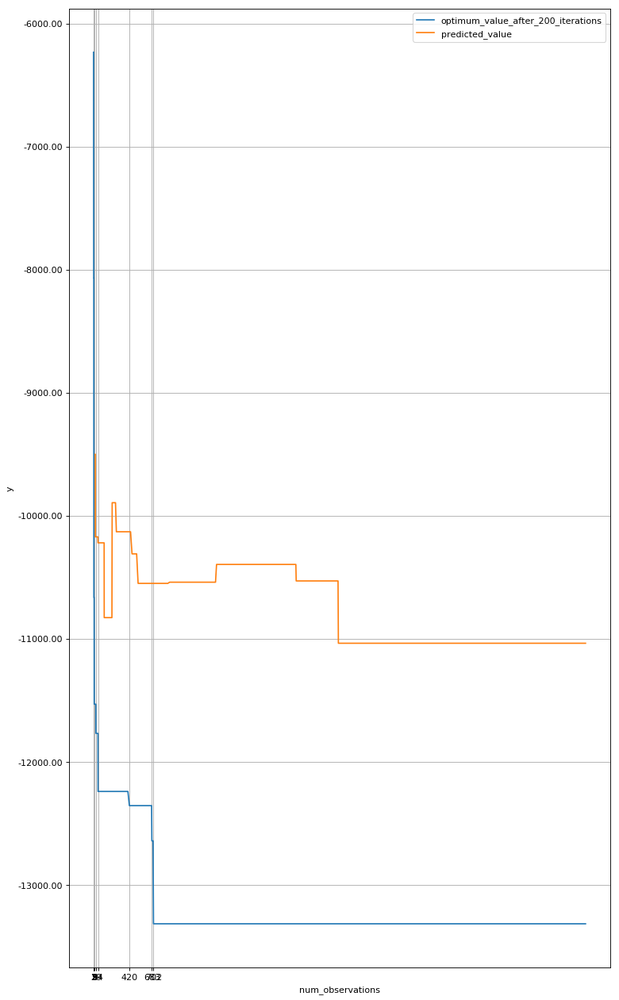

In [14]:
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
%matplotlib inline

fig, axs = plt.subplots(1, figsize=(11, 20), dpi=80, sharex=True)

axs.plot(best_observation_df['num_observations'], best_observation_df[meta_optimizer_objective_name], label=meta_optimizer_objective_name)
axs.plot(best_predicted_value_df['num_observations'], best_predicted_value_df['predicted_value'], label='predicted_value')
axs.set_ylabel('y')
axs.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.2f'))
axs.set_xticks(best_observation_df['num_observations'][::2])
axs.grid(True)
axs.set_xlabel('num_observations')
axs.legend()  
fig.show()

In [15]:
from mlos.Optimizers.RegressionModels.GoodnessOfFitMetrics import DataSetType

# Let's take a look at goodness of fit data.
#
goodness_of_fit_dataframe = regression_model_fit_state.get_goodness_of_fit_dataframe(data_set_type=DataSetType.TRAIN) # TODO: add support to evaluate GoF on test data

C:\Users\adam_\Anaconda3\lib\site-packages\matplotlib\cbook\__init__.py:2062: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x[:, None]
C:\Users\adam_\Anaconda3\lib\site-packages\matplotlib\axes\_base.py:248: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x = x[:, np.newaxis]
C:\Users\adam_\Anaconda3\lib\site-packages\matplotlib\axes\_base.py:250: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  y = y[:, np.newaxis]
C:\Users\adam_\Anaconda3\lib\site-packages\matplotlib\figure.py:459: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib 

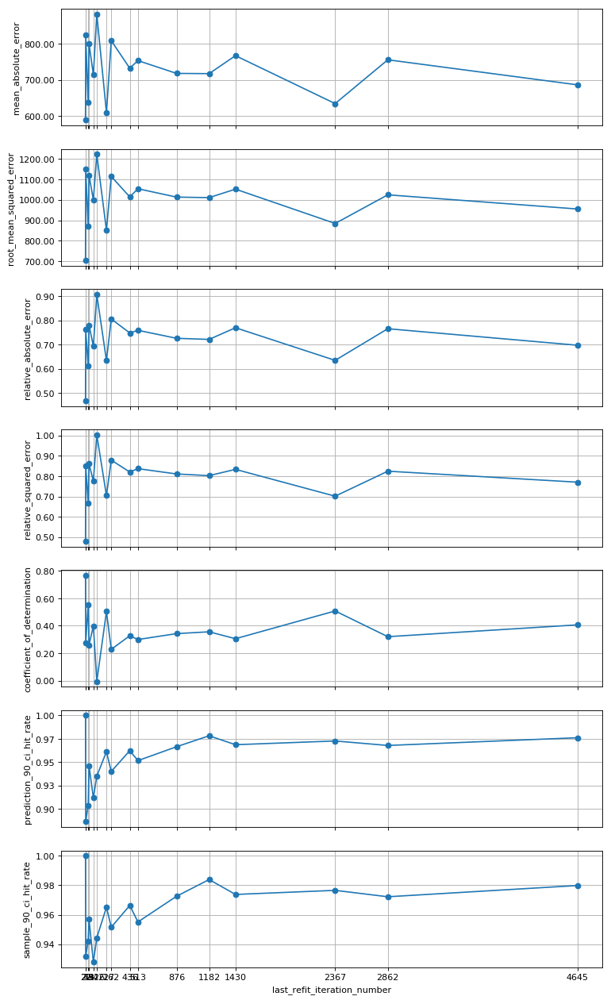

In [16]:
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
%matplotlib inline

gof_df = goodness_of_fit_dataframe
columns_to_plot = [name for name in gof_df.columns.values if name not in ('observation_count', 'prediction_count', 'last_refit_iteration_number')]
num_plots = len(columns_to_plot)
fig, axs = plt.subplots(num_plots, figsize=(11, 20), dpi=80, sharex=True)

for i, column in enumerate(columns_to_plot):
    axs[i].plot(gof_df['last_refit_iteration_number'], gof_df[column], marker='o', label=column)
    axs[i].set_ylabel(column)
    axs[i].yaxis.set_major_formatter(mtick.FormatStrFormatter('%.2f'))
    axs[i].set_xticks(gof_df['last_refit_iteration_number'])
    axs[i].grid(True)
    if i == num_plots - 1:
        axs[i].set_xlabel('last_refit_iteration_number')
        
fig.show()

In [ ]:
global_values.tracer.dump_trace_to_file(r"E:\code\new_mlos\source\Mlos.Python\temp\meta_optimizer.json")

In [ ]:
configs, values = meta_optimizer.get_all_observations()

In [ ]:
import datetime

configs, values = meta_optimizer.get_all_observations()    
merged_observations = pd.concat([configs, values], axis=1)
with open(f"N:\\MLOS\\BayesianOptimizer\\OptimizingOptimizer\\{datetime.datetime.now().strftime('%Y_%m_%d_%H_%M_%S')}combined.csv", "w") as out_file:
    merged_observations.to_csv(out_file, line_terminator="\n")

In [ ]:
from IPython.display import display
with pd.option_context('display.max_rows', 2000, 'display.max_columns', 100):
    display(pd.concat([values, configs], axis=1))

In [ ]:
from mlos.Optimizers.OptimumDefinition import OptimumDefinition

predicted_best_config, predicted_optimum = meta_optimizer.optimum(OptimumDefinition.PREDICTED_VALUE_FOR_OBSERVED_CONFIG)
print(predicted_best_config.to_json(indent=2))